Some code in this notebook has been adapted from the work of Zhongy et al. and Greydanus et al. and from the report and code of Jonas Perolini.

Their code is available in the following repositories :[
Symplectic-ODENet](https://github.com/Physics-aware-AI/Symplectic-ODENet) and [hamiltonian-nn](https://github.com/greydanus/hamiltonian-nn)


# Imports & Setting up directories

In [1]:
try:
    import google.colab

    IN_COLAB = True
except:
    IN_COLAB = False

if IN_COLAB:
    PATH = "./"  # './drive/MyDrive/1_SP_Ham_func/'
    from google.colab import drive

    drive.mount("/content/drive")

    %cd /content/drive/MyDrive/1_SP_Ham_func/furuta_pendulum/
    %pip install torchdiffeq
    from src.data import *
    from src.dynamics import *
    from src.models import *
    from src.train import *
    from src.plots import *
    from src.trajectories import *
    from src.utils import *
else:
    import sys

    sys.path.insert(0, "..")
    import os

    PATH = "../"
    from src.data import *
    from src.dynamics import *
    from src.models import *
    from src.train import *
    from src.plots import *
    from src.trajectories import *
    from src.utils import *

Mounted at /content/drive
/content/drive/MyDrive/1_SP_Ham_func/furuta_pendulum
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [10]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import seaborn as sns
import pandas as pd
import numpy as np

from torch.utils.data import Dataset, DataLoader, random_split
import torch

from torch.optim.lr_scheduler import LinearLR

from torchdiffeq import odeint_adjoint as odeint_adjoint

# func must be a nn.Module when using the adjoint method
from torchdiffeq import odeint as odeint

import time as time
import json
import os

# setting seeds

In [3]:
%load_ext autoreload
%autoreload 2

# Training

#### simple_HNN 

##### 10k parameters - w horizon - with std rescaling (and loss) no clip

In [4]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800  # length of a trajectory
num_trajectories = 125  # number of trajectories in total
proportion = 0.8  # train test proportion
batch_size = 100  # batch size used by dataloader
w_rescale = [1, 1000, 1, 10000]  # [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False  # shuffle sample in the batches between epochs
# 'hamiltonian' or 'newtonian', newtonian if you want [q1,q1_dot,q2,q2_dot]
coord_type = "hamiltonian"
min_max_rescale = False  # rescale the training trajectories
# which dimensions to rescale if using min_max_rescale, so that nothing is divided by zero
rescale_dims = [1, 1, 1, 0]

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = True
grad_clip = False  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)  # total number of training epochs

cpu


In [5]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [6]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=70, nb_hidden_layers=2, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 10363
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p10k_Ts0.005_nodissip_rescaledloss_
horizon_list and switch_steps have the same size


horizon length : 50
min max values updated


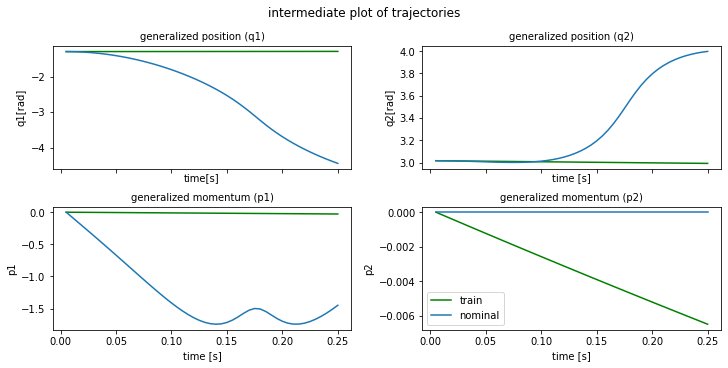

plot time : 1.2452244758605957
min max values updated
epoch    0 | train time 1.82 | train loss 1.003968e+00 | test loss 1.044396e+00 | test time 0.14  
epoch    1 | train time 0.42 | train loss 9.920180e-01 
epoch    2 | train time 0.45 | train loss 9.799724e-01 
epoch    3 | train time 0.51 | train loss 9.674357e-01 
epoch    4 | train time 0.50 | train loss 9.541137e-01 
epoch    5 | train time 0.43 | train loss 9.398418e-01 
epoch    6 | train time 0.52 | train loss 9.245973e-01 
epoch    7 | train time 0.81 | train loss 9.084595e-01 
epoch    8 | train time 0.80 | train loss 8.915056e-01 
epoch    9 | train time 0.85 | train loss 8.737149e-01 


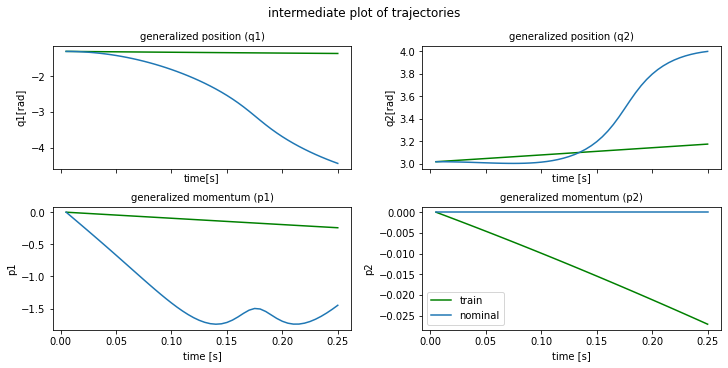

plot time : 2.382345199584961
epoch   10 | train time 3.29 | train loss 8.549726e-01 | test loss 8.656563e-01 | test time 0.34  
epoch   11 | train time 0.86 | train loss 8.351710e-01 
epoch   12 | train time 0.69 | train loss 8.143207e-01 
epoch   13 | train time 0.67 | train loss 7.925885e-01 
epoch   14 | train time 0.80 | train loss 7.702370e-01 
epoch   15 | train time 0.45 | train loss 7.475021e-01 
epoch   16 | train time 0.41 | train loss 7.244862e-01 
epoch   17 | train time 0.42 | train loss 7.011380e-01 
epoch   18 | train time 0.41 | train loss 6.773233e-01 
epoch   19 | train time 0.41 | train loss 6.529347e-01 


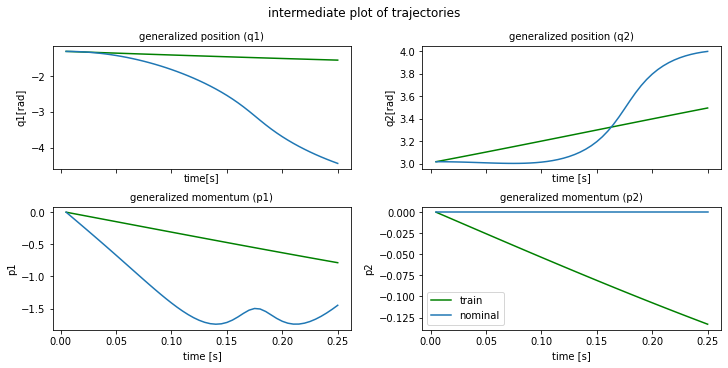

plot time : 1.3246054649353027
epoch   20 | train time 1.82 | train loss 6.279806e-01 | test loss 6.331314e-01 | test time 0.19  
epoch   21 | train time 0.56 | train loss 6.026233e-01 
epoch   22 | train time 0.51 | train loss 5.771537e-01 
epoch   23 | train time 0.44 | train loss 5.519215e-01 
epoch   24 | train time 0.42 | train loss 5.272621e-01 
epoch   25 | train time 0.43 | train loss 5.034558e-01 
epoch   26 | train time 0.42 | train loss 4.807084e-01 
epoch   27 | train time 0.42 | train loss 4.591308e-01 
epoch   28 | train time 0.42 | train loss 4.387226e-01 
epoch   29 | train time 0.41 | train loss 4.193762e-01 


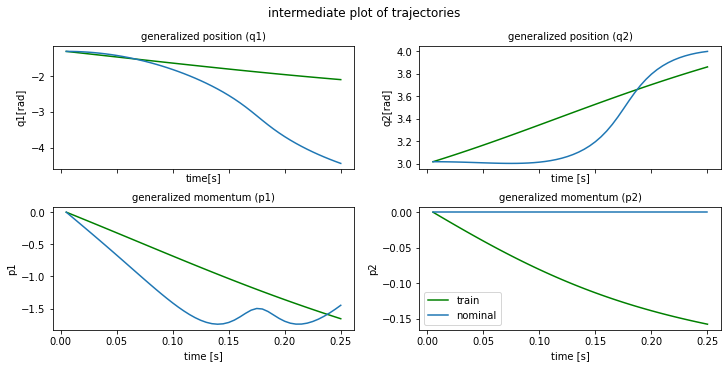

plot time : 1.1643905639648438
epoch   30 | train time 1.60 | train loss 4.009063e-01 | test loss 4.276076e-01 | test time 0.13  
epoch   31 | train time 0.43 | train loss 3.830990e-01 
epoch   32 | train time 0.51 | train loss 3.657577e-01 
epoch   33 | train time 0.44 | train loss 3.487335e-01 
epoch   34 | train time 0.43 | train loss 3.319481e-01 
epoch   35 | train time 0.42 | train loss 3.154086e-01 
epoch   36 | train time 0.43 | train loss 2.991989e-01 
epoch   37 | train time 0.42 | train loss 2.834358e-01 
epoch   38 | train time 0.45 | train loss 2.682214e-01 
epoch   39 | train time 0.53 | train loss 2.536226e-01 


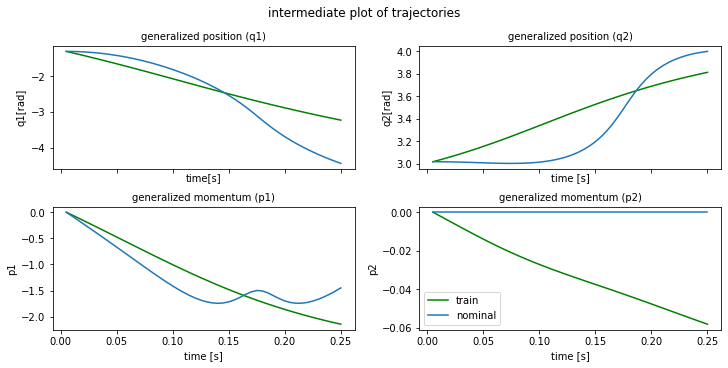

plot time : 1.1770038604736328
epoch   40 | train time 1.65 | train loss 2.396754e-01 | test loss 3.008174e-01 | test time 0.14  
epoch   41 | train time 0.41 | train loss 2.263854e-01 
epoch   42 | train time 0.42 | train loss 2.137234e-01 
epoch   43 | train time 0.42 | train loss 2.016354e-01 
epoch   44 | train time 0.42 | train loss 1.900681e-01 
epoch   45 | train time 0.52 | train loss 1.789909e-01 
epoch   46 | train time 0.48 | train loss 1.684069e-01 
epoch   47 | train time 0.50 | train loss 1.583499e-01 
epoch   48 | train time 0.44 | train loss 1.488690e-01 
epoch   49 | train time 0.53 | train loss 1.400064e-01 


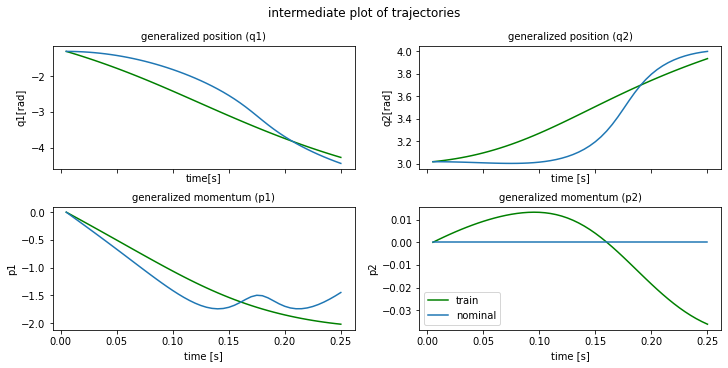

plot time : 1.1876144409179688
epoch   50 | train time 1.68 | train loss 1.317804e-01 | test loss 1.956359e-01 | test time 0.14  
epoch   51 | train time 0.42 | train loss 1.241824e-01 
epoch   52 | train time 0.42 | train loss 1.171854e-01 
epoch   53 | train time 0.42 | train loss 1.107621e-01 
epoch   54 | train time 0.44 | train loss 1.049016e-01 
epoch   55 | train time 0.43 | train loss 9.961210e-02 
epoch   56 | train time 0.45 | train loss 9.490080e-02 
epoch   57 | train time 0.43 | train loss 9.073773e-02 
epoch   58 | train time 0.41 | train loss 8.703409e-02 
epoch   59 | train time 0.41 | train loss 8.366512e-02 


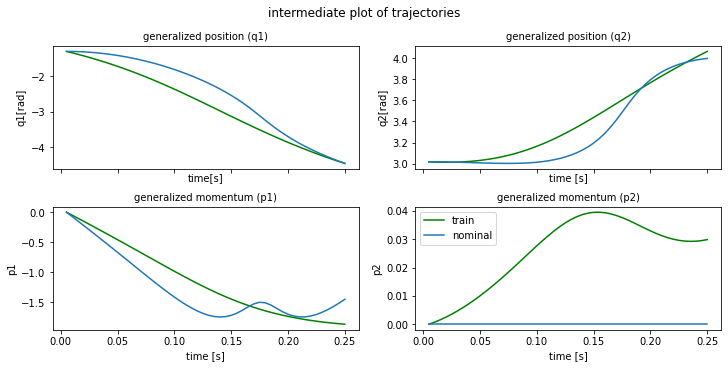

plot time : 1.1751964092254639
epoch   60 | train time 1.61 | train loss 8.052369e-02 | test loss 1.013149e-01 | test time 0.13  
epoch   61 | train time 0.42 | train loss 7.755202e-02 
epoch   62 | train time 0.43 | train loss 7.472596e-02 
epoch   63 | train time 0.47 | train loss 7.202243e-02 
epoch   64 | train time 0.54 | train loss 6.941140e-02 
epoch   65 | train time 0.42 | train loss 6.687713e-02 
epoch   66 | train time 0.42 | train loss 6.442969e-02 
epoch   67 | train time 0.43 | train loss 6.207778e-02 
epoch   68 | train time 0.43 | train loss 5.979865e-02 
epoch   69 | train time 0.43 | train loss 5.755626e-02 


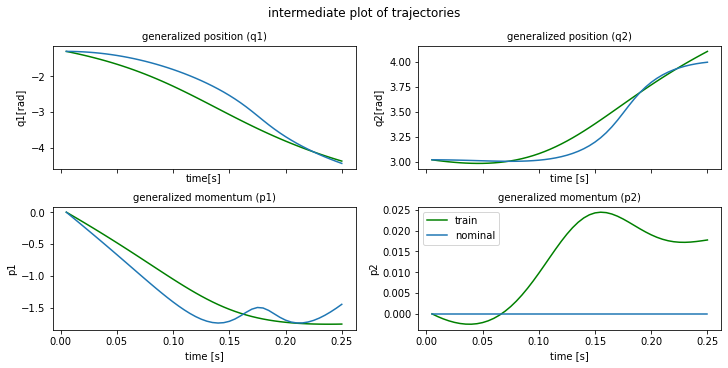

plot time : 1.2379896640777588
epoch   70 | train time 1.68 | train loss 5.534525e-02 | test loss 6.700799e-02 | test time 0.14  
epoch   71 | train time 0.42 | train loss 5.320241e-02 
epoch   72 | train time 0.45 | train loss 5.117640e-02 
epoch   73 | train time 0.42 | train loss 4.928408e-02 
epoch   74 | train time 0.43 | train loss 4.749549e-02 
epoch   75 | train time 0.42 | train loss 4.576515e-02 
epoch   76 | train time 0.48 | train loss 4.407678e-02 
epoch   77 | train time 0.52 | train loss 4.244396e-02 
epoch   78 | train time 0.44 | train loss 4.086810e-02 
epoch   79 | train time 0.43 | train loss 3.934824e-02 


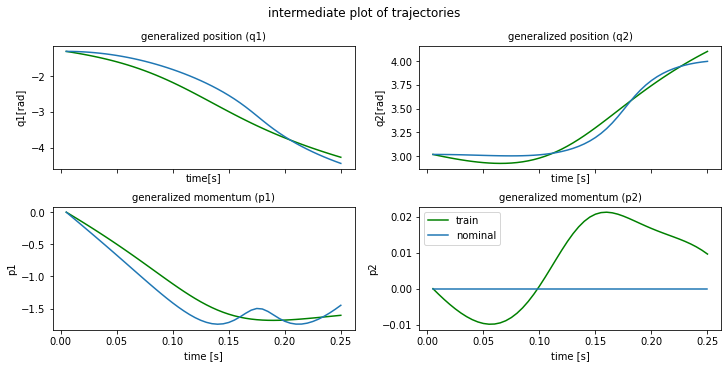

plot time : 1.1685421466827393
epoch   80 | train time 1.60 | train loss 3.790756e-02 | test loss 4.674645e-02 | test time 0.14  
epoch   81 | train time 0.43 | train loss 3.655584e-02 
epoch   82 | train time 0.42 | train loss 3.527166e-02 
epoch   83 | train time 0.43 | train loss 3.403393e-02 
epoch   84 | train time 0.42 | train loss 3.284758e-02 
epoch   85 | train time 0.42 | train loss 3.173098e-02 
epoch   86 | train time 0.43 | train loss 3.068287e-02 
epoch   87 | train time 0.42 | train loss 2.969122e-02 
epoch   88 | train time 0.43 | train loss 2.876340e-02 
epoch   89 | train time 0.42 | train loss 2.789448e-02 


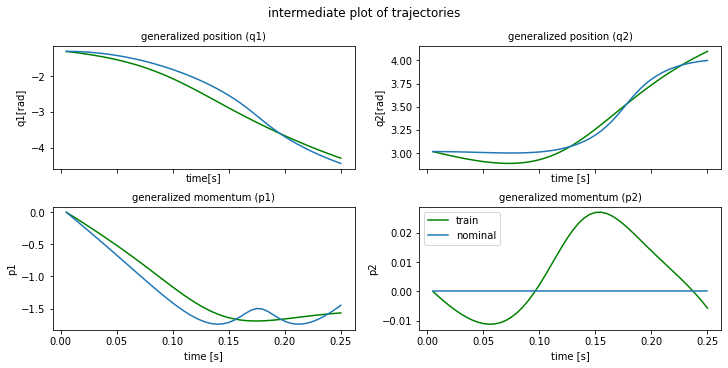

plot time : 1.241225004196167
epoch   90 | train time 1.68 | train loss 2.706777e-02 | test loss 3.315249e-02 | test time 0.14  
epoch   91 | train time 0.52 | train loss 2.627501e-02 
epoch   92 | train time 0.46 | train loss 2.551748e-02 
epoch   93 | train time 0.43 | train loss 2.479211e-02 
epoch   94 | train time 0.42 | train loss 2.409388e-02 
epoch   95 | train time 0.51 | train loss 2.342870e-02 
epoch   96 | train time 0.48 | train loss 2.279194e-02 
epoch   97 | train time 0.41 | train loss 2.217547e-02 
epoch   98 | train time 0.41 | train loss 2.158040e-02 
epoch   99 | train time 0.49 | train loss 2.101076e-02 


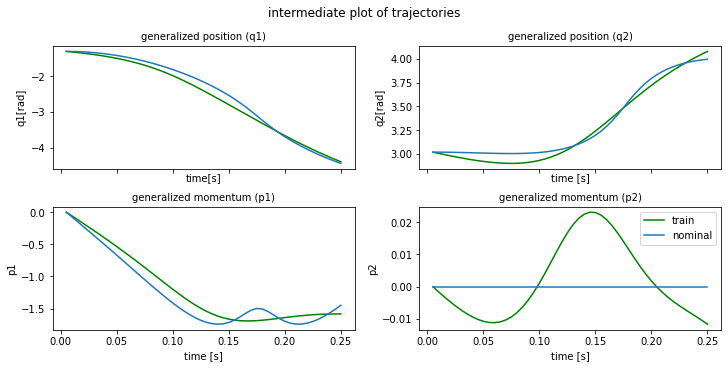

plot time : 1.1694788932800293
epoch  100 | train time 1.67 | train loss 2.046225e-02 | test loss 2.671268e-02 | test time 0.14  
epoch  101 | train time 0.52 | train loss 1.993385e-02 
epoch  102 | train time 0.50 | train loss 1.942616e-02 
epoch  103 | train time 0.42 | train loss 1.893687e-02 
epoch  104 | train time 0.42 | train loss 1.846639e-02 
epoch  105 | train time 0.41 | train loss 1.801330e-02 
epoch  106 | train time 0.42 | train loss 1.757349e-02 
epoch  107 | train time 0.51 | train loss 1.714585e-02 
epoch  108 | train time 0.52 | train loss 1.673269e-02 
epoch  109 | train time 0.49 | train loss 1.633192e-02 


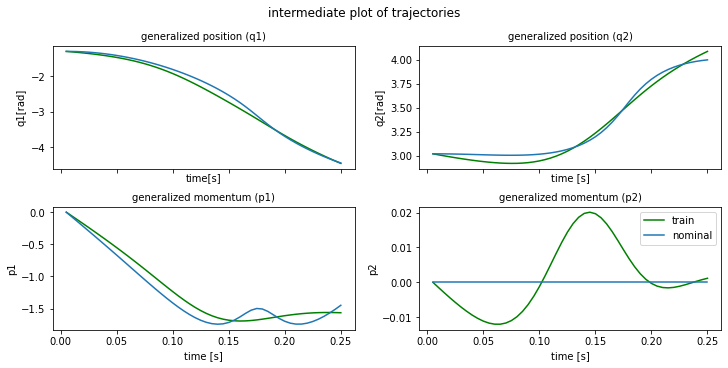

plot time : 1.2180969715118408
epoch  110 | train time 1.73 | train loss 1.594318e-02 | test loss 2.249352e-02 | test time 0.19  
epoch  111 | train time 0.54 | train loss 1.556732e-02 
epoch  112 | train time 0.45 | train loss 1.520369e-02 
epoch  113 | train time 0.42 | train loss 1.485087e-02 
epoch  114 | train time 0.42 | train loss 1.450873e-02 
epoch  115 | train time 0.41 | train loss 1.417609e-02 
epoch  116 | train time 0.44 | train loss 1.385375e-02 
epoch  117 | train time 0.54 | train loss 1.354118e-02 
epoch  118 | train time 0.42 | train loss 1.323622e-02 
epoch  119 | train time 0.42 | train loss 1.293767e-02 


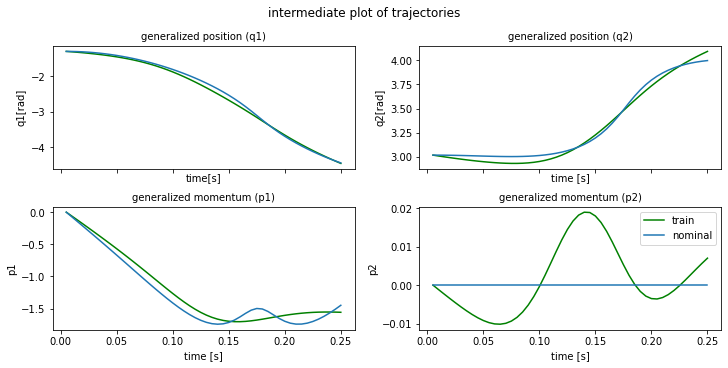

plot time : 1.2263901233673096
epoch  120 | train time 1.68 | train loss 1.264589e-02 | test loss 1.901845e-02 | test time 0.14  
epoch  121 | train time 0.42 | train loss 1.236104e-02 
epoch  122 | train time 0.42 | train loss 1.208395e-02 
epoch  123 | train time 0.43 | train loss 1.181394e-02 
epoch  124 | train time 0.42 | train loss 1.155054e-02 
epoch  125 | train time 0.42 | train loss 1.129394e-02 
epoch  126 | train time 0.42 | train loss 1.104392e-02 
epoch  127 | train time 0.43 | train loss 1.080054e-02 
epoch  128 | train time 0.47 | train loss 1.056389e-02 
epoch  129 | train time 0.43 | train loss 1.033372e-02 


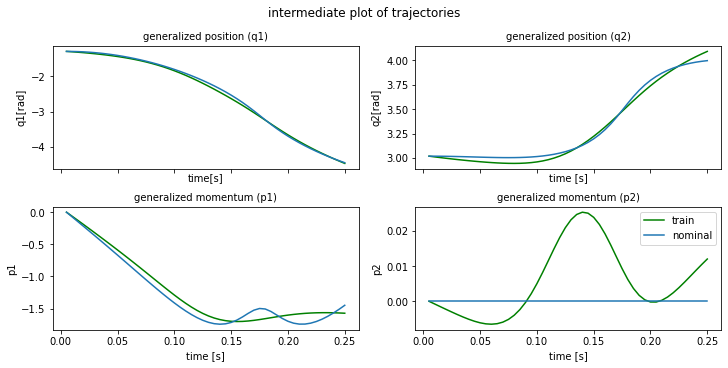

plot time : 1.2103419303894043
epoch  130 | train time 1.71 | train loss 1.011007e-02 | test loss 1.633112e-02 | test time 0.18  
epoch  131 | train time 0.54 | train loss 9.892466e-03 
epoch  132 | train time 0.49 | train loss 9.680714e-03 
epoch  133 | train time 0.48 | train loss 9.475066e-03 
epoch  134 | train time 0.52 | train loss 9.275178e-03 
epoch  135 | train time 0.44 | train loss 9.080905e-03 
epoch  136 | train time 0.45 | train loss 8.892103e-03 
epoch  137 | train time 0.47 | train loss 8.708986e-03 
epoch  138 | train time 0.56 | train loss 8.531636e-03 
epoch  139 | train time 0.52 | train loss 8.359866e-03 


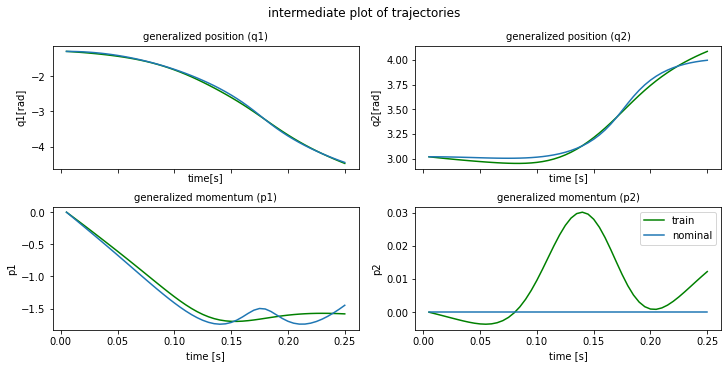

plot time : 1.1912140846252441
epoch  140 | train time 1.69 | train loss 8.194272e-03 | test loss 1.431364e-02 | test time 0.14  
epoch  141 | train time 0.43 | train loss 8.036679e-03 
epoch  142 | train time 0.43 | train loss 7.894523e-03 
epoch  143 | train time 0.42 | train loss 7.793627e-03 
epoch  144 | train time 0.42 | train loss 7.795043e-03 
epoch  145 | train time 0.47 | train loss 7.931309e-03 
epoch  146 | train time 0.45 | train loss 7.932437e-03 
epoch  147 | train time 0.41 | train loss 7.455569e-03 
epoch  148 | train time 0.42 | train loss 7.056113e-03 
epoch  149 | train time 0.42 | train loss 7.174361e-03 


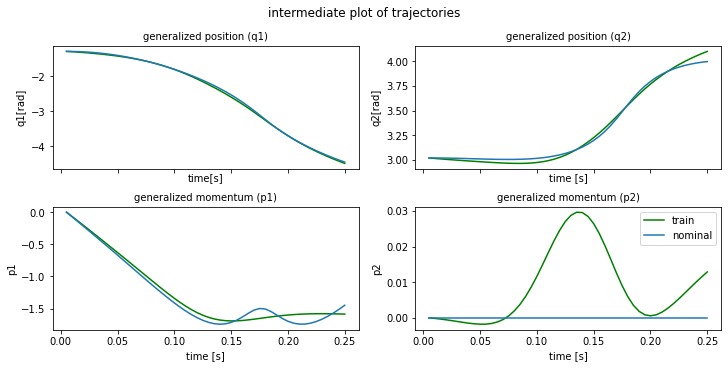

plot time : 1.1894645690917969
epoch  150 | train time 1.69 | train loss 7.217471e-03 | test loss 1.249361e-02 | test time 0.16  
epoch  151 | train time 0.45 | train loss 6.840513e-03 
epoch  152 | train time 0.43 | train loss 6.628406e-03 
epoch  153 | train time 0.45 | train loss 6.745649e-03 
epoch  154 | train time 0.44 | train loss 6.637929e-03 
epoch  155 | train time 0.43 | train loss 6.330667e-03 
epoch  156 | train time 0.54 | train loss 6.290196e-03 
epoch  157 | train time 0.47 | train loss 6.333574e-03 
epoch  158 | train time 0.54 | train loss 6.137589e-03 
epoch  159 | train time 0.45 | train loss 5.955630e-03 


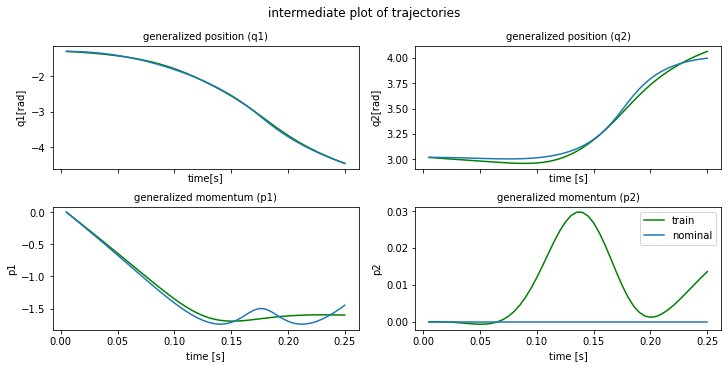

plot time : 1.2554683685302734
epoch  160 | train time 1.75 | train loss 5.971789e-03 | test loss 1.169735e-02 | test time 0.14  
epoch  161 | train time 0.42 | train loss 5.931650e-03 
epoch  162 | train time 0.45 | train loss 5.749602e-03 
epoch  163 | train time 0.43 | train loss 5.647019e-03 
epoch  164 | train time 0.43 | train loss 5.652951e-03 
epoch  165 | train time 0.42 | train loss 5.585944e-03 
epoch  166 | train time 0.42 | train loss 5.440602e-03 
epoch  167 | train time 0.43 | train loss 5.363301e-03 
epoch  168 | train time 0.41 | train loss 5.352024e-03 
epoch  169 | train time 0.52 | train loss 5.292667e-03 


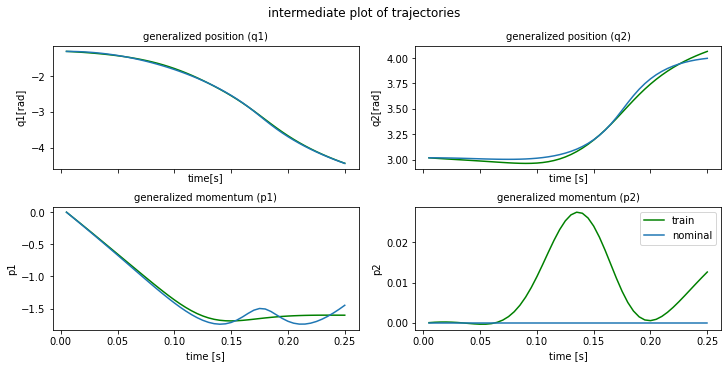

plot time : 1.1646082401275635
epoch  170 | train time 1.59 | train loss 5.179646e-03 | test loss 1.010035e-02 | test time 0.15  
epoch  171 | train time 0.44 | train loss 5.100982e-03 
epoch  172 | train time 0.45 | train loss 5.074394e-03 
epoch  173 | train time 0.45 | train loss 5.035810e-03 
epoch  174 | train time 0.42 | train loss 4.954814e-03 
epoch  175 | train time 0.42 | train loss 4.871178e-03 
epoch  176 | train time 0.52 | train loss 4.821946e-03 
epoch  177 | train time 0.51 | train loss 4.792242e-03 
epoch  178 | train time 0.50 | train loss 4.747942e-03 
epoch  179 | train time 0.50 | train loss 4.681485e-03 


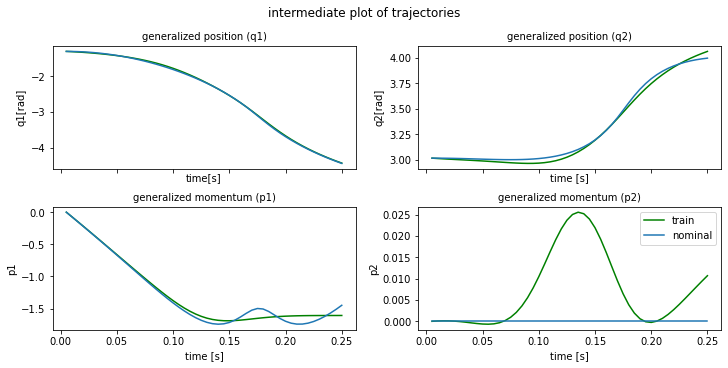

plot time : 1.3229756355285645
epoch  180 | train time 1.76 | train loss 4.613898e-03 | test loss 9.157691e-03 | test time 0.14  
epoch  181 | train time 0.50 | train loss 4.563880e-03 
epoch  182 | train time 0.53 | train loss 4.528932e-03 
epoch  183 | train time 0.45 | train loss 4.494162e-03 
epoch  184 | train time 0.42 | train loss 4.449263e-03 
epoch  185 | train time 0.43 | train loss 4.395630e-03 
epoch  186 | train time 0.42 | train loss 4.341589e-03 
epoch  187 | train time 0.54 | train loss 4.294174e-03 
epoch  188 | train time 0.42 | train loss 4.254833e-03 
epoch  189 | train time 0.43 | train loss 4.220640e-03 


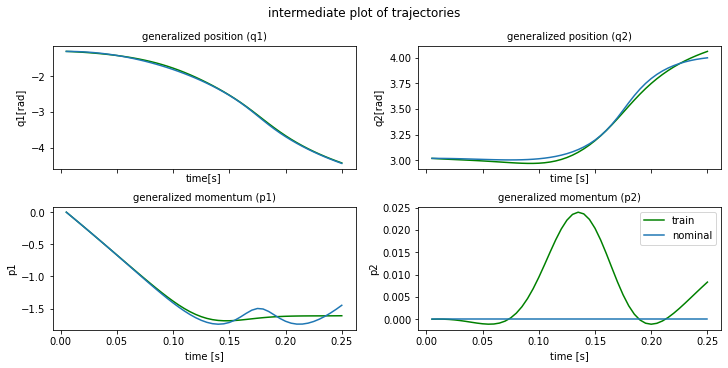

plot time : 1.1678996086120605
epoch  190 | train time 1.60 | train loss 4.187606e-03 | test loss 8.539183e-03 | test time 0.14  
epoch  191 | train time 0.43 | train loss 4.153095e-03 
epoch  192 | train time 0.43 | train loss 4.116314e-03 
epoch  193 | train time 0.46 | train loss 4.077736e-03 
epoch  194 | train time 0.42 | train loss 4.038441e-03 
epoch  195 | train time 0.42 | train loss 3.999406e-03 
epoch  196 | train time 0.49 | train loss 3.961315e-03 
epoch  197 | train time 0.42 | train loss 3.924605e-03 
epoch  198 | train time 0.42 | train loss 3.889396e-03 
epoch  199 | train time 0.41 | train loss 3.855880e-03 
horizon length : 100
min max values updated


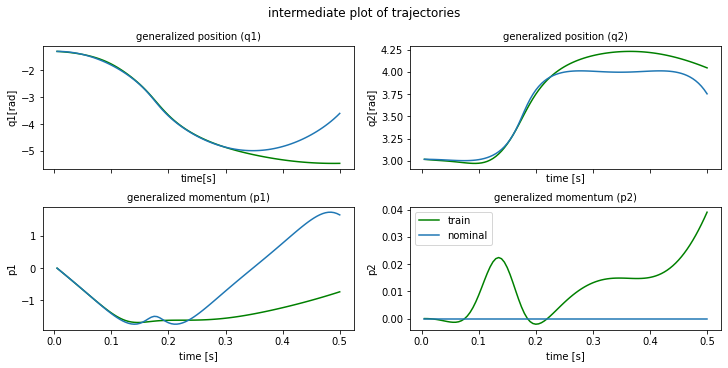

plot time : 1.2017455101013184
min max values updated
epoch  200 | train time 2.16 | train loss 3.086390e-01 | test loss 2.056523e-01 | test time 0.28  
epoch  201 | train time 0.84 | train loss 1.975664e-01 
epoch  202 | train time 0.83 | train loss 1.542402e-01 
epoch  203 | train time 0.85 | train loss 1.092353e-01 
epoch  204 | train time 0.94 | train loss 8.780033e-02 
epoch  205 | train time 1.11 | train loss 8.503813e-02 
epoch  206 | train time 0.96 | train loss 8.568496e-02 
epoch  207 | train time 0.85 | train loss 7.634673e-02 
epoch  208 | train time 0.84 | train loss 6.634658e-02 
epoch  209 | train time 0.88 | train loss 6.293694e-02 


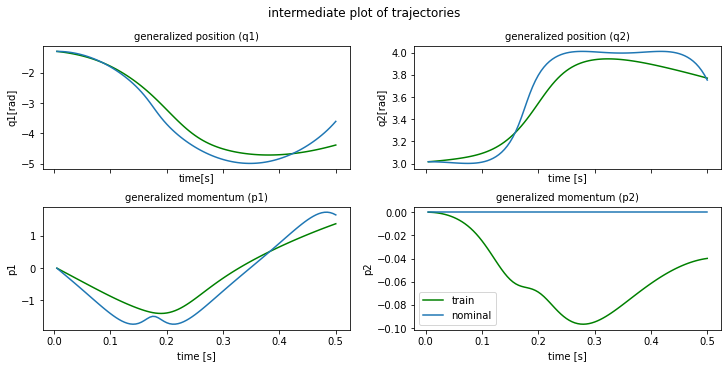

plot time : 1.2385036945343018
epoch  210 | train time 2.20 | train loss 6.003119e-02 | test loss 7.254329e-02 | test time 0.28  
epoch  211 | train time 0.98 | train loss 5.548514e-02 
epoch  212 | train time 0.88 | train loss 5.015875e-02 
epoch  213 | train time 0.84 | train loss 4.746885e-02 
epoch  214 | train time 0.84 | train loss 4.627384e-02 
epoch  215 | train time 0.87 | train loss 4.276276e-02 
epoch  216 | train time 0.84 | train loss 3.825750e-02 
epoch  217 | train time 0.84 | train loss 3.585801e-02 
epoch  218 | train time 0.90 | train loss 3.353339e-02 
epoch  219 | train time 0.89 | train loss 3.088010e-02 


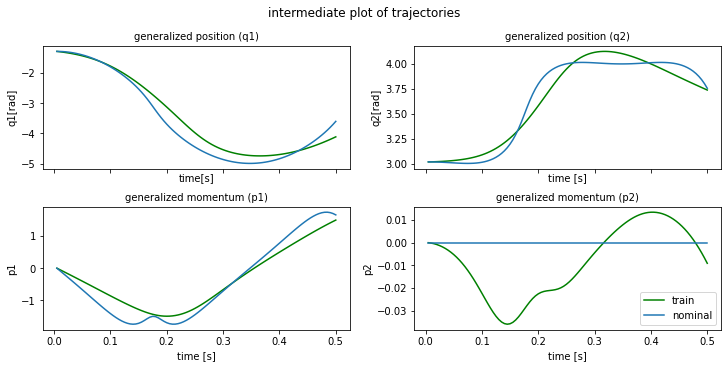

plot time : 1.1940562725067139
epoch  220 | train time 2.09 | train loss 2.920760e-02 | test loss 3.710454e-02 | test time 0.27  
epoch  221 | train time 0.84 | train loss 2.821214e-02 
epoch  222 | train time 0.82 | train loss 2.699384e-02 
epoch  223 | train time 0.84 | train loss 2.527292e-02 
epoch  224 | train time 0.84 | train loss 2.322004e-02 
epoch  225 | train time 0.89 | train loss 2.162640e-02 
epoch  226 | train time 0.89 | train loss 2.043810e-02 
epoch  227 | train time 0.85 | train loss 1.938415e-02 
epoch  228 | train time 0.86 | train loss 1.888701e-02 
epoch  229 | train time 0.82 | train loss 1.809019e-02 


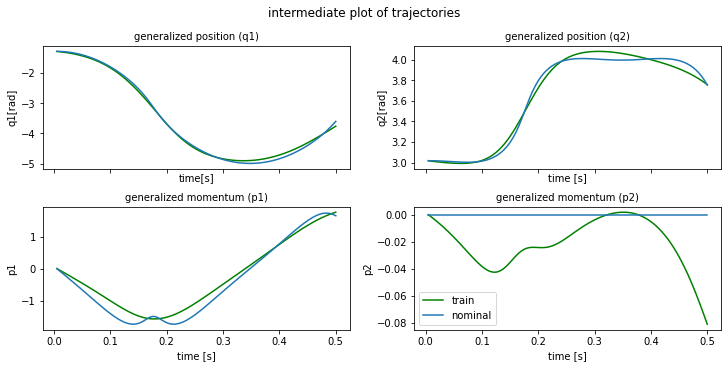

plot time : 1.2797377109527588
epoch  230 | train time 2.13 | train loss 1.741752e-02 | test loss 2.347903e-02 | test time 0.28  
epoch  231 | train time 0.86 | train loss 1.684995e-02 
epoch  232 | train time 0.83 | train loss 1.589405e-02 
epoch  233 | train time 0.84 | train loss 1.518128e-02 
epoch  234 | train time 0.85 | train loss 1.460969e-02 
epoch  235 | train time 0.84 | train loss 1.424191e-02 
epoch  236 | train time 0.84 | train loss 1.377352e-02 
epoch  237 | train time 1.12 | train loss 1.323469e-02 
epoch  238 | train time 1.21 | train loss 1.296639e-02 
epoch  239 | train time 1.26 | train loss 1.246359e-02 


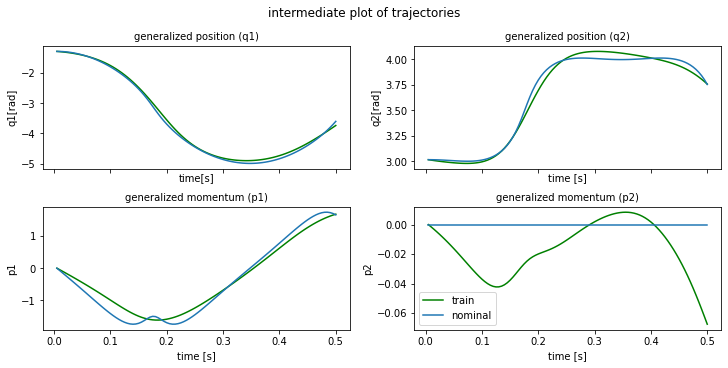

plot time : 1.286555290222168
epoch  240 | train time 2.42 | train loss 1.197284e-02 | test loss 1.666304e-02 | test time 0.27  
epoch  241 | train time 0.84 | train loss 1.159807e-02 
epoch  242 | train time 0.83 | train loss 1.117067e-02 
epoch  243 | train time 0.84 | train loss 1.081462e-02 
epoch  244 | train time 0.83 | train loss 1.053296e-02 
epoch  245 | train time 0.98 | train loss 1.033384e-02 
epoch  246 | train time 1.04 | train loss 9.964665e-03 
epoch  247 | train time 0.86 | train loss 9.647137e-03 
epoch  248 | train time 0.88 | train loss 9.427578e-03 
epoch  249 | train time 0.94 | train loss 9.129929e-03 


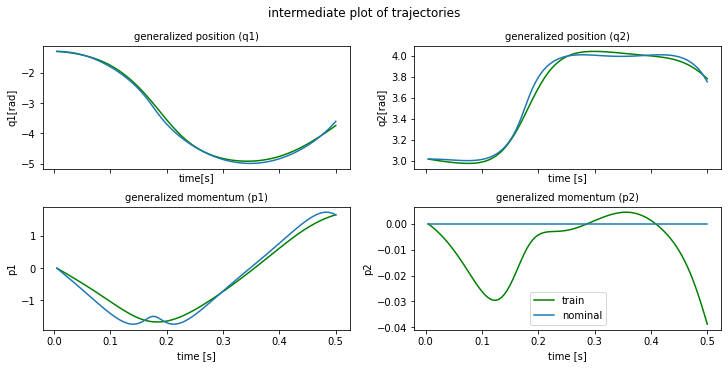

plot time : 1.2658426761627197
epoch  250 | train time 2.35 | train loss 8.881330e-03 | test loss 1.305071e-02 | test time 0.34  
epoch  251 | train time 0.83 | train loss 8.654604e-03 
epoch  252 | train time 0.84 | train loss 8.451270e-03 
epoch  253 | train time 0.84 | train loss 8.210536e-03 
epoch  254 | train time 0.95 | train loss 8.045036e-03 
epoch  255 | train time 0.97 | train loss 7.870384e-03 
epoch  256 | train time 0.82 | train loss 7.658194e-03 
epoch  257 | train time 0.93 | train loss 7.484816e-03 
epoch  258 | train time 0.94 | train loss 7.324306e-03 
epoch  259 | train time 0.87 | train loss 7.167516e-03 


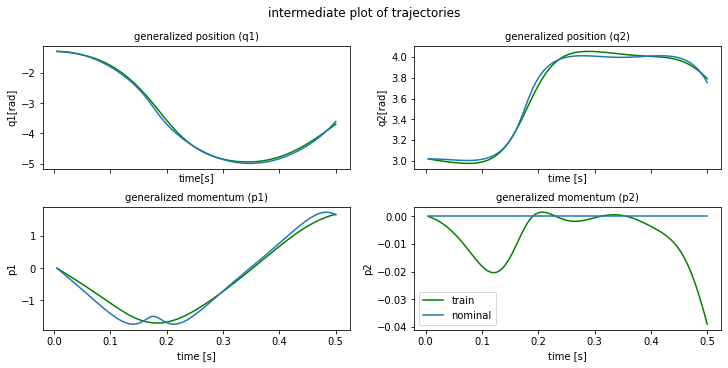

plot time : 1.2343194484710693
epoch  260 | train time 2.21 | train loss 7.016657e-03 | test loss 1.151052e-02 | test time 0.27  
epoch  261 | train time 0.83 | train loss 6.902475e-03 
epoch  262 | train time 0.91 | train loss 6.752597e-03 
epoch  263 | train time 0.94 | train loss 6.611927e-03 
epoch  264 | train time 0.85 | train loss 6.482224e-03 
epoch  265 | train time 0.84 | train loss 6.369490e-03 
epoch  266 | train time 0.87 | train loss 6.253434e-03 
epoch  267 | train time 0.85 | train loss 6.155040e-03 
epoch  268 | train time 0.84 | train loss 6.055075e-03 
epoch  269 | train time 0.98 | train loss 5.954114e-03 


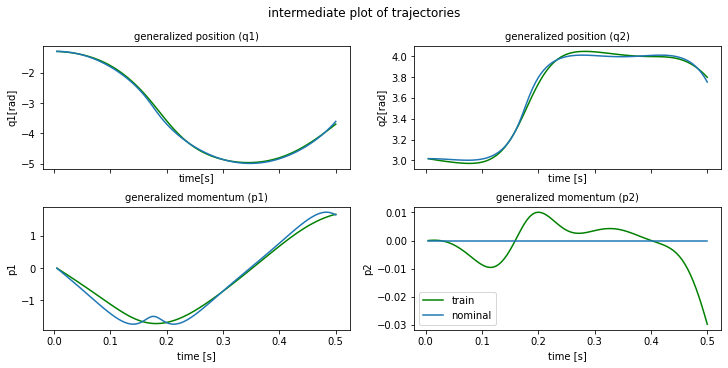

plot time : 1.1616363525390625
epoch  270 | train time 2.15 | train loss 5.853743e-03 | test loss 9.530917e-03 | test time 0.32  
epoch  271 | train time 0.85 | train loss 5.766164e-03 
epoch  272 | train time 0.84 | train loss 5.683285e-03 
epoch  273 | train time 0.86 | train loss 5.602298e-03 
epoch  274 | train time 0.84 | train loss 5.520553e-03 
epoch  275 | train time 0.86 | train loss 5.440592e-03 
epoch  276 | train time 0.99 | train loss 5.363267e-03 
epoch  277 | train time 0.85 | train loss 5.295748e-03 
epoch  278 | train time 0.85 | train loss 5.230865e-03 
epoch  279 | train time 0.88 | train loss 5.163674e-03 


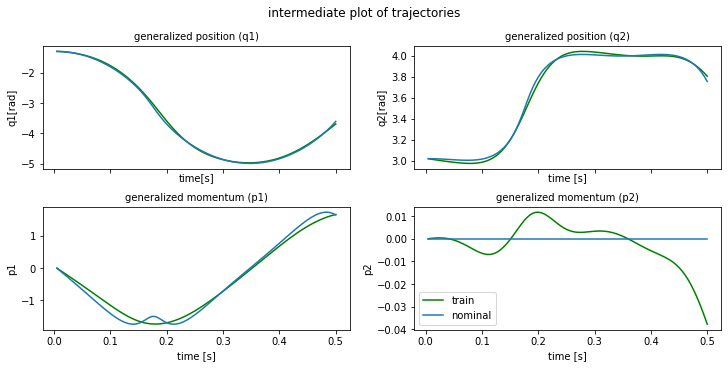

plot time : 1.2903592586517334
epoch  280 | train time 2.29 | train loss 5.097846e-03 | test loss 8.389995e-03 | test time 0.35  
epoch  281 | train time 0.94 | train loss 5.038817e-03 
epoch  282 | train time 0.84 | train loss 4.978618e-03 
epoch  283 | train time 0.93 | train loss 4.921600e-03 
epoch  284 | train time 0.83 | train loss 4.867670e-03 
epoch  285 | train time 0.82 | train loss 4.815438e-03 
epoch  286 | train time 0.83 | train loss 4.762507e-03 
epoch  287 | train time 0.84 | train loss 4.713768e-03 
epoch  288 | train time 0.84 | train loss 4.664549e-03 
epoch  289 | train time 0.84 | train loss 4.617197e-03 


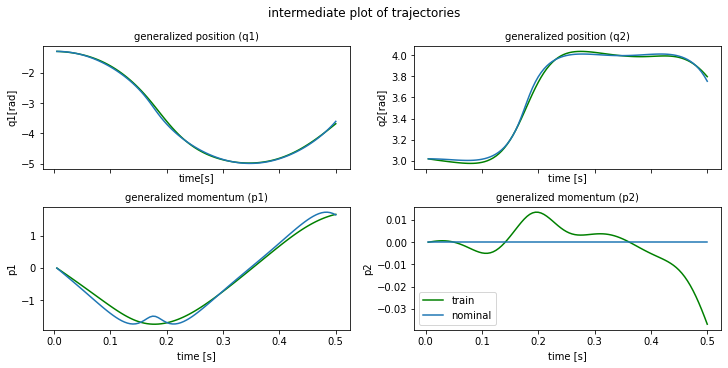

plot time : 1.399770736694336
epoch  290 | train time 2.37 | train loss 4.571517e-03 | test loss 7.742483e-03 | test time 0.37  
epoch  291 | train time 0.85 | train loss 4.527780e-03 
epoch  292 | train time 0.84 | train loss 4.484391e-03 
epoch  293 | train time 0.85 | train loss 4.443119e-03 
epoch  294 | train time 0.83 | train loss 4.402562e-03 
epoch  295 | train time 0.83 | train loss 4.362472e-03 
epoch  296 | train time 0.84 | train loss 4.323536e-03 
epoch  297 | train time 0.83 | train loss 4.285557e-03 
epoch  298 | train time 0.85 | train loss 4.249102e-03 
epoch  299 | train time 0.84 | train loss 4.213513e-03 
horizon length : 150
min max values updated


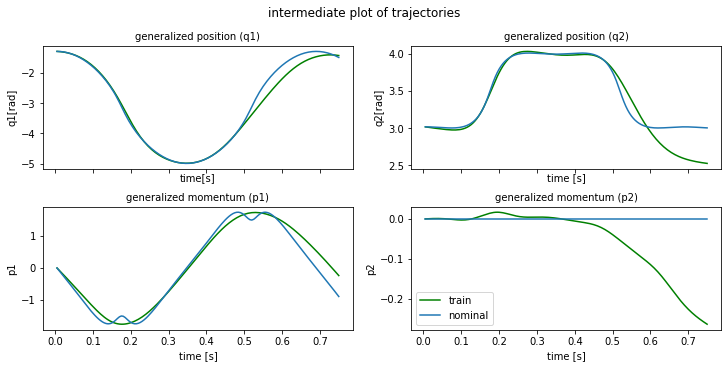

plot time : 1.1999857425689697
min max values updated
epoch  300 | train time 2.57 | train loss 8.367346e-02 | test loss 8.099538e-02 | test time 0.42  
epoch  301 | train time 1.33 | train loss 8.564966e-02 
epoch  302 | train time 1.27 | train loss 1.545593e-01 
epoch  303 | train time 1.26 | train loss 3.711160e-02 
epoch  304 | train time 1.25 | train loss 1.064016e-01 
epoch  305 | train time 1.27 | train loss 6.143465e-02 
epoch  306 | train time 1.39 | train loss 6.111817e-02 
epoch  307 | train time 1.24 | train loss 5.595771e-02 
epoch  308 | train time 1.26 | train loss 5.313852e-02 
epoch  309 | train time 1.24 | train loss 4.812360e-02 


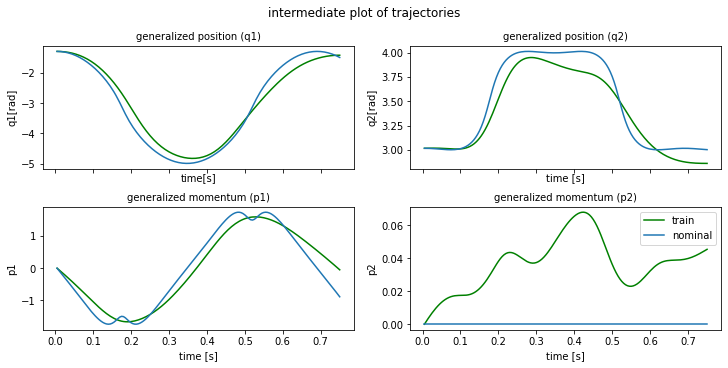

plot time : 1.2378993034362793
epoch  310 | train time 2.65 | train loss 3.677869e-02 | test loss 4.957468e-02 | test time 0.52  
epoch  311 | train time 1.34 | train loss 4.595014e-02 
epoch  312 | train time 1.34 | train loss 4.613693e-02 
epoch  313 | train time 1.26 | train loss 2.442194e-02 
epoch  314 | train time 1.32 | train loss 3.674245e-02 
epoch  315 | train time 1.40 | train loss 3.322182e-02 
epoch  316 | train time 1.26 | train loss 2.575083e-02 
epoch  317 | train time 1.31 | train loss 2.352099e-02 
epoch  318 | train time 1.41 | train loss 2.726286e-02 
epoch  319 | train time 1.51 | train loss 2.472620e-02 


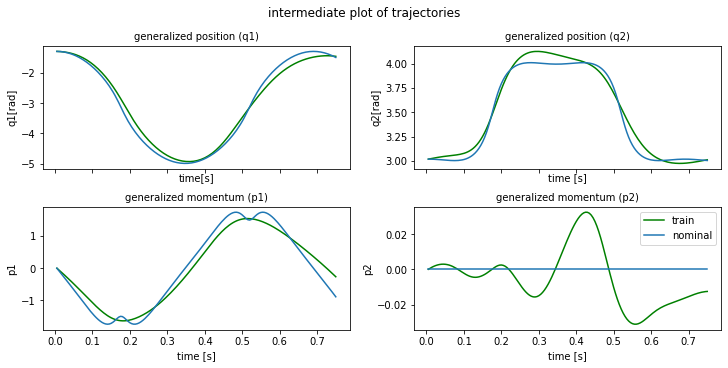

plot time : 1.1801433563232422
epoch  320 | train time 2.45 | train loss 1.619418e-02 | test loss 1.996438e-02 | test time 0.45  
epoch  321 | train time 1.25 | train loss 2.090666e-02 
epoch  322 | train time 1.26 | train loss 2.060964e-02 
epoch  323 | train time 1.24 | train loss 1.773376e-02 
epoch  324 | train time 1.25 | train loss 1.397268e-02 
epoch  325 | train time 1.27 | train loss 1.415357e-02 
epoch  326 | train time 1.39 | train loss 1.676419e-02 
epoch  327 | train time 1.25 | train loss 1.320201e-02 
epoch  328 | train time 1.26 | train loss 1.286182e-02 
epoch  329 | train time 1.24 | train loss 1.263914e-02 


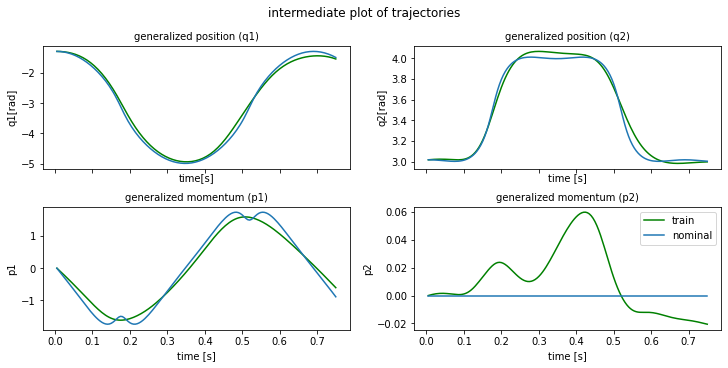

plot time : 1.2582299709320068
epoch  330 | train time 2.61 | train loss 1.319737e-02 | test loss 1.212448e-02 | test time 0.42  
epoch  331 | train time 1.25 | train loss 1.094541e-02 
epoch  332 | train time 1.41 | train loss 1.100396e-02 
epoch  333 | train time 1.34 | train loss 1.127938e-02 
epoch  334 | train time 1.25 | train loss 1.038905e-02 
epoch  335 | train time 1.38 | train loss 1.045502e-02 
epoch  336 | train time 1.45 | train loss 9.335503e-03 
epoch  337 | train time 1.47 | train loss 9.499189e-03 
epoch  338 | train time 1.37 | train loss 9.077955e-03 
epoch  339 | train time 1.27 | train loss 9.261549e-03 


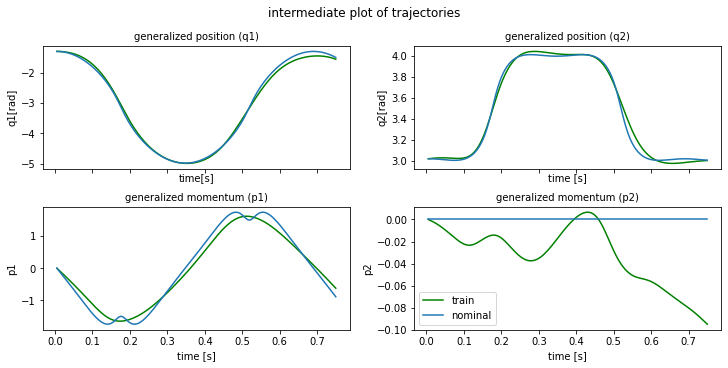

plot time : 1.2076823711395264
epoch  340 | train time 2.55 | train loss 8.555764e-03 | test loss 1.069243e-02 | test time 0.43  
epoch  341 | train time 1.35 | train loss 8.359116e-03 
epoch  342 | train time 1.34 | train loss 8.010309e-03 
epoch  343 | train time 1.38 | train loss 8.274614e-03 
epoch  344 | train time 1.26 | train loss 7.696318e-03 
epoch  345 | train time 1.34 | train loss 7.481025e-03 
epoch  346 | train time 1.44 | train loss 7.614707e-03 
epoch  347 | train time 1.30 | train loss 7.480971e-03 
epoch  348 | train time 1.35 | train loss 7.043791e-03 
epoch  349 | train time 1.34 | train loss 6.959187e-03 


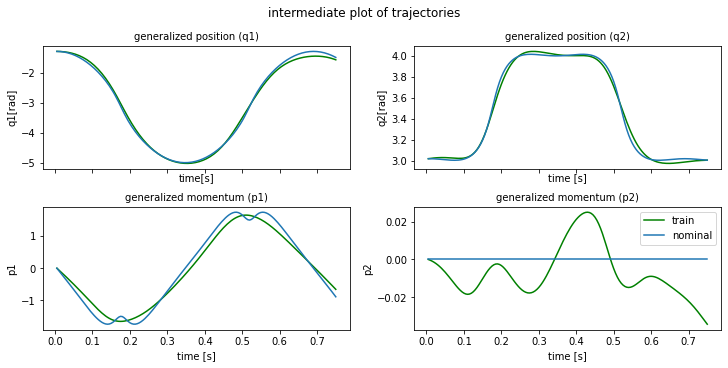

plot time : 1.3416223526000977
epoch  350 | train time 2.69 | train loss 7.014739e-03 | test loss 9.518179e-03 | test time 0.41  
epoch  351 | train time 1.28 | train loss 6.786270e-03 
epoch  352 | train time 1.37 | train loss 6.620436e-03 
epoch  353 | train time 1.27 | train loss 6.509755e-03 
epoch  354 | train time 1.26 | train loss 6.527087e-03 
epoch  355 | train time 1.25 | train loss 6.323001e-03 
epoch  356 | train time 1.27 | train loss 6.213093e-03 
epoch  357 | train time 1.27 | train loss 6.153331e-03 
epoch  358 | train time 1.35 | train loss 6.087334e-03 
epoch  359 | train time 1.26 | train loss 5.992451e-03 


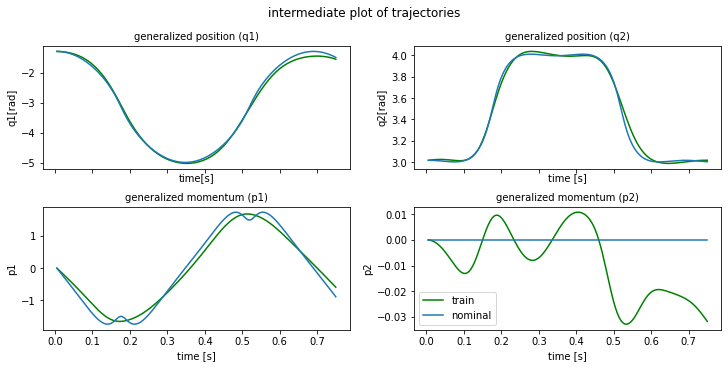

plot time : 1.2265269756317139
epoch  360 | train time 2.64 | train loss 5.935611e-03 | test loss 8.583955e-03 | test time 0.55  
epoch  361 | train time 1.39 | train loss 5.793513e-03 
epoch  362 | train time 1.27 | train loss 5.797605e-03 
epoch  363 | train time 1.27 | train loss 5.720006e-03 
epoch  364 | train time 1.52 | train loss 5.643795e-03 
epoch  365 | train time 1.34 | train loss 5.567322e-03 
epoch  366 | train time 1.44 | train loss 5.545753e-03 
epoch  367 | train time 1.26 | train loss 5.490156e-03 
epoch  368 | train time 1.30 | train loss 5.398290e-03 
epoch  369 | train time 1.26 | train loss 5.361837e-03 


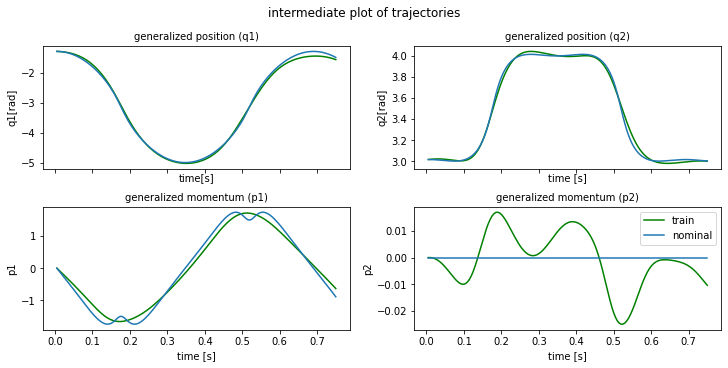

plot time : 1.2499184608459473
epoch  370 | train time 2.57 | train loss 5.336883e-03 | test loss 8.023948e-03 | test time 0.41  
epoch  371 | train time 1.47 | train loss 5.274613e-03 
epoch  372 | train time 1.33 | train loss 5.208855e-03 
epoch  373 | train time 1.40 | train loss 5.179793e-03 
epoch  374 | train time 1.30 | train loss 5.133799e-03 
epoch  375 | train time 1.26 | train loss 5.100735e-03 
epoch  376 | train time 1.41 | train loss 5.048864e-03 
epoch  377 | train time 1.42 | train loss 5.011381e-03 
epoch  378 | train time 1.43 | train loss 4.971407e-03 
epoch  379 | train time 1.28 | train loss 4.940283e-03 


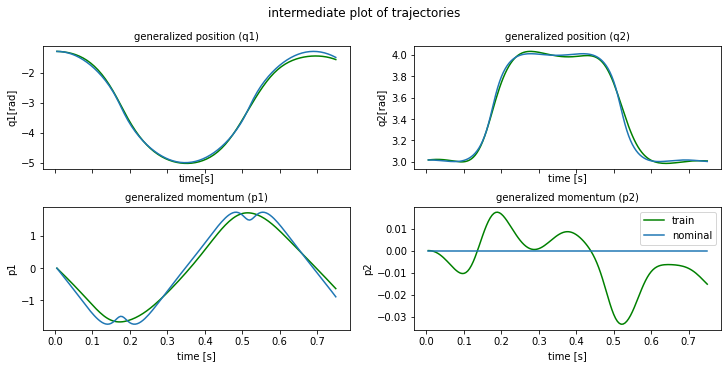

plot time : 1.2981219291687012
epoch  380 | train time 2.76 | train loss 4.893772e-03 | test loss 7.627612e-03 | test time 0.45  
epoch  381 | train time 1.26 | train loss 4.863332e-03 
epoch  382 | train time 1.30 | train loss 4.830902e-03 
epoch  383 | train time 1.27 | train loss 4.799692e-03 
epoch  384 | train time 1.36 | train loss 4.755436e-03 
epoch  385 | train time 1.28 | train loss 4.732484e-03 
epoch  386 | train time 1.32 | train loss 4.701882e-03 
epoch  387 | train time 1.24 | train loss 4.668720e-03 
epoch  388 | train time 1.28 | train loss 4.638674e-03 
epoch  389 | train time 1.26 | train loss 4.609677e-03 


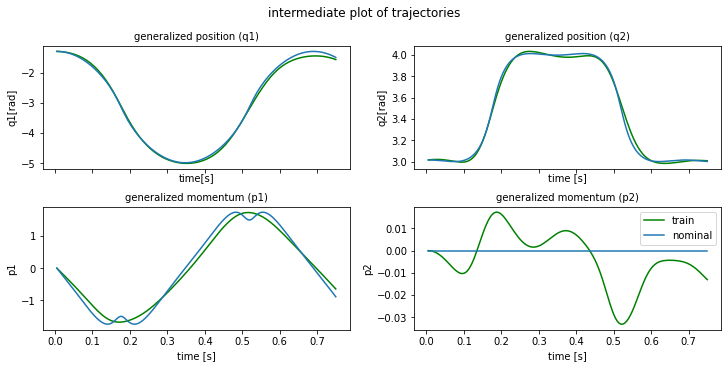

plot time : 1.1944646835327148
epoch  390 | train time 2.60 | train loss 4.583736e-03 | test loss 7.171482e-03 | test time 0.42  
epoch  391 | train time 1.30 | train loss 4.554090e-03 
epoch  392 | train time 1.38 | train loss 4.528920e-03 
epoch  393 | train time 1.41 | train loss 4.500749e-03 
epoch  394 | train time 1.42 | train loss 4.476851e-03 
epoch  395 | train time 1.25 | train loss 4.449990e-03 
epoch  396 | train time 1.29 | train loss 4.425340e-03 
epoch  397 | train time 1.39 | train loss 4.402170e-03 
epoch  398 | train time 1.39 | train loss 4.379448e-03 
epoch  399 | train time 1.40 | train loss 4.354351e-03 
horizon length : 200
min max values updated


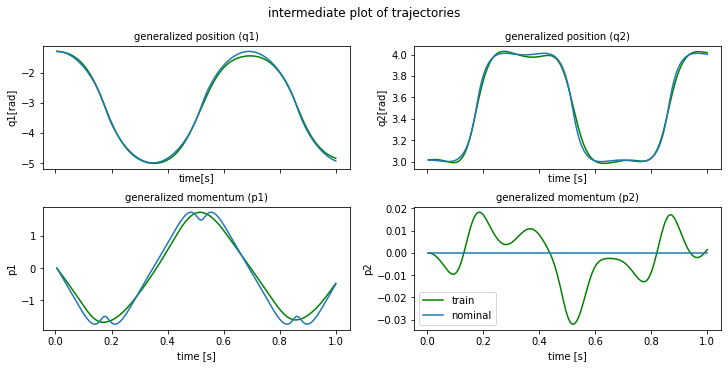

plot time : 1.1824800968170166
min max values updated
epoch  400 | train time 2.97 | train loss 9.343230e-03 | test loss 1.226336e-02 | test time 0.56  
epoch  401 | train time 1.89 | train loss 8.879564e-03 
epoch  402 | train time 1.74 | train loss 9.082890e-03 
epoch  403 | train time 2.09 | train loss 8.522949e-03 
epoch  404 | train time 1.71 | train loss 7.816903e-03 
epoch  405 | train time 1.68 | train loss 7.683233e-03 
epoch  406 | train time 1.73 | train loss 7.842953e-03 
epoch  407 | train time 1.68 | train loss 7.666698e-03 
epoch  408 | train time 1.68 | train loss 7.410279e-03 
epoch  409 | train time 1.85 | train loss 7.054912e-03 


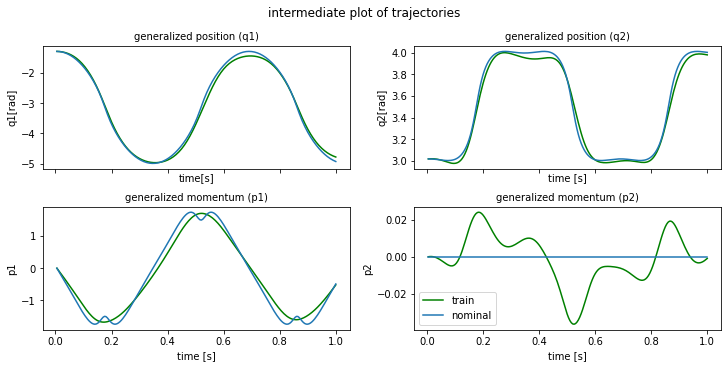

plot time : 1.5164012908935547
epoch  410 | train time 3.78 | train loss 6.801304e-03 | test loss 9.836741e-03 | test time 0.79  
epoch  411 | train time 1.89 | train loss 6.812210e-03 
epoch  412 | train time 1.69 | train loss 6.819711e-03 
epoch  413 | train time 1.70 | train loss 6.802165e-03 
epoch  414 | train time 1.70 | train loss 6.499867e-03 
epoch  415 | train time 1.66 | train loss 6.408611e-03 
epoch  416 | train time 1.79 | train loss 6.356268e-03 
epoch  417 | train time 1.84 | train loss 6.278445e-03 
epoch  418 | train time 1.75 | train loss 6.302910e-03 
epoch  419 | train time 1.83 | train loss 6.147635e-03 


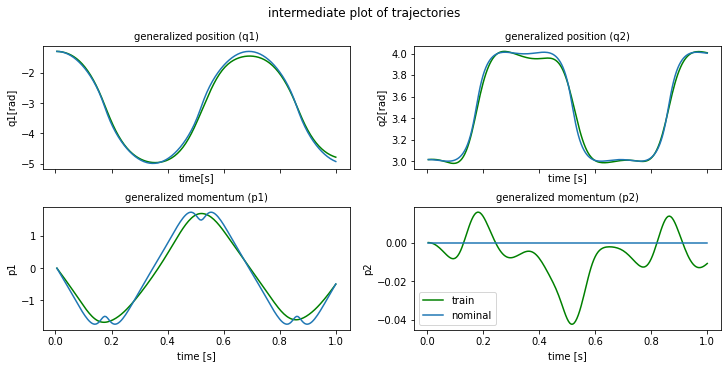

plot time : 1.1556107997894287
epoch  420 | train time 2.90 | train loss 6.010321e-03 | test loss 9.291179e-03 | test time 0.54  
epoch  421 | train time 1.73 | train loss 5.916479e-03 
epoch  422 | train time 1.88 | train loss 5.877465e-03 
epoch  423 | train time 1.69 | train loss 5.848899e-03 
epoch  424 | train time 1.84 | train loss 5.840885e-03 
epoch  425 | train time 1.74 | train loss 5.793788e-03 
epoch  426 | train time 1.89 | train loss 5.709713e-03 
epoch  427 | train time 1.84 | train loss 5.610130e-03 
epoch  428 | train time 2.02 | train loss 5.552697e-03 
epoch  429 | train time 1.82 | train loss 5.492035e-03 


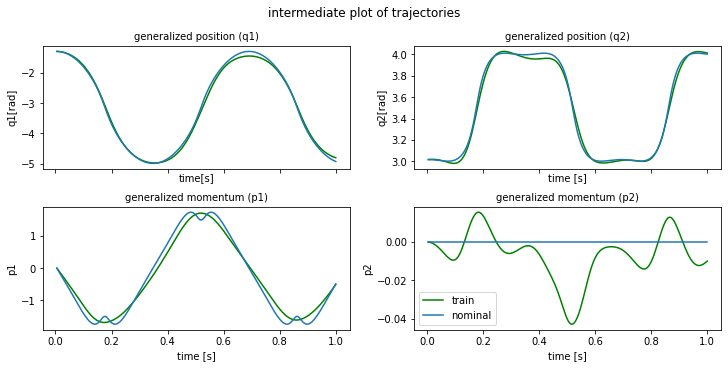

plot time : 1.1605489253997803
epoch  430 | train time 2.87 | train loss 5.430131e-03 | test loss 8.629258e-03 | test time 0.67  
epoch  431 | train time 1.81 | train loss 5.424214e-03 
epoch  432 | train time 1.81 | train loss 5.375317e-03 
epoch  433 | train time 1.68 | train loss 5.365029e-03 
epoch  434 | train time 1.71 | train loss 5.375857e-03 
epoch  435 | train time 1.77 | train loss 5.383044e-03 
epoch  436 | train time 1.75 | train loss 5.411123e-03 
epoch  437 | train time 1.68 | train loss 5.475042e-03 
epoch  438 | train time 1.67 | train loss 5.595634e-03 
epoch  439 | train time 1.89 | train loss 5.798153e-03 


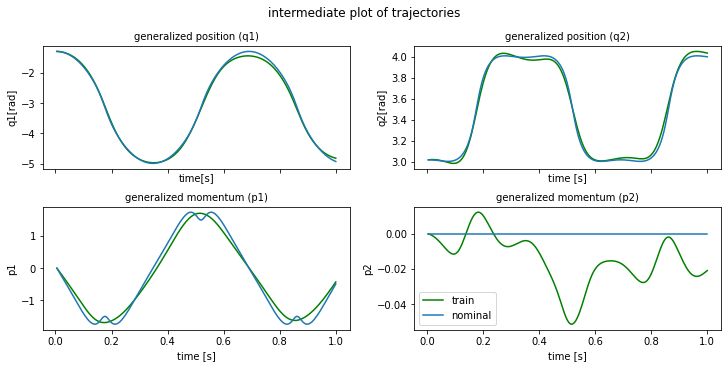

plot time : 1.2638213634490967
epoch  440 | train time 3.19 | train loss 6.179382e-03 | test loss 1.005743e-02 | test time 0.54  
epoch  441 | train time 1.68 | train loss 6.729189e-03 
epoch  442 | train time 1.76 | train loss 7.581524e-03 
epoch  443 | train time 1.67 | train loss 8.347062e-03 
epoch  444 | train time 1.70 | train loss 8.832688e-03 
epoch  445 | train time 1.74 | train loss 8.008122e-03 
epoch  446 | train time 1.79 | train loss 6.508209e-03 
epoch  447 | train time 1.86 | train loss 5.159963e-03 
epoch  448 | train time 1.69 | train loss 5.002531e-03 
epoch  449 | train time 1.70 | train loss 5.807206e-03 


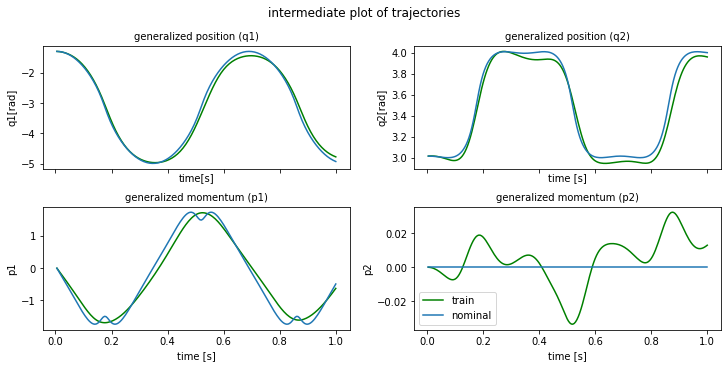

plot time : 1.1730692386627197
epoch  450 | train time 2.90 | train loss 6.439599e-03 | test loss 8.239788e-03 | test time 0.55  
epoch  451 | train time 1.69 | train loss 6.202432e-03 
epoch  452 | train time 1.83 | train loss 5.296998e-03 
epoch  453 | train time 1.76 | train loss 4.790047e-03 
epoch  454 | train time 1.68 | train loss 5.071345e-03 
epoch  455 | train time 1.86 | train loss 5.555982e-03 
epoch  456 | train time 1.69 | train loss 5.556482e-03 
epoch  457 | train time 1.76 | train loss 5.046872e-03 
epoch  458 | train time 1.83 | train loss 4.690642e-03 
epoch  459 | train time 1.70 | train loss 4.819655e-03 


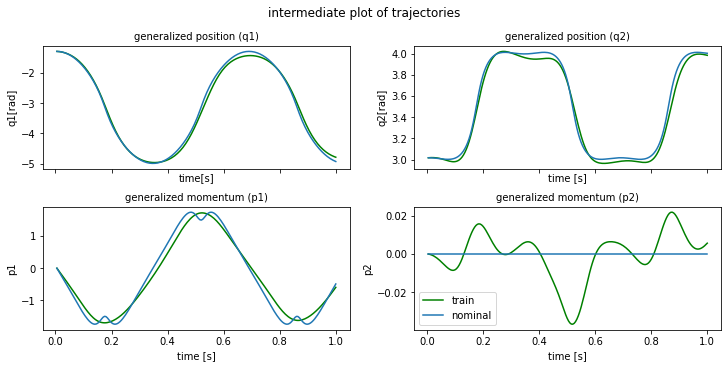

plot time : 1.1641991138458252
epoch  460 | train time 2.96 | train loss 5.115724e-03 | test loss 7.420651e-03 | test time 0.57  
epoch  461 | train time 1.68 | train loss 5.137828e-03 
epoch  462 | train time 1.68 | train loss 4.838039e-03 
epoch  463 | train time 1.75 | train loss 4.594564e-03 
epoch  464 | train time 1.69 | train loss 4.635210e-03 
epoch  465 | train time 1.98 | train loss 4.810342e-03 
epoch  466 | train time 2.02 | train loss 4.847813e-03 
epoch  467 | train time 1.97 | train loss 4.682763e-03 
epoch  468 | train time 1.68 | train loss 4.510028e-03 
epoch  469 | train time 1.68 | train loss 4.486688e-03 


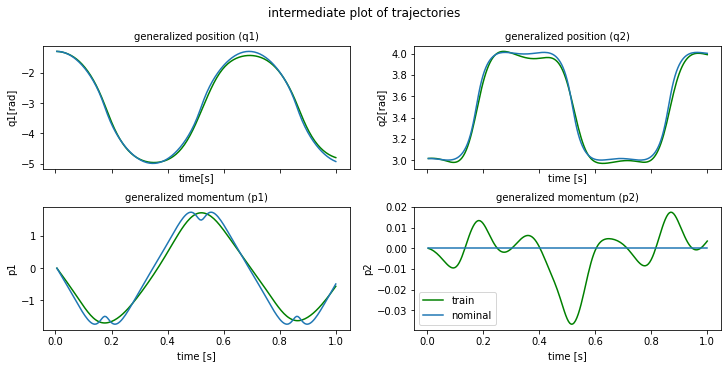

plot time : 1.231687307357788
epoch  470 | train time 2.98 | train loss 4.577263e-03 | test loss 6.950471e-03 | test time 0.60  
epoch  471 | train time 1.88 | train loss 4.632656e-03 
epoch  472 | train time 1.68 | train loss 4.569021e-03 
epoch  473 | train time 1.66 | train loss 4.449749e-03 
epoch  474 | train time 1.90 | train loss 4.377711e-03 
epoch  475 | train time 1.67 | train loss 4.389829e-03 
epoch  476 | train time 1.71 | train loss 4.436279e-03 
epoch  477 | train time 1.69 | train loss 4.445671e-03 
epoch  478 | train time 1.78 | train loss 4.398478e-03 
epoch  479 | train time 1.68 | train loss 4.325621e-03 


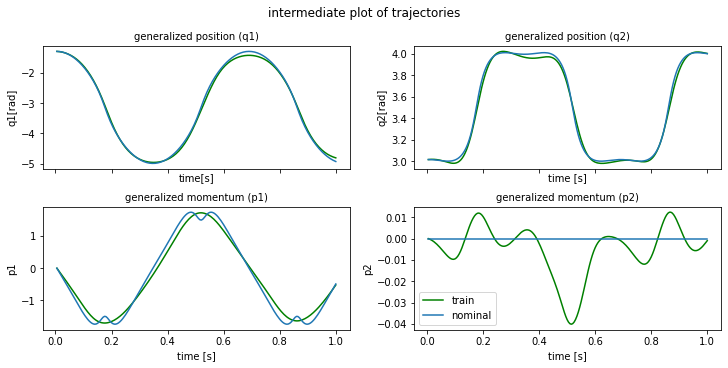

plot time : 1.1587224006652832
epoch  480 | train time 3.04 | train loss 4.275209e-03 | test loss 6.643252e-03 | test time 0.69  
epoch  481 | train time 1.88 | train loss 4.265922e-03 
epoch  482 | train time 1.85 | train loss 4.281249e-03 
epoch  483 | train time 1.78 | train loss 4.291189e-03 
epoch  484 | train time 2.09 | train loss 4.275782e-03 
epoch  485 | train time 1.83 | train loss 4.238442e-03 
epoch  486 | train time 1.80 | train loss 4.194831e-03 
epoch  487 | train time 1.71 | train loss 4.161793e-03 
epoch  488 | train time 1.66 | train loss 4.145614e-03 
epoch  489 | train time 1.67 | train loss 4.142237e-03 


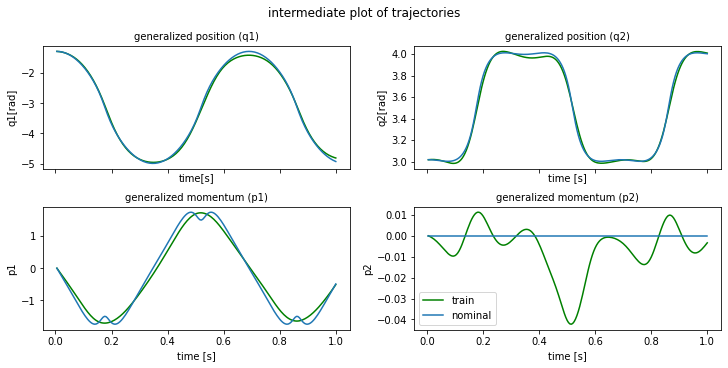

plot time : 1.2542705535888672
epoch  490 | train time 3.16 | train loss 4.142229e-03 | test loss 6.496294e-03 | test time 0.53  
epoch  491 | train time 1.68 | train loss 4.137192e-03 
epoch  492 | train time 1.97 | train loss 4.123712e-03 
epoch  493 | train time 1.84 | train loss 4.102219e-03 
epoch  494 | train time 1.69 | train loss 4.076744e-03 
epoch  495 | train time 1.94 | train loss 4.051156e-03 
epoch  496 | train time 1.92 | train loss 4.028488e-03 
epoch  497 | train time 1.75 | train loss 4.010058e-03 
epoch  498 | train time 1.82 | train loss 3.995642e-03 
epoch  499 | train time 1.75 | train loss 3.984238e-03 
horizon length : 250
min max values updated


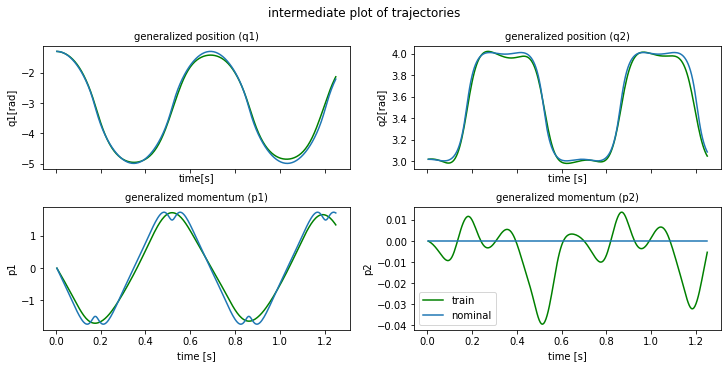

plot time : 1.2296946048736572
min max values updated
epoch  500 | train time 3.46 | train loss 5.856009e-03 | test loss 1.259971e-02 | test time 0.69  
epoch  501 | train time 2.18 | train loss 7.962577e-03 
epoch  502 | train time 2.15 | train loss 2.344914e-02 
epoch  503 | train time 2.11 | train loss 1.298259e-01 
epoch  504 | train time 2.29 | train loss 3.482740e-01 
epoch  505 | train time 2.13 | train loss 6.307508e-02 
epoch  506 | train time 2.15 | train loss 3.138211e-01 
epoch  507 | train time 2.14 | train loss 3.528558e-02 
epoch  508 | train time 2.10 | train loss 2.067294e-01 
epoch  509 | train time 2.11 | train loss 1.270870e-01 


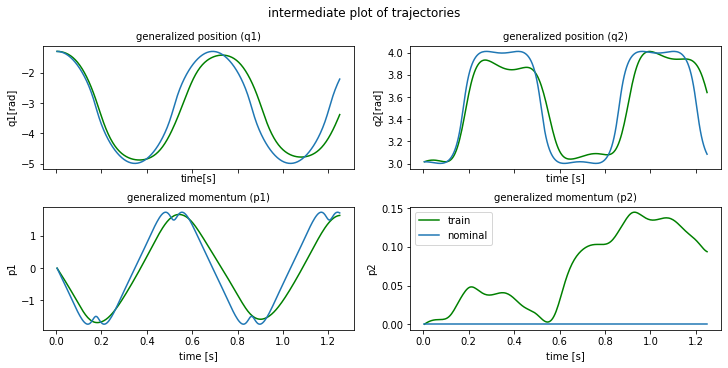

plot time : 1.1810615062713623
epoch  510 | train time 3.34 | train loss 4.325591e-02 | test loss 1.378018e-01 | test time 0.70  
epoch  511 | train time 2.10 | train loss 1.485711e-01 
epoch  512 | train time 2.33 | train loss 7.446592e-02 
epoch  513 | train time 2.37 | train loss 5.199952e-02 
epoch  514 | train time 2.12 | train loss 9.388888e-02 
epoch  515 | train time 2.28 | train loss 5.361610e-02 
epoch  516 | train time 2.20 | train loss 5.367251e-02 
epoch  517 | train time 2.09 | train loss 4.979519e-02 
epoch  518 | train time 2.47 | train loss 5.304806e-02 
epoch  519 | train time 2.35 | train loss 4.161032e-02 


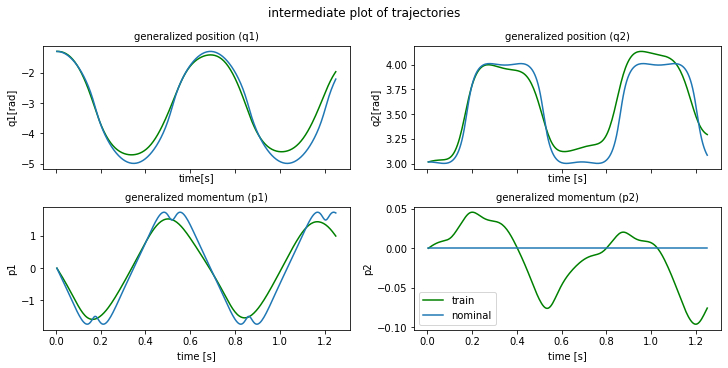

plot time : 1.225128412246704
epoch  520 | train time 3.38 | train loss 3.273278e-02 | test loss 3.909313e-02 | test time 0.69  
epoch  521 | train time 2.26 | train loss 3.769543e-02 
epoch  522 | train time 2.47 | train loss 4.225155e-02 
epoch  523 | train time 2.26 | train loss 2.210177e-02 
epoch  524 | train time 2.37 | train loss 2.347810e-02 
epoch  525 | train time 2.15 | train loss 3.358719e-02 
epoch  526 | train time 2.31 | train loss 2.404121e-02 
epoch  527 | train time 3.03 | train loss 2.118790e-02 
epoch  528 | train time 2.30 | train loss 1.851341e-02 
epoch  529 | train time 2.43 | train loss 2.226397e-02 


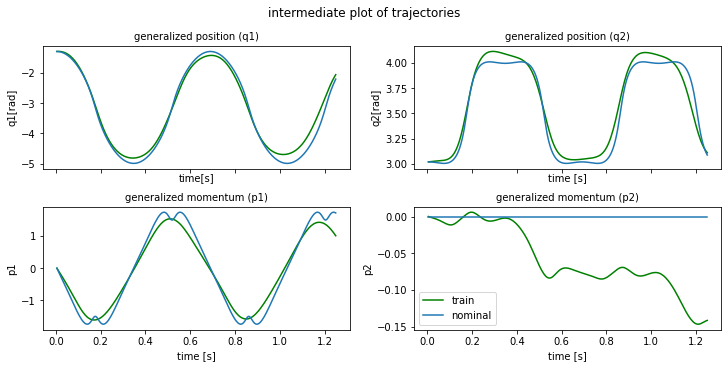

plot time : 1.1587672233581543
epoch  530 | train time 3.30 | train loss 2.149851e-02 | test loss 2.428666e-02 | test time 0.71  
epoch  531 | train time 2.28 | train loss 1.741943e-02 
epoch  532 | train time 2.13 | train loss 1.594277e-02 
epoch  533 | train time 2.36 | train loss 1.868874e-02 
epoch  534 | train time 2.14 | train loss 1.618840e-02 
epoch  535 | train time 2.11 | train loss 1.549176e-02 
epoch  536 | train time 2.31 | train loss 1.484770e-02 
epoch  537 | train time 2.13 | train loss 1.283186e-02 
epoch  538 | train time 2.14 | train loss 1.455250e-02 
epoch  539 | train time 2.27 | train loss 1.184448e-02 


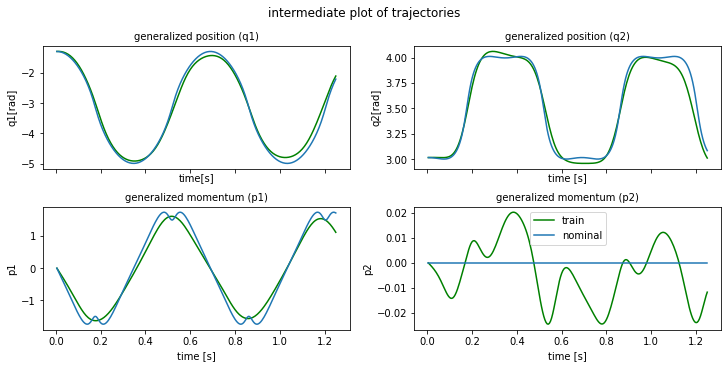

plot time : 1.228201150894165
epoch  540 | train time 3.50 | train loss 1.293043e-02 | test loss 1.266609e-02 | test time 0.69  
epoch  541 | train time 2.28 | train loss 1.205151e-02 
epoch  542 | train time 2.12 | train loss 1.089764e-02 
epoch  543 | train time 2.19 | train loss 1.145330e-02 
epoch  544 | train time 2.21 | train loss 1.048421e-02 
epoch  545 | train time 2.20 | train loss 1.063340e-02 
epoch  546 | train time 2.23 | train loss 9.998487e-03 
epoch  547 | train time 2.46 | train loss 9.364049e-03 
epoch  548 | train time 2.38 | train loss 9.503208e-03 
epoch  549 | train time 2.25 | train loss 9.515370e-03 


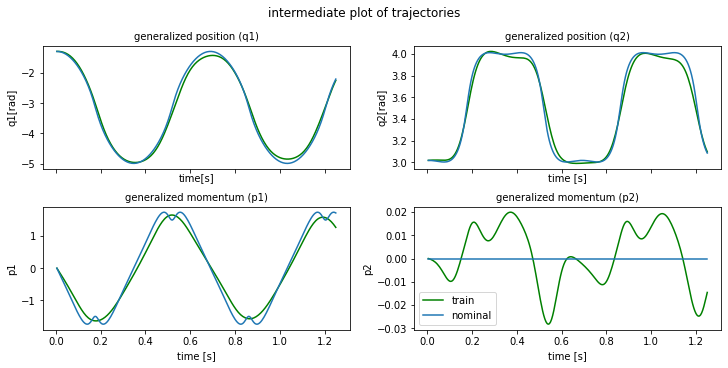

plot time : 1.2588536739349365
epoch  550 | train time 3.43 | train loss 8.699537e-03 | test loss 9.940846e-03 | test time 0.71  
epoch  551 | train time 2.32 | train loss 8.676251e-03 
epoch  552 | train time 2.23 | train loss 8.251663e-03 
epoch  553 | train time 2.22 | train loss 8.597184e-03 
epoch  554 | train time 2.33 | train loss 8.173289e-03 
epoch  555 | train time 2.13 | train loss 7.657839e-03 
epoch  556 | train time 2.14 | train loss 7.989106e-03 
epoch  557 | train time 2.23 | train loss 7.654740e-03 
epoch  558 | train time 2.10 | train loss 7.597176e-03 
epoch  559 | train time 2.12 | train loss 7.230857e-03 


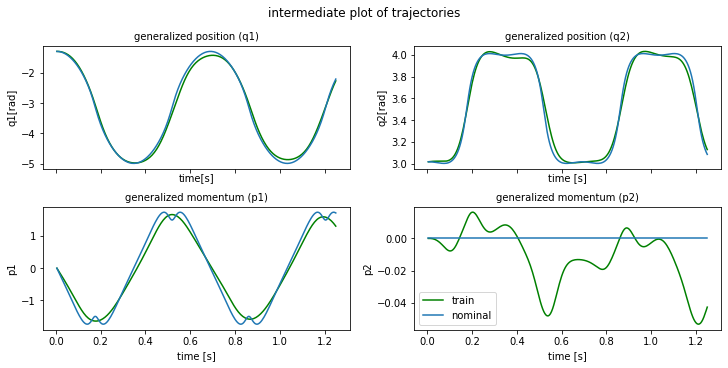

plot time : 1.1667141914367676
epoch  560 | train time 3.41 | train loss 7.248802e-03 | test loss 9.067304e-03 | test time 0.68  
epoch  561 | train time 2.30 | train loss 7.233524e-03 
epoch  562 | train time 2.11 | train loss 7.015121e-03 
epoch  563 | train time 2.11 | train loss 6.902693e-03 
epoch  564 | train time 2.38 | train loss 6.854363e-03 
epoch  565 | train time 2.26 | train loss 6.668763e-03 
epoch  566 | train time 2.26 | train loss 6.678179e-03 
epoch  567 | train time 2.20 | train loss 6.550389e-03 
epoch  568 | train time 2.31 | train loss 6.484225e-03 
epoch  569 | train time 2.08 | train loss 6.377450e-03 


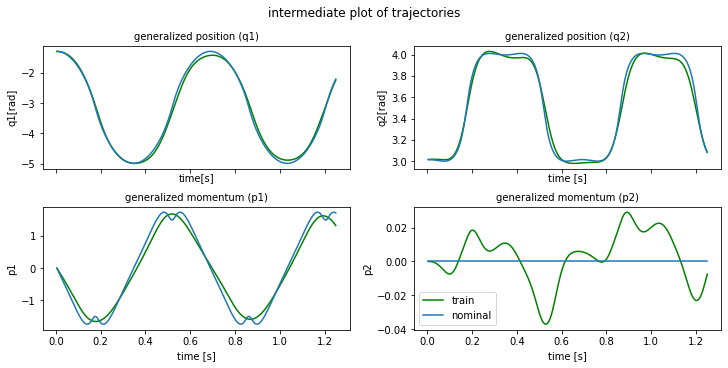

plot time : 1.1969680786132812
epoch  570 | train time 3.41 | train loss 6.306106e-03 | test loss 8.110357e-03 | test time 0.69  
epoch  571 | train time 2.12 | train loss 6.329013e-03 
epoch  572 | train time 2.13 | train loss 6.144107e-03 
epoch  573 | train time 2.23 | train loss 6.117105e-03 
epoch  574 | train time 2.19 | train loss 6.064589e-03 
epoch  575 | train time 2.18 | train loss 6.036368e-03 
epoch  576 | train time 2.26 | train loss 5.941063e-03 
epoch  577 | train time 2.10 | train loss 5.879232e-03 
epoch  578 | train time 2.14 | train loss 5.867181e-03 
epoch  579 | train time 2.32 | train loss 5.805860e-03 


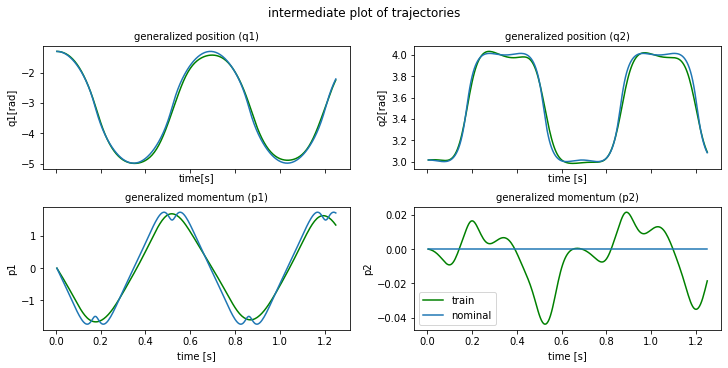

plot time : 1.2467920780181885
epoch  580 | train time 3.65 | train loss 5.735280e-03 | test loss 7.410719e-03 | test time 0.84  
epoch  581 | train time 2.39 | train loss 5.718685e-03 
epoch  582 | train time 2.21 | train loss 5.663355e-03 
epoch  583 | train time 2.79 | train loss 5.630318e-03 
epoch  584 | train time 3.59 | train loss 5.571354e-03 
epoch  585 | train time 2.19 | train loss 5.555095e-03 
epoch  586 | train time 2.14 | train loss 5.504979e-03 
epoch  587 | train time 2.54 | train loss 5.464880e-03 
epoch  588 | train time 2.09 | train loss 5.438942e-03 
epoch  589 | train time 2.14 | train loss 5.395852e-03 


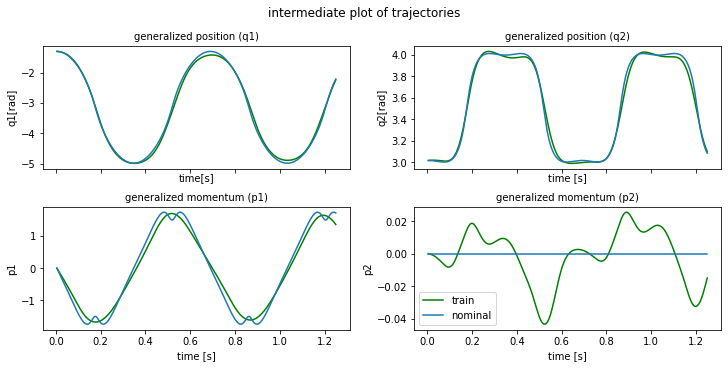

plot time : 1.3376288414001465
epoch  590 | train time 3.53 | train loss 5.361784e-03 | test loss 7.026807e-03 | test time 0.67  
epoch  591 | train time 2.12 | train loss 5.331001e-03 
epoch  592 | train time 2.29 | train loss 5.301208e-03 
epoch  593 | train time 2.09 | train loss 5.263238e-03 
epoch  594 | train time 2.31 | train loss 5.230128e-03 
epoch  595 | train time 2.16 | train loss 5.211625e-03 
epoch  596 | train time 2.19 | train loss 5.174967e-03 
epoch  597 | train time 2.29 | train loss 5.144447e-03 
epoch  598 | train time 2.36 | train loss 5.118818e-03 
epoch  599 | train time 2.45 | train loss 5.093412e-03 
horizon length : 300
min max values updated


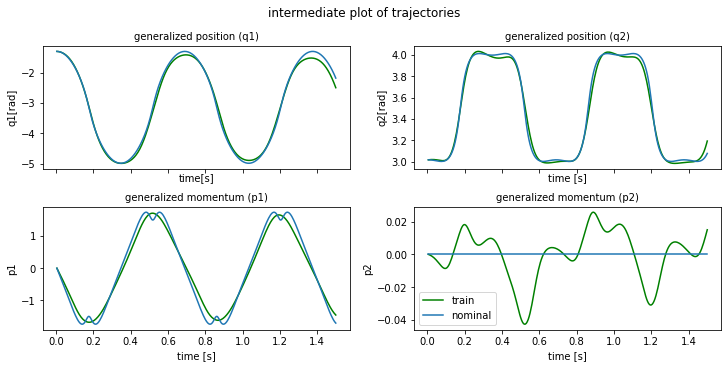

plot time : 1.2607498168945312
min max values updated
epoch  600 | train time 4.10 | train loss 7.691859e-03 | test loss 9.948285e-03 | test time 0.86  
epoch  601 | train time 2.86 | train loss 7.989733e-03 
epoch  602 | train time 2.70 | train loss 7.071347e-03 
epoch  603 | train time 3.08 | train loss 7.587793e-03 
epoch  604 | train time 2.55 | train loss 6.920288e-03 
epoch  605 | train time 2.73 | train loss 7.325134e-03 
epoch  606 | train time 2.67 | train loss 6.503240e-03 
epoch  607 | train time 2.68 | train loss 7.113620e-03 
epoch  608 | train time 2.69 | train loss 6.375247e-03 
epoch  609 | train time 2.59 | train loss 6.720695e-03 


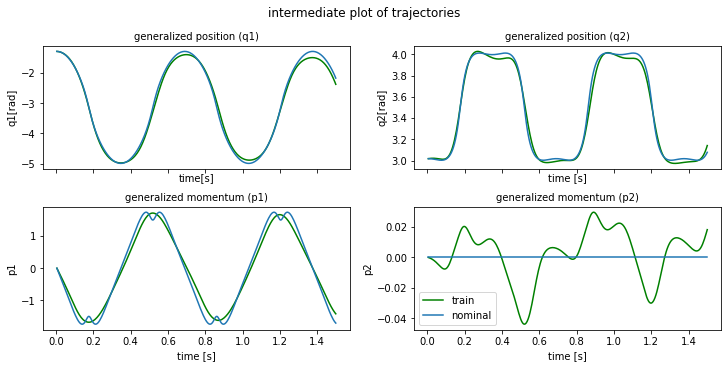

plot time : 1.1949121952056885
epoch  610 | train time 3.81 | train loss 6.355049e-03 | test loss 8.428044e-03 | test time 1.02  
epoch  611 | train time 2.89 | train loss 6.478854e-03 
epoch  612 | train time 2.67 | train loss 6.220853e-03 
epoch  613 | train time 2.79 | train loss 6.226712e-03 
epoch  614 | train time 2.52 | train loss 6.232156e-03 
epoch  615 | train time 2.53 | train loss 5.955717e-03 
epoch  616 | train time 2.77 | train loss 6.121156e-03 
epoch  617 | train time 2.73 | train loss 5.876724e-03 
epoch  618 | train time 2.77 | train loss 5.948657e-03 
epoch  619 | train time 3.68 | train loss 5.766019e-03 


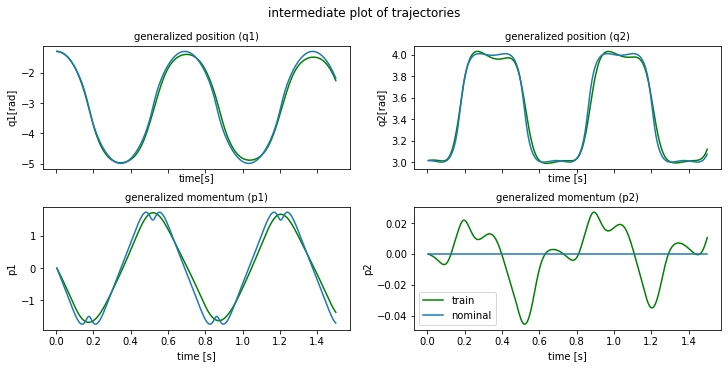

plot time : 1.1988484859466553
epoch  620 | train time 4.22 | train loss 5.870099e-03 | test loss 7.398759e-03 | test time 0.88  
epoch  621 | train time 2.76 | train loss 5.643389e-03 
epoch  622 | train time 2.68 | train loss 5.724156e-03 
epoch  623 | train time 2.61 | train loss 5.607378e-03 
epoch  624 | train time 2.63 | train loss 5.594494e-03 
epoch  625 | train time 3.05 | train loss 5.525266e-03 
epoch  626 | train time 2.88 | train loss 5.498795e-03 
epoch  627 | train time 3.04 | train loss 5.468194e-03 
epoch  628 | train time 2.53 | train loss 5.383649e-03 
epoch  629 | train time 2.86 | train loss 5.407911e-03 


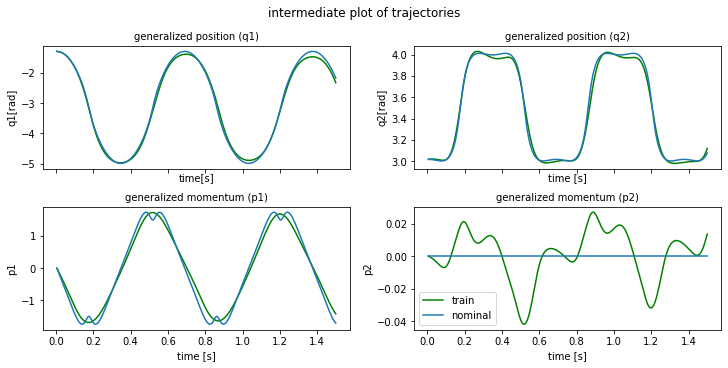

plot time : 1.2578411102294922
epoch  630 | train time 4.01 | train loss 5.322405e-03 | test loss 7.069631e-03 | test time 0.86  
epoch  631 | train time 2.94 | train loss 5.320461e-03 
epoch  632 | train time 2.53 | train loss 5.252575e-03 
epoch  633 | train time 2.53 | train loss 5.262263e-03 
epoch  634 | train time 2.74 | train loss 5.188453e-03 
epoch  635 | train time 2.52 | train loss 5.177969e-03 
epoch  636 | train time 2.61 | train loss 5.143899e-03 
epoch  637 | train time 2.82 | train loss 5.108842e-03 
epoch  638 | train time 2.64 | train loss 5.084227e-03 
epoch  639 | train time 2.63 | train loss 5.043957e-03 


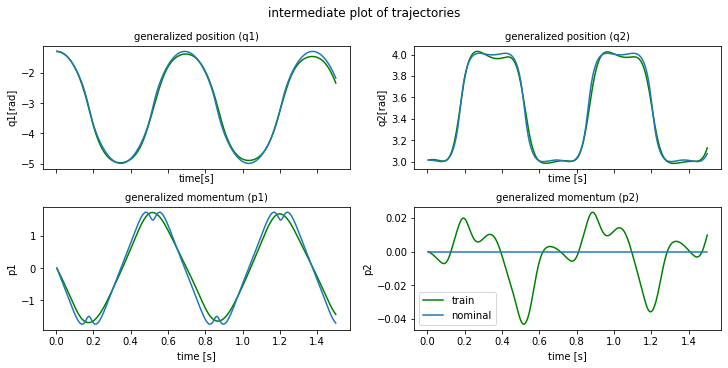

plot time : 1.1843938827514648
epoch  640 | train time 3.76 | train loss 5.034680e-03 | test loss 6.753015e-03 | test time 0.81  
epoch  641 | train time 2.68 | train loss 4.985572e-03 
epoch  642 | train time 2.56 | train loss 4.973688e-03 
epoch  643 | train time 2.61 | train loss 4.939271e-03 
epoch  644 | train time 2.54 | train loss 4.921129e-03 
epoch  645 | train time 2.52 | train loss 4.887209e-03 
epoch  646 | train time 2.97 | train loss 4.866188e-03 
epoch  647 | train time 2.72 | train loss 4.846002e-03 
epoch  648 | train time 2.63 | train loss 4.815255e-03 
epoch  649 | train time 2.56 | train loss 4.798013e-03 


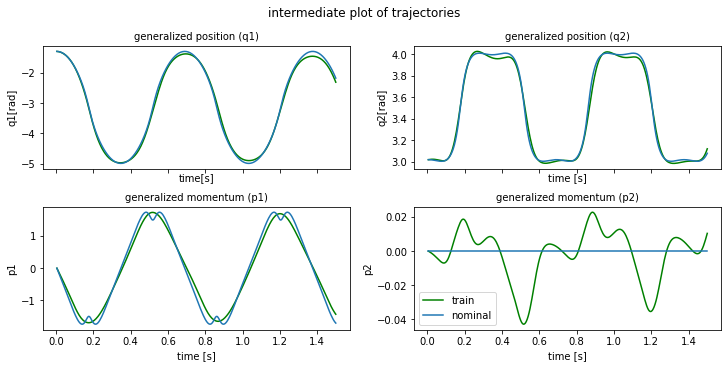

plot time : 1.2727417945861816
epoch  650 | train time 4.04 | train loss 4.769302e-03 | test loss 6.517393e-03 | test time 0.96  
epoch  651 | train time 2.78 | train loss 4.753730e-03 
epoch  652 | train time 2.75 | train loss 4.725842e-03 
epoch  653 | train time 2.56 | train loss 4.706423e-03 
epoch  654 | train time 2.53 | train loss 4.685880e-03 
epoch  655 | train time 2.67 | train loss 4.664326e-03 
epoch  656 | train time 2.76 | train loss 4.644835e-03 
epoch  657 | train time 2.55 | train loss 4.622101e-03 
epoch  658 | train time 2.52 | train loss 4.606236e-03 
epoch  659 | train time 2.59 | train loss 4.583884e-03 


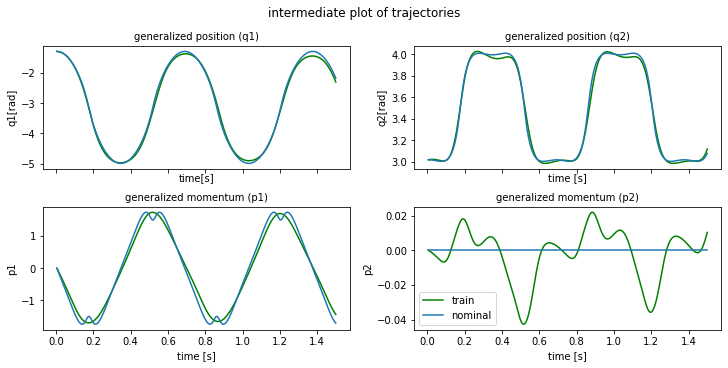

plot time : 1.3420305252075195
epoch  660 | train time 3.94 | train loss 4.566310e-03 | test loss 6.347198e-03 | test time 0.85  
epoch  661 | train time 2.58 | train loss 4.546553e-03 
epoch  662 | train time 2.64 | train loss 4.528497e-03 
epoch  663 | train time 2.63 | train loss 4.511231e-03 
epoch  664 | train time 2.59 | train loss 4.491447e-03 
epoch  665 | train time 2.60 | train loss 4.475177e-03 
epoch  666 | train time 2.72 | train loss 4.456841e-03 
epoch  667 | train time 2.67 | train loss 4.440787e-03 
epoch  668 | train time 2.86 | train loss 4.422867e-03 
epoch  669 | train time 2.80 | train loss 4.406270e-03 


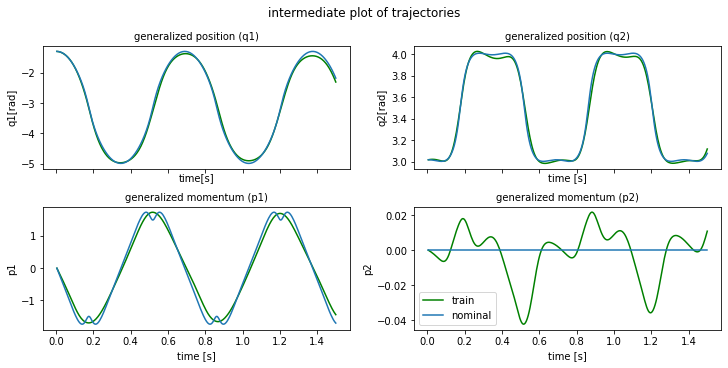

plot time : 1.1760072708129883
epoch  670 | train time 3.76 | train loss 4.390228e-03 | test loss 6.173142e-03 | test time 0.83  
epoch  671 | train time 2.66 | train loss 4.373503e-03 
epoch  672 | train time 2.81 | train loss 4.358130e-03 
epoch  673 | train time 2.56 | train loss 4.341360e-03 
epoch  674 | train time 2.70 | train loss 4.326348e-03 
epoch  675 | train time 2.52 | train loss 4.310783e-03 
epoch  676 | train time 2.53 | train loss 4.295580e-03 
epoch  677 | train time 2.81 | train loss 4.280569e-03 
epoch  678 | train time 2.55 | train loss 4.265404e-03 
epoch  679 | train time 2.82 | train loss 4.251125e-03 


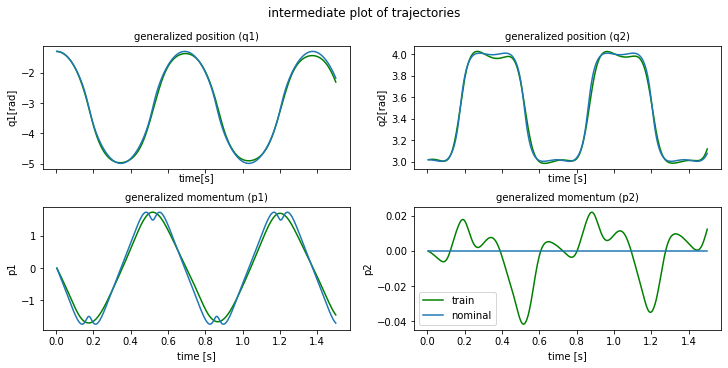

plot time : 1.2007575035095215
epoch  680 | train time 4.02 | train loss 4.236374e-03 | test loss 6.014288e-03 | test time 1.11  
epoch  681 | train time 2.55 | train loss 4.222224e-03 
epoch  682 | train time 2.61 | train loss 4.207880e-03 
epoch  683 | train time 2.77 | train loss 4.193816e-03 
epoch  684 | train time 2.65 | train loss 4.180179e-03 
epoch  685 | train time 2.65 | train loss 4.166322e-03 
epoch  686 | train time 2.89 | train loss 4.152921e-03 
epoch  687 | train time 2.74 | train loss 4.139383e-03 
epoch  688 | train time 2.69 | train loss 4.126177e-03 
epoch  689 | train time 2.69 | train loss 4.113110e-03 


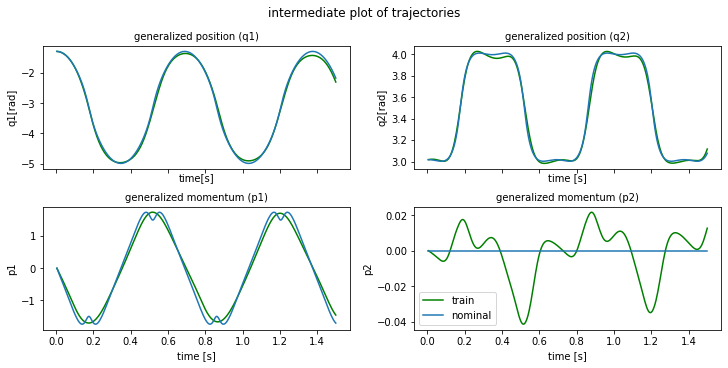

plot time : 1.1962804794311523
epoch  690 | train time 3.82 | train loss 4.100116e-03 | test loss 5.870285e-03 | test time 0.80  
epoch  691 | train time 2.51 | train loss 4.087375e-03 
epoch  692 | train time 2.57 | train loss 4.074539e-03 
epoch  693 | train time 2.76 | train loss 4.062034e-03 
epoch  694 | train time 2.61 | train loss 4.049610e-03 
epoch  695 | train time 2.54 | train loss 4.037254e-03 
epoch  696 | train time 3.05 | train loss 4.025125e-03 
epoch  697 | train time 2.93 | train loss 4.012968e-03 
epoch  698 | train time 2.52 | train loss 4.001059e-03 
epoch  699 | train time 2.58 | train loss 3.989188e-03 


In [7]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [8]:
if collect_grads:
    plot_grads(stats)

In [11]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [12]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [13]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

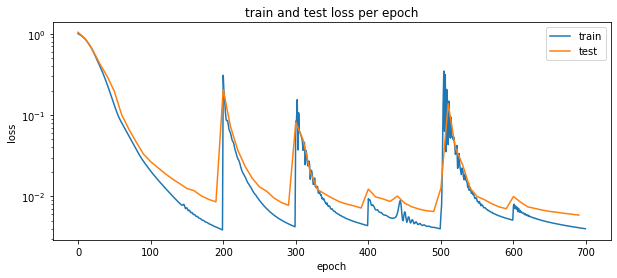

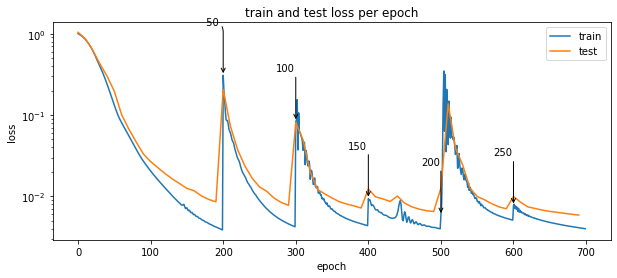

In [14]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

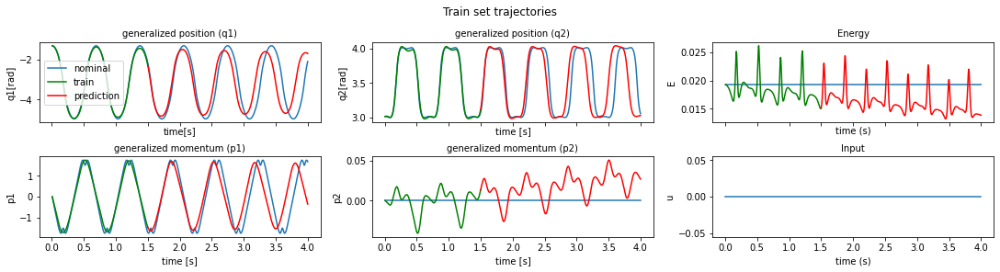

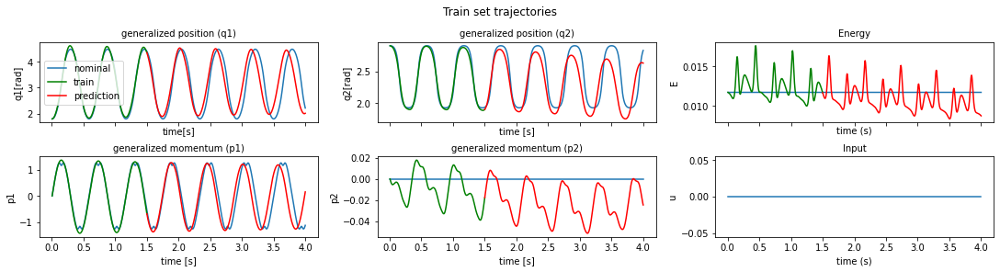

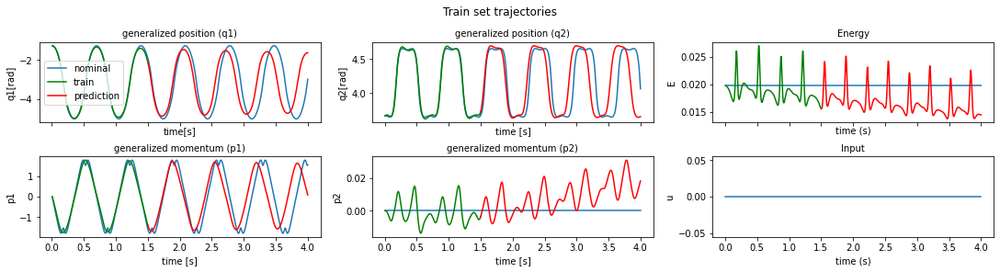

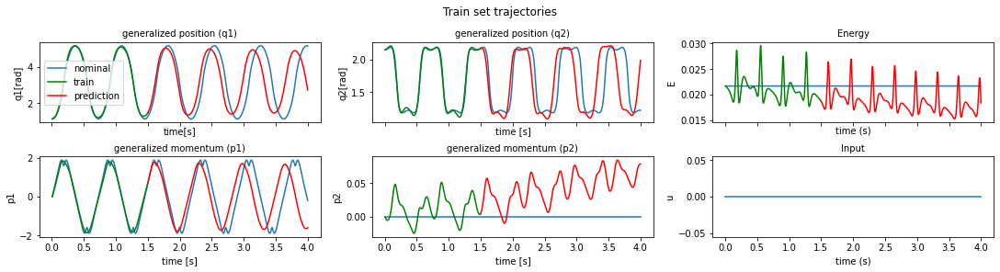

In [15]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

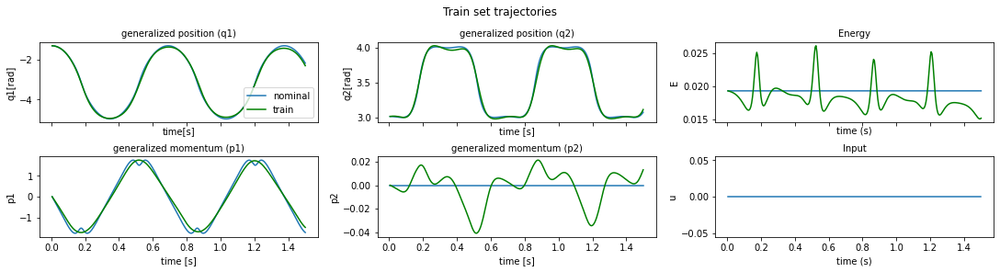

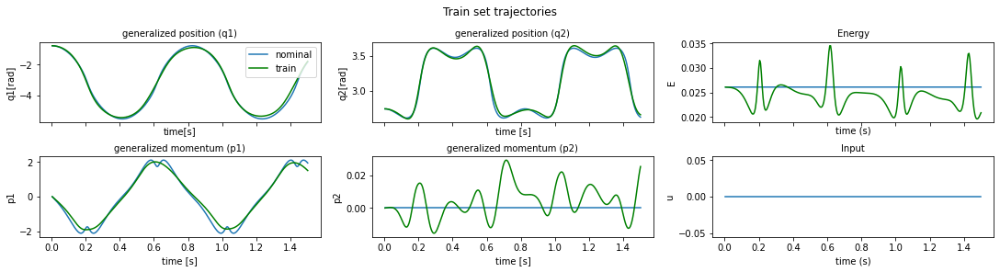

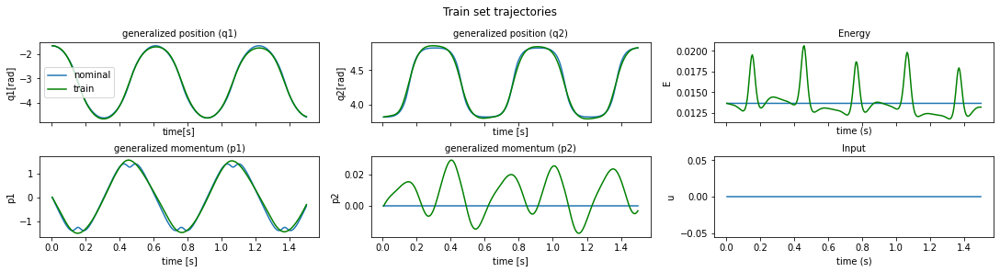

In [16]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + "nopred.png",
        w_rescale=w_rescale,
    )

##### 10k parameters - w horizon - with rescaling - with grad clipping

In [18]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800
num_trajectories = 125
proportion = 0.8
batch_size = 100
w_rescale = [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False
coord_type = "hamiltonian"
rescale_dims = [1, 1, 1, 0]
min_max_rescale = True

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = True
grad_clip = True  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)

cpu


In [19]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [20]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=70, nb_hidden_layers=2, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 10363
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p10k_Ts0.005_gradcl_nodissip_rescaledloss_trajminmaxrescale_
horizon_list and switch_steps have the same size


horizon length : 50
min max values updated


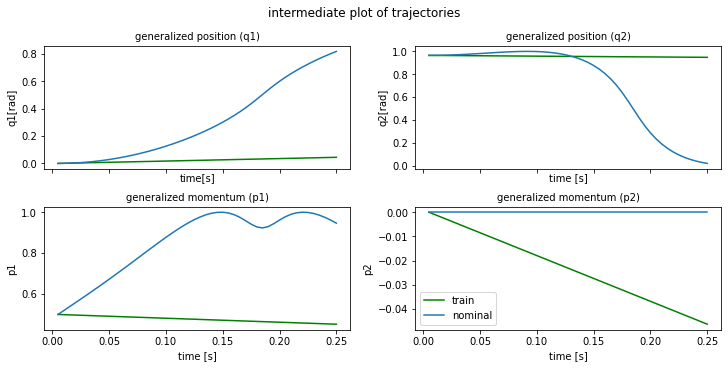

plot time : 1.2839457988739014
min max values updated
epoch    0 | train time 1.98 | train loss 1.040183e+00 | test loss 9.507450e-01 | test time 0.14  
epoch    1 | train time 0.46 | train loss 1.015715e+00 
epoch    2 | train time 0.44 | train loss 9.927585e-01 
epoch    3 | train time 0.48 | train loss 9.705535e-01 
epoch    4 | train time 0.52 | train loss 9.484185e-01 
epoch    5 | train time 0.43 | train loss 9.257317e-01 
epoch    6 | train time 0.42 | train loss 9.019488e-01 
epoch    7 | train time 0.46 | train loss 8.766154e-01 
epoch    8 | train time 0.47 | train loss 8.493602e-01 
epoch    9 | train time 0.49 | train loss 8.198862e-01 


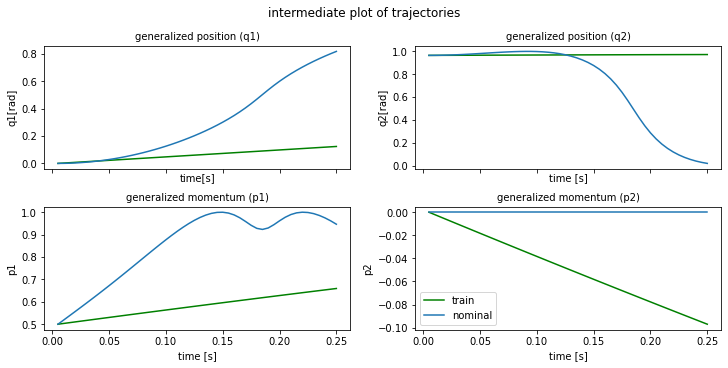

plot time : 1.2265369892120361
epoch   10 | train time 1.72 | train loss 7.879684e-01 | test loss 7.117250e-01 | test time 0.14  
epoch   11 | train time 0.42 | train loss 7.534598e-01 
epoch   12 | train time 0.42 | train loss 7.163061e-01 
epoch   13 | train time 0.59 | train loss 6.765706e-01 
epoch   14 | train time 0.42 | train loss 6.344726e-01 
epoch   15 | train time 0.41 | train loss 5.904368e-01 
epoch   16 | train time 0.42 | train loss 5.451429e-01 
epoch   17 | train time 0.43 | train loss 4.995689e-01 
epoch   18 | train time 0.43 | train loss 4.550143e-01 
epoch   19 | train time 0.42 | train loss 4.130826e-01 


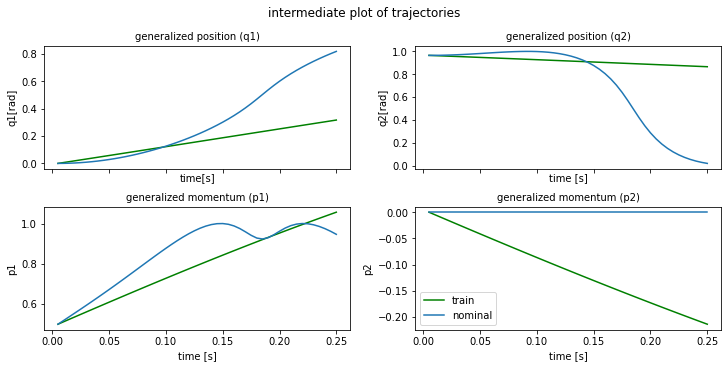

plot time : 1.240116834640503
epoch   20 | train time 1.69 | train loss 3.755890e-01 | test loss 3.283138e-01 | test time 0.19  
epoch   21 | train time 0.47 | train loss 3.443505e-01 
epoch   22 | train time 0.54 | train loss 3.208248e-01 
epoch   23 | train time 0.49 | train loss 3.056117e-01 
epoch   24 | train time 0.53 | train loss 2.979842e-01 
epoch   25 | train time 0.49 | train loss 2.957295e-01 
epoch   26 | train time 0.52 | train loss 2.955231e-01 
epoch   27 | train time 0.48 | train loss 2.938578e-01 
epoch   28 | train time 0.54 | train loss 2.882225e-01 
epoch   29 | train time 0.44 | train loss 2.778297e-01 


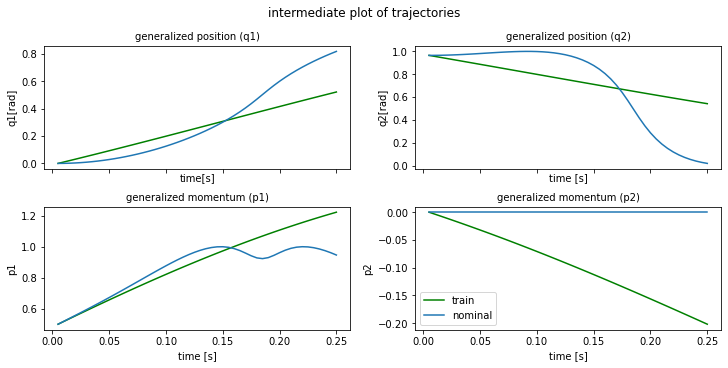

plot time : 1.1900393962860107
epoch   30 | train time 1.64 | train loss 2.635226e-01 | test loss 2.908440e-01 | test time 0.17  
epoch   31 | train time 0.42 | train loss 2.471865e-01 
epoch   32 | train time 0.42 | train loss 2.310949e-01 
epoch   33 | train time 0.42 | train loss 2.173481e-01 
epoch   34 | train time 0.42 | train loss 2.074024e-01 
epoch   35 | train time 0.43 | train loss 2.017139e-01 
epoch   36 | train time 0.42 | train loss 1.996344e-01 
epoch   37 | train time 0.44 | train loss 1.997167e-01 
epoch   38 | train time 0.42 | train loss 2.003729e-01 
epoch   39 | train time 0.42 | train loss 2.004828e-01 


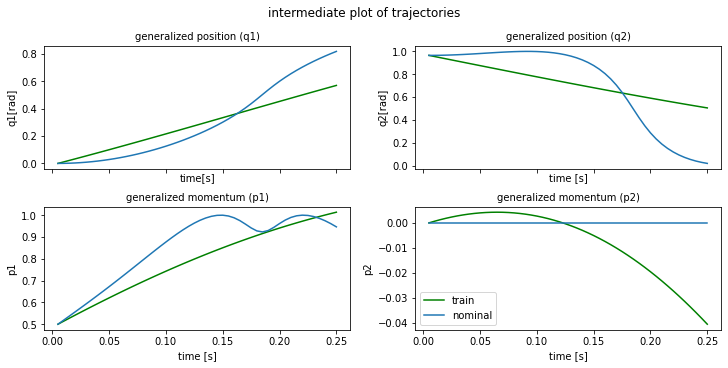

plot time : 1.2415969371795654
epoch   40 | train time 1.79 | train loss 1.995756e-01 | test loss 2.406880e-01 | test time 0.19  
epoch   41 | train time 0.42 | train loss 1.976491e-01 
epoch   42 | train time 0.43 | train loss 1.949346e-01 
epoch   43 | train time 0.45 | train loss 1.917907e-01 
epoch   44 | train time 0.49 | train loss 1.886880e-01 
epoch   45 | train time 0.45 | train loss 1.861393e-01 
epoch   46 | train time 0.42 | train loss 1.844961e-01 
epoch   47 | train time 0.54 | train loss 1.837298e-01 
epoch   48 | train time 0.42 | train loss 1.834432e-01 
epoch   49 | train time 0.43 | train loss 1.831669e-01 


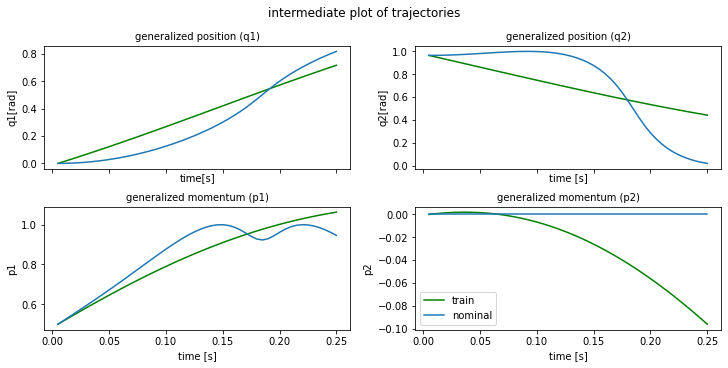

plot time : 1.159447193145752
epoch   50 | train time 1.60 | train loss 1.826258e-01 | test loss 2.549904e-01 | test time 0.14  
epoch   51 | train time 0.43 | train loss 1.816875e-01 
epoch   52 | train time 0.42 | train loss 1.801913e-01 
epoch   53 | train time 0.42 | train loss 1.780418e-01 
epoch   54 | train time 0.44 | train loss 1.754574e-01 
epoch   55 | train time 0.46 | train loss 1.728907e-01 
epoch   56 | train time 0.50 | train loss 1.706218e-01 
epoch   57 | train time 0.52 | train loss 1.685667e-01 
epoch   58 | train time 0.50 | train loss 1.665628e-01 
epoch   59 | train time 0.54 | train loss 1.646557e-01 


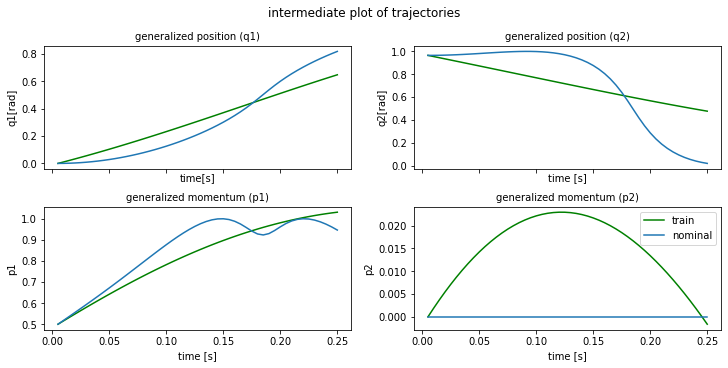

plot time : 1.1796684265136719
epoch   60 | train time 1.62 | train loss 1.629521e-01 | test loss 2.056210e-01 | test time 0.14  
epoch   61 | train time 0.46 | train loss 1.613372e-01 
epoch   62 | train time 0.42 | train loss 1.595732e-01 
epoch   63 | train time 0.44 | train loss 1.576333e-01 
epoch   64 | train time 0.43 | train loss 1.556546e-01 
epoch   65 | train time 0.41 | train loss 1.536203e-01 
epoch   66 | train time 0.42 | train loss 1.514055e-01 
epoch   67 | train time 0.42 | train loss 1.490795e-01 
epoch   68 | train time 0.45 | train loss 1.467909e-01 
epoch   69 | train time 0.42 | train loss 1.444697e-01 


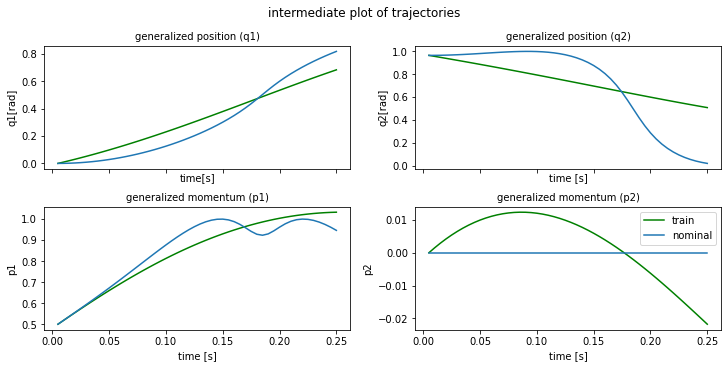

plot time : 1.2529752254486084
epoch   70 | train time 1.68 | train loss 1.420485e-01 | test loss 1.747221e-01 | test time 0.15  
epoch   71 | train time 0.43 | train loss 1.396537e-01 
epoch   72 | train time 0.42 | train loss 1.372474e-01 
epoch   73 | train time 0.42 | train loss 1.347203e-01 
epoch   74 | train time 0.43 | train loss 1.322029e-01 
epoch   75 | train time 0.42 | train loss 1.296381e-01 
epoch   76 | train time 0.43 | train loss 1.269627e-01 
epoch   77 | train time 0.43 | train loss 1.243212e-01 
epoch   78 | train time 0.42 | train loss 1.215907e-01 
epoch   79 | train time 0.51 | train loss 1.188894e-01 


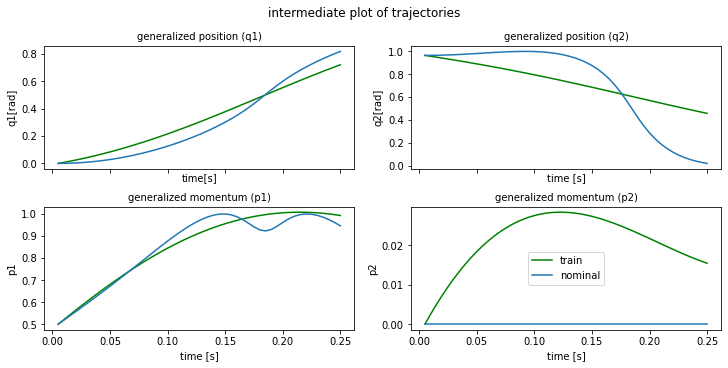

plot time : 1.1696982383728027
epoch   80 | train time 1.65 | train loss 1.161895e-01 | test loss 1.431697e-01 | test time 0.15  
epoch   81 | train time 0.53 | train loss 1.135356e-01 
epoch   82 | train time 0.47 | train loss 1.109315e-01 
epoch   83 | train time 0.53 | train loss 1.083672e-01 
epoch   84 | train time 0.46 | train loss 1.058182e-01 
epoch   85 | train time 0.42 | train loss 1.033145e-01 
epoch   86 | train time 0.42 | train loss 1.007853e-01 
epoch   87 | train time 0.44 | train loss 9.830669e-02 
epoch   88 | train time 0.42 | train loss 9.578968e-02 
epoch   89 | train time 0.46 | train loss 9.325314e-02 


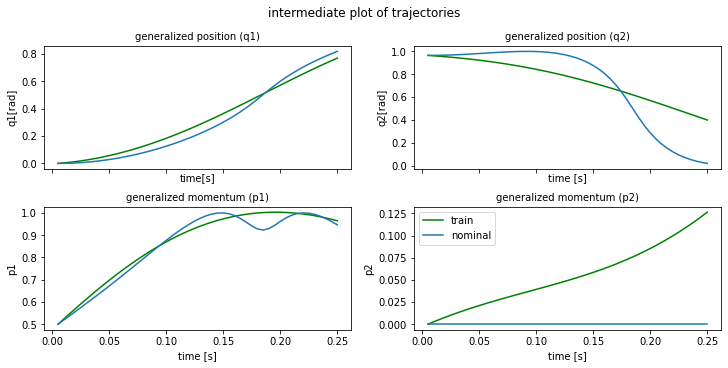

plot time : 1.3156611919403076
epoch   90 | train time 1.76 | train loss 9.074555e-02 | test loss 1.103545e-01 | test time 0.19  
epoch   91 | train time 0.54 | train loss 8.823954e-02 
epoch   92 | train time 0.46 | train loss 8.574735e-02 
epoch   93 | train time 0.54 | train loss 8.330467e-02 
epoch   94 | train time 0.50 | train loss 8.092001e-02 
epoch   95 | train time 0.54 | train loss 7.858592e-02 
epoch   96 | train time 0.48 | train loss 7.630534e-02 
epoch   97 | train time 0.54 | train loss 7.408065e-02 
epoch   98 | train time 0.46 | train loss 7.193398e-02 
epoch   99 | train time 0.43 | train loss 6.988429e-02 


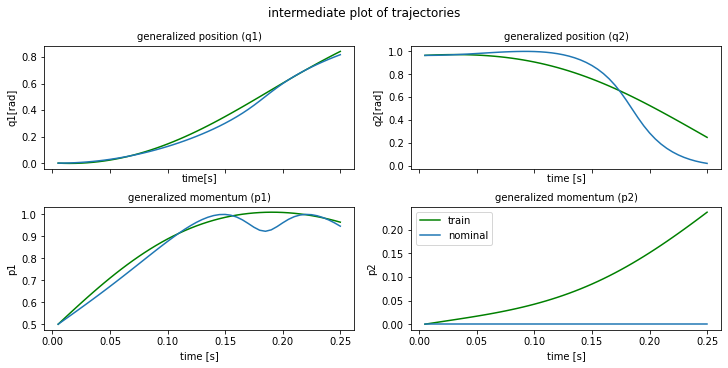

plot time : 1.1803710460662842
epoch  100 | train time 1.62 | train loss 6.795184e-02 | test loss 8.233632e-02 | test time 0.15  
epoch  101 | train time 0.42 | train loss 6.616338e-02 
epoch  102 | train time 0.44 | train loss 6.459311e-02 
epoch  103 | train time 0.42 | train loss 6.334051e-02 
epoch  104 | train time 0.44 | train loss 6.219048e-02 
epoch  105 | train time 0.42 | train loss 6.049287e-02 
epoch  106 | train time 0.43 | train loss 5.848122e-02 
epoch  107 | train time 0.43 | train loss 5.716496e-02 
epoch  108 | train time 0.42 | train loss 5.653807e-02 
epoch  109 | train time 0.44 | train loss 5.571321e-02 


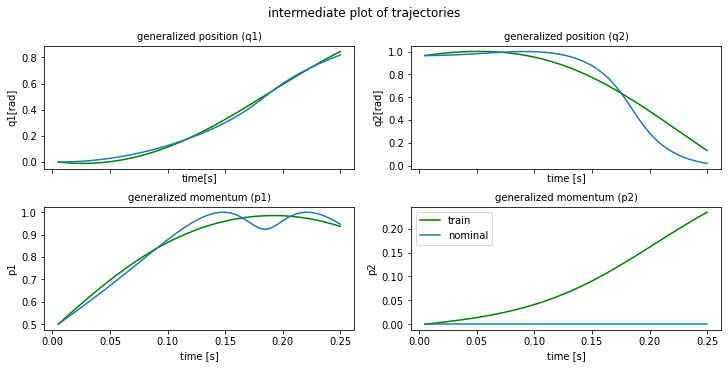

plot time : 1.157677173614502
epoch  110 | train time 1.61 | train loss 5.415653e-02 | test loss 6.657137e-02 | test time 0.14  
epoch  111 | train time 0.43 | train loss 5.270814e-02 
epoch  112 | train time 0.42 | train loss 5.195938e-02 
epoch  113 | train time 0.42 | train loss 5.139989e-02 
epoch  114 | train time 0.44 | train loss 5.041561e-02 
epoch  115 | train time 0.57 | train loss 4.908747e-02 
epoch  116 | train time 0.60 | train loss 4.817149e-02 
epoch  117 | train time 0.84 | train loss 4.768474e-02 
epoch  118 | train time 0.63 | train loss 4.703735e-02 
epoch  119 | train time 0.61 | train loss 4.608339e-02 


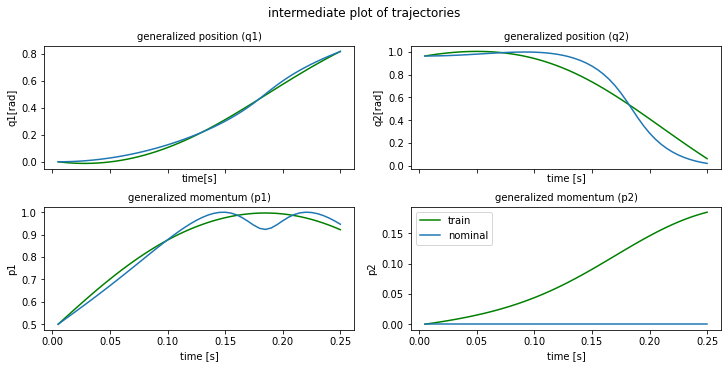

plot time : 1.1551740169525146
epoch  120 | train time 1.66 | train loss 4.520464e-02 | test loss 5.968326e-02 | test time 0.15  
epoch  121 | train time 0.45 | train loss 4.470973e-02 
epoch  122 | train time 0.43 | train loss 4.430709e-02 
epoch  123 | train time 0.47 | train loss 4.364763e-02 
epoch  124 | train time 0.53 | train loss 4.293155e-02 
epoch  125 | train time 0.44 | train loss 4.244614e-02 
epoch  126 | train time 0.42 | train loss 4.211046e-02 
epoch  127 | train time 0.43 | train loss 4.166678e-02 
epoch  128 | train time 0.42 | train loss 4.109703e-02 
epoch  129 | train time 0.44 | train loss 4.064556e-02 


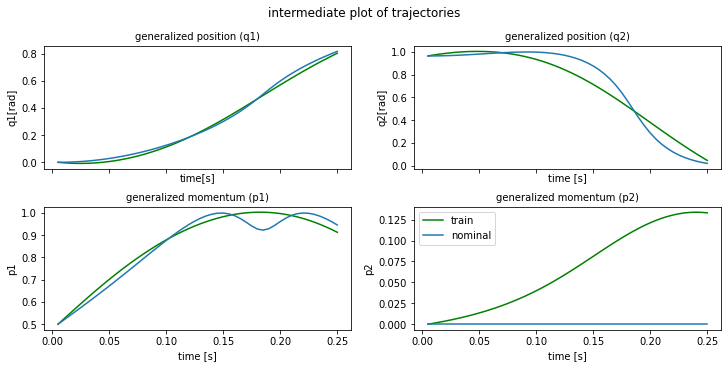

plot time : 1.166022777557373
epoch  130 | train time 1.63 | train loss 4.034283e-02 | test loss 5.550950e-02 | test time 0.14  
epoch  131 | train time 0.45 | train loss 4.000305e-02 
epoch  132 | train time 0.42 | train loss 3.957430e-02 
epoch  133 | train time 0.44 | train loss 3.917389e-02 
epoch  134 | train time 0.51 | train loss 3.888326e-02 
epoch  135 | train time 0.51 | train loss 3.861707e-02 
epoch  136 | train time 0.42 | train loss 3.828147e-02 
epoch  137 | train time 0.43 | train loss 3.791973e-02 
epoch  138 | train time 0.42 | train loss 3.760466e-02 
epoch  139 | train time 0.42 | train loss 3.733896e-02 


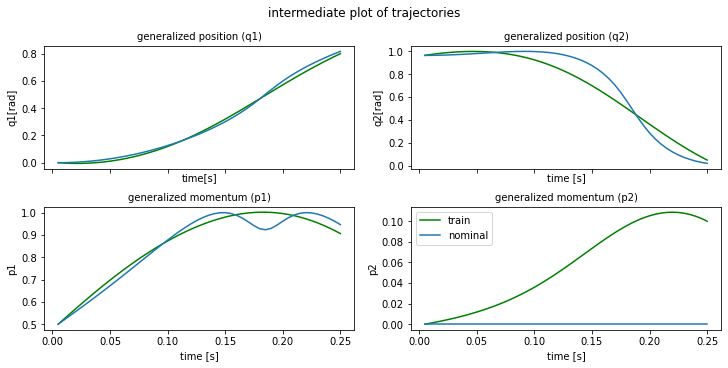

plot time : 1.2731437683105469
epoch  140 | train time 1.72 | train loss 3.706985e-02 | test loss 5.204709e-02 | test time 0.15  
epoch  141 | train time 0.43 | train loss 3.676071e-02 
epoch  142 | train time 0.43 | train loss 3.643122e-02 
epoch  143 | train time 0.43 | train loss 3.610966e-02 
epoch  144 | train time 0.44 | train loss 3.581125e-02 
epoch  145 | train time 0.42 | train loss 3.553181e-02 
epoch  146 | train time 0.43 | train loss 3.526409e-02 
epoch  147 | train time 0.43 | train loss 3.500944e-02 
epoch  148 | train time 0.43 | train loss 3.477403e-02 
epoch  149 | train time 0.42 | train loss 3.460693e-02 


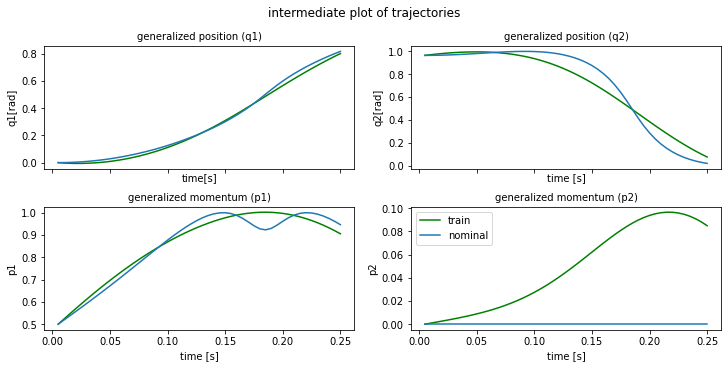

plot time : 1.1631736755371094
epoch  150 | train time 1.61 | train loss 3.452426e-02 | test loss 4.716744e-02 | test time 0.14  
epoch  151 | train time 0.42 | train loss 3.474592e-02 
epoch  152 | train time 0.42 | train loss 3.493110e-02 
epoch  153 | train time 0.42 | train loss 3.537264e-02 
epoch  154 | train time 0.42 | train loss 3.408636e-02 
epoch  155 | train time 0.43 | train loss 3.287980e-02 
epoch  156 | train time 0.42 | train loss 3.253669e-02 
epoch  157 | train time 0.43 | train loss 3.299471e-02 
epoch  158 | train time 0.42 | train loss 3.342779e-02 
epoch  159 | train time 0.44 | train loss 3.237772e-02 


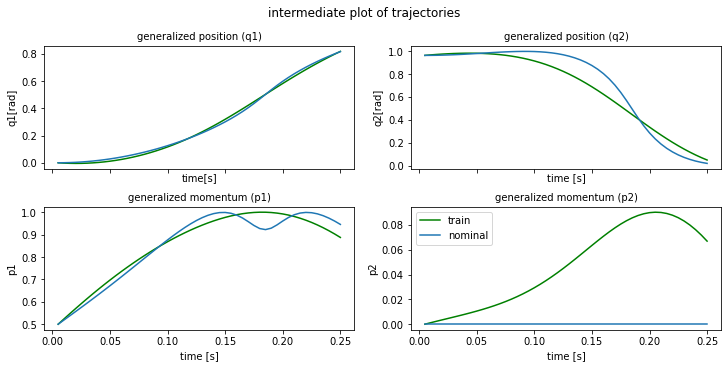

plot time : 1.2427866458892822
epoch  160 | train time 1.69 | train loss 3.143991e-02 | test loss 4.278604e-02 | test time 0.14  
epoch  161 | train time 0.43 | train loss 3.131064e-02 
epoch  162 | train time 0.43 | train loss 3.163034e-02 
epoch  163 | train time 0.44 | train loss 3.176681e-02 
epoch  164 | train time 0.43 | train loss 3.083972e-02 
epoch  165 | train time 0.42 | train loss 3.009146e-02 
epoch  166 | train time 0.43 | train loss 2.992192e-02 
epoch  167 | train time 0.42 | train loss 3.007988e-02 
epoch  168 | train time 0.43 | train loss 3.016694e-02 
epoch  169 | train time 0.42 | train loss 2.953058e-02 


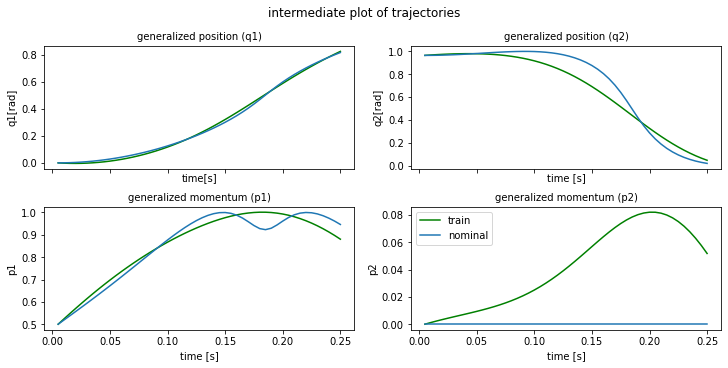

plot time : 1.1830856800079346
epoch  170 | train time 1.63 | train loss 2.888174e-02 | test loss 3.844510e-02 | test time 0.14  
epoch  171 | train time 0.43 | train loss 2.844952e-02 
epoch  172 | train time 0.43 | train loss 2.837442e-02 
epoch  173 | train time 0.42 | train loss 2.850949e-02 
epoch  174 | train time 0.43 | train loss 2.843688e-02 
epoch  175 | train time 0.43 | train loss 2.838941e-02 
epoch  176 | train time 0.42 | train loss 2.776905e-02 
epoch  177 | train time 0.45 | train loss 2.715627e-02 
epoch  178 | train time 0.44 | train loss 2.661862e-02 
epoch  179 | train time 0.54 | train loss 2.631421e-02 


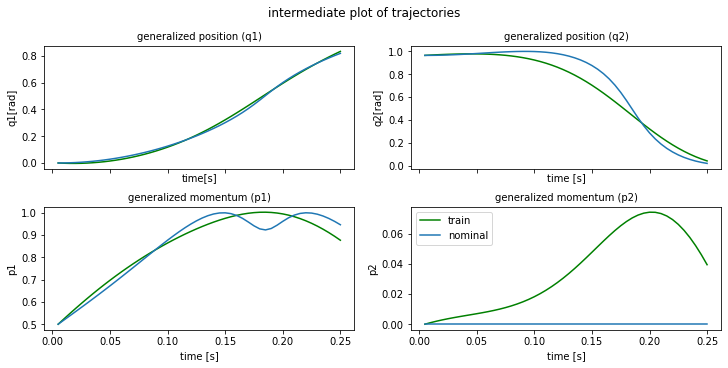

plot time : 1.1768689155578613
epoch  180 | train time 1.68 | train loss 2.616920e-02 | test loss 3.554872e-02 | test time 0.16  
epoch  181 | train time 0.42 | train loss 2.618394e-02 
epoch  182 | train time 0.47 | train loss 2.648106e-02 
epoch  183 | train time 0.55 | train loss 2.675323e-02 
epoch  184 | train time 0.46 | train loss 2.789944e-02 
epoch  185 | train time 0.43 | train loss 2.644776e-02 
epoch  186 | train time 0.45 | train loss 2.547888e-02 
epoch  187 | train time 0.51 | train loss 2.439354e-02 
epoch  188 | train time 0.43 | train loss 2.407906e-02 
epoch  189 | train time 0.44 | train loss 2.441531e-02 


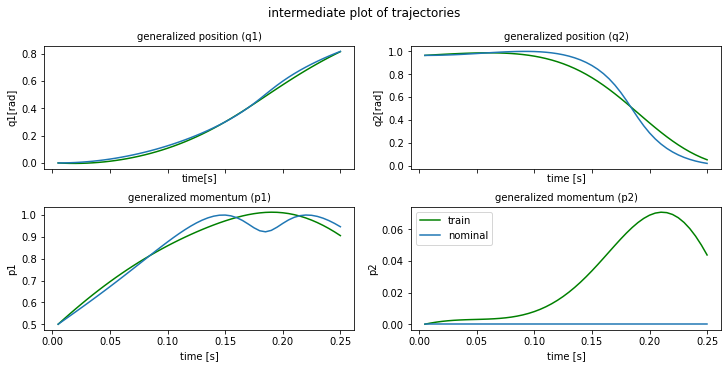

plot time : 1.1759788990020752
epoch  190 | train time 1.62 | train loss 2.479326e-02 | test loss 3.097017e-02 | test time 0.14  
epoch  191 | train time 0.43 | train loss 2.530603e-02 
epoch  192 | train time 0.42 | train loss 2.432109e-02 
epoch  193 | train time 0.44 | train loss 2.327458e-02 
epoch  194 | train time 0.42 | train loss 2.261845e-02 
epoch  195 | train time 0.42 | train loss 2.271844e-02 
epoch  196 | train time 0.43 | train loss 2.321079e-02 
epoch  197 | train time 0.43 | train loss 2.322942e-02 
epoch  198 | train time 0.43 | train loss 2.288191e-02 
epoch  199 | train time 0.42 | train loss 2.184018e-02 
horizon length : 100
min max values updated


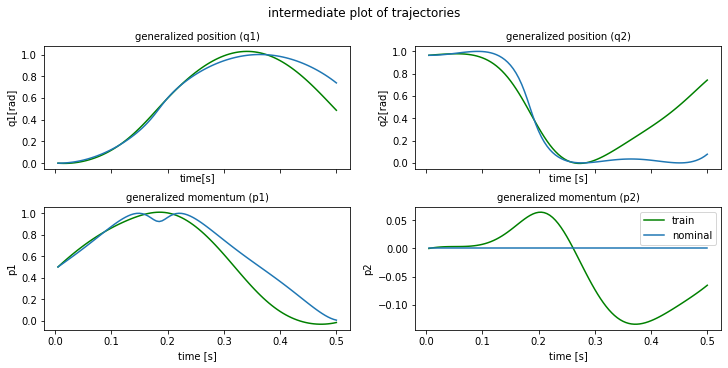

plot time : 1.236910343170166
min max values updated
epoch  200 | train time 2.19 | train loss 7.183568e-02 | test loss 7.477538e-02 | test time 0.39  
epoch  201 | train time 0.85 | train loss 5.791771e-02 
epoch  202 | train time 0.93 | train loss 5.645056e-02 
epoch  203 | train time 1.05 | train loss 5.970747e-02 
epoch  204 | train time 0.93 | train loss 5.726518e-02 
epoch  205 | train time 0.94 | train loss 5.295499e-02 
epoch  206 | train time 0.87 | train loss 4.954905e-02 
epoch  207 | train time 0.87 | train loss 4.810932e-02 
epoch  208 | train time 0.84 | train loss 5.175253e-02 
epoch  209 | train time 0.84 | train loss 4.932770e-02 


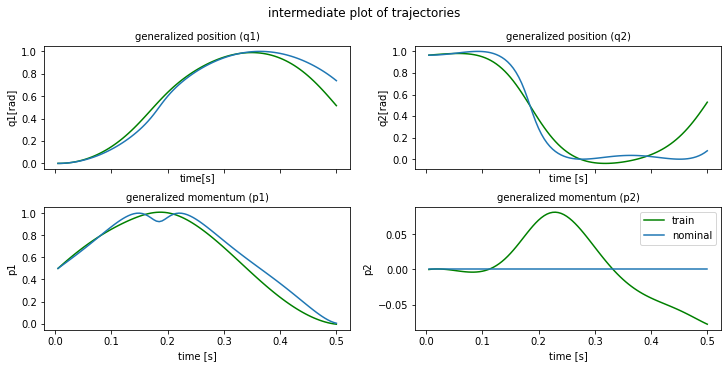

plot time : 1.2105038166046143
epoch  210 | train time 2.10 | train loss 4.687628e-02 | test loss 5.213705e-02 | test time 0.27  
epoch  211 | train time 0.83 | train loss 4.125873e-02 
epoch  212 | train time 0.85 | train loss 4.860727e-02 
epoch  213 | train time 0.85 | train loss 4.623235e-02 
epoch  214 | train time 0.85 | train loss 4.143099e-02 
epoch  215 | train time 0.92 | train loss 4.089783e-02 
epoch  216 | train time 0.93 | train loss 3.975932e-02 
epoch  217 | train time 0.85 | train loss 4.152803e-02 
epoch  218 | train time 0.83 | train loss 3.952702e-02 
epoch  219 | train time 0.89 | train loss 3.717485e-02 


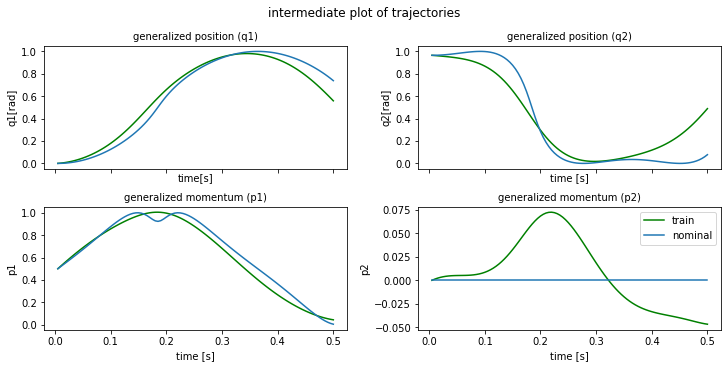

plot time : 1.1838059425354004
epoch  220 | train time 2.04 | train loss 3.886220e-02 | test loss 4.667700e-02 | test time 0.27  
epoch  221 | train time 0.85 | train loss 3.738737e-02 
epoch  222 | train time 0.84 | train loss 3.867304e-02 
epoch  223 | train time 0.84 | train loss 3.571980e-02 
epoch  224 | train time 1.01 | train loss 3.632559e-02 
epoch  225 | train time 1.00 | train loss 3.531500e-02 
epoch  226 | train time 0.88 | train loss 3.670663e-02 
epoch  227 | train time 0.96 | train loss 3.464821e-02 
epoch  228 | train time 0.89 | train loss 3.503400e-02 
epoch  229 | train time 0.83 | train loss 3.412034e-02 


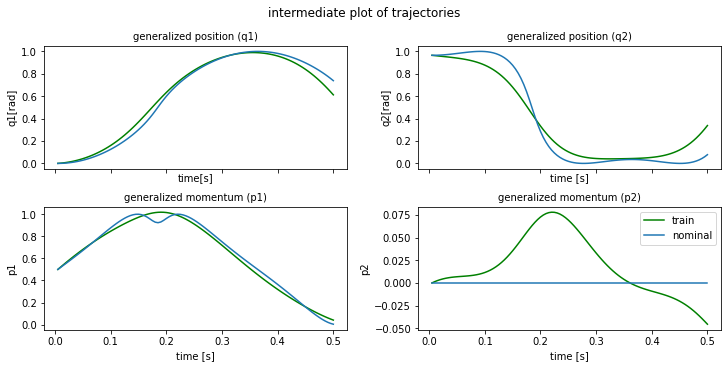

plot time : 1.3008935451507568
epoch  230 | train time 2.17 | train loss 3.466173e-02 | test loss 4.490917e-02 | test time 0.28  
epoch  231 | train time 0.84 | train loss 3.458366e-02 
epoch  232 | train time 0.88 | train loss 3.383822e-02 
epoch  233 | train time 0.90 | train loss 3.381363e-02 
epoch  234 | train time 0.84 | train loss 3.484245e-02 
epoch  235 | train time 0.84 | train loss 3.449842e-02 
epoch  236 | train time 0.85 | train loss 3.362388e-02 
epoch  237 | train time 0.85 | train loss 3.291271e-02 
epoch  238 | train time 1.00 | train loss 3.283213e-02 
epoch  239 | train time 1.01 | train loss 3.381480e-02 


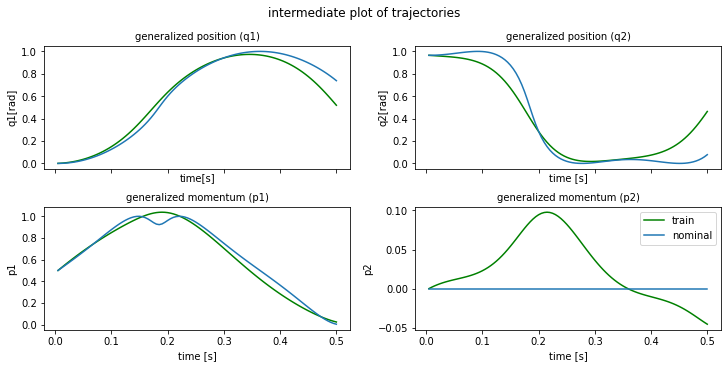

plot time : 1.276825189590454
epoch  240 | train time 2.28 | train loss 3.253049e-02 | test loss 4.315222e-02 | test time 0.37  
epoch  241 | train time 0.98 | train loss 3.253790e-02 
epoch  242 | train time 0.92 | train loss 3.307157e-02 
epoch  243 | train time 0.92 | train loss 3.445851e-02 
epoch  244 | train time 0.94 | train loss 3.226959e-02 
epoch  245 | train time 0.88 | train loss 3.214664e-02 
epoch  246 | train time 0.85 | train loss 3.313131e-02 
epoch  247 | train time 0.84 | train loss 3.422165e-02 
epoch  248 | train time 0.84 | train loss 3.157350e-02 
epoch  249 | train time 1.01 | train loss 3.521780e-02 


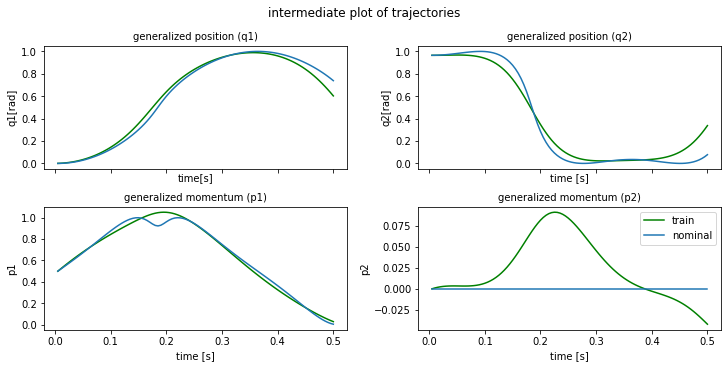

plot time : 1.2249188423156738
epoch  250 | train time 2.15 | train loss 3.228891e-02 | test loss 4.315541e-02 | test time 0.33  
epoch  251 | train time 0.97 | train loss 3.246823e-02 
epoch  252 | train time 0.92 | train loss 3.222262e-02 
epoch  253 | train time 0.83 | train loss 3.482885e-02 
epoch  254 | train time 0.83 | train loss 3.146098e-02 
epoch  255 | train time 0.94 | train loss 3.704410e-02 
epoch  256 | train time 0.85 | train loss 3.462604e-02 
epoch  257 | train time 0.85 | train loss 3.589973e-02 
epoch  258 | train time 0.88 | train loss 3.600290e-02 
epoch  259 | train time 1.01 | train loss 3.604828e-02 


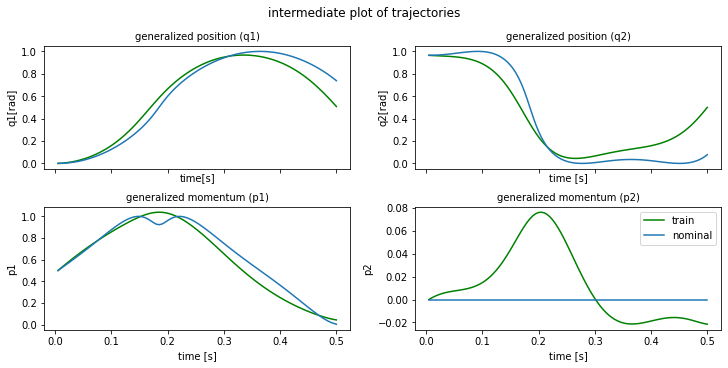

plot time : 1.2630925178527832
epoch  260 | train time 2.23 | train loss 3.440408e-02 | test loss 4.832917e-02 | test time 0.28  
epoch  261 | train time 1.00 | train loss 3.603622e-02 
epoch  262 | train time 0.85 | train loss 3.421758e-02 
epoch  263 | train time 0.84 | train loss 3.646547e-02 
epoch  264 | train time 0.87 | train loss 3.470382e-02 
epoch  265 | train time 0.85 | train loss 3.396742e-02 
epoch  266 | train time 0.95 | train loss 3.337141e-02 
epoch  267 | train time 0.85 | train loss 3.406903e-02 
epoch  268 | train time 0.99 | train loss 3.296410e-02 
epoch  269 | train time 0.90 | train loss 3.479435e-02 


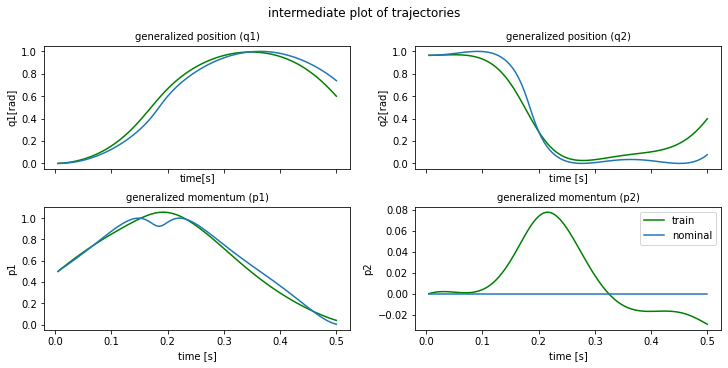

plot time : 1.2017161846160889
epoch  270 | train time 2.11 | train loss 3.490005e-02 | test loss 4.011047e-02 | test time 0.31  
epoch  271 | train time 0.84 | train loss 3.251956e-02 
epoch  272 | train time 0.82 | train loss 3.338610e-02 
epoch  273 | train time 0.98 | train loss 3.281544e-02 
epoch  274 | train time 0.84 | train loss 3.282205e-02 
epoch  275 | train time 0.86 | train loss 3.246382e-02 
epoch  276 | train time 0.84 | train loss 3.203651e-02 
epoch  277 | train time 0.94 | train loss 3.110273e-02 
epoch  278 | train time 0.85 | train loss 3.207553e-02 
epoch  279 | train time 0.87 | train loss 3.055505e-02 


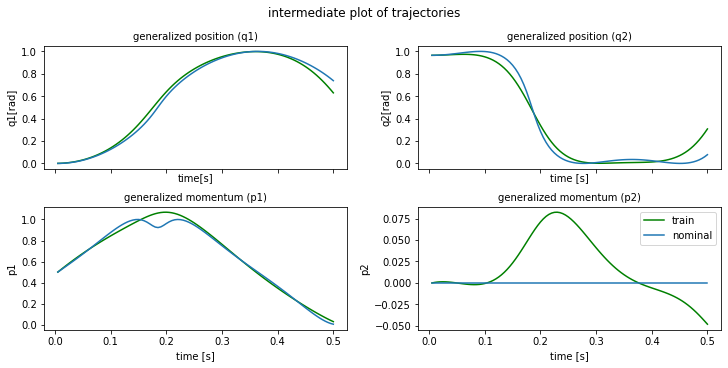

plot time : 1.2929015159606934
epoch  280 | train time 2.30 | train loss 3.217418e-02 | test loss 4.039603e-02 | test time 0.28  
epoch  281 | train time 0.91 | train loss 3.005679e-02 
epoch  282 | train time 0.95 | train loss 3.123244e-02 
epoch  283 | train time 1.01 | train loss 3.014844e-02 
epoch  284 | train time 0.94 | train loss 3.081691e-02 
epoch  285 | train time 0.93 | train loss 2.992604e-02 
epoch  286 | train time 0.98 | train loss 3.071522e-02 
epoch  287 | train time 0.94 | train loss 2.954528e-02 
epoch  288 | train time 0.86 | train loss 3.048313e-02 
epoch  289 | train time 0.86 | train loss 3.032542e-02 


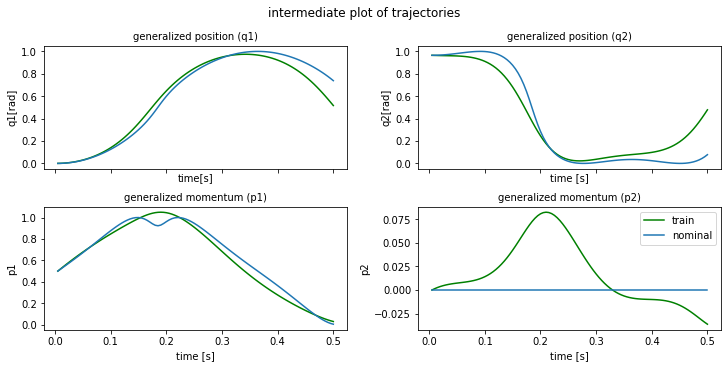

plot time : 1.2466709613800049
epoch  290 | train time 2.11 | train loss 3.006813e-02 | test loss 3.967940e-02 | test time 0.28  
epoch  291 | train time 0.86 | train loss 2.965648e-02 
epoch  292 | train time 0.84 | train loss 3.054522e-02 
epoch  293 | train time 0.84 | train loss 3.013444e-02 
epoch  294 | train time 1.04 | train loss 2.950360e-02 
epoch  295 | train time 0.89 | train loss 2.953860e-02 
epoch  296 | train time 0.87 | train loss 2.964240e-02 
epoch  297 | train time 0.84 | train loss 3.060385e-02 
epoch  298 | train time 0.85 | train loss 2.918276e-02 
epoch  299 | train time 0.86 | train loss 2.930953e-02 
horizon length : 150
min max values updated


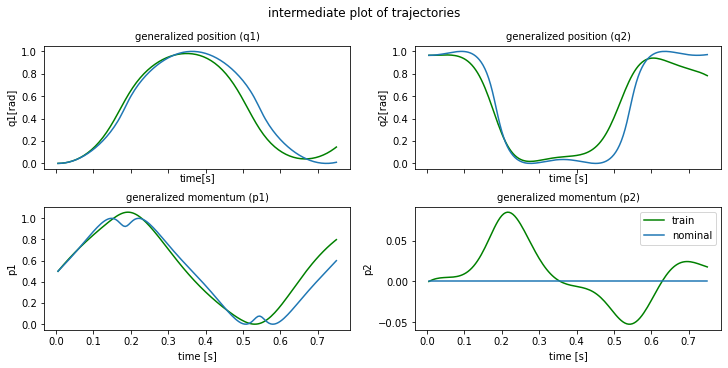

plot time : 1.1801607608795166
min max values updated
epoch  300 | train time 2.48 | train loss 5.794096e-02 | test loss 5.855791e-02 | test time 0.43  
epoch  301 | train time 1.44 | train loss 5.191876e-02 
epoch  302 | train time 1.47 | train loss 5.546478e-02 
epoch  303 | train time 1.25 | train loss 5.062288e-02 
epoch  304 | train time 1.26 | train loss 5.099047e-02 
epoch  305 | train time 1.28 | train loss 5.376875e-02 
epoch  306 | train time 1.26 | train loss 4.980556e-02 
epoch  307 | train time 1.25 | train loss 5.000578e-02 
epoch  308 | train time 1.28 | train loss 5.237520e-02 
epoch  309 | train time 1.25 | train loss 5.473255e-02 


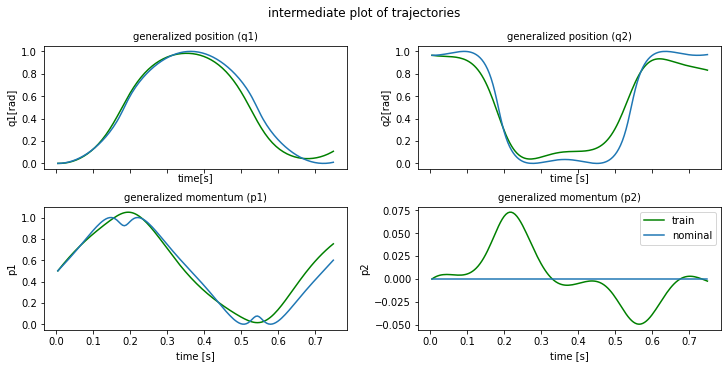

plot time : 1.2828123569488525
epoch  310 | train time 2.87 | train loss 4.712525e-02 | test loss 7.186826e-02 | test time 0.44  
epoch  311 | train time 1.26 | train loss 6.652083e-02 
epoch  312 | train time 1.25 | train loss 6.371623e-02 
epoch  313 | train time 1.29 | train loss 5.007135e-02 
epoch  314 | train time 1.33 | train loss 5.857264e-02 
epoch  315 | train time 1.54 | train loss 4.950238e-02 
epoch  316 | train time 1.45 | train loss 7.992903e-02 
epoch  317 | train time 1.27 | train loss 8.372128e-02 
epoch  318 | train time 1.28 | train loss 5.437972e-02 
epoch  319 | train time 1.33 | train loss 5.988336e-02 


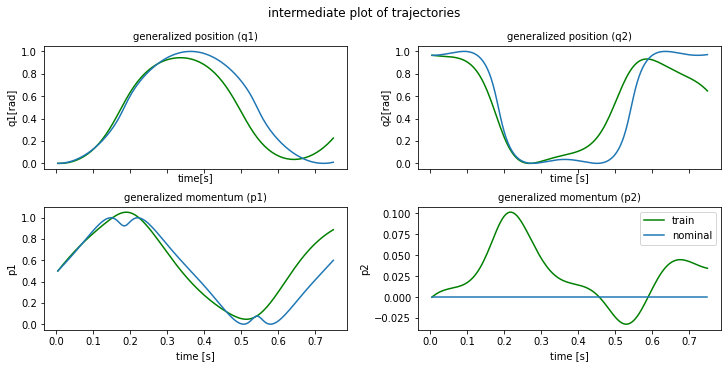

plot time : 1.20050048828125
epoch  320 | train time 2.49 | train loss 6.665944e-02 | test loss 6.277370e-02 | test time 0.44  
epoch  321 | train time 1.28 | train loss 4.992927e-02 
epoch  322 | train time 1.25 | train loss 6.388608e-02 
epoch  323 | train time 1.33 | train loss 6.120899e-02 
epoch  324 | train time 1.33 | train loss 5.336702e-02 
epoch  325 | train time 1.28 | train loss 5.867307e-02 
epoch  326 | train time 1.33 | train loss 5.412254e-02 
epoch  327 | train time 1.28 | train loss 4.828170e-02 
epoch  328 | train time 1.26 | train loss 4.701605e-02 
epoch  329 | train time 1.25 | train loss 5.203409e-02 


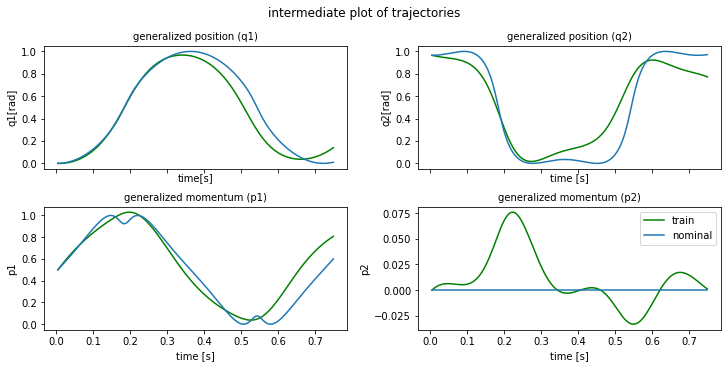

plot time : 1.1985962390899658
epoch  330 | train time 2.50 | train loss 4.987511e-02 | test loss 6.624016e-02 | test time 0.43  
epoch  331 | train time 1.30 | train loss 5.240685e-02 
epoch  332 | train time 1.25 | train loss 5.179257e-02 
epoch  333 | train time 1.52 | train loss 4.600487e-02 
epoch  334 | train time 1.44 | train loss 4.816734e-02 
epoch  335 | train time 1.35 | train loss 4.520733e-02 
epoch  336 | train time 1.26 | train loss 4.453263e-02 
epoch  337 | train time 1.26 | train loss 5.205580e-02 
epoch  338 | train time 1.27 | train loss 4.709333e-02 
epoch  339 | train time 1.26 | train loss 5.868286e-02 


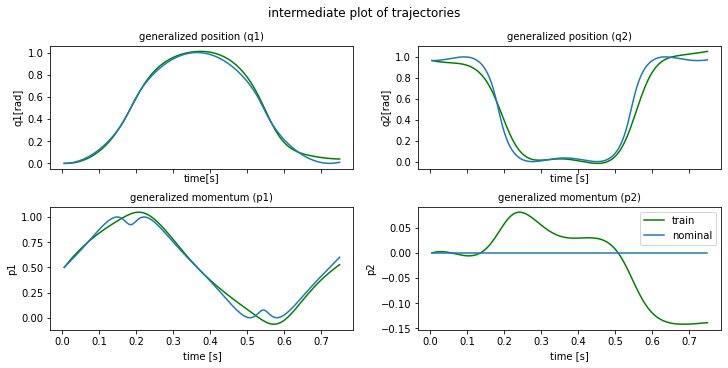

plot time : 1.2563354969024658
epoch  340 | train time 2.59 | train loss 5.996489e-02 | test loss 6.061724e-02 | test time 0.45  
epoch  341 | train time 1.34 | train loss 5.218225e-02 
epoch  342 | train time 1.24 | train loss 4.829359e-02 
epoch  343 | train time 1.40 | train loss 5.941127e-02 
epoch  344 | train time 1.32 | train loss 5.424787e-02 
epoch  345 | train time 1.41 | train loss 4.752674e-02 
epoch  346 | train time 1.26 | train loss 4.865843e-02 
epoch  347 | train time 1.25 | train loss 5.153372e-02 
epoch  348 | train time 1.31 | train loss 4.973530e-02 
epoch  349 | train time 1.37 | train loss 5.162187e-02 


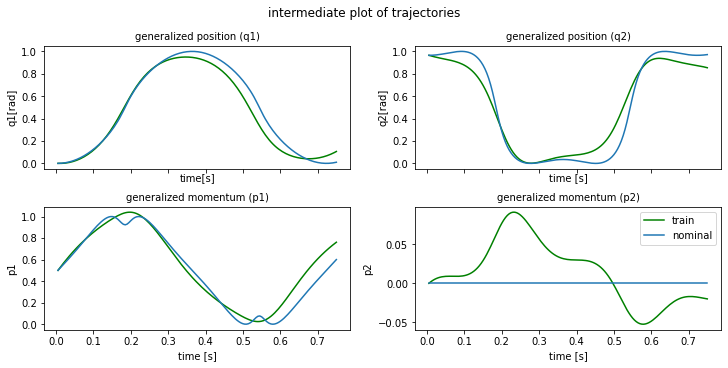

plot time : 1.2536613941192627
epoch  350 | train time 2.54 | train loss 4.787679e-02 | test loss 6.874661e-02 | test time 0.42  
epoch  351 | train time 1.28 | train loss 5.502165e-02 
epoch  352 | train time 1.42 | train loss 5.423670e-02 
epoch  353 | train time 1.73 | train loss 4.500459e-02 
epoch  354 | train time 1.86 | train loss 4.467047e-02 
epoch  355 | train time 1.46 | train loss 5.135897e-02 
epoch  356 | train time 1.45 | train loss 4.774917e-02 
epoch  357 | train time 1.42 | train loss 5.180871e-02 
epoch  358 | train time 1.43 | train loss 5.185196e-02 
epoch  359 | train time 1.36 | train loss 4.635058e-02 


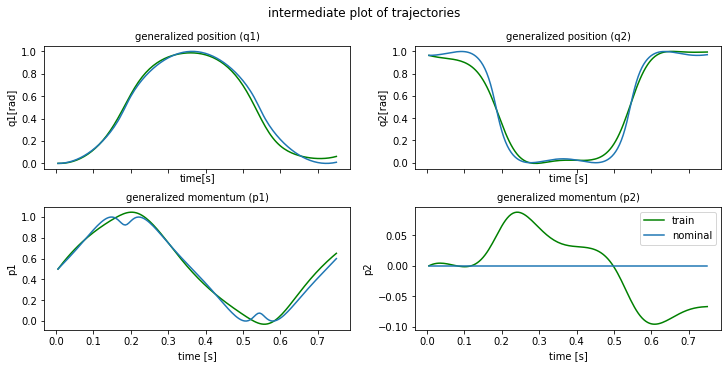

plot time : 1.2393138408660889
epoch  360 | train time 2.68 | train loss 4.669389e-02 | test loss 5.633033e-02 | test time 0.41  
epoch  361 | train time 1.39 | train loss 4.792790e-02 
epoch  362 | train time 1.36 | train loss 4.456431e-02 
epoch  363 | train time 1.26 | train loss 5.524145e-02 
epoch  364 | train time 1.31 | train loss 5.475985e-02 
epoch  365 | train time 1.50 | train loss 4.350423e-02 
epoch  366 | train time 1.29 | train loss 4.874803e-02 
epoch  367 | train time 1.27 | train loss 4.488061e-02 
epoch  368 | train time 1.26 | train loss 4.736822e-02 
epoch  369 | train time 1.27 | train loss 4.511568e-02 


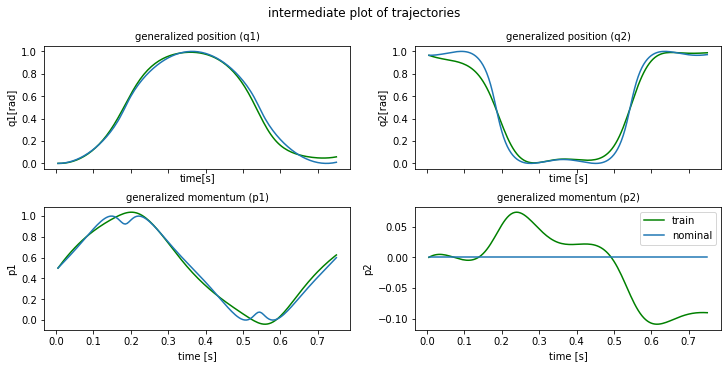

plot time : 1.1288354396820068
epoch  370 | train time 2.41 | train loss 4.821443e-02 | test loss 5.887719e-02 | test time 0.42  
epoch  371 | train time 1.31 | train loss 4.712223e-02 
epoch  372 | train time 1.44 | train loss 4.594685e-02 
epoch  373 | train time 1.27 | train loss 4.499875e-02 
epoch  374 | train time 1.28 | train loss 4.668774e-02 
epoch  375 | train time 1.26 | train loss 4.582526e-02 
epoch  376 | train time 1.43 | train loss 4.539987e-02 
epoch  377 | train time 1.42 | train loss 4.414427e-02 
epoch  378 | train time 1.29 | train loss 4.796875e-02 
epoch  379 | train time 1.25 | train loss 4.734939e-02 


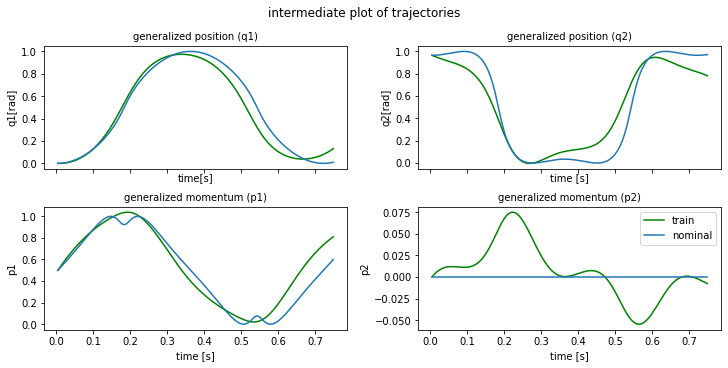

plot time : 1.2058985233306885
epoch  380 | train time 2.51 | train loss 4.330664e-02 | test loss 5.169962e-02 | test time 0.41  
epoch  381 | train time 1.27 | train loss 4.266442e-02 
epoch  382 | train time 1.54 | train loss 4.757617e-02 
epoch  383 | train time 1.31 | train loss 4.666170e-02 
epoch  384 | train time 1.32 | train loss 4.274814e-02 
epoch  385 | train time 1.43 | train loss 4.309048e-02 
epoch  386 | train time 1.27 | train loss 4.487324e-02 
epoch  387 | train time 1.26 | train loss 4.357161e-02 
epoch  388 | train time 1.35 | train loss 4.274029e-02 
epoch  389 | train time 1.52 | train loss 4.180575e-02 


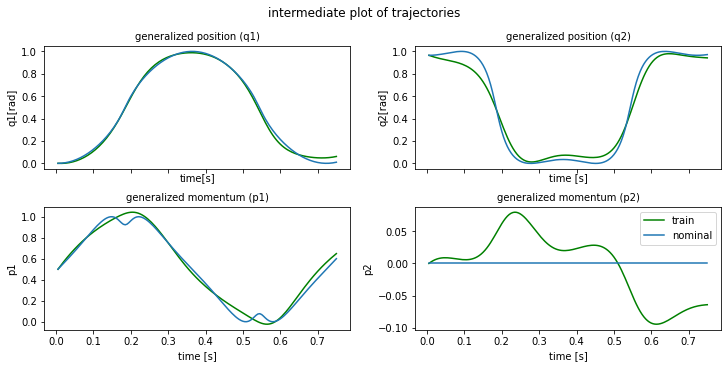

plot time : 1.1935462951660156
epoch  390 | train time 2.58 | train loss 4.673706e-02 | test loss 5.513052e-02 | test time 0.42  
epoch  391 | train time 1.27 | train loss 4.373957e-02 
epoch  392 | train time 1.27 | train loss 4.943796e-02 
epoch  393 | train time 1.27 | train loss 5.148767e-02 
epoch  394 | train time 1.24 | train loss 4.699893e-02 
epoch  395 | train time 1.27 | train loss 4.382506e-02 
epoch  396 | train time 1.25 | train loss 5.678632e-02 
epoch  397 | train time 1.34 | train loss 4.892823e-02 
epoch  398 | train time 1.38 | train loss 4.576103e-02 
epoch  399 | train time 1.29 | train loss 4.726392e-02 
horizon length : 200
min max values updated


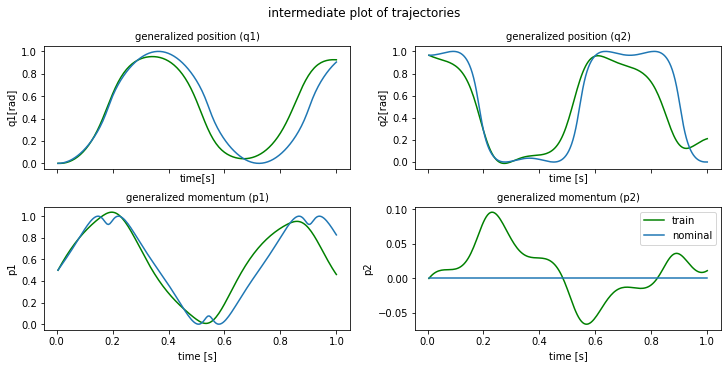

plot time : 1.2317490577697754
min max values updated
epoch  400 | train time 2.98 | train loss 6.594739e-02 | test loss 1.081507e-01 | test time 0.59  
epoch  401 | train time 1.68 | train loss 1.148169e-01 
epoch  402 | train time 1.93 | train loss 1.037704e-01 
epoch  403 | train time 2.09 | train loss 6.363583e-02 
epoch  404 | train time 1.73 | train loss 6.977144e-02 
epoch  405 | train time 1.74 | train loss 5.846419e-02 
epoch  406 | train time 1.76 | train loss 6.343744e-02 
epoch  407 | train time 1.68 | train loss 5.834118e-02 
epoch  408 | train time 1.75 | train loss 8.736978e-02 
epoch  409 | train time 1.71 | train loss 6.973369e-02 


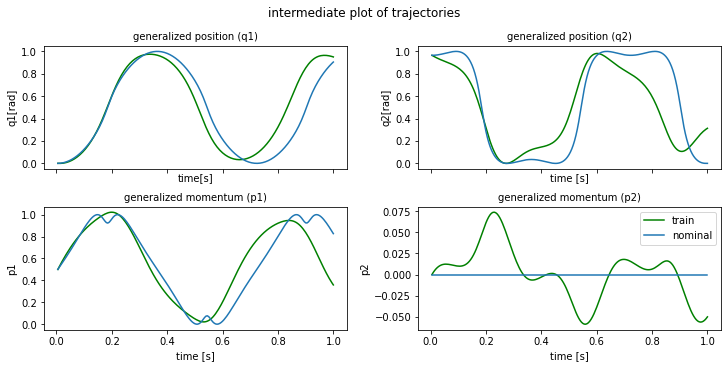

plot time : 1.2362353801727295
epoch  410 | train time 3.06 | train loss 7.545794e-02 | test loss 9.051154e-02 | test time 0.55  
epoch  411 | train time 1.75 | train loss 7.688732e-02 
epoch  412 | train time 1.75 | train loss 7.216216e-02 
epoch  413 | train time 1.67 | train loss 6.434356e-02 
epoch  414 | train time 1.74 | train loss 6.443547e-02 
epoch  415 | train time 1.69 | train loss 8.787821e-02 
epoch  416 | train time 1.76 | train loss 6.871849e-02 
epoch  417 | train time 1.84 | train loss 1.190945e-01 
epoch  418 | train time 1.86 | train loss 9.106866e-02 
epoch  419 | train time 2.00 | train loss 7.056127e-02 


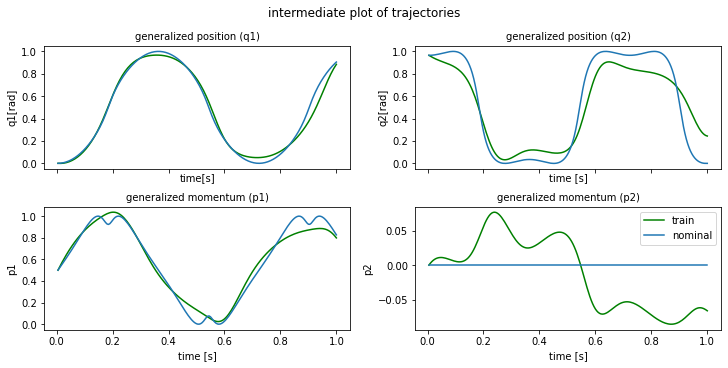

plot time : 1.1767947673797607
epoch  420 | train time 3.09 | train loss 8.330445e-02 | test loss 7.632466e-02 | test time 0.54  
epoch  421 | train time 1.82 | train loss 5.897550e-02 
epoch  422 | train time 1.85 | train loss 5.785365e-02 
epoch  423 | train time 1.87 | train loss 1.699403e-01 
epoch  424 | train time 1.97 | train loss 1.780483e-01 
epoch  425 | train time 1.68 | train loss 9.289116e-02 
epoch  426 | train time 1.69 | train loss 9.672801e-02 
epoch  427 | train time 1.75 | train loss 1.346895e-01 
epoch  428 | train time 1.70 | train loss 9.979045e-02 
epoch  429 | train time 1.76 | train loss 9.468210e-02 


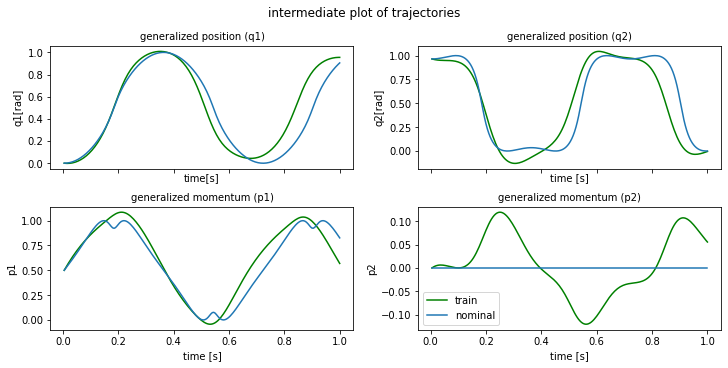

plot time : 1.2866721153259277
epoch  430 | train time 3.01 | train loss 8.588393e-02 | test loss 8.726578e-02 | test time 0.63  
epoch  431 | train time 1.78 | train loss 7.927871e-02 
epoch  432 | train time 1.83 | train loss 7.722172e-02 
epoch  433 | train time 1.69 | train loss 7.665797e-02 
epoch  434 | train time 1.87 | train loss 7.344954e-02 
epoch  435 | train time 1.76 | train loss 7.727740e-02 
epoch  436 | train time 1.91 | train loss 6.268713e-02 
epoch  437 | train time 1.85 | train loss 8.834708e-02 
epoch  438 | train time 1.69 | train loss 9.723160e-02 
epoch  439 | train time 1.99 | train loss 6.081355e-02 


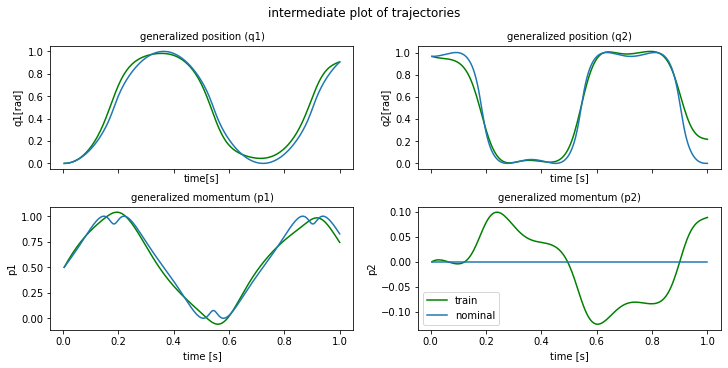

plot time : 1.2965824604034424
epoch  440 | train time 3.07 | train loss 7.531357e-02 | test loss 9.529871e-02 | test time 0.55  
epoch  441 | train time 1.71 | train loss 7.067787e-02 
epoch  442 | train time 1.86 | train loss 5.406874e-02 
epoch  443 | train time 1.81 | train loss 9.717201e-02 
epoch  444 | train time 1.70 | train loss 8.546363e-02 
epoch  445 | train time 1.70 | train loss 6.420404e-02 
epoch  446 | train time 1.85 | train loss 6.367009e-02 
epoch  447 | train time 1.76 | train loss 6.162702e-02 
epoch  448 | train time 1.81 | train loss 5.522567e-02 
epoch  449 | train time 1.85 | train loss 9.337043e-02 


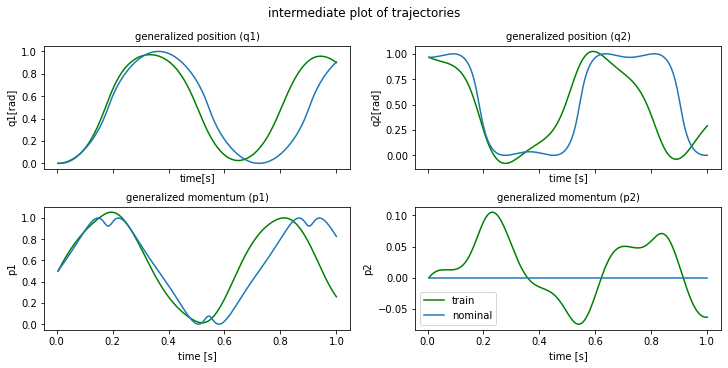

plot time : 1.1743519306182861
epoch  450 | train time 2.91 | train loss 9.703261e-02 | test loss 7.199033e-02 | test time 0.70  
epoch  451 | train time 1.68 | train loss 5.562292e-02 
epoch  452 | train time 1.69 | train loss 1.797893e-01 
epoch  453 | train time 1.93 | train loss 2.384495e-01 
epoch  454 | train time 1.70 | train loss 1.757819e-01 
epoch  455 | train time 1.69 | train loss 1.033607e-01 
epoch  456 | train time 1.71 | train loss 1.073722e-01 
epoch  457 | train time 1.69 | train loss 1.427057e-01 
epoch  458 | train time 2.00 | train loss 1.294179e-01 
epoch  459 | train time 1.69 | train loss 8.953700e-02 


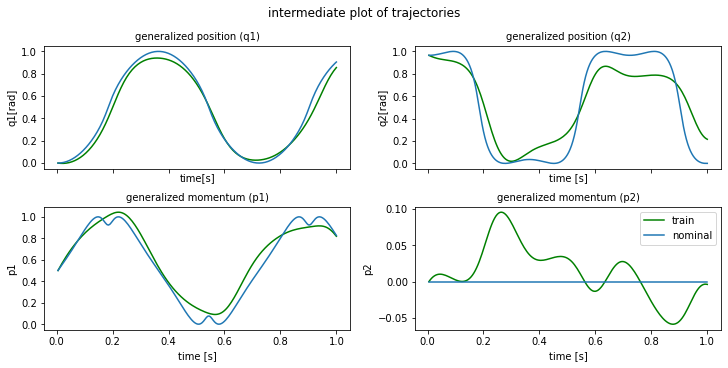

plot time : 1.1750290393829346
epoch  460 | train time 2.99 | train loss 8.790150e-02 | test loss 1.126817e-01 | test time 0.66  
epoch  461 | train time 1.80 | train loss 1.066731e-01 
epoch  462 | train time 1.86 | train loss 9.176660e-02 
epoch  463 | train time 1.86 | train loss 8.136438e-02 
epoch  464 | train time 1.84 | train loss 8.826758e-02 
epoch  465 | train time 1.94 | train loss 8.952563e-02 
epoch  466 | train time 1.74 | train loss 7.953054e-02 
epoch  467 | train time 1.70 | train loss 8.832040e-02 
epoch  468 | train time 1.89 | train loss 7.212806e-02 
epoch  469 | train time 1.87 | train loss 8.180669e-02 


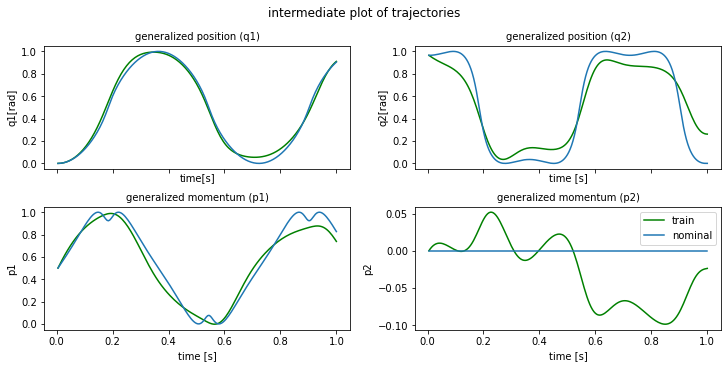

plot time : 1.179384708404541
epoch  470 | train time 3.07 | train loss 9.149157e-02 | test loss 7.863967e-02 | test time 0.55  
epoch  471 | train time 1.78 | train loss 6.836843e-02 
epoch  472 | train time 1.89 | train loss 8.532406e-02 
epoch  473 | train time 1.75 | train loss 9.052868e-02 
epoch  474 | train time 1.84 | train loss 7.915537e-02 
epoch  475 | train time 1.69 | train loss 8.051036e-02 
epoch  476 | train time 1.73 | train loss 7.641224e-02 
epoch  477 | train time 1.87 | train loss 7.387283e-02 
epoch  478 | train time 1.75 | train loss 6.740438e-02 
epoch  479 | train time 1.68 | train loss 7.365187e-02 


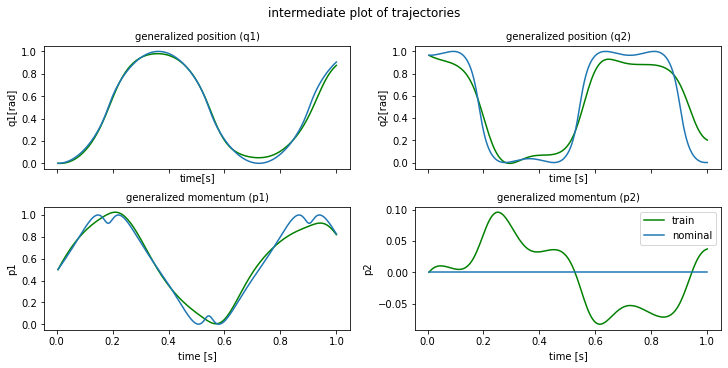

plot time : 1.1811754703521729
epoch  480 | train time 3.00 | train loss 7.522624e-02 | test loss 6.892514e-02 | test time 0.57  
epoch  481 | train time 2.07 | train loss 5.968080e-02 
epoch  482 | train time 2.38 | train loss 6.500583e-02 
epoch  483 | train time 1.81 | train loss 6.539216e-02 
epoch  484 | train time 1.87 | train loss 6.152488e-02 
epoch  485 | train time 1.72 | train loss 6.779728e-02 
epoch  486 | train time 1.72 | train loss 5.586240e-02 
epoch  487 | train time 1.85 | train loss 9.209819e-02 
epoch  488 | train time 1.72 | train loss 1.088093e-01 
epoch  489 | train time 1.82 | train loss 7.554646e-02 


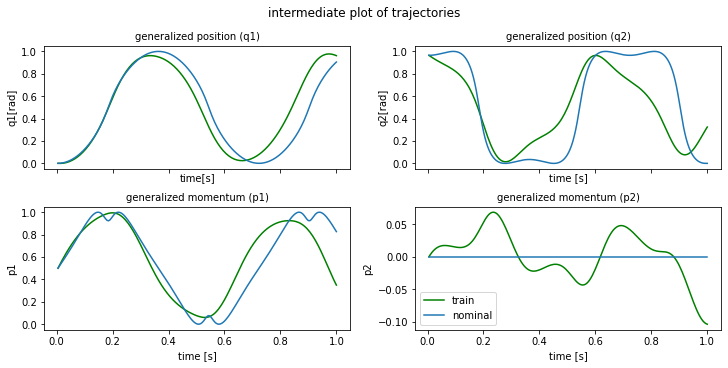

plot time : 1.2503759860992432
epoch  490 | train time 3.12 | train loss 7.576299e-02 | test loss 9.999513e-02 | test time 0.55  
epoch  491 | train time 1.79 | train loss 9.275451e-02 
epoch  492 | train time 1.84 | train loss 7.009406e-02 
epoch  493 | train time 1.81 | train loss 6.963235e-02 
epoch  494 | train time 1.85 | train loss 8.817880e-02 
epoch  495 | train time 1.87 | train loss 6.145305e-02 
epoch  496 | train time 1.77 | train loss 7.884985e-02 
epoch  497 | train time 1.79 | train loss 9.242685e-02 
epoch  498 | train time 1.95 | train loss 6.816800e-02 
epoch  499 | train time 1.80 | train loss 8.187529e-02 
horizon length : 250
min max values updated


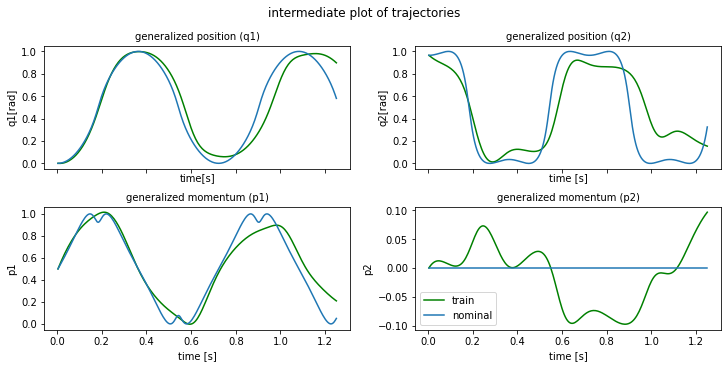

plot time : 1.2056527137756348
min max values updated
epoch  500 | train time 3.49 | train loss 1.472482e-01 | test loss 1.088496e-01 | test time 0.92  
epoch  501 | train time 2.61 | train loss 1.022061e-01 
epoch  502 | train time 2.17 | train loss 9.379713e-02 
epoch  503 | train time 2.23 | train loss 1.150915e-01 
epoch  504 | train time 2.44 | train loss 8.309472e-02 
epoch  505 | train time 2.33 | train loss 1.201751e-01 
epoch  506 | train time 2.15 | train loss 1.264914e-01 
epoch  507 | train time 2.32 | train loss 8.827370e-02 
epoch  508 | train time 2.20 | train loss 9.604928e-02 
epoch  509 | train time 2.28 | train loss 1.031554e-01 


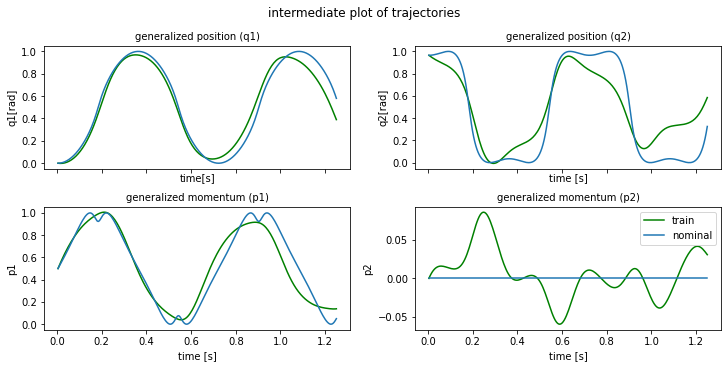

plot time : 1.2238554954528809
epoch  510 | train time 3.47 | train loss 8.164193e-02 | test loss 1.282429e-01 | test time 0.67  
epoch  511 | train time 2.25 | train loss 9.398862e-02 
epoch  512 | train time 2.21 | train loss 9.596035e-02 
epoch  513 | train time 2.14 | train loss 9.337343e-02 
epoch  514 | train time 2.20 | train loss 1.022644e-01 
epoch  515 | train time 2.14 | train loss 8.409754e-02 
epoch  516 | train time 2.26 | train loss 8.040611e-02 
epoch  517 | train time 2.16 | train loss 8.655251e-02 
epoch  518 | train time 2.38 | train loss 8.500631e-02 
epoch  519 | train time 2.30 | train loss 9.736711e-02 


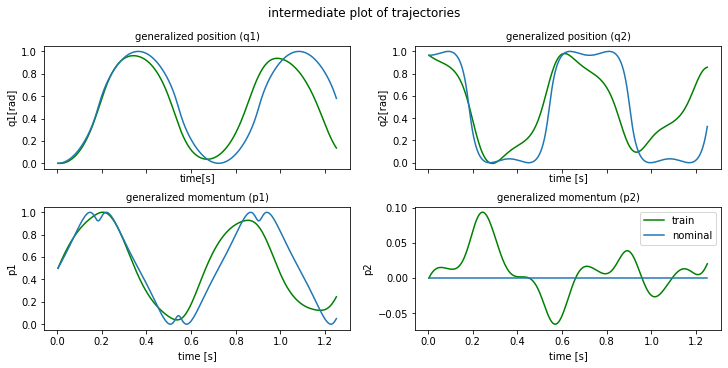

plot time : 1.2655186653137207
epoch  520 | train time 3.60 | train loss 9.454770e-02 | test loss 9.474961e-02 | test time 0.68  
epoch  521 | train time 2.38 | train loss 8.242466e-02 
epoch  522 | train time 2.54 | train loss 8.250763e-02 
epoch  523 | train time 2.13 | train loss 8.790343e-02 
epoch  524 | train time 2.39 | train loss 8.131014e-02 
epoch  525 | train time 2.14 | train loss 1.016505e-01 
epoch  526 | train time 2.27 | train loss 1.004160e-01 
epoch  527 | train time 2.42 | train loss 7.445961e-02 
epoch  528 | train time 2.18 | train loss 7.345535e-02 
epoch  529 | train time 2.13 | train loss 9.733962e-02 


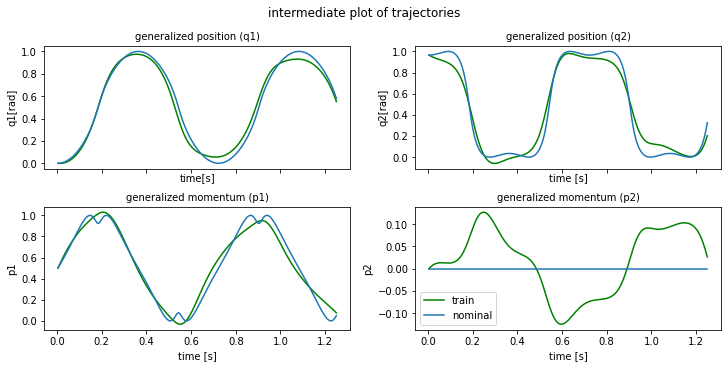

plot time : 1.223454236984253
epoch  530 | train time 3.40 | train loss 8.436850e-02 | test loss 1.189676e-01 | test time 0.67  
epoch  531 | train time 2.34 | train loss 9.805997e-02 
epoch  532 | train time 2.46 | train loss 1.018746e-01 
epoch  533 | train time 2.38 | train loss 7.333764e-02 
epoch  534 | train time 2.17 | train loss 8.514972e-02 
epoch  535 | train time 2.37 | train loss 7.638779e-02 
epoch  536 | train time 2.21 | train loss 8.891439e-02 
epoch  537 | train time 2.48 | train loss 8.728214e-02 
epoch  538 | train time 2.11 | train loss 7.572448e-02 
epoch  539 | train time 2.22 | train loss 7.329562e-02 


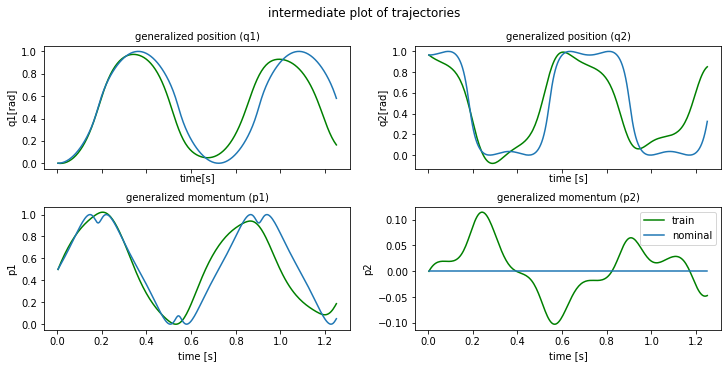

plot time : 1.1935412883758545
epoch  540 | train time 3.42 | train loss 9.389386e-02 | test loss 9.329926e-02 | test time 0.70  
epoch  541 | train time 2.12 | train loss 9.172607e-02 
epoch  542 | train time 2.09 | train loss 7.525137e-02 
epoch  543 | train time 2.20 | train loss 9.041043e-02 
epoch  544 | train time 2.13 | train loss 7.861253e-02 
epoch  545 | train time 2.14 | train loss 9.141975e-02 
epoch  546 | train time 2.12 | train loss 9.632524e-02 
epoch  547 | train time 2.28 | train loss 7.239646e-02 
epoch  548 | train time 2.11 | train loss 9.366431e-02 
epoch  549 | train time 2.31 | train loss 9.056576e-02 


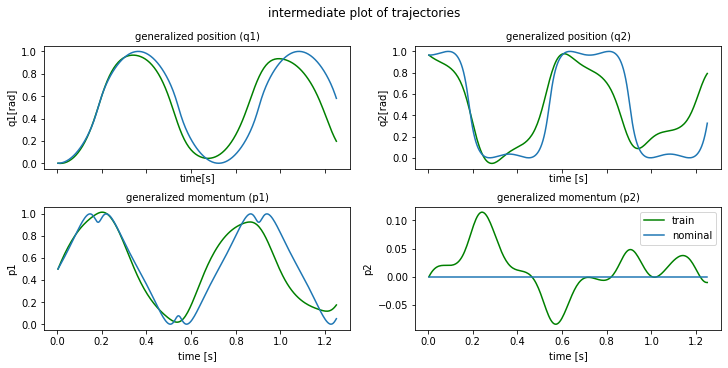

plot time : 1.1916706562042236
epoch  550 | train time 3.61 | train loss 7.432923e-02 | test loss 9.590626e-02 | test time 0.77  
epoch  551 | train time 2.25 | train loss 9.556521e-02 
epoch  552 | train time 2.25 | train loss 8.377701e-02 
epoch  553 | train time 2.13 | train loss 8.349469e-02 
epoch  554 | train time 2.32 | train loss 8.619839e-02 
epoch  555 | train time 2.27 | train loss 7.776937e-02 
epoch  556 | train time 2.15 | train loss 8.026792e-02 
epoch  557 | train time 2.35 | train loss 7.909142e-02 
epoch  558 | train time 2.11 | train loss 7.346601e-02 
epoch  559 | train time 2.16 | train loss 8.495017e-02 


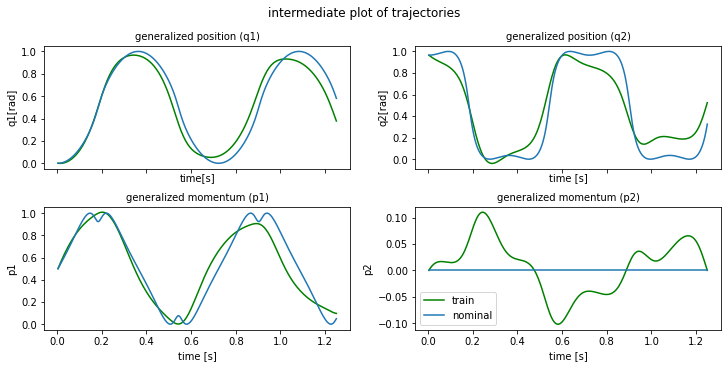

plot time : 1.225862741470337
epoch  560 | train time 3.61 | train loss 7.831629e-02 | test loss 1.082448e-01 | test time 0.68  
epoch  561 | train time 2.48 | train loss 8.627112e-02 
epoch  562 | train time 2.19 | train loss 8.469078e-02 
epoch  563 | train time 2.43 | train loss 7.996559e-02 
epoch  564 | train time 2.20 | train loss 8.117895e-02 
epoch  565 | train time 2.33 | train loss 7.664882e-02 
epoch  566 | train time 2.15 | train loss 7.344004e-02 
epoch  567 | train time 2.25 | train loss 9.338777e-02 
epoch  568 | train time 2.31 | train loss 9.008294e-02 
epoch  569 | train time 2.26 | train loss 7.106999e-02 


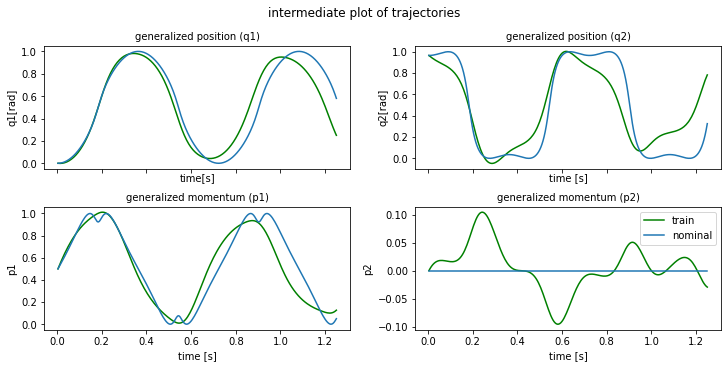

plot time : 1.2519004344940186
epoch  570 | train time 3.50 | train loss 7.204019e-02 | test loss 9.020852e-02 | test time 0.70  
epoch  571 | train time 2.33 | train loss 8.070208e-02 
epoch  572 | train time 2.15 | train loss 7.212752e-02 
epoch  573 | train time 2.15 | train loss 9.600088e-02 
epoch  574 | train time 2.52 | train loss 1.005977e-01 
epoch  575 | train time 2.65 | train loss 6.637601e-02 
epoch  576 | train time 2.28 | train loss 7.882928e-02 
epoch  577 | train time 2.14 | train loss 6.885026e-02 
epoch  578 | train time 2.24 | train loss 9.350855e-02 
epoch  579 | train time 2.30 | train loss 8.985341e-02 


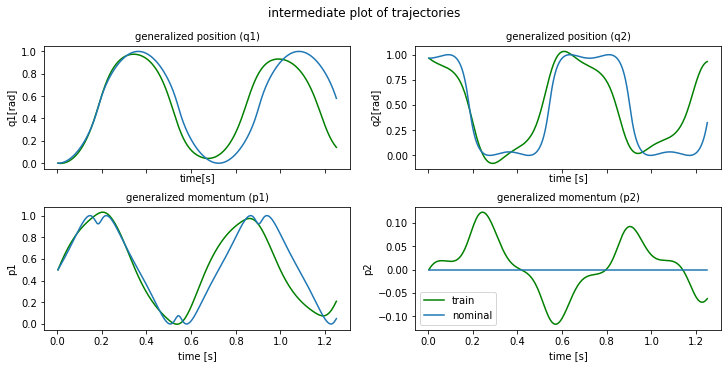

plot time : 1.8288886547088623
epoch  580 | train time 4.44 | train loss 7.240675e-02 | test loss 9.288143e-02 | test time 0.70  
epoch  581 | train time 2.11 | train loss 9.148623e-02 
epoch  582 | train time 2.15 | train loss 7.261580e-02 
epoch  583 | train time 2.13 | train loss 9.012254e-02 
epoch  584 | train time 2.12 | train loss 9.340634e-02 
epoch  585 | train time 2.26 | train loss 7.414125e-02 
epoch  586 | train time 2.16 | train loss 8.358008e-02 
epoch  587 | train time 2.29 | train loss 7.381397e-02 
epoch  588 | train time 2.31 | train loss 1.093142e-01 
epoch  589 | train time 2.13 | train loss 1.192625e-01 


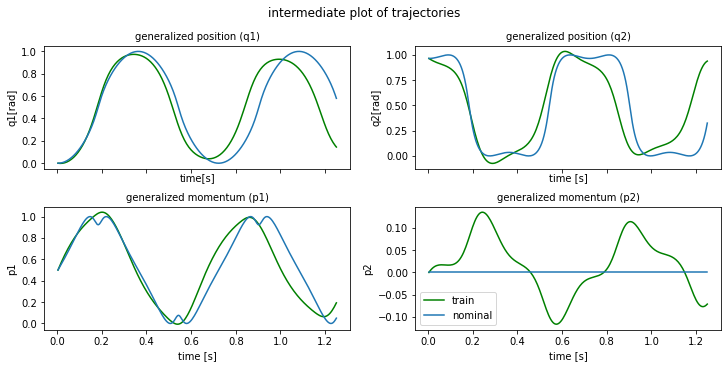

plot time : 1.253204345703125
epoch  590 | train time 3.48 | train loss 9.480847e-02 | test loss 8.433854e-02 | test time 0.67  
epoch  591 | train time 2.43 | train loss 7.434233e-02 
epoch  592 | train time 2.19 | train loss 9.066295e-02 
epoch  593 | train time 2.17 | train loss 7.694434e-02 
epoch  594 | train time 2.35 | train loss 9.442096e-02 
epoch  595 | train time 2.13 | train loss 9.504167e-02 
epoch  596 | train time 2.19 | train loss 7.053748e-02 
epoch  597 | train time 2.11 | train loss 7.062276e-02 
epoch  598 | train time 2.17 | train loss 7.714549e-02 
epoch  599 | train time 2.29 | train loss 7.287980e-02 
horizon length : 300
min max values updated


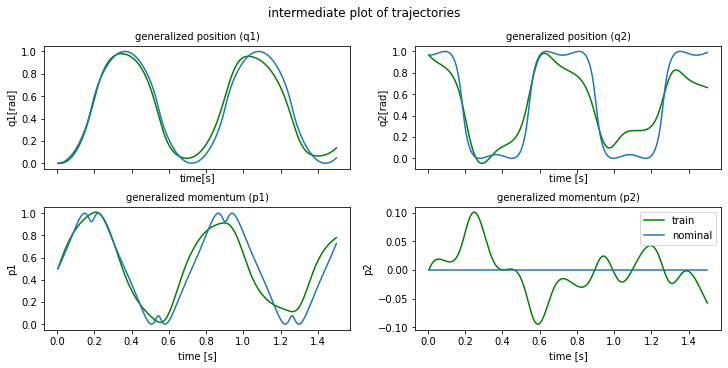

plot time : 1.2451555728912354
min max values updated
epoch  600 | train time 3.87 | train loss 1.012537e-01 | test loss 9.904209e-02 | test time 0.87  
epoch  601 | train time 2.54 | train loss 9.221961e-02 
epoch  602 | train time 2.69 | train loss 1.001975e-01 
epoch  603 | train time 2.79 | train loss 1.139594e-01 
epoch  604 | train time 2.67 | train loss 8.452526e-02 
epoch  605 | train time 2.74 | train loss 1.385963e-01 
epoch  606 | train time 2.73 | train loss 1.406705e-01 
epoch  607 | train time 2.83 | train loss 1.172571e-01 
epoch  608 | train time 2.69 | train loss 1.142721e-01 
epoch  609 | train time 2.97 | train loss 1.165569e-01 


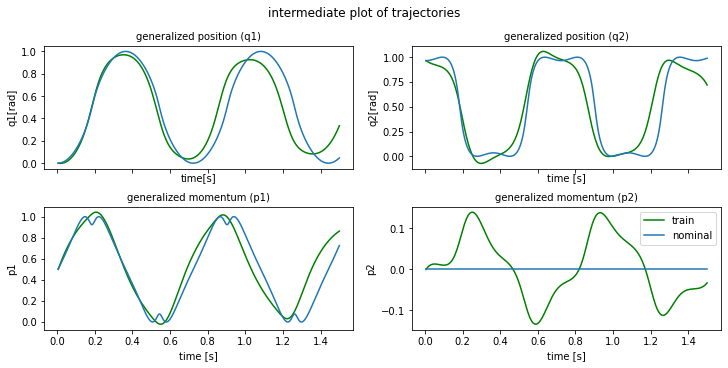

plot time : 1.5436954498291016
epoch  610 | train time 4.95 | train loss 1.003706e-01 | test loss 1.789217e-01 | test time 1.66  
epoch  611 | train time 3.31 | train loss 1.792861e-01 
epoch  612 | train time 2.54 | train loss 2.115009e-01 
epoch  613 | train time 2.94 | train loss 1.353768e-01 
epoch  614 | train time 2.54 | train loss 1.216811e-01 
epoch  615 | train time 2.70 | train loss 1.202022e-01 
epoch  616 | train time 2.67 | train loss 1.339950e-01 
epoch  617 | train time 3.55 | train loss 1.136411e-01 
epoch  618 | train time 2.94 | train loss 1.061954e-01 
epoch  619 | train time 3.07 | train loss 1.239598e-01 


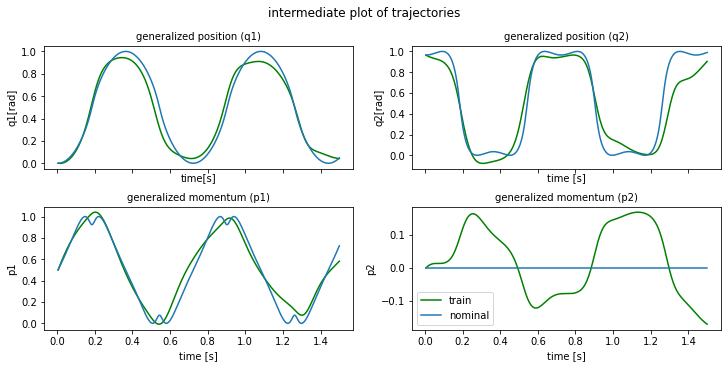

plot time : 2.0887181758880615
epoch  620 | train time 6.10 | train loss 1.460671e-01 | test loss 1.146183e-01 | test time 0.86  
epoch  621 | train time 2.81 | train loss 1.000056e-01 
epoch  622 | train time 2.63 | train loss 1.018975e-01 
epoch  623 | train time 2.57 | train loss 1.056950e-01 
epoch  624 | train time 2.87 | train loss 9.888648e-02 
epoch  625 | train time 2.56 | train loss 1.086513e-01 
epoch  626 | train time 2.71 | train loss 1.044977e-01 
epoch  627 | train time 3.25 | train loss 9.576769e-02 
epoch  628 | train time 2.74 | train loss 9.275807e-02 
epoch  629 | train time 2.55 | train loss 1.171138e-01 


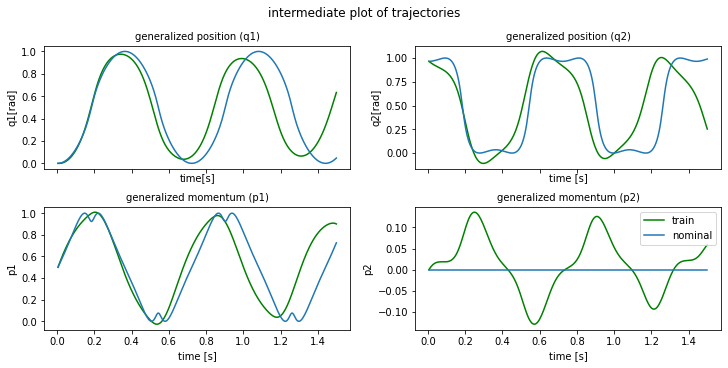

plot time : 1.2868006229400635
epoch  630 | train time 4.11 | train loss 1.072625e-01 | test loss 1.149582e-01 | test time 0.98  
epoch  631 | train time 3.16 | train loss 1.192788e-01 
epoch  632 | train time 4.59 | train loss 1.136564e-01 
epoch  633 | train time 2.91 | train loss 8.922464e-02 
epoch  634 | train time 4.10 | train loss 9.054719e-02 
epoch  635 | train time 2.92 | train loss 8.987445e-02 
epoch  636 | train time 2.69 | train loss 8.932581e-02 
epoch  637 | train time 2.64 | train loss 9.458315e-02 
epoch  638 | train time 2.84 | train loss 8.941495e-02 
epoch  639 | train time 2.93 | train loss 8.852848e-02 


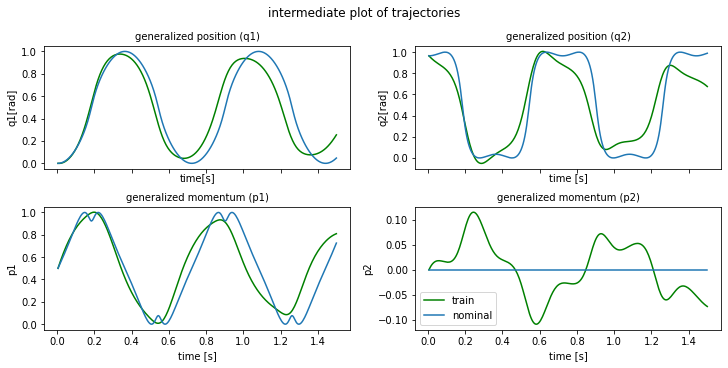

plot time : 1.194779396057129
epoch  640 | train time 3.80 | train loss 8.457327e-02 | test loss 1.037013e-01 | test time 0.98  
epoch  641 | train time 2.61 | train loss 9.800912e-02 
epoch  642 | train time 2.86 | train loss 8.516445e-02 
epoch  643 | train time 2.92 | train loss 1.162827e-01 
epoch  644 | train time 2.81 | train loss 1.233243e-01 
epoch  645 | train time 2.67 | train loss 8.494066e-02 
epoch  646 | train time 2.55 | train loss 1.202279e-01 
epoch  647 | train time 2.63 | train loss 1.111391e-01 
epoch  648 | train time 2.91 | train loss 1.121060e-01 
epoch  649 | train time 2.91 | train loss 1.156805e-01 


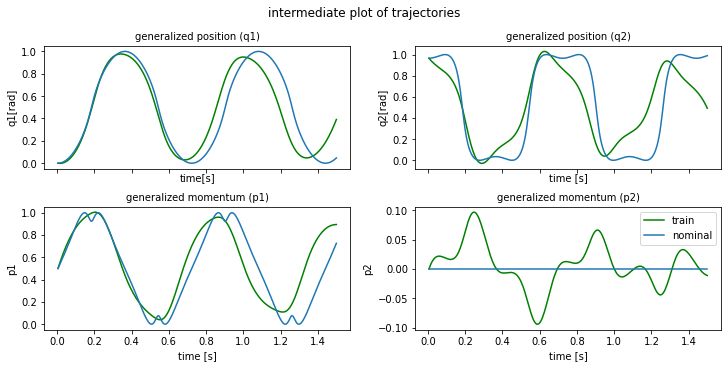

plot time : 1.2012817859649658
epoch  650 | train time 3.90 | train loss 1.140545e-01 | test loss 9.801204e-02 | test time 0.95  
epoch  651 | train time 2.63 | train loss 8.534092e-02 
epoch  652 | train time 2.72 | train loss 8.126310e-02 
epoch  653 | train time 2.53 | train loss 1.295400e-01 
epoch  654 | train time 2.57 | train loss 1.129264e-01 
epoch  655 | train time 2.67 | train loss 1.311370e-01 
epoch  656 | train time 2.73 | train loss 1.216000e-01 
epoch  657 | train time 3.22 | train loss 1.032770e-01 
epoch  658 | train time 3.20 | train loss 1.052805e-01 
epoch  659 | train time 2.54 | train loss 1.043762e-01 


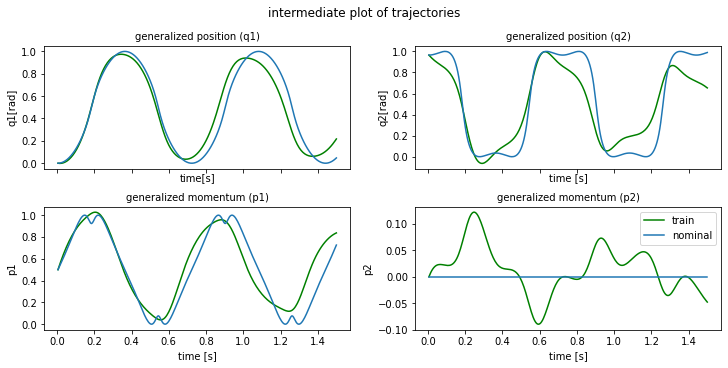

plot time : 1.9731402397155762
epoch  660 | train time 4.99 | train loss 8.448466e-02 | test loss 1.192595e-01 | test time 0.82  
epoch  661 | train time 2.70 | train loss 1.172881e-01 
epoch  662 | train time 2.59 | train loss 1.783395e-01 
epoch  663 | train time 2.67 | train loss 1.560397e-01 
epoch  664 | train time 2.73 | train loss 1.953523e-01 
epoch  665 | train time 2.69 | train loss 1.932001e-01 
epoch  666 | train time 2.56 | train loss 1.493172e-01 
epoch  667 | train time 2.85 | train loss 1.257494e-01 
epoch  668 | train time 2.75 | train loss 1.050777e-01 
epoch  669 | train time 2.86 | train loss 9.344771e-02 


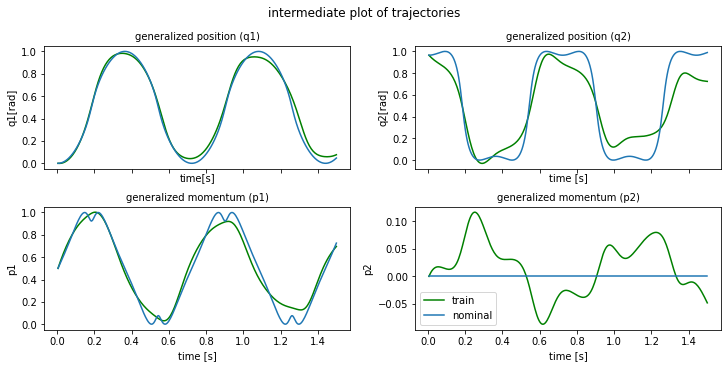

plot time : 1.259861707687378
epoch  670 | train time 4.09 | train loss 1.174390e-01 | test loss 1.485556e-01 | test time 0.81  
epoch  671 | train time 2.71 | train loss 1.205273e-01 
epoch  672 | train time 2.90 | train loss 9.070174e-02 
epoch  673 | train time 2.66 | train loss 1.056044e-01 
epoch  674 | train time 2.62 | train loss 9.812018e-02 
epoch  675 | train time 2.56 | train loss 1.114507e-01 
epoch  676 | train time 2.98 | train loss 1.198703e-01 
epoch  677 | train time 2.82 | train loss 9.057756e-02 
epoch  678 | train time 2.53 | train loss 1.022112e-01 
epoch  679 | train time 2.86 | train loss 9.869382e-02 


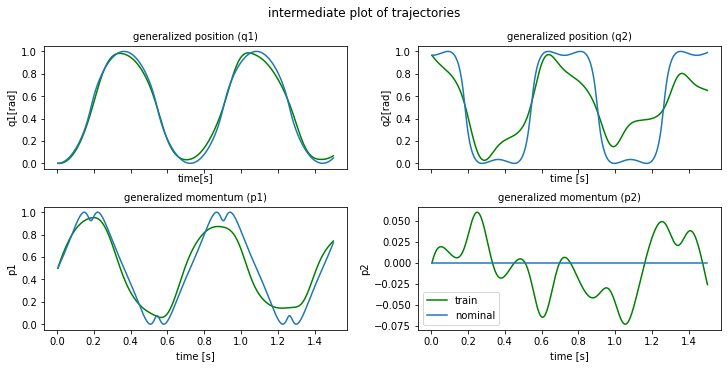

plot time : 1.229243278503418
epoch  680 | train time 3.96 | train loss 1.059153e-01 | test loss 1.293477e-01 | test time 0.89  
epoch  681 | train time 2.52 | train loss 1.030304e-01 
epoch  682 | train time 2.78 | train loss 8.653351e-02 
epoch  683 | train time 2.53 | train loss 9.705742e-02 
epoch  684 | train time 2.58 | train loss 8.580568e-02 
epoch  685 | train time 2.77 | train loss 1.444568e-01 
epoch  686 | train time 2.76 | train loss 1.264481e-01 
epoch  687 | train time 2.71 | train loss 9.377514e-02 
epoch  688 | train time 2.57 | train loss 9.531496e-02 
epoch  689 | train time 2.51 | train loss 9.823896e-02 


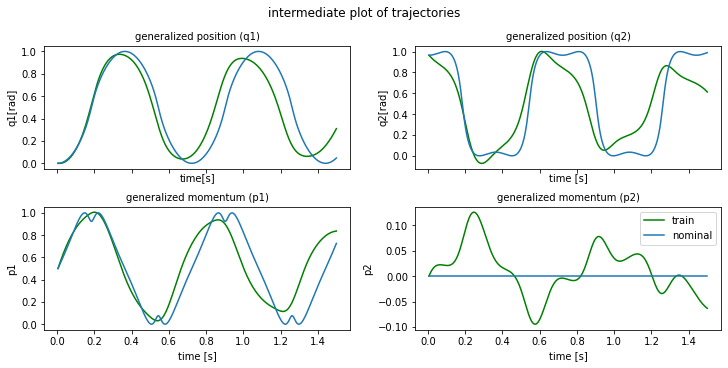

plot time : 1.2158408164978027
epoch  690 | train time 3.94 | train loss 8.892870e-02 | test loss 1.262668e-01 | test time 0.88  
epoch  691 | train time 2.64 | train loss 1.240339e-01 
epoch  692 | train time 2.58 | train loss 1.210734e-01 
epoch  693 | train time 2.76 | train loss 8.715981e-02 
epoch  694 | train time 2.65 | train loss 9.775925e-02 
epoch  695 | train time 2.53 | train loss 9.531059e-02 
epoch  696 | train time 2.59 | train loss 9.299308e-02 
epoch  697 | train time 2.55 | train loss 8.452346e-02 
epoch  698 | train time 2.54 | train loss 1.081379e-01 
epoch  699 | train time 2.77 | train loss 1.092146e-01 


In [21]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [22]:
if collect_grads:
    plot_grads(stats)

In [23]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [24]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [25]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

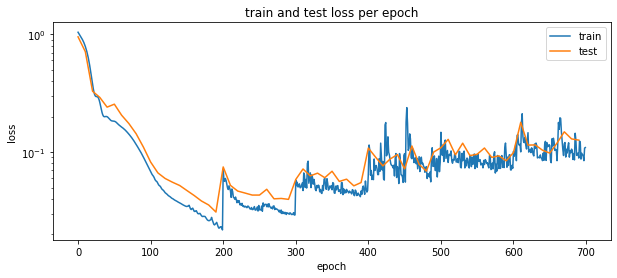

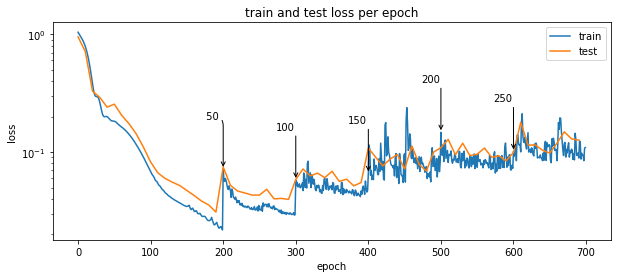

In [26]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

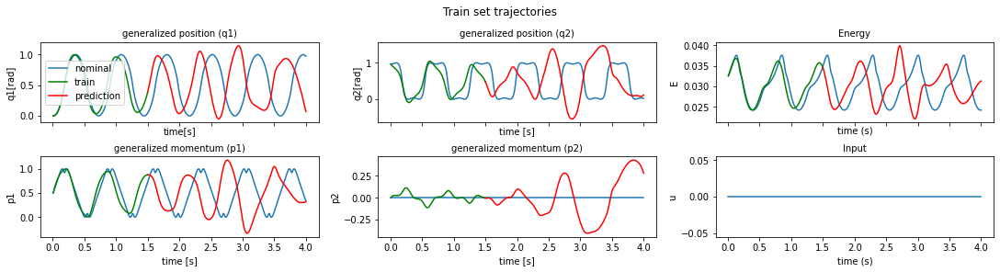

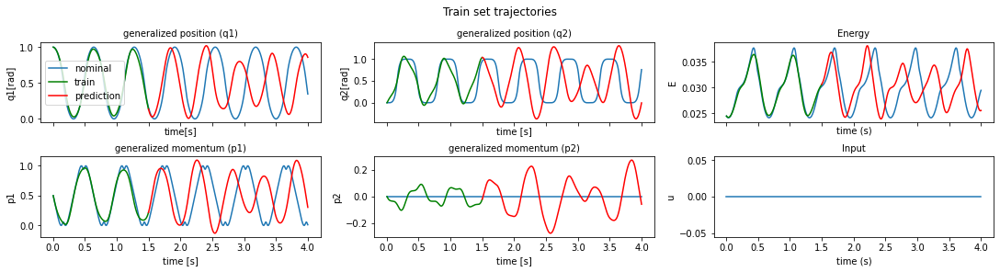

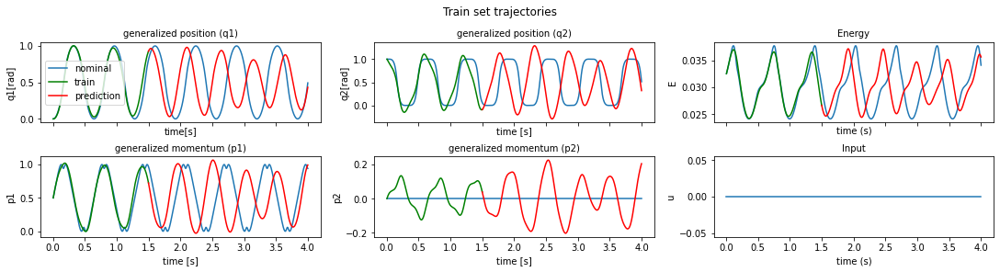

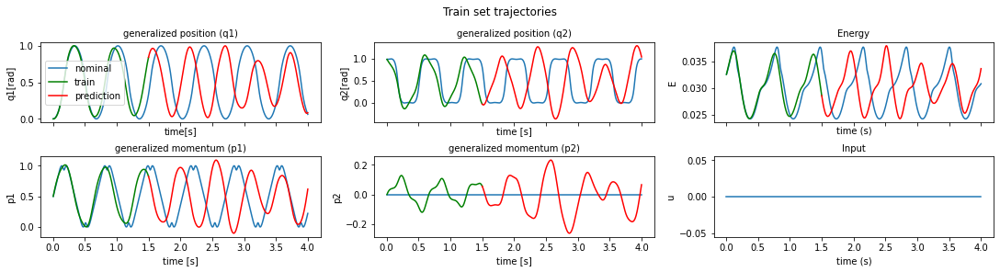

In [27]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

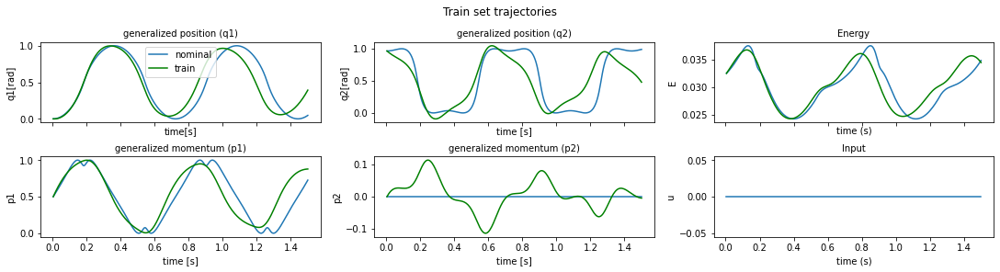

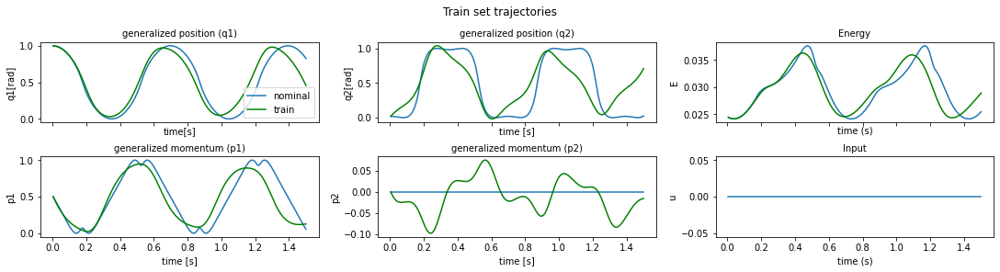

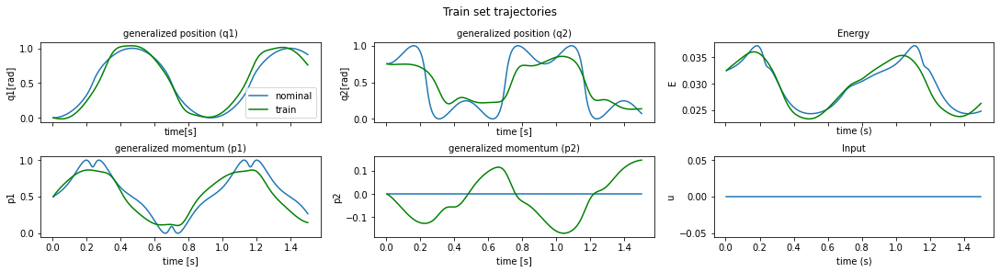

In [28]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + "nopred.png",
        w_rescale=w_rescale,
    )

##### 30k parameters - w horizon no rescaling 

In [29]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800  # length of a trajectory
num_trajectories = 125  # number of trajectories in total
proportion = 0.8  # train test proportion
batch_size = 100  # batch size used by dataloader
w_rescale = [1, 1, 1, 1]  # [1, 1000, 1, 10000]  # [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False  # shuffle sample in the batches between epochs
# 'hamiltonian' or 'newtonian', newtonian if you want [q1,q1_dot,q2,q2_dot]
coord_type = "hamiltonian"
min_max_rescale = False  # rescale the training trajectories
# which dimensions to rescale if using min_max_rescale, so that nothing is divided by zero
rescale_dims = [1, 1, 1, 0]

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = False
grad_clip = False  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)  # total number of training epochs

cpu


In [30]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [31]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=90, nb_hidden_layers=4, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 33303
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p33k_Ts0.005_nodissip_
horizon_list and switch_steps have the same size


horizon length : 50


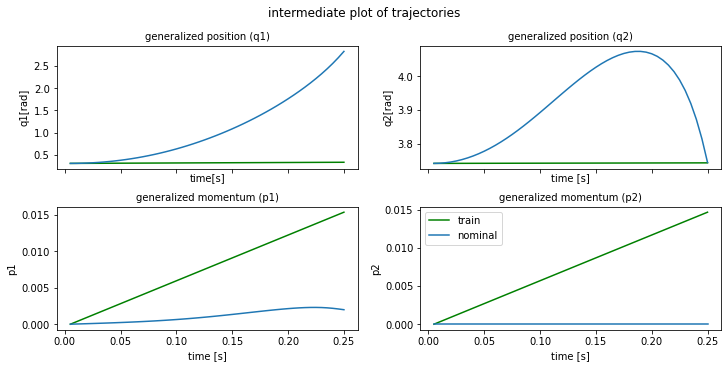

plot time : 1.2603118419647217
epoch    0 | train time 2.07 | train loss 2.407944e+00 | test loss 2.385669e+00 | test time 0.22  
epoch    1 | train time 0.77 | train loss 2.372730e+00 
epoch    2 | train time 0.76 | train loss 2.329036e+00 
epoch    3 | train time 0.77 | train loss 2.267892e+00 
epoch    4 | train time 0.80 | train loss 2.183889e+00 
epoch    5 | train time 0.78 | train loss 2.074941e+00 
epoch    6 | train time 0.77 | train loss 1.937609e+00 
epoch    7 | train time 0.78 | train loss 1.767080e+00 
epoch    8 | train time 0.80 | train loss 1.568643e+00 
epoch    9 | train time 0.78 | train loss 1.352023e+00 


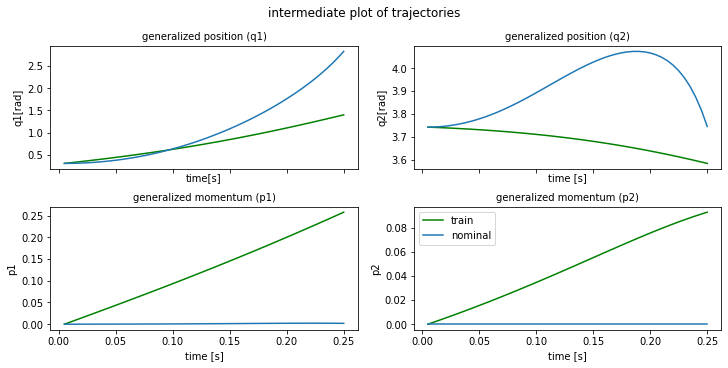

plot time : 1.305525541305542
epoch   10 | train time 2.16 | train loss 1.124907e+00 | test loss 9.334048e-01 | test time 0.27  
epoch   11 | train time 0.83 | train loss 9.040712e-01 
epoch   12 | train time 0.78 | train loss 6.993330e-01 
epoch   13 | train time 0.86 | train loss 5.308358e-01 
epoch   14 | train time 0.77 | train loss 4.122596e-01 
epoch   15 | train time 0.85 | train loss 3.411559e-01 
epoch   16 | train time 0.78 | train loss 3.163989e-01 
epoch   17 | train time 0.78 | train loss 2.967088e-01 
epoch   18 | train time 0.77 | train loss 2.892949e-01 
epoch   19 | train time 0.77 | train loss 2.611111e-01 


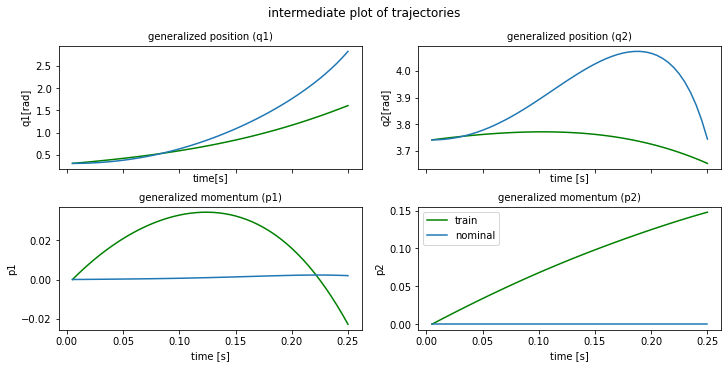

plot time : 1.1538975238800049
epoch   20 | train time 1.95 | train loss 2.424552e-01 | test loss 2.815419e-01 | test time 0.20  
epoch   21 | train time 0.88 | train loss 2.471540e-01 
epoch   22 | train time 0.83 | train loss 2.257646e-01 
epoch   23 | train time 0.79 | train loss 2.217689e-01 
epoch   24 | train time 0.77 | train loss 2.106365e-01 
epoch   25 | train time 0.78 | train loss 2.042515e-01 
epoch   26 | train time 0.77 | train loss 2.014324e-01 
epoch   27 | train time 0.77 | train loss 1.925640e-01 
epoch   28 | train time 0.78 | train loss 1.962553e-01 
epoch   29 | train time 0.77 | train loss 1.834646e-01 


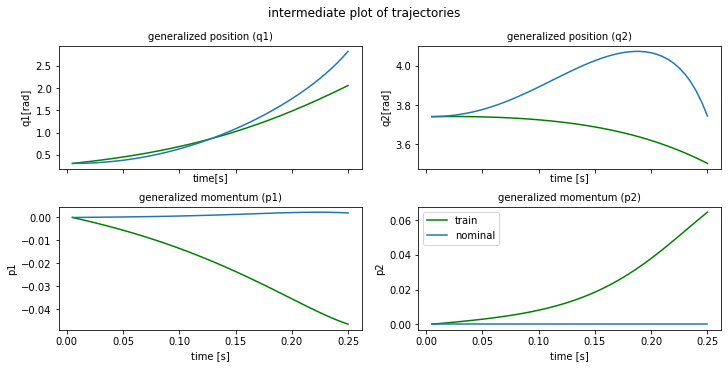

plot time : 1.26416015625
epoch   30 | train time 2.16 | train loss 1.812966e-01 | test loss 1.901795e-01 | test time 0.28  
epoch   31 | train time 0.87 | train loss 1.773446e-01 
epoch   32 | train time 0.79 | train loss 1.753803e-01 
epoch   33 | train time 0.78 | train loss 1.637134e-01 
epoch   34 | train time 0.89 | train loss 1.559706e-01 
epoch   35 | train time 0.81 | train loss 1.490286e-01 
epoch   36 | train time 0.80 | train loss 1.401476e-01 
epoch   37 | train time 0.90 | train loss 1.399082e-01 
epoch   38 | train time 0.80 | train loss 1.371753e-01 
epoch   39 | train time 0.78 | train loss 1.860661e-01 


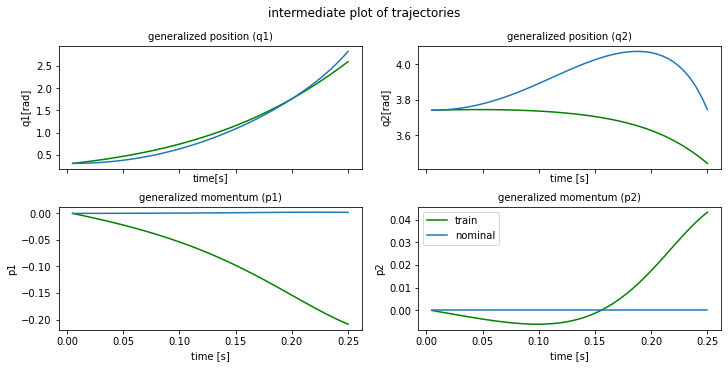

plot time : 1.1689674854278564
epoch   40 | train time 1.96 | train loss 2.931294e-01 | test loss 2.149647e-01 | test time 0.21  
epoch   41 | train time 0.77 | train loss 2.009049e-01 
epoch   42 | train time 0.79 | train loss 1.916118e-01 
epoch   43 | train time 0.80 | train loss 1.491476e-01 
epoch   44 | train time 0.79 | train loss 1.845567e-01 
epoch   45 | train time 0.77 | train loss 1.349145e-01 
epoch   46 | train time 0.78 | train loss 1.719012e-01 
epoch   47 | train time 0.90 | train loss 1.426604e-01 
epoch   48 | train time 0.84 | train loss 1.330213e-01 
epoch   49 | train time 0.85 | train loss 1.396728e-01 


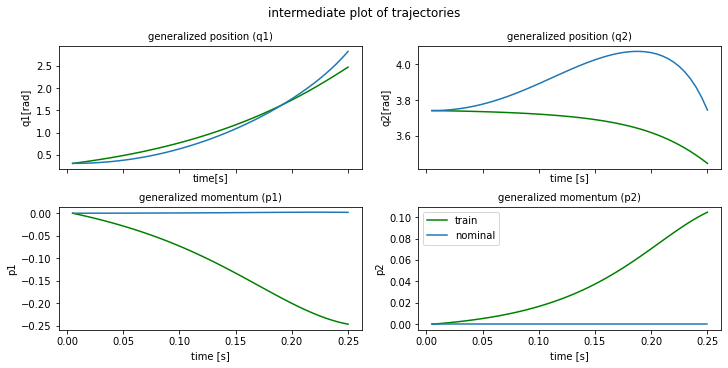

plot time : 1.1818373203277588
epoch   50 | train time 2.05 | train loss 1.282522e-01 | test loss 1.530275e-01 | test time 0.31  
epoch   51 | train time 1.23 | train loss 1.377072e-01 
epoch   52 | train time 1.11 | train loss 1.248234e-01 
epoch   53 | train time 0.97 | train loss 1.226951e-01 
epoch   54 | train time 0.78 | train loss 1.213778e-01 
epoch   55 | train time 0.80 | train loss 1.114530e-01 
epoch   56 | train time 0.80 | train loss 1.201118e-01 
epoch   57 | train time 0.79 | train loss 1.068100e-01 
epoch   58 | train time 0.79 | train loss 1.074416e-01 
epoch   59 | train time 0.77 | train loss 1.013755e-01 


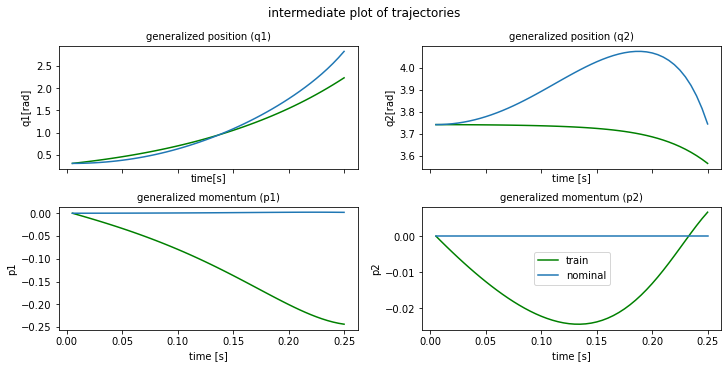

plot time : 1.249760389328003
epoch   60 | train time 2.05 | train loss 9.266682e-02 | test loss 1.056929e-01 | test time 0.21  
epoch   61 | train time 0.78 | train loss 9.773830e-02 
epoch   62 | train time 0.79 | train loss 8.551622e-02 
epoch   63 | train time 0.83 | train loss 9.159642e-02 
epoch   64 | train time 0.85 | train loss 8.020607e-02 
epoch   65 | train time 0.78 | train loss 7.946879e-02 
epoch   66 | train time 0.77 | train loss 7.322590e-02 
epoch   67 | train time 0.77 | train loss 7.817397e-02 
epoch   68 | train time 0.78 | train loss 6.858670e-02 
epoch   69 | train time 0.80 | train loss 6.951591e-02 


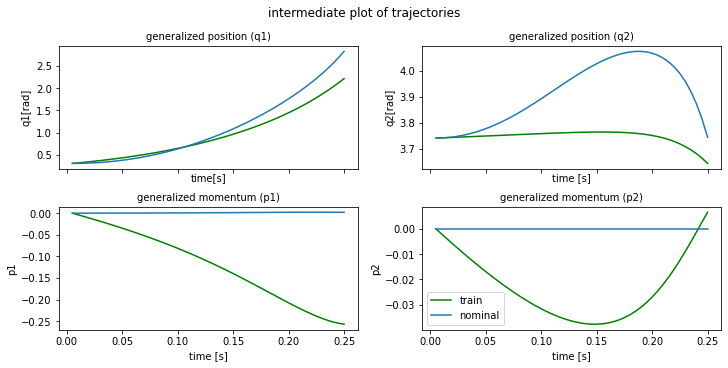

plot time : 1.1703605651855469
epoch   70 | train time 1.97 | train loss 6.140289e-02 | test loss 7.478602e-02 | test time 0.25  
epoch   71 | train time 0.88 | train loss 6.902780e-02 
epoch   72 | train time 0.77 | train loss 8.755133e-02 
epoch   73 | train time 0.91 | train loss 1.930609e-01 
epoch   74 | train time 0.79 | train loss 2.979662e-01 
epoch   75 | train time 0.88 | train loss 9.896896e-02 
epoch   76 | train time 0.83 | train loss 2.649410e-01 
epoch   77 | train time 0.82 | train loss 1.175682e-01 
epoch   78 | train time 0.92 | train loss 1.529010e-01 
epoch   79 | train time 0.85 | train loss 1.837098e-01 


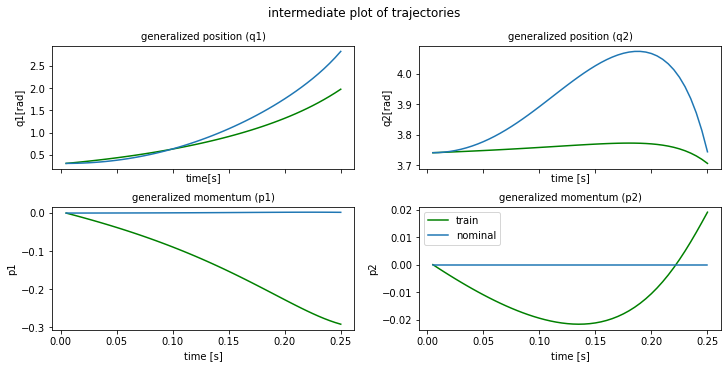

plot time : 1.1785786151885986
epoch   80 | train time 1.96 | train loss 7.002217e-02 | test loss 1.886936e-01 | test time 0.20  
epoch   81 | train time 0.78 | train loss 1.649673e-01 
epoch   82 | train time 0.78 | train loss 1.179749e-01 
epoch   83 | train time 0.78 | train loss 1.035447e-01 
epoch   84 | train time 0.78 | train loss 1.172410e-01 
epoch   85 | train time 0.82 | train loss 1.231356e-01 
epoch   86 | train time 0.77 | train loss 9.683444e-02 
epoch   87 | train time 0.78 | train loss 8.494706e-02 
epoch   88 | train time 0.79 | train loss 1.158789e-01 
epoch   89 | train time 0.76 | train loss 9.173772e-02 


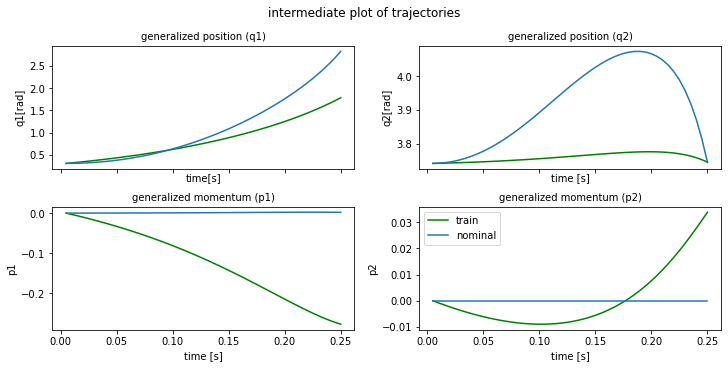

plot time : 1.2430412769317627
epoch   90 | train time 2.04 | train loss 8.908738e-02 | test loss 8.838698e-02 | test time 0.22  
epoch   91 | train time 0.78 | train loss 8.838411e-02 
epoch   92 | train time 0.78 | train loss 9.196824e-02 
epoch   93 | train time 0.79 | train loss 7.905516e-02 
epoch   94 | train time 0.89 | train loss 7.100551e-02 
epoch   95 | train time 0.82 | train loss 8.388376e-02 
epoch   96 | train time 0.79 | train loss 7.127395e-02 
epoch   97 | train time 0.87 | train loss 7.211419e-02 
epoch   98 | train time 0.78 | train loss 7.150806e-02 
epoch   99 | train time 0.78 | train loss 6.909565e-02 


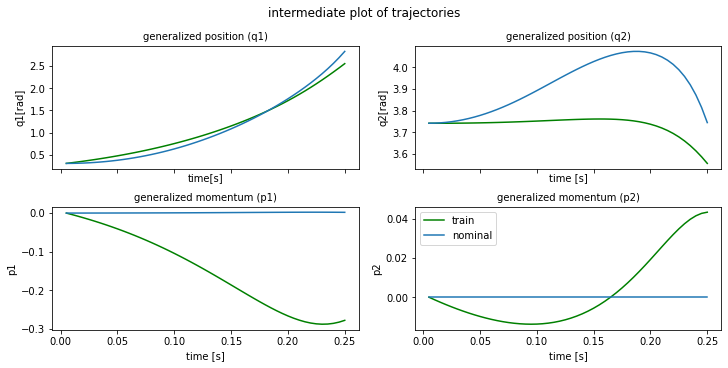

plot time : 1.2260732650756836
epoch  100 | train time 2.03 | train loss 5.911976e-02 | test loss 6.722654e-02 | test time 0.21  
epoch  101 | train time 0.77 | train loss 6.655423e-02 
epoch  102 | train time 0.76 | train loss 5.770585e-02 
epoch  103 | train time 0.80 | train loss 5.933037e-02 
epoch  104 | train time 0.78 | train loss 6.029228e-02 
epoch  105 | train time 0.78 | train loss 5.374312e-02 
epoch  106 | train time 0.85 | train loss 5.619954e-02 
epoch  107 | train time 0.83 | train loss 5.094074e-02 
epoch  108 | train time 0.78 | train loss 5.078917e-02 
epoch  109 | train time 0.85 | train loss 5.024550e-02 


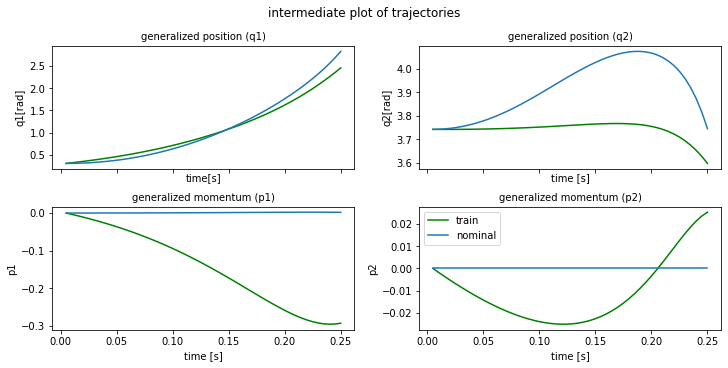

plot time : 1.1636888980865479
epoch  110 | train time 1.96 | train loss 4.646525e-02 | test loss 5.740676e-02 | test time 0.21  
epoch  111 | train time 0.78 | train loss 5.002315e-02 
epoch  112 | train time 0.78 | train loss 4.352762e-02 
epoch  113 | train time 0.77 | train loss 4.566688e-02 
epoch  114 | train time 0.80 | train loss 4.350947e-02 
epoch  115 | train time 0.78 | train loss 4.267966e-02 
epoch  116 | train time 0.88 | train loss 4.008737e-02 
epoch  117 | train time 0.90 | train loss 4.209810e-02 
epoch  118 | train time 0.79 | train loss 4.046062e-02 
epoch  119 | train time 0.79 | train loss 3.966243e-02 


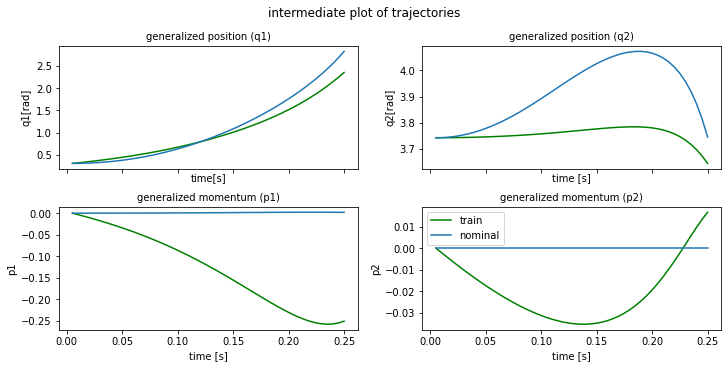

plot time : 1.238532543182373
epoch  120 | train time 2.04 | train loss 3.633587e-02 | test loss 3.943140e-02 | test time 0.21  
epoch  121 | train time 0.77 | train loss 3.758528e-02 
epoch  122 | train time 0.82 | train loss 3.678735e-02 
epoch  123 | train time 0.87 | train loss 3.898557e-02 
epoch  124 | train time 0.78 | train loss 3.805360e-02 
epoch  125 | train time 0.78 | train loss 3.901878e-02 
epoch  126 | train time 0.77 | train loss 4.008254e-02 
epoch  127 | train time 0.78 | train loss 4.146460e-02 
epoch  128 | train time 0.79 | train loss 4.474263e-02 
epoch  129 | train time 0.85 | train loss 4.751275e-02 


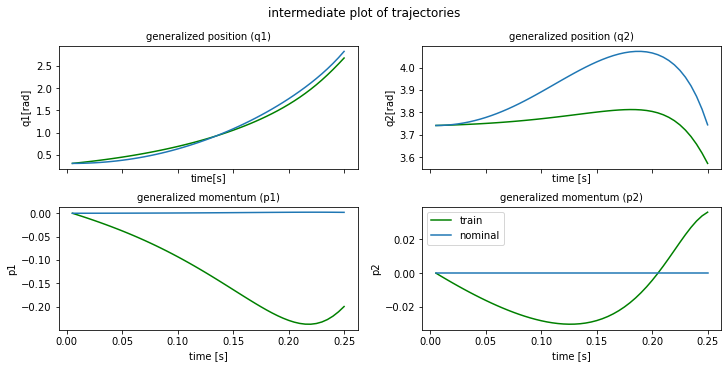

plot time : 1.1986267566680908
epoch  130 | train time 2.06 | train loss 5.045510e-02 | test loss 4.920780e-02 | test time 0.24  
epoch  131 | train time 0.88 | train loss 4.988687e-02 
epoch  132 | train time 0.78 | train loss 4.369922e-02 
epoch  133 | train time 0.82 | train loss 3.564152e-02 
epoch  134 | train time 0.78 | train loss 3.018975e-02 
epoch  135 | train time 0.84 | train loss 3.202452e-02 
epoch  136 | train time 0.87 | train loss 3.605145e-02 
epoch  137 | train time 0.78 | train loss 3.670665e-02 
epoch  138 | train time 0.79 | train loss 3.343467e-02 
epoch  139 | train time 0.88 | train loss 2.926769e-02 


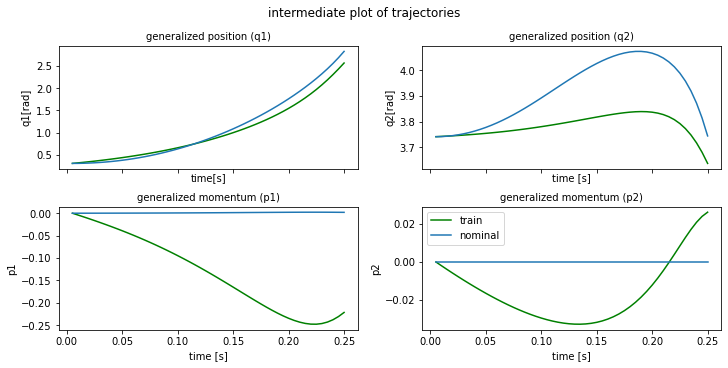

plot time : 1.1761183738708496
epoch  140 | train time 2.00 | train loss 2.901110e-02 | test loss 3.251517e-02 | test time 0.21  
epoch  141 | train time 0.77 | train loss 3.139998e-02 
epoch  142 | train time 0.77 | train loss 3.296913e-02 
epoch  143 | train time 0.78 | train loss 3.265698e-02 
epoch  144 | train time 0.78 | train loss 3.042926e-02 
epoch  145 | train time 0.91 | train loss 2.800322e-02 
epoch  146 | train time 0.78 | train loss 2.684098e-02 
epoch  147 | train time 0.78 | train loss 2.648868e-02 
epoch  148 | train time 0.77 | train loss 2.705453e-02 
epoch  149 | train time 0.79 | train loss 2.866968e-02 


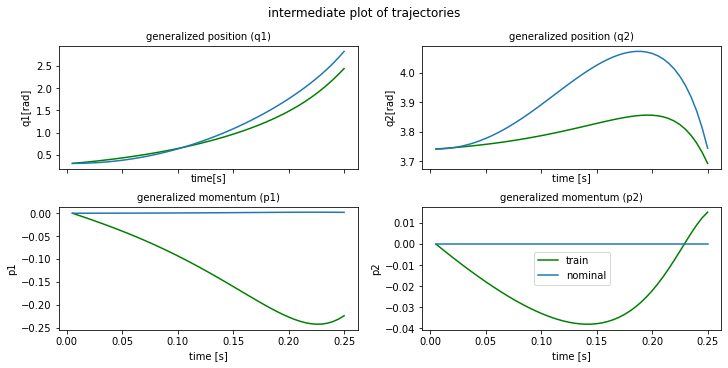

plot time : 1.2914903163909912
epoch  150 | train time 2.17 | train loss 3.149342e-02 | test loss 4.045827e-02 | test time 0.21  
epoch  151 | train time 0.78 | train loss 3.790282e-02 
epoch  152 | train time 0.78 | train loss 5.135893e-02 
epoch  153 | train time 0.78 | train loss 7.597890e-02 
epoch  154 | train time 0.77 | train loss 9.617741e-02 
epoch  155 | train time 0.86 | train loss 8.283736e-02 
epoch  156 | train time 0.85 | train loss 3.600616e-02 
epoch  157 | train time 0.78 | train loss 3.274849e-02 
epoch  158 | train time 0.79 | train loss 5.722843e-02 
epoch  159 | train time 0.79 | train loss 3.547834e-02 


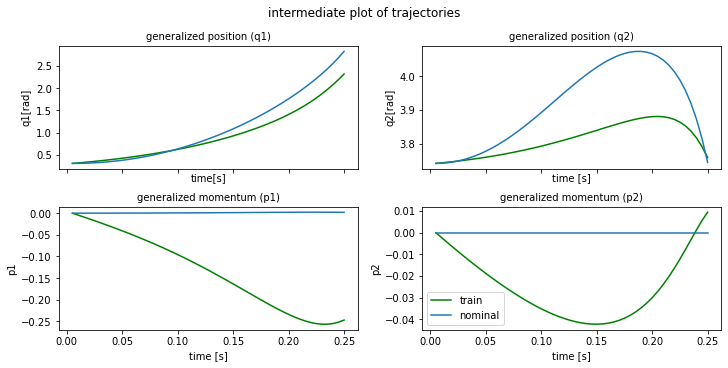

plot time : 1.2127413749694824
epoch  160 | train time 2.00 | train loss 3.296389e-02 | test loss 5.021528e-02 | test time 0.22  
epoch  161 | train time 0.79 | train loss 4.662838e-02 
epoch  162 | train time 0.79 | train loss 2.851815e-02 
epoch  163 | train time 0.78 | train loss 3.857780e-02 
epoch  164 | train time 0.80 | train loss 3.597036e-02 
epoch  165 | train time 0.80 | train loss 2.818182e-02 
epoch  166 | train time 0.77 | train loss 3.841609e-02 
epoch  167 | train time 0.78 | train loss 2.754329e-02 
epoch  168 | train time 0.78 | train loss 3.068769e-02 
epoch  169 | train time 0.87 | train loss 3.290940e-02 


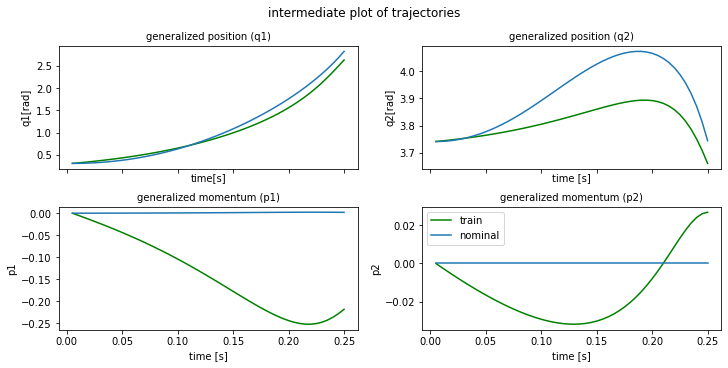

plot time : 1.1730067729949951
epoch  170 | train time 1.98 | train loss 2.491421e-02 | test loss 3.358764e-02 | test time 0.27  
epoch  171 | train time 0.93 | train loss 3.046552e-02 
epoch  172 | train time 0.91 | train loss 2.907791e-02 
epoch  173 | train time 0.77 | train loss 2.439689e-02 
epoch  174 | train time 0.78 | train loss 2.838993e-02 
epoch  175 | train time 0.86 | train loss 2.755248e-02 
epoch  176 | train time 0.84 | train loss 2.399516e-02 
epoch  177 | train time 0.80 | train loss 2.575566e-02 
epoch  178 | train time 0.78 | train loss 2.662114e-02 
epoch  179 | train time 0.78 | train loss 2.420847e-02 


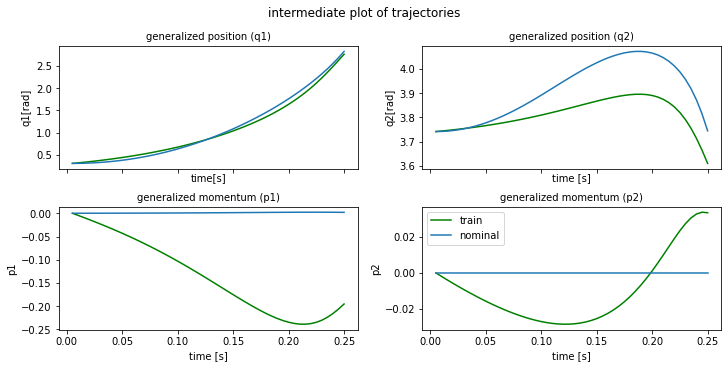

plot time : 1.2455077171325684
epoch  180 | train time 2.10 | train loss 2.344778e-02 | test loss 2.636544e-02 | test time 0.24  
epoch  181 | train time 0.78 | train loss 2.468735e-02 
epoch  182 | train time 0.80 | train loss 2.462328e-02 
epoch  183 | train time 0.86 | train loss 2.302845e-02 
epoch  184 | train time 0.88 | train loss 2.235252e-02 
epoch  185 | train time 0.85 | train loss 2.307925e-02 
epoch  186 | train time 0.78 | train loss 2.341662e-02 
epoch  187 | train time 0.81 | train loss 2.243982e-02 
epoch  188 | train time 0.78 | train loss 2.131180e-02 
epoch  189 | train time 0.78 | train loss 2.136517e-02 


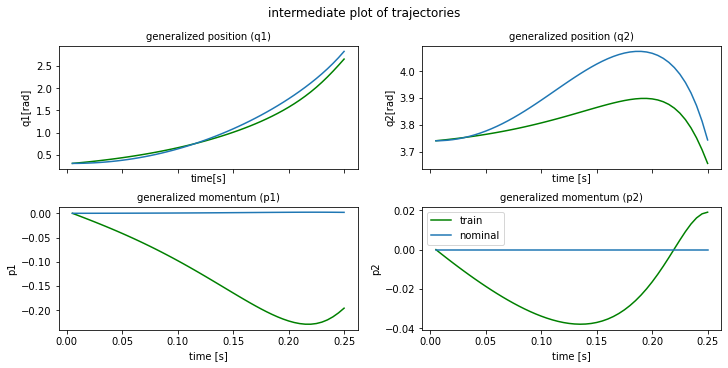

plot time : 1.2197625637054443
epoch  190 | train time 2.04 | train loss 2.215276e-02 | test loss 2.333602e-02 | test time 0.21  
epoch  191 | train time 0.78 | train loss 2.234293e-02 
epoch  192 | train time 0.78 | train loss 2.158348e-02 
epoch  193 | train time 0.80 | train loss 2.055925e-02 
epoch  194 | train time 0.79 | train loss 2.003753e-02 
epoch  195 | train time 0.78 | train loss 2.013831e-02 
epoch  196 | train time 0.84 | train loss 2.057318e-02 
epoch  197 | train time 0.85 | train loss 2.112484e-02 
epoch  198 | train time 0.79 | train loss 2.181877e-02 
epoch  199 | train time 0.85 | train loss 2.309936e-02 
horizon length : 100


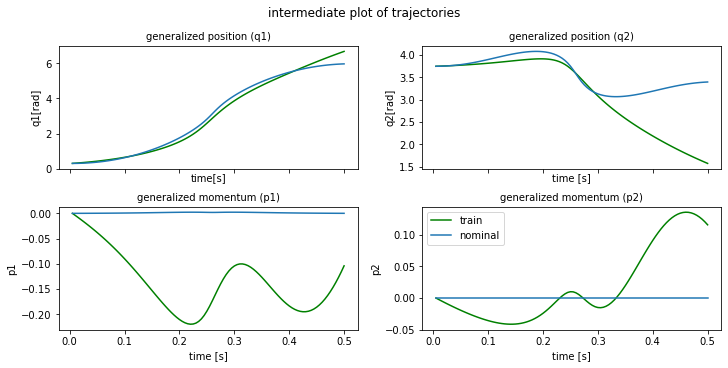

plot time : 1.2273011207580566
epoch  200 | train time 2.81 | train loss 1.455861e+00 | test loss 2.825734e+00 | test time 0.44  
epoch  201 | train time 1.69 | train loss 2.945197e+00 
epoch  202 | train time 1.55 | train loss 9.965341e-01 
epoch  203 | train time 1.66 | train loss 1.140910e+00 
epoch  204 | train time 1.67 | train loss 8.529758e-01 
epoch  205 | train time 1.56 | train loss 7.303797e-01 
epoch  206 | train time 1.63 | train loss 8.285931e-01 
epoch  207 | train time 1.59 | train loss 9.245532e-01 
epoch  208 | train time 1.59 | train loss 9.647596e-01 
epoch  209 | train time 1.82 | train loss 7.848105e-01 


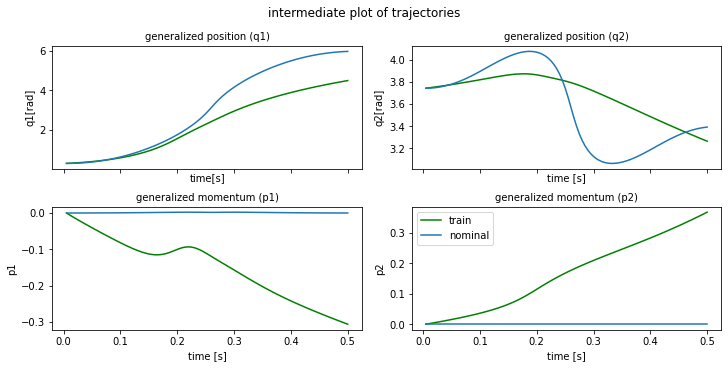

plot time : 1.2442853450775146
epoch  210 | train time 2.95 | train loss 6.039541e-01 | test loss 4.939929e-01 | test time 0.50  
epoch  211 | train time 1.68 | train loss 5.833719e-01 
epoch  212 | train time 1.53 | train loss 5.256095e-01 
epoch  213 | train time 1.60 | train loss 5.002680e-01 
epoch  214 | train time 1.52 | train loss 5.187781e-01 
epoch  215 | train time 1.71 | train loss 4.639812e-01 
epoch  216 | train time 1.66 | train loss 4.598826e-01 
epoch  217 | train time 1.65 | train loss 4.063616e-01 
epoch  218 | train time 1.69 | train loss 4.098643e-01 
epoch  219 | train time 1.55 | train loss 3.554697e-01 


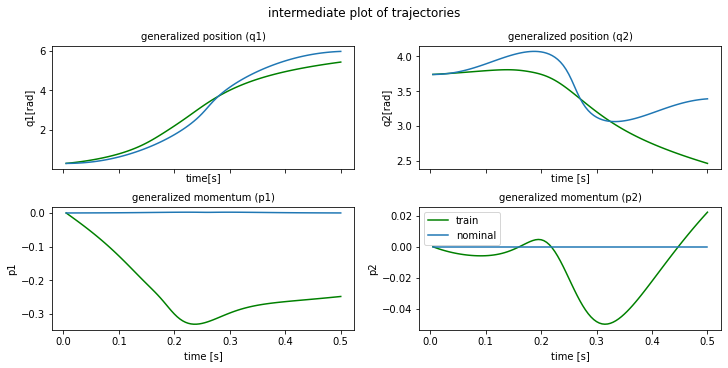

plot time : 1.2131798267364502
epoch  220 | train time 2.95 | train loss 3.711845e-01 | test loss 2.618271e-01 | test time 0.41  
epoch  221 | train time 1.54 | train loss 3.189944e-01 
epoch  222 | train time 1.62 | train loss 3.017276e-01 
epoch  223 | train time 1.58 | train loss 2.849500e-01 
epoch  224 | train time 1.90 | train loss 2.820582e-01 
epoch  225 | train time 1.56 | train loss 2.589057e-01 
epoch  226 | train time 1.55 | train loss 2.384084e-01 
epoch  227 | train time 1.60 | train loss 2.392364e-01 
epoch  228 | train time 1.59 | train loss 2.244731e-01 
epoch  229 | train time 1.68 | train loss 2.140249e-01 


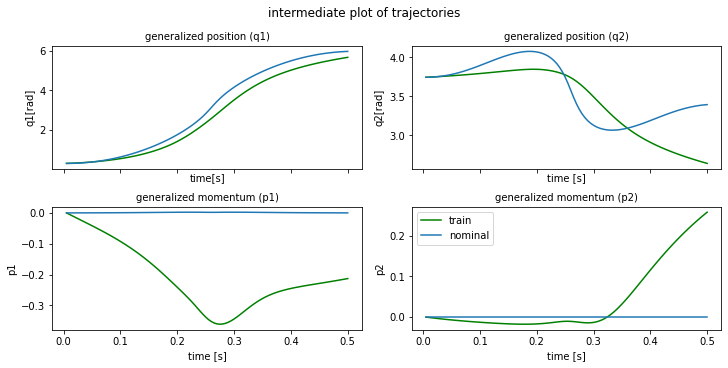

plot time : 1.2152347564697266
epoch  230 | train time 2.93 | train loss 1.991912e-01 | test loss 1.608231e-01 | test time 0.44  
epoch  231 | train time 1.59 | train loss 1.980552e-01 
epoch  232 | train time 1.55 | train loss 1.844557e-01 
epoch  233 | train time 1.55 | train loss 1.694855e-01 
epoch  234 | train time 1.64 | train loss 1.738137e-01 
epoch  235 | train time 1.65 | train loss 1.544008e-01 
epoch  236 | train time 1.56 | train loss 1.582386e-01 
epoch  237 | train time 1.52 | train loss 1.493514e-01 
epoch  238 | train time 1.55 | train loss 1.436134e-01 
epoch  239 | train time 1.69 | train loss 1.396858e-01 


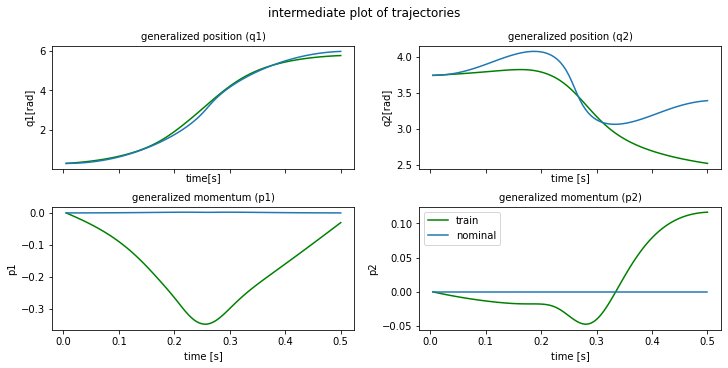

plot time : 1.1892364025115967
epoch  240 | train time 2.85 | train loss 1.338011e-01 | test loss 1.074027e-01 | test time 0.48  
epoch  241 | train time 1.53 | train loss 1.303457e-01 
epoch  242 | train time 1.56 | train loss 1.234825e-01 
epoch  243 | train time 1.52 | train loss 1.227543e-01 
epoch  244 | train time 1.62 | train loss 1.186520e-01 
epoch  245 | train time 1.58 | train loss 1.140064e-01 
epoch  246 | train time 2.02 | train loss 1.096427e-01 
epoch  247 | train time 2.11 | train loss 1.084156e-01 
epoch  248 | train time 1.63 | train loss 1.069618e-01 
epoch  249 | train time 1.53 | train loss 1.046706e-01 


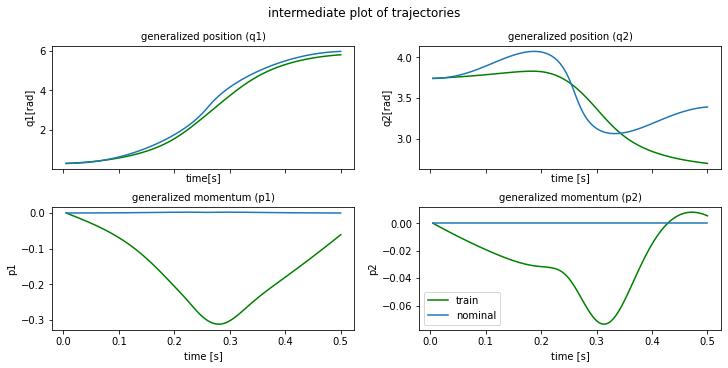

plot time : 1.1542870998382568
epoch  250 | train time 2.99 | train loss 1.050384e-01 | test loss 8.824868e-02 | test time 0.40  
epoch  251 | train time 1.55 | train loss 9.987763e-02 
epoch  252 | train time 1.64 | train loss 1.008519e-01 
epoch  253 | train time 1.66 | train loss 1.050325e-01 
epoch  254 | train time 1.84 | train loss 1.146976e-01 
epoch  255 | train time 1.55 | train loss 1.211782e-01 
epoch  256 | train time 1.55 | train loss 1.286738e-01 
epoch  257 | train time 1.69 | train loss 1.096935e-01 
epoch  258 | train time 1.54 | train loss 8.560800e-02 
epoch  259 | train time 1.58 | train loss 8.791334e-02 


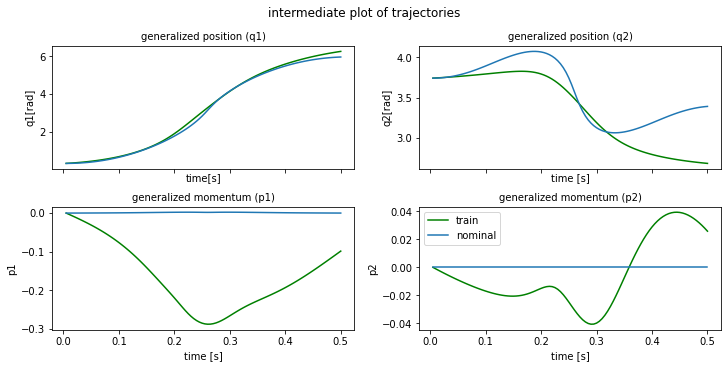

plot time : 1.1568443775177002
epoch  260 | train time 2.72 | train loss 1.002154e-01 | test loss 9.092291e-02 | test time 0.44  
epoch  261 | train time 1.53 | train loss 9.857778e-02 
epoch  262 | train time 1.52 | train loss 8.206380e-02 
epoch  263 | train time 1.54 | train loss 8.399919e-02 
epoch  264 | train time 1.61 | train loss 9.613094e-02 
epoch  265 | train time 1.56 | train loss 8.510288e-02 
epoch  266 | train time 1.67 | train loss 7.441293e-02 
epoch  267 | train time 1.58 | train loss 8.109112e-02 
epoch  268 | train time 1.70 | train loss 8.291189e-02 
epoch  269 | train time 1.75 | train loss 7.187046e-02 


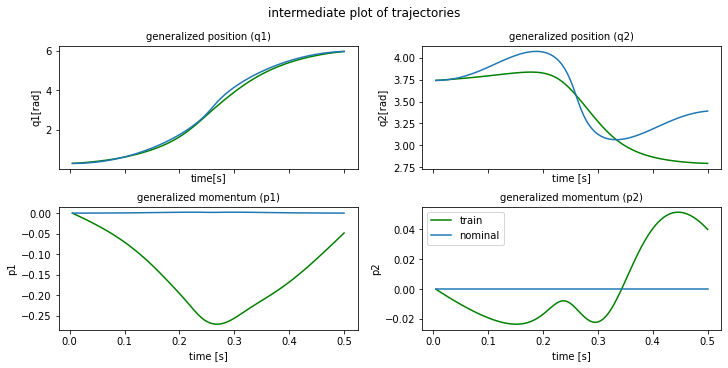

plot time : 1.2022719383239746
epoch  270 | train time 2.86 | train loss 7.206682e-02 | test loss 6.940848e-02 | test time 0.42  
epoch  271 | train time 1.68 | train loss 7.499415e-02 
epoch  272 | train time 1.64 | train loss 7.322568e-02 
epoch  273 | train time 1.53 | train loss 7.044657e-02 
epoch  274 | train time 1.73 | train loss 6.588059e-02 
epoch  275 | train time 1.73 | train loss 6.631695e-02 
epoch  276 | train time 1.54 | train loss 6.999595e-02 
epoch  277 | train time 1.54 | train loss 6.772102e-02 
epoch  278 | train time 1.55 | train loss 6.350870e-02 
epoch  279 | train time 1.53 | train loss 6.233588e-02 


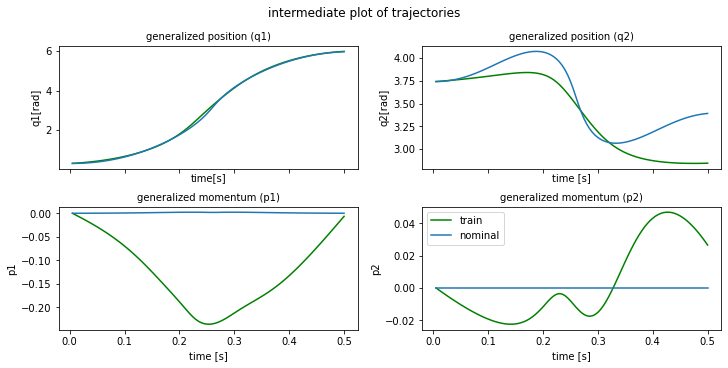

plot time : 1.1575307846069336
epoch  280 | train time 2.74 | train loss 6.083798e-02 | test loss 5.505096e-02 | test time 0.41  
epoch  281 | train time 1.54 | train loss 5.964677e-02 
epoch  282 | train time 1.69 | train loss 6.088335e-02 
epoch  283 | train time 1.56 | train loss 6.318818e-02 
epoch  284 | train time 1.63 | train loss 6.568842e-02 
epoch  285 | train time 1.65 | train loss 6.996667e-02 
epoch  286 | train time 1.61 | train loss 8.275533e-02 
epoch  287 | train time 1.59 | train loss 9.527300e-02 
epoch  288 | train time 1.58 | train loss 1.029284e-01 
epoch  289 | train time 1.59 | train loss 8.220211e-02 


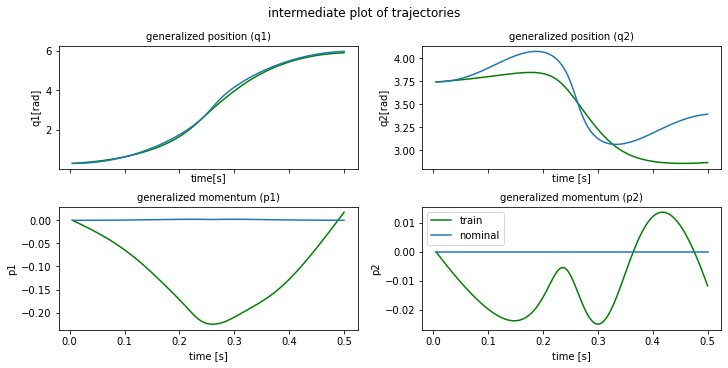

plot time : 1.205864429473877
epoch  290 | train time 2.92 | train loss 6.078374e-02 | test loss 5.479352e-02 | test time 0.40  
epoch  291 | train time 1.58 | train loss 5.667647e-02 
epoch  292 | train time 1.64 | train loss 6.976635e-02 
epoch  293 | train time 1.57 | train loss 7.198016e-02 
epoch  294 | train time 1.72 | train loss 5.498436e-02 
epoch  295 | train time 1.60 | train loss 5.774364e-02 
epoch  296 | train time 1.68 | train loss 6.801952e-02 
epoch  297 | train time 1.54 | train loss 5.635092e-02 
epoch  298 | train time 1.61 | train loss 5.160869e-02 
epoch  299 | train time 1.61 | train loss 5.976417e-02 
horizon length : 150


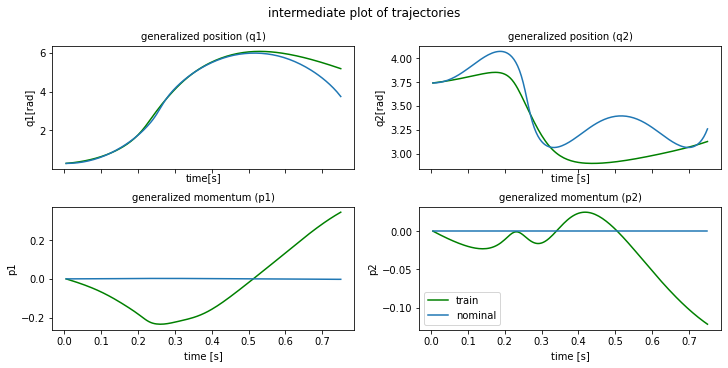

plot time : 1.293428659439087
epoch  300 | train time 3.87 | train loss 5.896497e-01 | test loss 1.568553e+00 | test time 0.60  
epoch  301 | train time 2.42 | train loss 1.561072e+00 
epoch  302 | train time 2.30 | train loss 2.871711e+00 
epoch  303 | train time 2.39 | train loss 1.899497e+00 
epoch  304 | train time 2.33 | train loss 2.370161e+00 
epoch  305 | train time 2.31 | train loss 6.223814e+00 
epoch  306 | train time 2.31 | train loss 2.832561e+00 
epoch  307 | train time 2.47 | train loss 1.725209e+00 
epoch  308 | train time 2.45 | train loss 1.430816e+00 
epoch  309 | train time 2.47 | train loss 1.970300e+00 


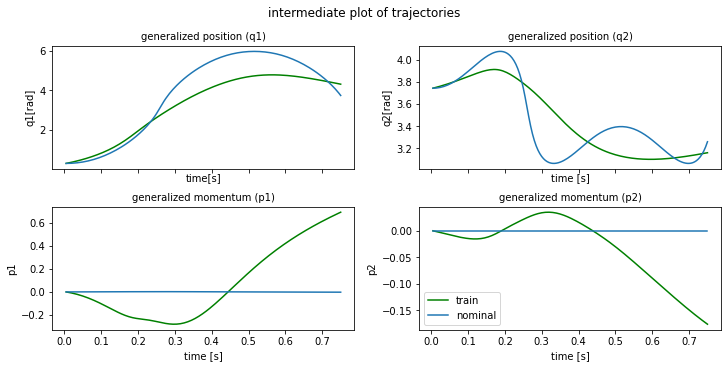

plot time : 1.2039358615875244
epoch  310 | train time 3.71 | train loss 1.494773e+00 | test loss 1.619446e+00 | test time 0.62  
epoch  311 | train time 2.35 | train loss 1.486921e+00 
epoch  312 | train time 2.49 | train loss 1.568011e+00 
epoch  313 | train time 2.41 | train loss 1.698574e+00 
epoch  314 | train time 2.31 | train loss 1.385194e+00 
epoch  315 | train time 2.42 | train loss 1.175511e+00 
epoch  316 | train time 2.46 | train loss 1.766822e+00 
epoch  317 | train time 2.50 | train loss 3.171960e+00 
epoch  318 | train time 2.32 | train loss 3.161345e+00 
epoch  319 | train time 2.47 | train loss 2.980158e+00 


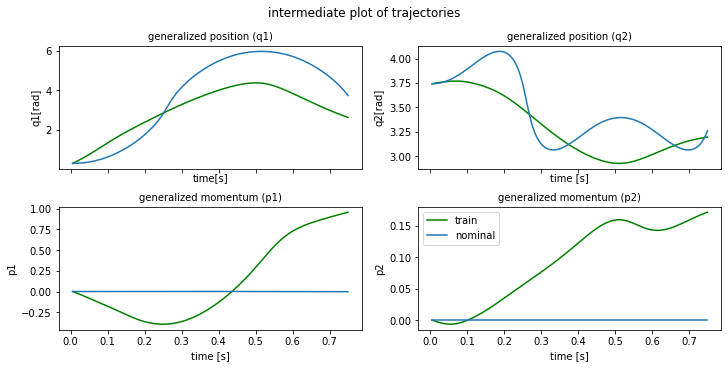

plot time : 1.2873682975769043
epoch  320 | train time 3.86 | train loss 2.111096e+00 | test loss 1.266630e+00 | test time 0.61  
epoch  321 | train time 2.50 | train loss 1.320873e+00 
epoch  322 | train time 2.32 | train loss 1.568586e+00 
epoch  323 | train time 2.43 | train loss 1.581696e+00 
epoch  324 | train time 2.38 | train loss 1.574317e+00 
epoch  325 | train time 2.32 | train loss 1.027589e+00 
epoch  326 | train time 2.47 | train loss 1.105017e+00 
epoch  327 | train time 2.51 | train loss 1.130279e+00 
epoch  328 | train time 2.38 | train loss 1.057211e+00 
epoch  329 | train time 2.59 | train loss 9.990539e-01 


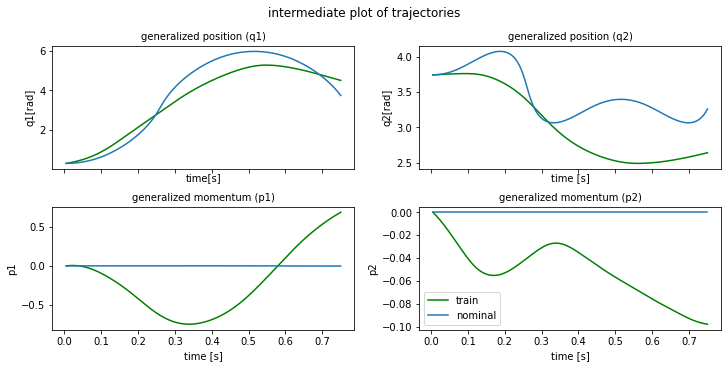

plot time : 1.1801776885986328
epoch  330 | train time 3.52 | train loss 1.028639e+00 | test loss 1.069089e+00 | test time 0.63  
epoch  331 | train time 2.45 | train loss 9.450436e-01 
epoch  332 | train time 2.43 | train loss 7.198845e-01 
epoch  333 | train time 2.38 | train loss 6.693008e-01 
epoch  334 | train time 2.43 | train loss 7.441171e-01 
epoch  335 | train time 2.39 | train loss 7.302140e-01 
epoch  336 | train time 2.55 | train loss 7.464859e-01 
epoch  337 | train time 2.31 | train loss 6.332344e-01 
epoch  338 | train time 2.40 | train loss 6.263435e-01 
epoch  339 | train time 2.30 | train loss 5.578293e-01 


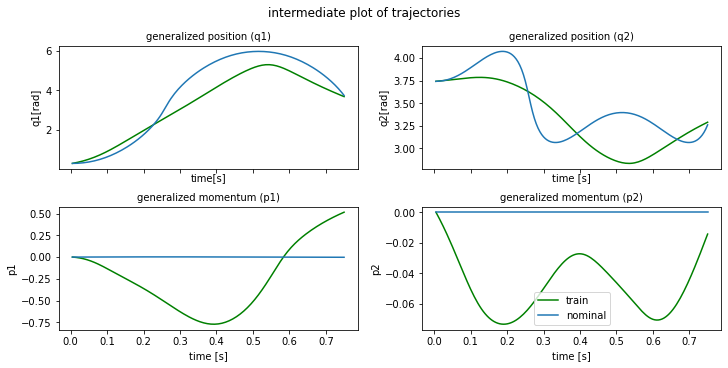

plot time : 1.2714402675628662
epoch  340 | train time 3.62 | train loss 5.479268e-01 | test loss 4.927384e-01 | test time 0.68  
epoch  341 | train time 2.41 | train loss 4.978963e-01 
epoch  342 | train time 2.30 | train loss 4.847614e-01 
epoch  343 | train time 2.29 | train loss 5.095007e-01 
epoch  344 | train time 2.33 | train loss 5.002068e-01 
epoch  345 | train time 2.51 | train loss 4.910249e-01 
epoch  346 | train time 2.69 | train loss 4.391498e-01 
epoch  347 | train time 2.33 | train loss 4.313840e-01 
epoch  348 | train time 2.35 | train loss 4.053771e-01 
epoch  349 | train time 3.24 | train loss 3.790498e-01 


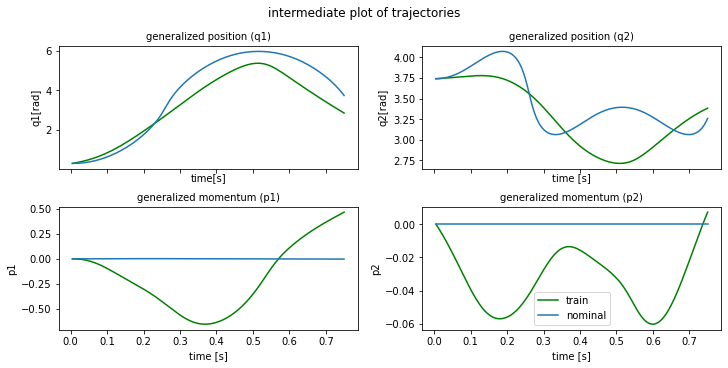

plot time : 1.2031080722808838
epoch  350 | train time 3.70 | train loss 3.702992e-01 | test loss 3.422960e-01 | test time 0.61  
epoch  351 | train time 2.38 | train loss 3.728431e-01 
epoch  352 | train time 2.33 | train loss 3.628284e-01 
epoch  353 | train time 2.65 | train loss 3.435378e-01 
epoch  354 | train time 2.36 | train loss 3.292935e-01 
epoch  355 | train time 2.52 | train loss 3.128610e-01 
epoch  356 | train time 2.56 | train loss 2.994330e-01 
epoch  357 | train time 2.31 | train loss 2.973488e-01 
epoch  358 | train time 2.42 | train loss 2.959976e-01 
epoch  359 | train time 2.39 | train loss 2.824259e-01 


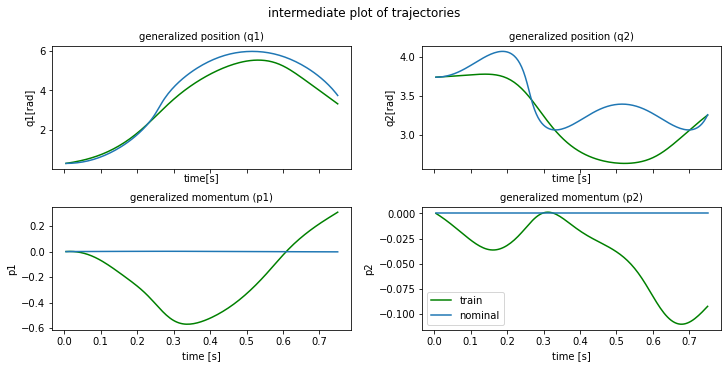

plot time : 1.1842401027679443
epoch  360 | train time 3.60 | train loss 2.765747e-01 | test loss 2.604430e-01 | test time 0.59  
epoch  361 | train time 2.31 | train loss 2.619378e-01 
epoch  362 | train time 2.58 | train loss 2.546413e-01 
epoch  363 | train time 2.33 | train loss 2.521138e-01 
epoch  364 | train time 2.32 | train loss 2.454479e-01 
epoch  365 | train time 2.42 | train loss 2.420207e-01 
epoch  366 | train time 2.50 | train loss 2.297376e-01 
epoch  367 | train time 2.30 | train loss 2.226429e-01 
epoch  368 | train time 2.33 | train loss 2.152001e-01 
epoch  369 | train time 2.37 | train loss 2.123226e-01 


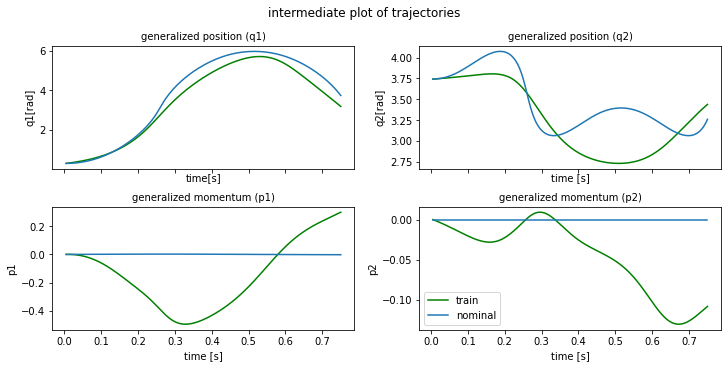

plot time : 1.251690149307251
epoch  370 | train time 3.61 | train loss 2.084265e-01 | test loss 1.995717e-01 | test time 0.61  
epoch  371 | train time 2.33 | train loss 2.032760e-01 
epoch  372 | train time 2.29 | train loss 1.952487e-01 
epoch  373 | train time 2.40 | train loss 1.891513e-01 
epoch  374 | train time 2.49 | train loss 1.852492e-01 
epoch  375 | train time 2.38 | train loss 1.820067e-01 
epoch  376 | train time 2.45 | train loss 1.789910e-01 
epoch  377 | train time 2.56 | train loss 1.752158e-01 
epoch  378 | train time 2.30 | train loss 1.696598e-01 
epoch  379 | train time 2.31 | train loss 1.672700e-01 


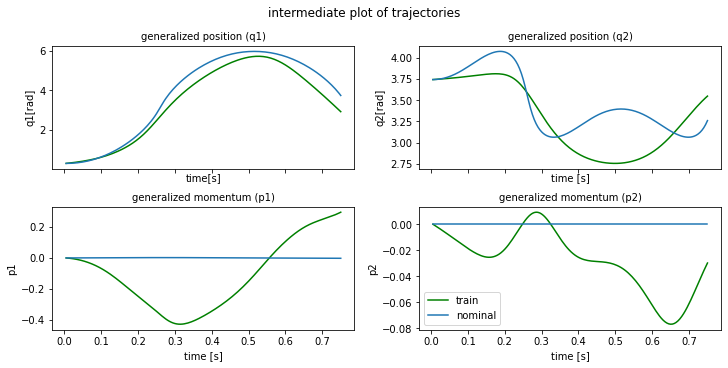

plot time : 1.2481651306152344
epoch  380 | train time 3.83 | train loss 1.638288e-01 | test loss 1.555875e-01 | test time 0.79  
epoch  381 | train time 2.37 | train loss 1.620359e-01 
epoch  382 | train time 2.51 | train loss 1.586737e-01 
epoch  383 | train time 2.39 | train loss 1.544106e-01 
epoch  384 | train time 2.39 | train loss 1.507328e-01 
epoch  385 | train time 2.31 | train loss 1.478260e-01 
epoch  386 | train time 2.43 | train loss 1.448635e-01 
epoch  387 | train time 2.29 | train loss 1.426187e-01 
epoch  388 | train time 2.41 | train loss 1.391807e-01 
epoch  389 | train time 2.50 | train loss 1.352888e-01 


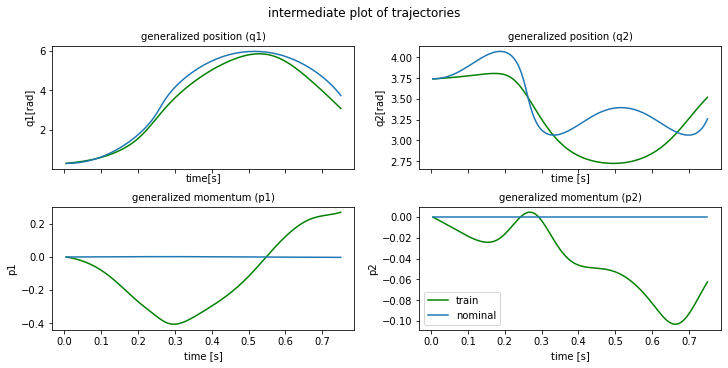

plot time : 1.2671256065368652
epoch  390 | train time 3.66 | train loss 1.317421e-01 | test loss 1.304261e-01 | test time 0.60  
epoch  391 | train time 2.45 | train loss 1.295980e-01 
epoch  392 | train time 2.47 | train loss 1.269514e-01 
epoch  393 | train time 2.45 | train loss 1.243171e-01 
epoch  394 | train time 2.42 | train loss 1.218990e-01 
epoch  395 | train time 2.43 | train loss 1.199613e-01 
epoch  396 | train time 2.40 | train loss 1.180782e-01 
epoch  397 | train time 2.45 | train loss 1.162936e-01 
epoch  398 | train time 2.34 | train loss 1.147481e-01 
epoch  399 | train time 2.45 | train loss 1.131563e-01 
horizon length : 200


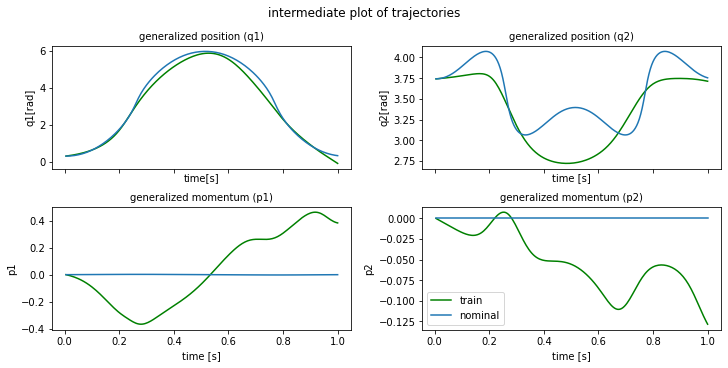

plot time : 1.2569117546081543
epoch  400 | train time 4.52 | train loss 7.956966e-01 | test loss 7.235900e-01 | test time 0.79  
epoch  401 | train time 3.26 | train loss 6.503633e-01 
epoch  402 | train time 3.14 | train loss 4.526781e-01 
epoch  403 | train time 3.09 | train loss 5.376142e-01 
epoch  404 | train time 3.23 | train loss 5.935195e-01 
epoch  405 | train time 3.19 | train loss 5.188145e-01 
epoch  406 | train time 3.12 | train loss 5.424563e-01 
epoch  407 | train time 3.09 | train loss 3.967519e-01 
epoch  408 | train time 3.26 | train loss 3.674690e-01 
epoch  409 | train time 3.23 | train loss 3.647859e-01 


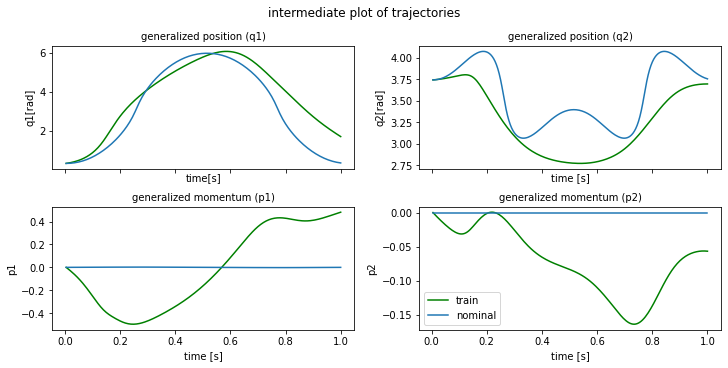

plot time : 1.2666208744049072
epoch  410 | train time 4.56 | train loss 3.462113e-01 | test loss 2.350971e-01 | test time 0.88  
epoch  411 | train time 3.19 | train loss 2.032439e-01 
epoch  412 | train time 3.13 | train loss 2.700344e-01 
epoch  413 | train time 3.09 | train loss 2.367872e-01 
epoch  414 | train time 3.11 | train loss 2.768614e-01 
epoch  415 | train time 3.30 | train loss 2.100791e-01 
epoch  416 | train time 3.27 | train loss 2.216703e-01 
epoch  417 | train time 3.19 | train loss 1.947427e-01 
epoch  418 | train time 3.10 | train loss 2.174919e-01 
epoch  419 | train time 3.08 | train loss 1.924180e-01 


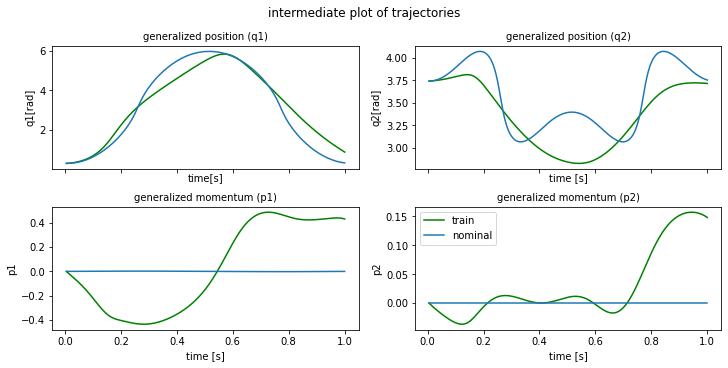

plot time : 1.2094736099243164
epoch  420 | train time 4.42 | train loss 1.839262e-01 | test loss 1.872420e-01 | test time 0.81  
epoch  421 | train time 3.07 | train loss 1.658740e-01 
epoch  422 | train time 3.11 | train loss 1.657779e-01 
epoch  423 | train time 3.15 | train loss 1.638522e-01 
epoch  424 | train time 3.06 | train loss 1.549437e-01 
epoch  425 | train time 3.20 | train loss 1.550653e-01 
epoch  426 | train time 3.53 | train loss 1.358005e-01 
epoch  427 | train time 4.25 | train loss 1.495998e-01 
epoch  428 | train time 3.07 | train loss 1.262848e-01 
epoch  429 | train time 3.37 | train loss 1.372682e-01 


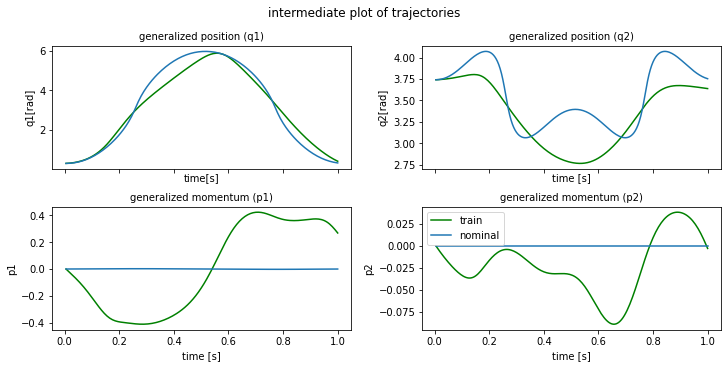

plot time : 1.2271363735198975
epoch  430 | train time 4.48 | train loss 1.219974e-01 | test loss 1.389890e-01 | test time 0.81  
epoch  431 | train time 3.39 | train loss 1.231920e-01 
epoch  432 | train time 3.22 | train loss 1.206510e-01 
epoch  433 | train time 3.13 | train loss 1.109573e-01 
epoch  434 | train time 3.32 | train loss 1.156532e-01 
epoch  435 | train time 3.41 | train loss 1.088937e-01 
epoch  436 | train time 3.19 | train loss 1.059725e-01 
epoch  437 | train time 3.28 | train loss 1.040543e-01 
epoch  438 | train time 3.29 | train loss 9.942928e-02 
epoch  439 | train time 3.25 | train loss 9.719067e-02 


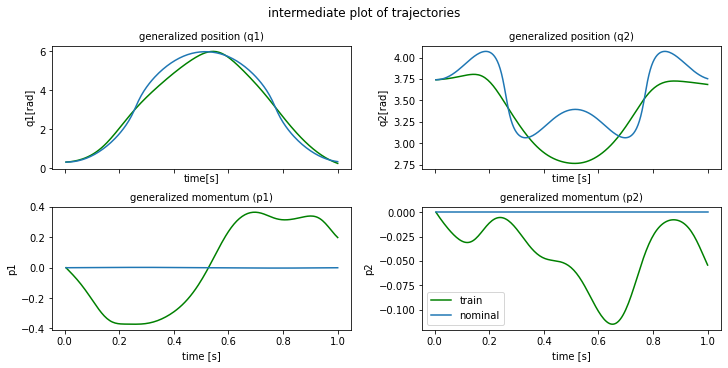

plot time : 1.1765546798706055
epoch  440 | train time 4.35 | train loss 9.999304e-02 | test loss 1.041754e-01 | test time 0.78  
epoch  441 | train time 3.10 | train loss 9.234034e-02 
epoch  442 | train time 3.14 | train loss 9.241550e-02 
epoch  443 | train time 3.34 | train loss 9.226457e-02 
epoch  444 | train time 3.23 | train loss 8.747123e-02 
epoch  445 | train time 3.32 | train loss 8.941693e-02 
epoch  446 | train time 3.19 | train loss 8.622627e-02 
epoch  447 | train time 3.24 | train loss 8.281156e-02 
epoch  448 | train time 3.24 | train loss 8.369439e-02 
epoch  449 | train time 3.16 | train loss 8.260760e-02 


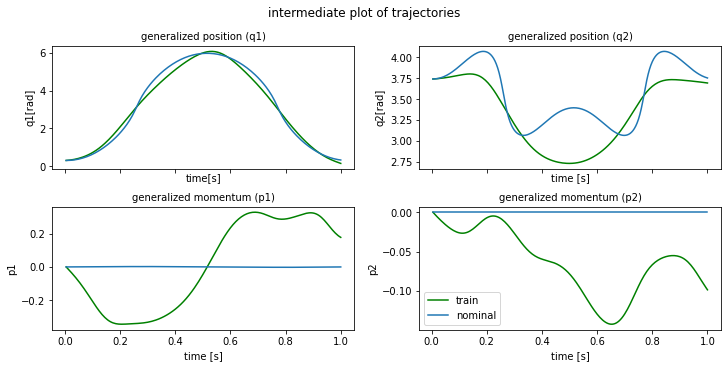

plot time : 1.207446575164795
epoch  450 | train time 4.51 | train loss 8.039822e-02 | test loss 9.072878e-02 | test time 0.79  
epoch  451 | train time 3.09 | train loss 7.894935e-02 
epoch  452 | train time 3.20 | train loss 7.923008e-02 
epoch  453 | train time 3.26 | train loss 7.815519e-02 
epoch  454 | train time 3.21 | train loss 7.598813e-02 
epoch  455 | train time 3.55 | train loss 7.605285e-02 
epoch  456 | train time 3.24 | train loss 7.526020e-02 
epoch  457 | train time 3.54 | train loss 7.338440e-02 
epoch  458 | train time 3.28 | train loss 7.321614e-02 
epoch  459 | train time 3.20 | train loss 7.280859e-02 


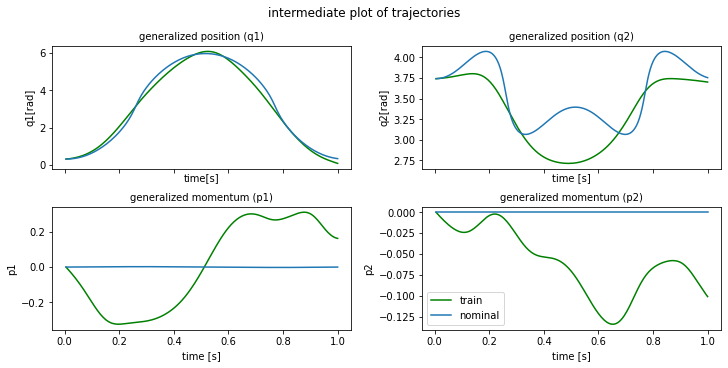

plot time : 1.1740796566009521
epoch  460 | train time 4.47 | train loss 7.149608e-02 | test loss 8.080757e-02 | test time 0.93  
epoch  461 | train time 3.26 | train loss 7.068819e-02 
epoch  462 | train time 3.10 | train loss 7.001658e-02 
epoch  463 | train time 3.33 | train loss 6.939613e-02 
epoch  464 | train time 3.15 | train loss 6.887934e-02 
epoch  465 | train time 3.25 | train loss 6.789441e-02 
epoch  466 | train time 3.23 | train loss 6.698138e-02 
epoch  467 | train time 3.06 | train loss 6.667753e-02 
epoch  468 | train time 3.16 | train loss 6.623819e-02 
epoch  469 | train time 3.10 | train loss 6.540227e-02 


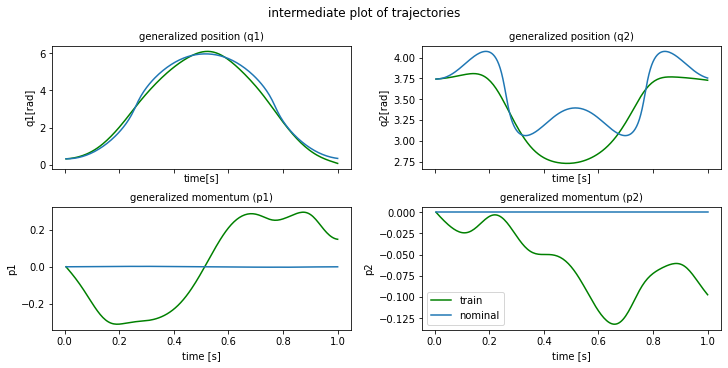

plot time : 1.1933727264404297
epoch  470 | train time 4.43 | train loss 6.471702e-02 | test loss 7.351170e-02 | test time 1.02  
epoch  471 | train time 3.33 | train loss 6.419058e-02 
epoch  472 | train time 3.40 | train loss 6.364390e-02 
epoch  473 | train time 3.22 | train loss 6.322046e-02 
epoch  474 | train time 3.10 | train loss 6.282450e-02 
epoch  475 | train time 3.46 | train loss 6.217897e-02 
epoch  476 | train time 3.14 | train loss 6.144532e-02 
epoch  477 | train time 3.30 | train loss 6.096425e-02 
epoch  478 | train time 3.37 | train loss 6.066905e-02 
epoch  479 | train time 3.08 | train loss 6.028614e-02 


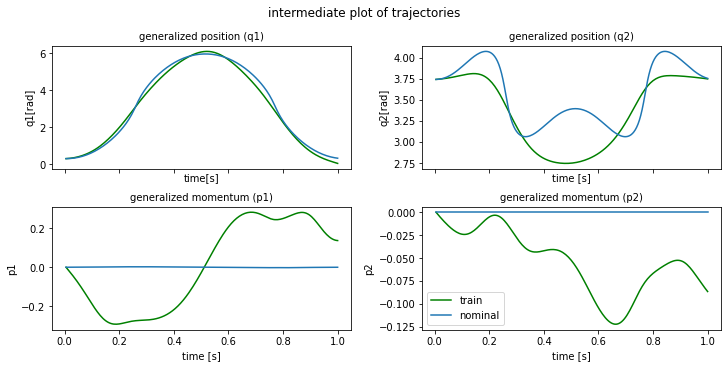

plot time : 1.1678001880645752
epoch  480 | train time 4.27 | train loss 5.981501e-02 | test loss 6.789285e-02 | test time 0.97  
epoch  481 | train time 3.28 | train loss 5.940727e-02 
epoch  482 | train time 3.33 | train loss 5.902183e-02 
epoch  483 | train time 3.50 | train loss 5.854249e-02 
epoch  484 | train time 3.24 | train loss 5.802637e-02 
epoch  485 | train time 3.07 | train loss 5.758734e-02 
epoch  486 | train time 3.08 | train loss 5.721390e-02 
epoch  487 | train time 3.31 | train loss 5.683136e-02 
epoch  488 | train time 3.33 | train loss 5.644280e-02 
epoch  489 | train time 3.37 | train loss 5.612390e-02 


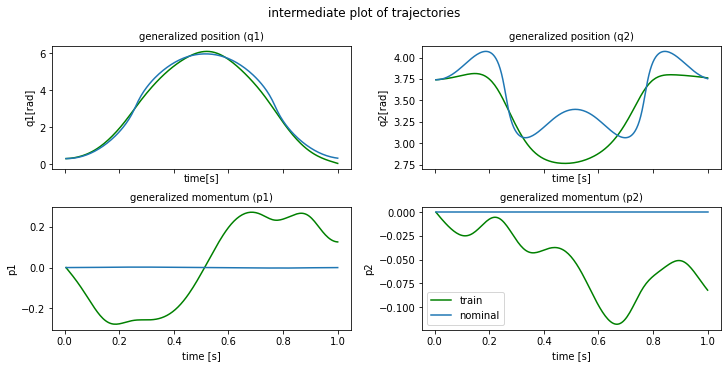

plot time : 1.7169804573059082
epoch  490 | train time 5.68 | train loss 5.593293e-02 | test loss 6.376234e-02 | test time 0.83  
epoch  491 | train time 3.45 | train loss 5.595919e-02 
epoch  492 | train time 3.09 | train loss 5.651398e-02 
epoch  493 | train time 3.09 | train loss 5.832626e-02 
epoch  494 | train time 3.17 | train loss 6.365043e-02 
epoch  495 | train time 3.38 | train loss 7.670962e-02 
epoch  496 | train time 3.28 | train loss 1.094403e-01 
epoch  497 | train time 3.18 | train loss 1.533711e-01 
epoch  498 | train time 3.07 | train loss 1.866416e-01 
epoch  499 | train time 3.12 | train loss 1.054409e-01 
horizon length : 250


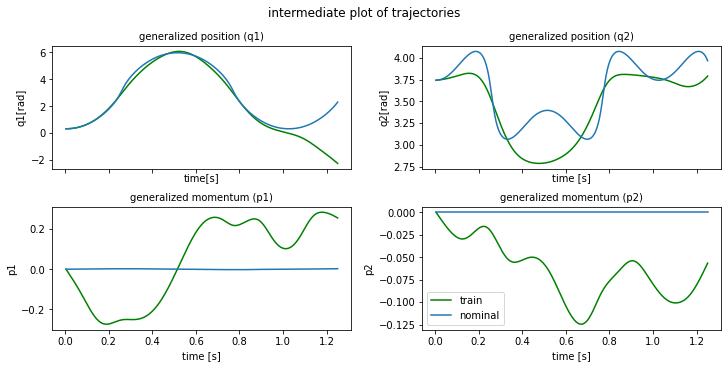

plot time : 1.244629144668579
epoch  500 | train time 5.17 | train loss 1.438238e-01 | test loss 5.176719e-01 | test time 1.00  
epoch  501 | train time 3.92 | train loss 5.653525e-01 
epoch  502 | train time 3.88 | train loss 1.369009e+00 
epoch  503 | train time 4.09 | train loss 1.290269e+00 
epoch  504 | train time 3.89 | train loss 1.129308e+00 
epoch  505 | train time 3.98 | train loss 5.650092e-01 
epoch  506 | train time 4.18 | train loss 7.869304e-01 
epoch  507 | train time 3.90 | train loss 3.553677e-01 
epoch  508 | train time 3.93 | train loss 6.380454e-01 
epoch  509 | train time 4.09 | train loss 4.153175e-01 


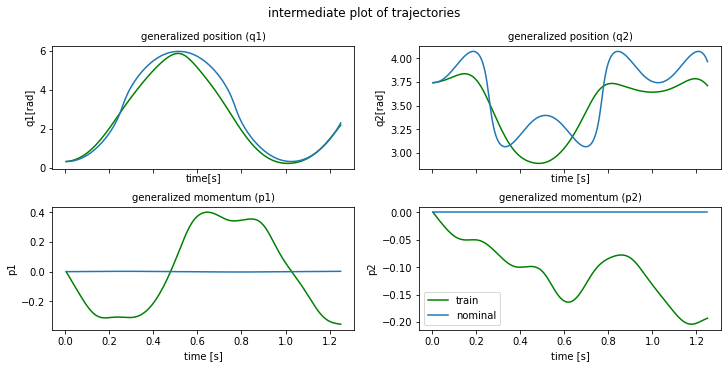

plot time : 1.203272819519043
epoch  510 | train time 5.17 | train loss 4.133803e-01 | test loss 6.314448e-01 | test time 1.01  
epoch  511 | train time 3.98 | train loss 4.590961e-01 
epoch  512 | train time 4.08 | train loss 2.429938e-01 
epoch  513 | train time 3.96 | train loss 4.571722e-01 
epoch  514 | train time 3.91 | train loss 1.739711e-01 
epoch  515 | train time 4.06 | train loss 3.783893e-01 
epoch  516 | train time 4.00 | train loss 2.250681e-01 
epoch  517 | train time 3.81 | train loss 2.669712e-01 
epoch  518 | train time 3.88 | train loss 2.732504e-01 
epoch  519 | train time 4.06 | train loss 1.611704e-01 


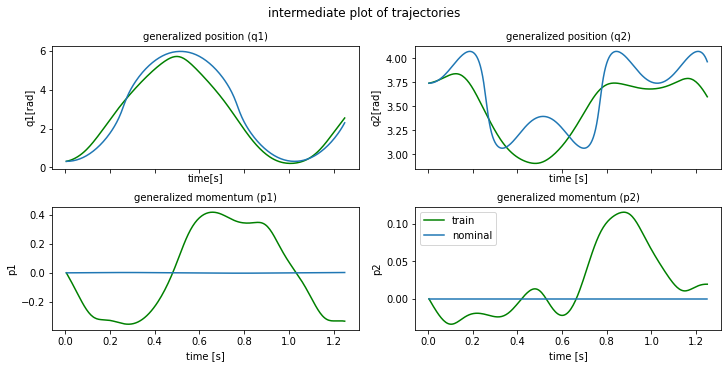

plot time : 1.2087798118591309
epoch  520 | train time 5.48 | train loss 2.602307e-01 | test loss 1.543961e-01 | test time 1.02  
epoch  521 | train time 3.89 | train loss 1.428630e-01 
epoch  522 | train time 3.92 | train loss 2.174841e-01 
epoch  523 | train time 3.94 | train loss 1.498292e-01 
epoch  524 | train time 4.00 | train loss 1.612615e-01 
epoch  525 | train time 4.11 | train loss 1.666487e-01 
epoch  526 | train time 3.82 | train loss 1.220287e-01 
epoch  527 | train time 3.95 | train loss 1.656277e-01 
epoch  528 | train time 4.05 | train loss 1.089792e-01 
epoch  529 | train time 3.89 | train loss 1.568663e-01 


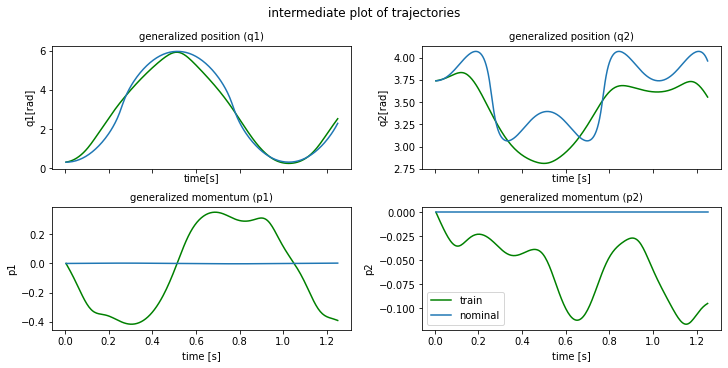

plot time : 1.2418246269226074
epoch  530 | train time 5.45 | train loss 1.096579e-01 | test loss 1.478979e-01 | test time 1.18  
epoch  531 | train time 4.07 | train loss 1.359082e-01 
epoch  532 | train time 4.03 | train loss 1.093628e-01 
epoch  533 | train time 3.86 | train loss 1.148104e-01 
epoch  534 | train time 3.87 | train loss 1.082121e-01 
epoch  535 | train time 4.06 | train loss 9.837769e-02 
epoch  536 | train time 3.81 | train loss 1.032879e-01 
epoch  537 | train time 3.94 | train loss 8.772317e-02 
epoch  538 | train time 3.91 | train loss 1.001050e-01 
epoch  539 | train time 4.03 | train loss 8.191920e-02 


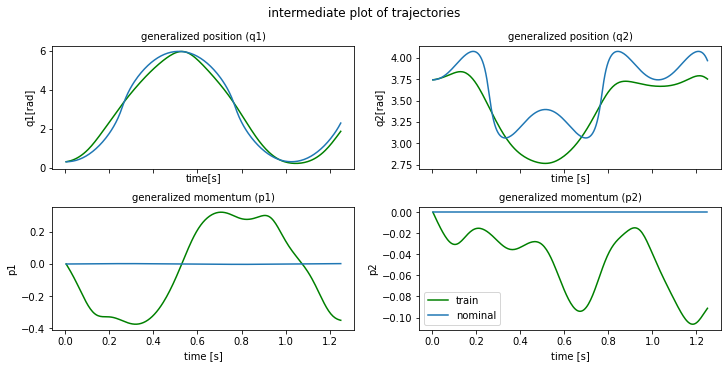

plot time : 1.191781759262085
epoch  540 | train time 5.09 | train loss 9.386526e-02 | test loss 8.628754e-02 | test time 1.02  
epoch  541 | train time 4.00 | train loss 7.632564e-02 
epoch  542 | train time 4.02 | train loss 8.910010e-02 
epoch  543 | train time 4.07 | train loss 7.445104e-02 
epoch  544 | train time 4.84 | train loss 8.471124e-02 
epoch  545 | train time 3.91 | train loss 7.186618e-02 
epoch  546 | train time 4.07 | train loss 8.050367e-02 
epoch  547 | train time 3.83 | train loss 6.969088e-02 
epoch  548 | train time 3.95 | train loss 7.616875e-02 
epoch  549 | train time 4.10 | train loss 6.685375e-02 


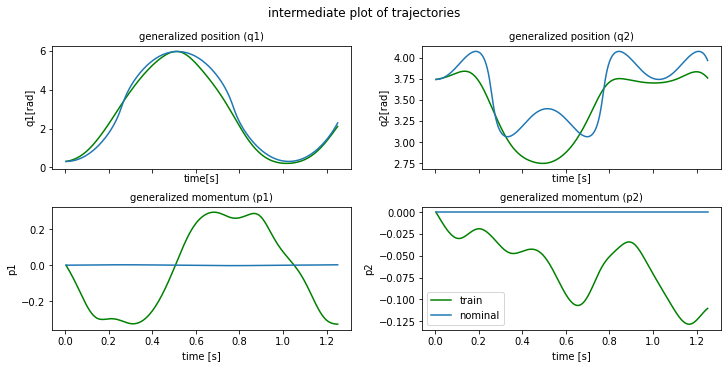

plot time : 1.2586700916290283
epoch  550 | train time 5.30 | train loss 7.262710e-02 | test loss 7.705746e-02 | test time 1.18  
epoch  551 | train time 4.09 | train loss 6.554966e-02 
epoch  552 | train time 4.00 | train loss 7.006807e-02 
epoch  553 | train time 3.95 | train loss 6.397049e-02 
epoch  554 | train time 4.04 | train loss 6.725422e-02 
epoch  555 | train time 4.04 | train loss 6.270293e-02 
epoch  556 | train time 4.09 | train loss 6.509762e-02 
epoch  557 | train time 4.09 | train loss 6.146014e-02 
epoch  558 | train time 4.28 | train loss 6.276659e-02 
epoch  559 | train time 4.30 | train loss 6.069209e-02 


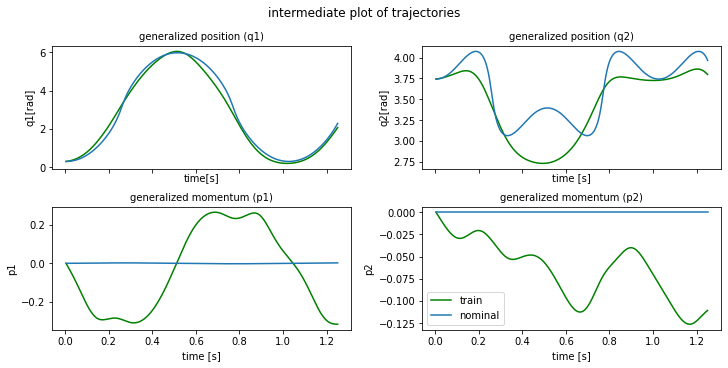

plot time : 1.1721653938293457
epoch  560 | train time 5.22 | train loss 6.054073e-02 | test loss 6.842372e-02 | test time 1.08  
epoch  561 | train time 4.28 | train loss 6.011498e-02 
epoch  562 | train time 4.11 | train loss 5.840097e-02 
epoch  563 | train time 4.14 | train loss 5.947141e-02 
epoch  564 | train time 3.85 | train loss 5.709535e-02 
epoch  565 | train time 4.07 | train loss 5.809002e-02 
epoch  566 | train time 3.93 | train loss 5.616511e-02 
epoch  567 | train time 3.83 | train loss 5.634096e-02 
epoch  568 | train time 3.97 | train loss 5.570428e-02 
epoch  569 | train time 3.93 | train loss 5.480585e-02 


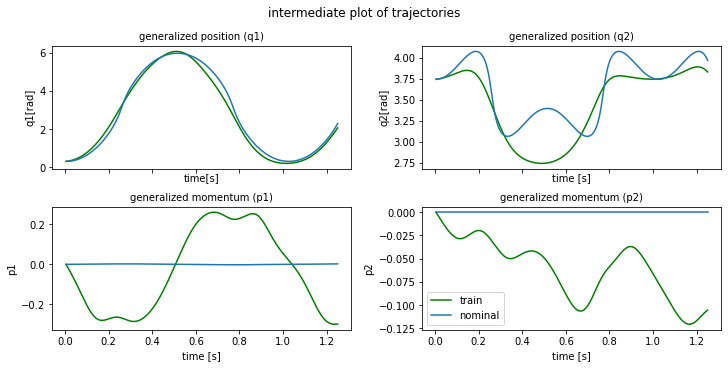

plot time : 1.208547592163086
epoch  570 | train time 5.26 | train loss 5.501458e-02 | test loss 6.156049e-02 | test time 1.00  
epoch  571 | train time 4.15 | train loss 5.369667e-02 
epoch  572 | train time 4.14 | train loss 5.403518e-02 
epoch  573 | train time 4.10 | train loss 5.304540e-02 
epoch  574 | train time 4.20 | train loss 5.278789e-02 
epoch  575 | train time 3.83 | train loss 5.264970e-02 
epoch  576 | train time 4.04 | train loss 5.177942e-02 
epoch  577 | train time 4.32 | train loss 5.187928e-02 
epoch  578 | train time 4.07 | train loss 5.112201e-02 
epoch  579 | train time 3.84 | train loss 5.084940e-02 


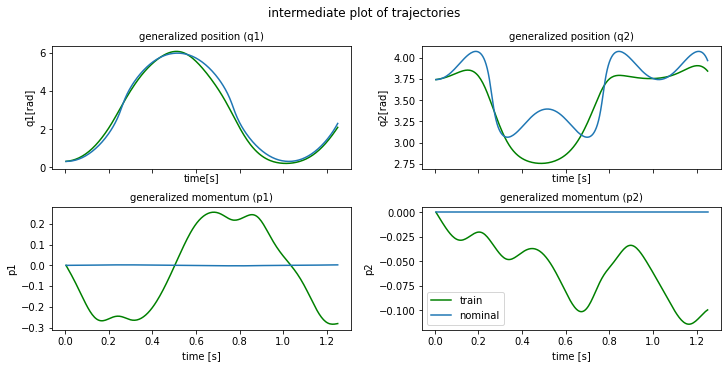

plot time : 1.2737460136413574
epoch  580 | train time 5.19 | train loss 5.060270e-02 | test loss 5.769139e-02 | test time 1.10  
epoch  581 | train time 5.99 | train loss 4.998140e-02 
epoch  582 | train time 5.33 | train loss 4.989696e-02 
epoch  583 | train time 5.33 | train loss 4.937600e-02 
epoch  584 | train time 4.05 | train loss 4.907642e-02 
epoch  585 | train time 3.92 | train loss 4.885234e-02 
epoch  586 | train time 4.38 | train loss 4.835122e-02 
epoch  587 | train time 4.20 | train loss 4.820583e-02 
epoch  588 | train time 4.00 | train loss 4.785023e-02 
epoch  589 | train time 4.08 | train loss 4.746187e-02 


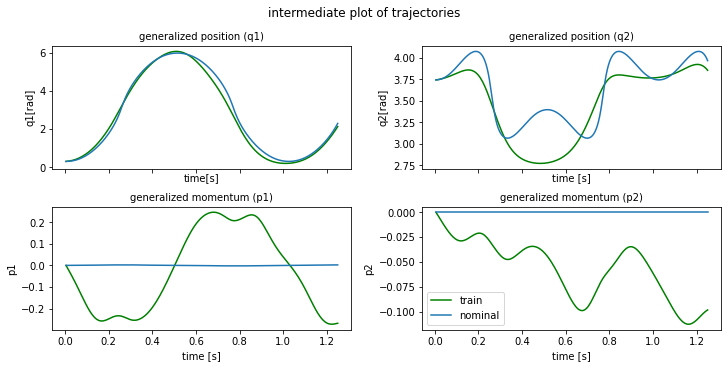

plot time : 1.19472074508667
epoch  590 | train time 5.12 | train loss 4.731582e-02 | test loss 5.411412e-02 | test time 1.00  
epoch  591 | train time 3.94 | train loss 4.693577e-02 
epoch  592 | train time 4.00 | train loss 4.664385e-02 
epoch  593 | train time 4.06 | train loss 4.644810e-02 
epoch  594 | train time 4.76 | train loss 4.608720e-02 
epoch  595 | train time 3.97 | train loss 4.584438e-02 
epoch  596 | train time 4.15 | train loss 4.561754e-02 
epoch  597 | train time 4.07 | train loss 4.529311e-02 
epoch  598 | train time 4.00 | train loss 4.507474e-02 
epoch  599 | train time 3.85 | train loss 4.483854e-02 
horizon length : 300


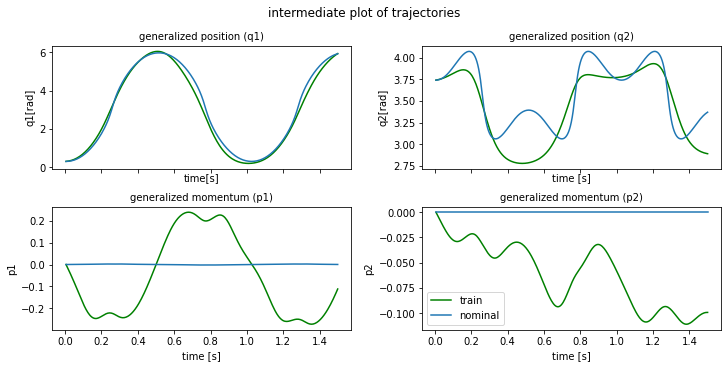

plot time : 1.2639954090118408
epoch  600 | train time 6.06 | train loss 4.785117e-02 | test loss 5.958507e-02 | test time 1.31  
epoch  601 | train time 4.96 | train loss 5.230060e-02 
epoch  602 | train time 4.68 | train loss 7.683186e-02 
epoch  603 | train time 4.99 | train loss 1.940648e-01 
epoch  604 | train time 4.70 | train loss 6.518165e-01 
epoch  605 | train time 4.65 | train loss 1.144301e+00 
epoch  606 | train time 4.76 | train loss 5.123456e-01 
epoch  607 | train time 4.91 | train loss 1.297935e-01 
epoch  608 | train time 4.75 | train loss 6.805938e-01 
epoch  609 | train time 4.86 | train loss 2.633115e-01 


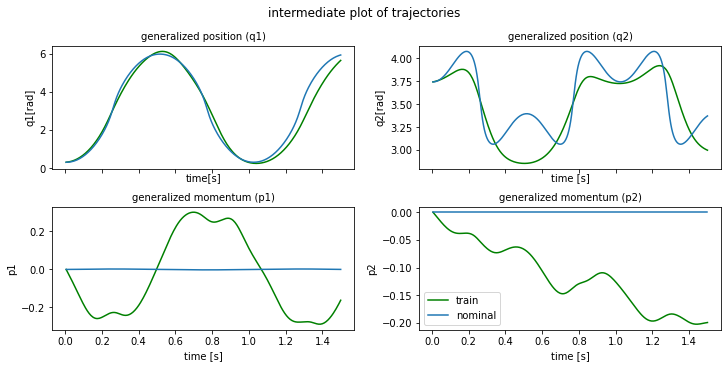

plot time : 1.2238662242889404
epoch  610 | train time 6.09 | train loss 2.537013e-01 | test loss 4.596608e-01 | test time 1.18  
epoch  611 | train time 4.70 | train loss 4.355401e-01 
epoch  612 | train time 4.79 | train loss 8.464533e-02 
epoch  613 | train time 4.77 | train loss 3.641977e-01 
epoch  614 | train time 4.87 | train loss 9.522709e-02 
epoch  615 | train time 4.87 | train loss 2.758597e-01 
epoch  616 | train time 4.73 | train loss 1.408197e-01 
epoch  617 | train time 4.68 | train loss 1.790139e-01 
epoch  618 | train time 4.85 | train loss 1.675642e-01 
epoch  619 | train time 4.80 | train loss 1.084400e-01 


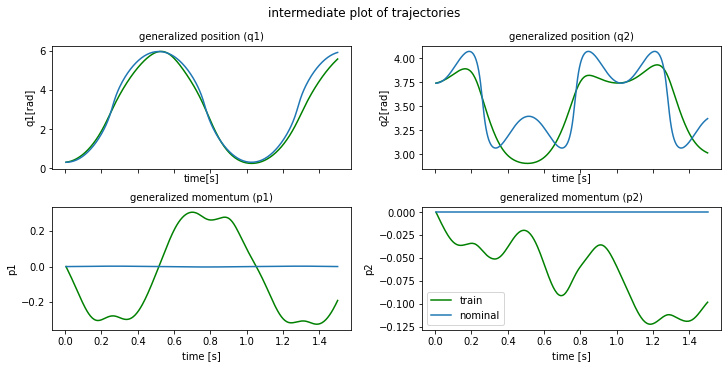

plot time : 1.257638931274414
epoch  620 | train time 6.03 | train loss 1.831794e-01 | test loss 8.018963e-02 | test time 1.20  
epoch  621 | train time 4.78 | train loss 7.459766e-02 
epoch  622 | train time 4.68 | train loss 1.768623e-01 
epoch  623 | train time 4.86 | train loss 6.658347e-02 
epoch  624 | train time 4.98 | train loss 1.490087e-01 
epoch  625 | train time 4.73 | train loss 7.048936e-02 
epoch  626 | train time 4.63 | train loss 1.223793e-01 
epoch  627 | train time 4.74 | train loss 8.265734e-02 
epoch  628 | train time 5.02 | train loss 9.642018e-02 
epoch  629 | train time 4.91 | train loss 8.865593e-02 


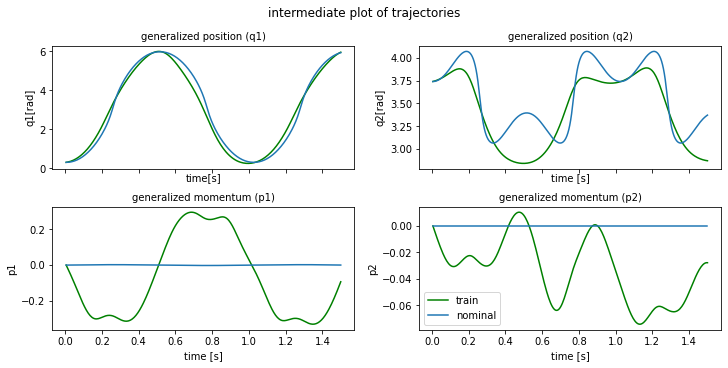

plot time : 1.1839616298675537
epoch  630 | train time 6.02 | train loss 7.812484e-02 | test loss 9.463203e-02 | test time 1.24  
epoch  631 | train time 4.71 | train loss 8.941935e-02 
epoch  632 | train time 4.77 | train loss 6.526466e-02 
epoch  633 | train time 4.93 | train loss 8.914745e-02 
epoch  634 | train time 4.80 | train loss 5.679731e-02 
epoch  635 | train time 4.81 | train loss 8.343238e-02 
epoch  636 | train time 4.78 | train loss 5.585272e-02 
epoch  637 | train time 4.99 | train loss 7.349779e-02 
epoch  638 | train time 5.76 | train loss 5.815703e-02 
epoch  639 | train time 4.91 | train loss 6.462305e-02 


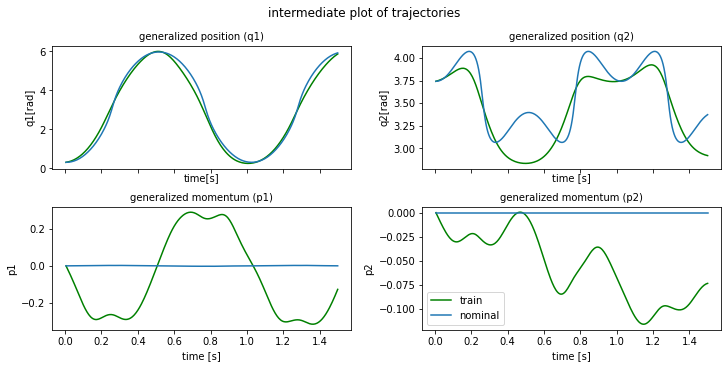

plot time : 1.2057981491088867
epoch  640 | train time 5.94 | train loss 6.012406e-02 | test loss 6.768821e-02 | test time 1.24  
epoch  641 | train time 4.75 | train loss 5.811434e-02 
epoch  642 | train time 4.90 | train loss 6.115977e-02 
epoch  643 | train time 4.64 | train loss 5.336581e-02 
epoch  644 | train time 4.76 | train loss 6.073207e-02 
epoch  645 | train time 5.14 | train loss 5.061026e-02 
epoch  646 | train time 4.62 | train loss 5.847824e-02 
epoch  647 | train time 4.91 | train loss 4.969441e-02 
epoch  648 | train time 4.71 | train loss 5.566138e-02 
epoch  649 | train time 4.91 | train loss 5.021349e-02 


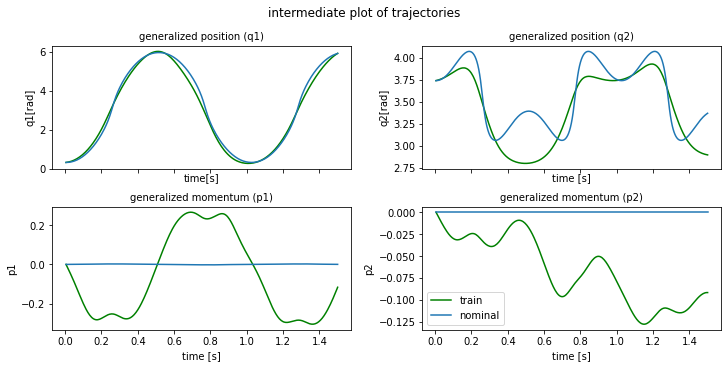

plot time : 1.2521119117736816
epoch  650 | train time 6.02 | train loss 5.183857e-02 | test loss 5.994352e-02 | test time 1.23  
epoch  651 | train time 5.00 | train loss 5.103830e-02 
epoch  652 | train time 5.06 | train loss 4.874321e-02 
epoch  653 | train time 4.85 | train loss 5.119739e-02 
epoch  654 | train time 4.87 | train loss 4.682918e-02 
epoch  655 | train time 4.75 | train loss 5.007036e-02 
epoch  656 | train time 4.74 | train loss 4.665715e-02 
epoch  657 | train time 4.62 | train loss 4.801085e-02 
epoch  658 | train time 4.84 | train loss 4.690361e-02 
epoch  659 | train time 4.99 | train loss 4.578553e-02 


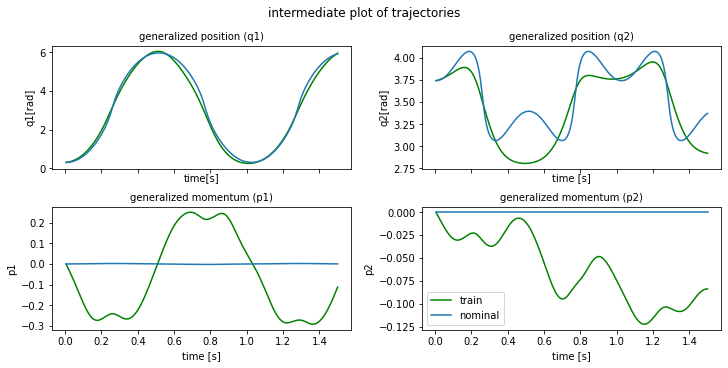

plot time : 1.199369192123413
epoch  660 | train time 6.16 | train loss 4.706077e-02 | test loss 5.189767e-02 | test time 1.30  
epoch  661 | train time 4.61 | train loss 4.469959e-02 
epoch  662 | train time 4.93 | train loss 4.601527e-02 
epoch  663 | train time 4.94 | train loss 4.446637e-02 
epoch  664 | train time 6.20 | train loss 4.439627e-02 
epoch  665 | train time 4.97 | train loss 4.458481e-02 
epoch  666 | train time 4.91 | train loss 4.323270e-02 
epoch  667 | train time 4.98 | train loss 4.398582e-02 
epoch  668 | train time 5.14 | train loss 4.279449e-02 
epoch  669 | train time 4.63 | train loss 4.279989e-02 


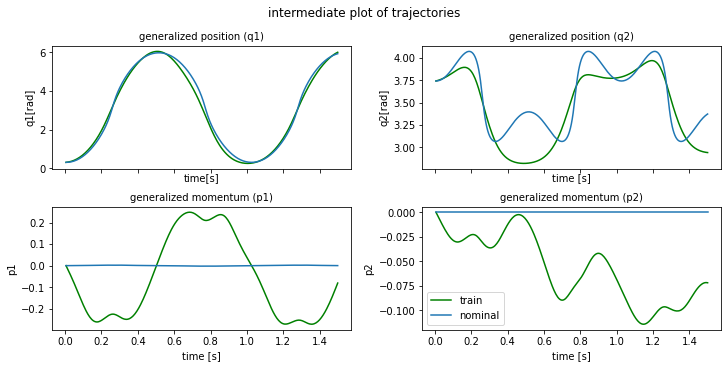

plot time : 1.2572951316833496
epoch  670 | train time 6.27 | train loss 4.275623e-02 | test loss 4.831170e-02 | test time 1.53  
epoch  671 | train time 5.09 | train loss 4.190160e-02 
epoch  672 | train time 4.87 | train loss 4.229695e-02 
epoch  673 | train time 4.75 | train loss 4.152794e-02 
epoch  674 | train time 4.70 | train loss 4.136861e-02 
epoch  675 | train time 4.77 | train loss 4.132685e-02 
epoch  676 | train time 4.75 | train loss 4.066502e-02 
epoch  677 | train time 5.12 | train loss 4.081457e-02 
epoch  678 | train time 4.64 | train loss 4.041773e-02 
epoch  679 | train time 4.89 | train loss 4.008857e-02 


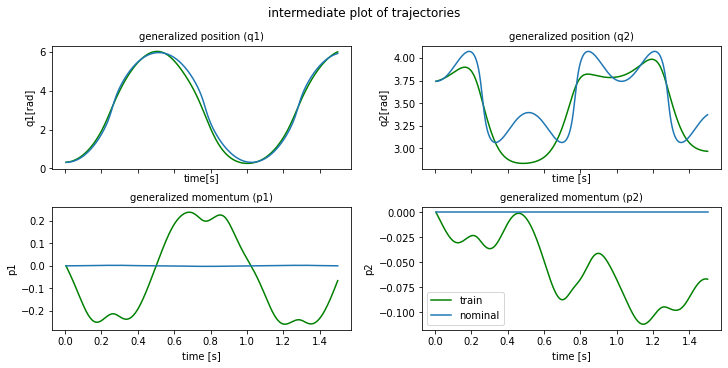

plot time : 2.0171029567718506
epoch  680 | train time 7.18 | train loss 4.012559e-02 | test loss 4.546299e-02 | test time 1.39  
epoch  681 | train time 4.65 | train loss 3.962959e-02 
epoch  682 | train time 4.90 | train loss 3.950879e-02 
epoch  683 | train time 5.02 | train loss 3.938325e-02 
epoch  684 | train time 4.92 | train loss 3.897444e-02 
epoch  685 | train time 5.04 | train loss 3.892449e-02 
epoch  686 | train time 4.79 | train loss 3.870684e-02 
epoch  687 | train time 5.08 | train loss 3.840081e-02 
epoch  688 | train time 4.89 | train loss 3.834591e-02 
epoch  689 | train time 5.04 | train loss 3.810700e-02 


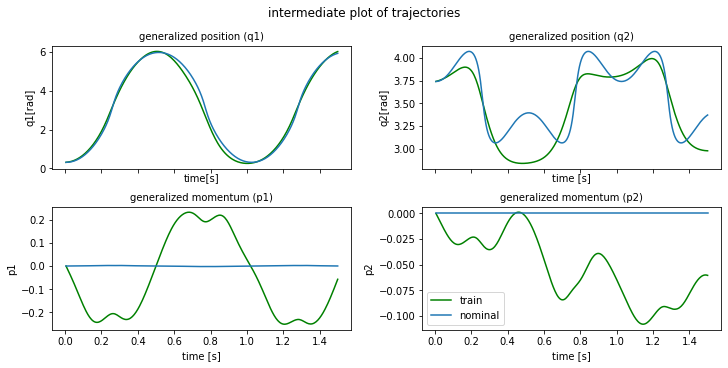

plot time : 1.266894817352295
epoch  690 | train time 5.95 | train loss 3.787412e-02 | test loss 4.309748e-02 | test time 1.19  
epoch  691 | train time 4.67 | train loss 3.780851e-02 
epoch  692 | train time 4.87 | train loss 3.760499e-02 
epoch  693 | train time 4.87 | train loss 3.745833e-02 
epoch  694 | train time 4.84 | train loss 3.748513e-02 
epoch  695 | train time 4.73 | train loss 3.753781e-02 
epoch  696 | train time 4.69 | train loss 3.794080e-02 
epoch  697 | train time 4.84 | train loss 3.917719e-02 
epoch  698 | train time 4.98 | train loss 4.228084e-02 
epoch  699 | train time 4.90 | train loss 4.975335e-02 


In [32]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [33]:
if collect_grads:
    plot_grads(stats)

In [34]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [35]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [36]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

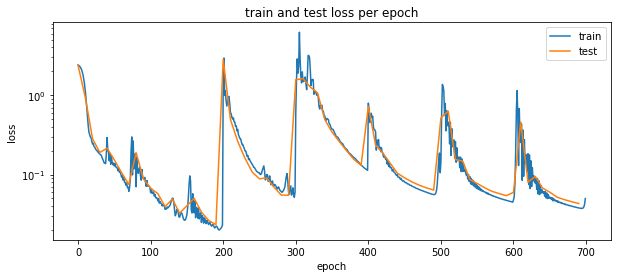

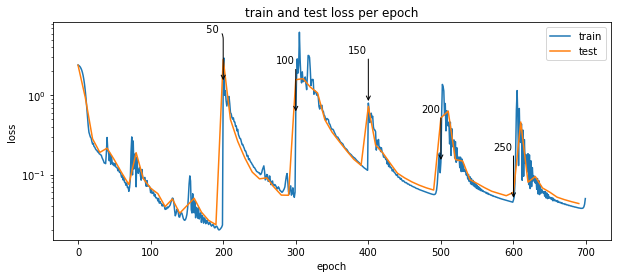

In [37]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

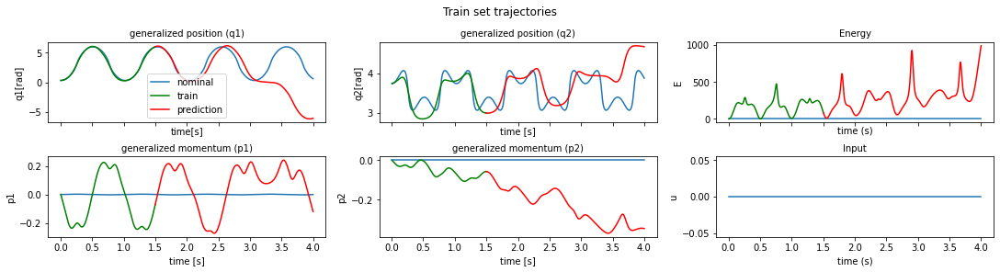

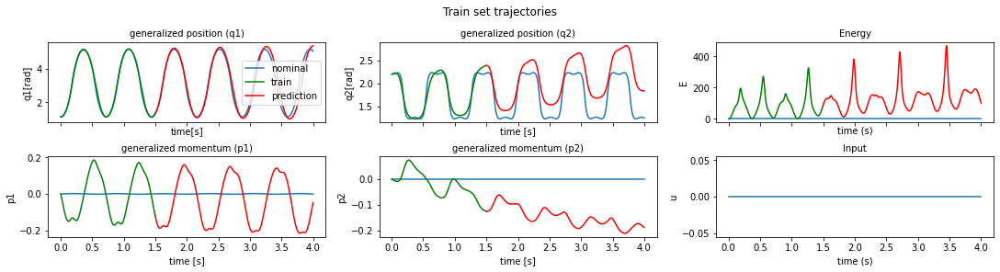

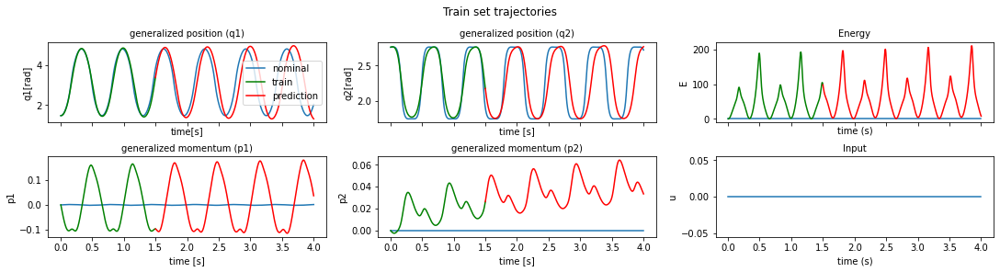

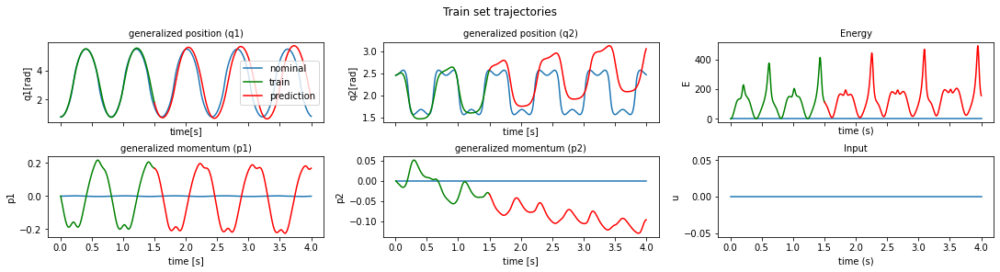

In [38]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

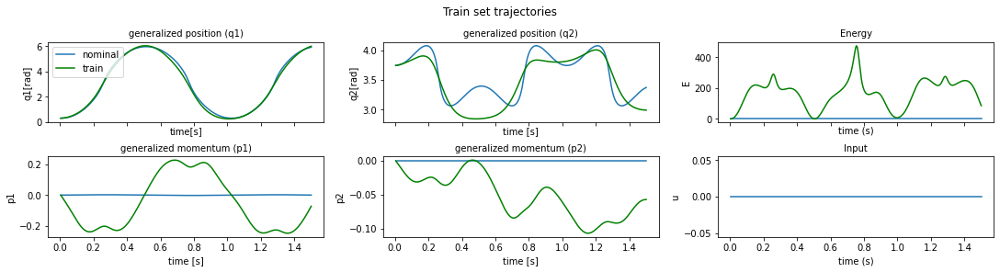

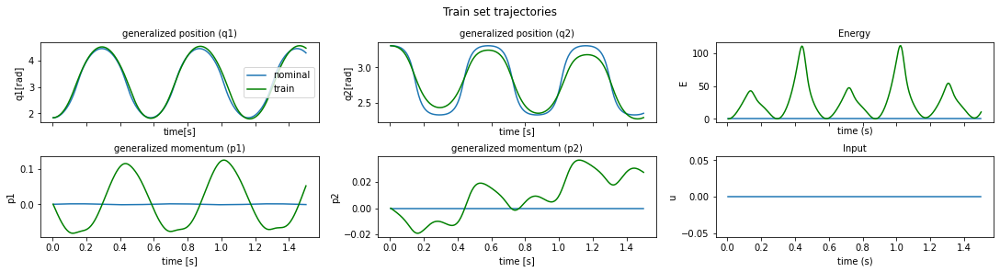

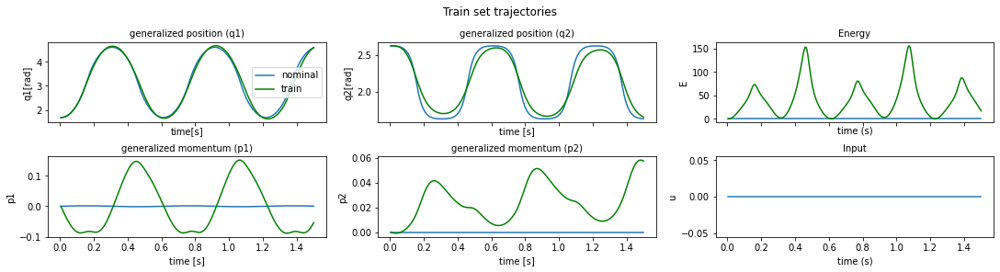

In [39]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + "nopred.png",
        w_rescale=w_rescale,
    )

##### 30k parameters - w horizon only loss rescaling no clipping (didnt work)

In [74]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800  # length of a trajectory
num_trajectories = 125  # number of trajectories in total
proportion = 0.8  # train test proportion
batch_size = 100  # batch size used by dataloader
w_rescale = [1, 1, 1, 1]  # [1, 1000, 1, 10000]  # [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False  # shuffle sample in the batches between epochs
# 'hamiltonian' or 'newtonian', newtonian if you want [q1,q1_dot,q2,q2_dot]
coord_type = "hamiltonian"
min_max_rescale = False  # rescale the training trajectories
# which dimensions to rescale if using min_max_rescale, so that nothing is divided by zero
rescale_dims = [1, 1, 1, 0]

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = True
grad_clip = False  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)  # total number of training epochs

cpu


In [75]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [76]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=90, nb_hidden_layers=4, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 33303
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p33k_Ts0.005_nodissip_rescaledloss_
horizon_list and switch_steps have the same size


In [77]:
save_prefix = save_prefix + "nostdrescale"

horizon length : 50
min max values updated


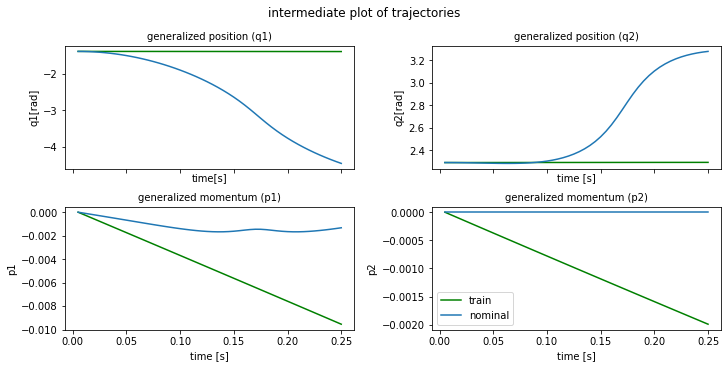

plot time : 1.3403770923614502
min max values updated
epoch    0 | train time 2.18 | train loss 5.455521e+00 | test loss 4.968456e+01 | test time 0.21  
epoch    1 | train time 0.76 | train loss 3.629966e+01 
epoch    2 | train time 0.77 | train loss 6.451056e+00 
epoch    3 | train time 0.78 | train loss 1.256960e+00 
epoch    4 | train time 0.76 | train loss 5.001904e+00 
epoch    5 | train time 0.80 | train loss 6.486898e+00 
epoch    6 | train time 0.78 | train loss 4.606668e+00 
epoch    7 | train time 0.79 | train loss 2.121376e+00 
epoch    8 | train time 0.78 | train loss 7.558954e-01 
epoch    9 | train time 0.83 | train loss 7.024049e-01 


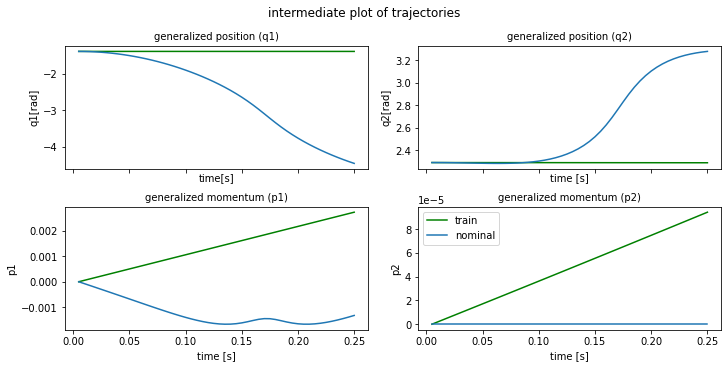

plot time : 1.2371056079864502
epoch   10 | train time 2.22 | train loss 1.332443e+00 | test loss 2.231385e+00 | test time 0.28  
epoch   11 | train time 0.85 | train loss 1.865769e+00 
epoch   12 | train time 0.78 | train loss 1.944461e+00 
epoch   13 | train time 0.78 | train loss 1.675180e+00 
epoch   14 | train time 0.78 | train loss 1.295447e+00 
epoch   15 | train time 0.79 | train loss 9.617915e-01 
epoch   16 | train time 0.79 | train loss 7.317730e-01 
epoch   17 | train time 0.82 | train loss 6.089284e-01 
epoch   18 | train time 0.82 | train loss 5.741048e-01 
epoch   19 | train time 0.86 | train loss 5.971681e-01 


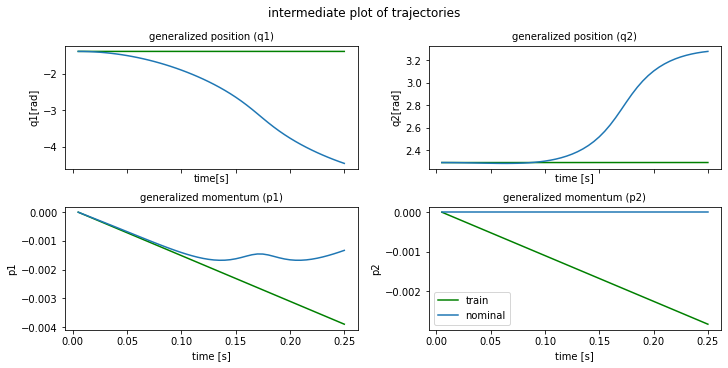

plot time : 1.1605818271636963
epoch   20 | train time 1.96 | train loss 6.430619e-01 | test loss 6.973941e-01 | test time 0.21  
epoch   21 | train time 0.93 | train loss 6.807365e-01 
epoch   22 | train time 0.81 | train loss 6.928726e-01 
epoch   23 | train time 0.77 | train loss 6.790108e-01 
epoch   24 | train time 0.78 | train loss 6.496075e-01 
epoch   25 | train time 0.80 | train loss 6.166294e-01 
epoch   26 | train time 0.78 | train loss 5.876883e-01 
epoch   27 | train time 0.78 | train loss 5.657342e-01 
epoch   28 | train time 0.77 | train loss 5.515388e-01 
epoch   29 | train time 0.87 | train loss 5.454637e-01 


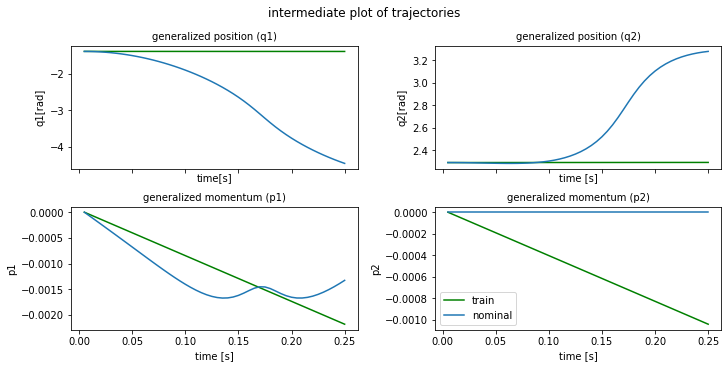

plot time : 1.2438795566558838
epoch   30 | train time 2.10 | train loss 5.471948e-01 | test loss 6.162522e-01 | test time 0.21  
epoch   31 | train time 0.78 | train loss 5.545617e-01 
epoch   32 | train time 0.80 | train loss 5.633787e-01 
epoch   33 | train time 0.80 | train loss 5.691051e-01 
epoch   34 | train time 0.80 | train loss 5.691674e-01 
epoch   35 | train time 0.77 | train loss 5.638930e-01 
epoch   36 | train time 0.80 | train loss 5.553707e-01 
epoch   37 | train time 0.77 | train loss 5.456246e-01 
epoch   38 | train time 0.79 | train loss 5.358662e-01 
epoch   39 | train time 0.80 | train loss 5.270748e-01 


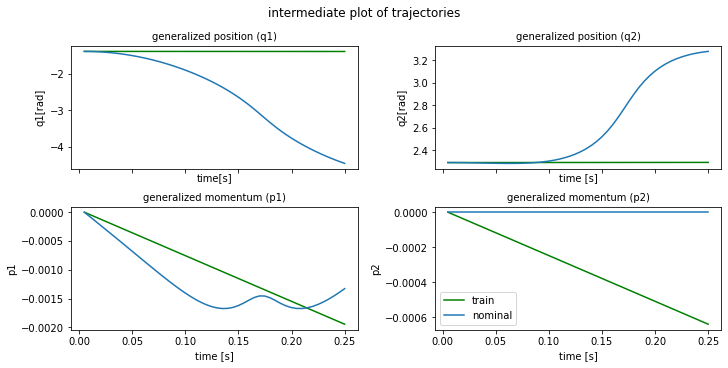

plot time : 1.2100684642791748
epoch   40 | train time 2.06 | train loss 5.206537e-01 | test loss 5.541852e-01 | test time 0.21  
epoch   41 | train time 0.77 | train loss 5.180358e-01 
epoch   42 | train time 0.79 | train loss 5.195095e-01 
epoch   43 | train time 0.79 | train loss 5.235438e-01 
epoch   44 | train time 0.87 | train loss 5.275375e-01 
epoch   45 | train time 0.85 | train loss 5.294438e-01 
epoch   46 | train time 0.79 | train loss 5.287620e-01 
epoch   47 | train time 0.78 | train loss 5.261717e-01 
epoch   48 | train time 0.91 | train loss 5.226164e-01 
epoch   49 | train time 0.86 | train loss 5.188633e-01 


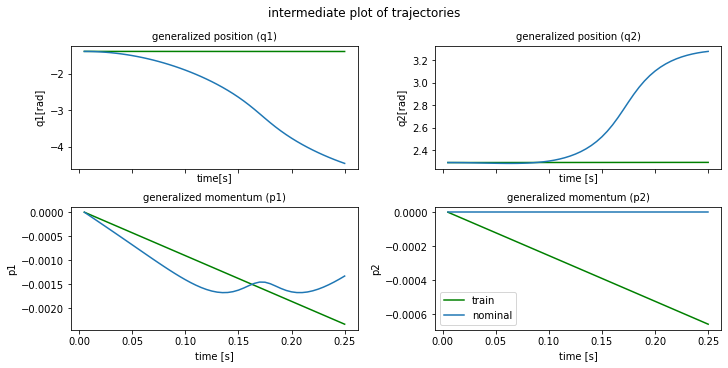

plot time : 1.1771597862243652
epoch   50 | train time 1.97 | train loss 5.155898e-01 | test loss 5.500550e-01 | test time 0.21  
epoch   51 | train time 0.78 | train loss 5.134161e-01 
epoch   52 | train time 0.78 | train loss 5.126295e-01 
epoch   53 | train time 0.81 | train loss 5.129517e-01 
epoch   54 | train time 0.90 | train loss 5.137131e-01 
epoch   55 | train time 0.78 | train loss 5.143206e-01 
epoch   56 | train time 0.89 | train loss 5.145574e-01 
epoch   57 | train time 0.91 | train loss 5.144799e-01 
epoch   58 | train time 0.91 | train loss 5.141557e-01 
epoch   59 | train time 0.88 | train loss 5.135790e-01 


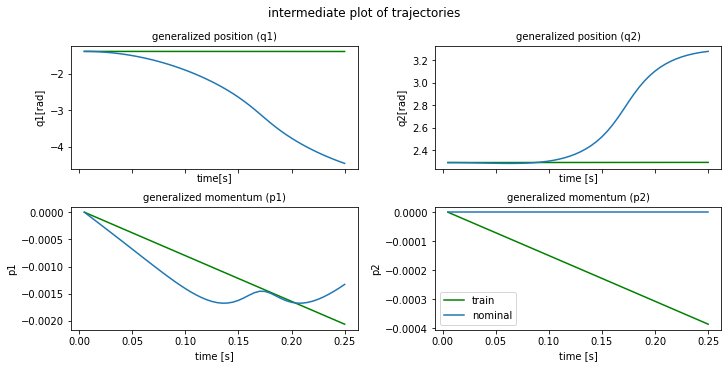

plot time : 1.2426660060882568
epoch   60 | train time 2.11 | train loss 5.127922e-01 | test loss 5.491912e-01 | test time 0.21  
epoch   61 | train time 0.79 | train loss 5.119659e-01 
epoch   62 | train time 0.78 | train loss 5.113103e-01 
epoch   63 | train time 0.80 | train loss 5.109028e-01 
epoch   64 | train time 0.90 | train loss 5.106547e-01 
epoch   65 | train time 0.79 | train loss 5.104402e-01 
epoch   66 | train time 0.77 | train loss 5.102178e-01 
epoch   67 | train time 0.88 | train loss 5.100214e-01 
epoch   68 | train time 0.86 | train loss 5.098623e-01 
epoch   69 | train time 0.78 | train loss 5.097018e-01 


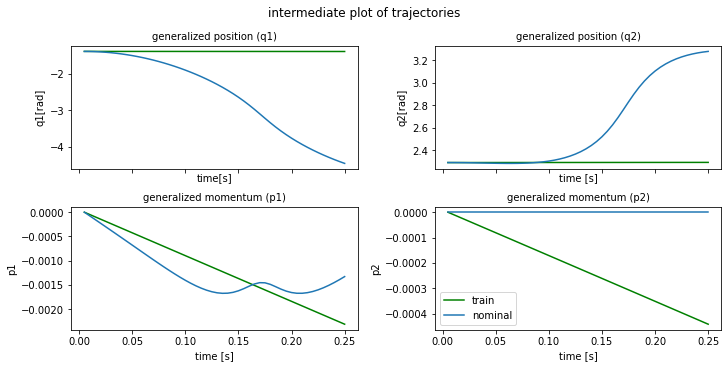

plot time : 1.191680908203125
epoch   70 | train time 1.98 | train loss 5.095150e-01 | test loss 5.469595e-01 | test time 0.21  
epoch   71 | train time 0.78 | train loss 5.093381e-01 
epoch   72 | train time 0.78 | train loss 5.092251e-01 
epoch   73 | train time 0.91 | train loss 5.091699e-01 
epoch   74 | train time 0.78 | train loss 5.091106e-01 
epoch   75 | train time 0.79 | train loss 5.089992e-01 
epoch   76 | train time 0.83 | train loss 5.088437e-01 
epoch   77 | train time 0.90 | train loss 5.086728e-01 
epoch   78 | train time 0.79 | train loss 5.084959e-01 
epoch   79 | train time 0.92 | train loss 5.083119e-01 


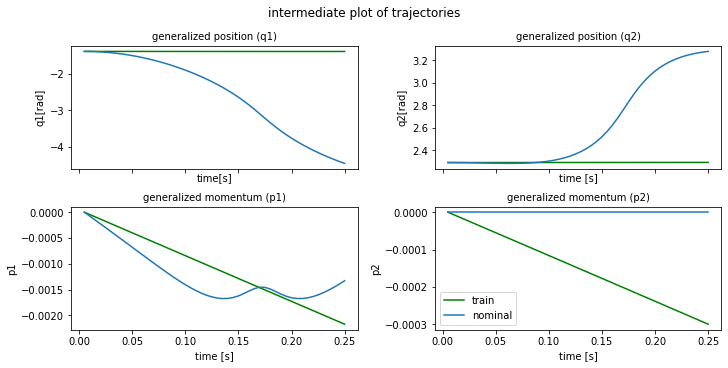

plot time : 1.2124781608581543
epoch   80 | train time 2.04 | train loss 5.081437e-01 | test loss 5.442302e-01 | test time 0.21  
epoch   81 | train time 0.78 | train loss 5.080232e-01 
epoch   82 | train time 0.92 | train loss 5.079559e-01 
epoch   83 | train time 0.79 | train loss 5.079119e-01 
epoch   84 | train time 0.79 | train loss 5.078576e-01 
epoch   85 | train time 0.81 | train loss 5.077817e-01 
epoch   86 | train time 0.79 | train loss 5.076856e-01 
epoch   87 | train time 0.79 | train loss 5.075701e-01 
epoch   88 | train time 0.78 | train loss 5.074364e-01 
epoch   89 | train time 0.85 | train loss 5.072997e-01 


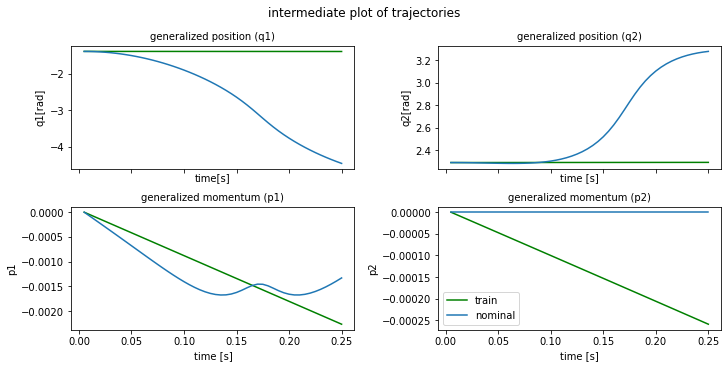

plot time : 1.3244678974151611
epoch   90 | train time 2.20 | train loss 5.071838e-01 | test loss 5.448429e-01 | test time 0.21  
epoch   91 | train time 0.78 | train loss 5.071005e-01 
epoch   92 | train time 0.80 | train loss 5.070409e-01 
epoch   93 | train time 0.78 | train loss 5.069903e-01 
epoch   94 | train time 0.78 | train loss 5.069391e-01 
epoch   95 | train time 0.79 | train loss 5.068792e-01 
epoch   96 | train time 0.81 | train loss 5.068037e-01 
epoch   97 | train time 0.88 | train loss 5.067100e-01 
epoch   98 | train time 0.88 | train loss 5.066073e-01 
epoch   99 | train time 0.81 | train loss 5.065096e-01 


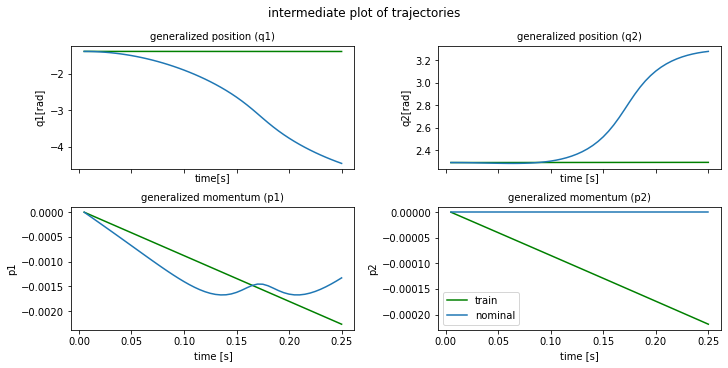

plot time : 1.2286746501922607
epoch  100 | train time 2.06 | train loss 5.064245e-01 | test loss 5.433919e-01 | test time 0.28  
epoch  101 | train time 0.89 | train loss 5.063524e-01 
epoch  102 | train time 0.78 | train loss 5.062898e-01 
epoch  103 | train time 0.78 | train loss 5.062346e-01 
epoch  104 | train time 0.78 | train loss 5.061811e-01 
epoch  105 | train time 0.79 | train loss 5.061230e-01 
epoch  106 | train time 0.77 | train loss 5.060572e-01 
epoch  107 | train time 0.81 | train loss 5.059875e-01 
epoch  108 | train time 0.78 | train loss 5.059178e-01 
epoch  109 | train time 0.90 | train loss 5.058492e-01 


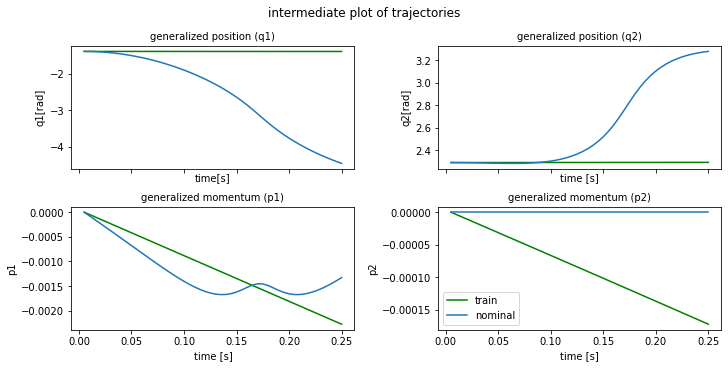

plot time : 1.2074673175811768
epoch  110 | train time 2.05 | train loss 5.057850e-01 | test loss 5.427008e-01 | test time 0.21  
epoch  111 | train time 0.78 | train loss 5.057245e-01 
epoch  112 | train time 0.77 | train loss 5.056676e-01 
epoch  113 | train time 0.79 | train loss 5.056133e-01 
epoch  114 | train time 0.79 | train loss 5.055575e-01 
epoch  115 | train time 0.78 | train loss 5.055017e-01 
epoch  116 | train time 0.81 | train loss 5.054463e-01 
epoch  117 | train time 1.05 | train loss 5.053911e-01 
epoch  118 | train time 1.16 | train loss 5.053374e-01 
epoch  119 | train time 1.16 | train loss 5.052846e-01 


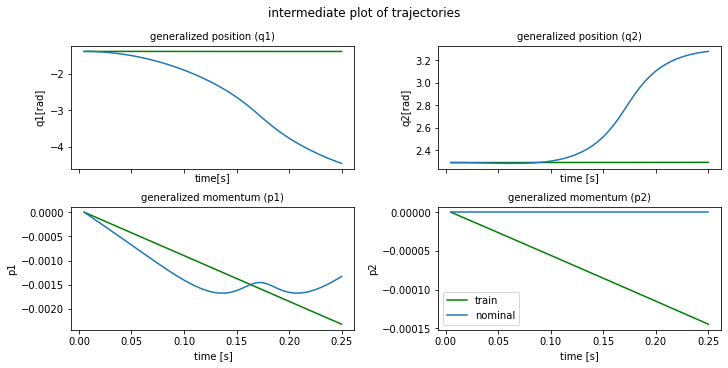

plot time : 1.3534603118896484
epoch  120 | train time 2.30 | train loss 5.052333e-01 | test loss 5.425045e-01 | test time 0.21  
epoch  121 | train time 0.79 | train loss 5.051826e-01 
epoch  122 | train time 0.82 | train loss 5.051329e-01 
epoch  123 | train time 0.85 | train loss 5.050835e-01 
epoch  124 | train time 0.80 | train loss 5.050345e-01 
epoch  125 | train time 0.92 | train loss 5.049866e-01 
epoch  126 | train time 0.88 | train loss 5.049399e-01 
epoch  127 | train time 0.83 | train loss 5.048937e-01 
epoch  128 | train time 0.78 | train loss 5.048487e-01 
epoch  129 | train time 0.78 | train loss 5.048038e-01 


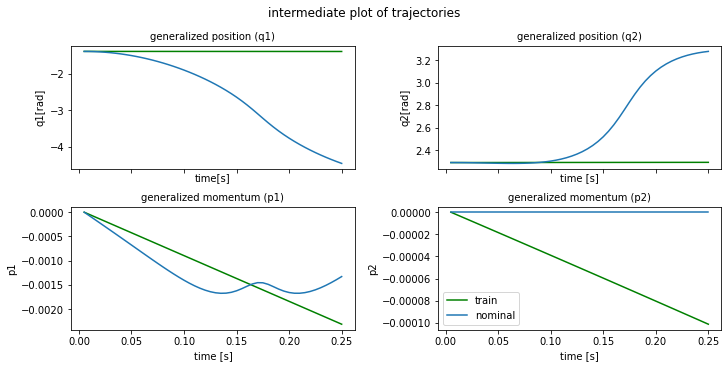

plot time : 1.247387170791626
epoch  130 | train time 2.09 | train loss 5.047596e-01 | test loss 5.422696e-01 | test time 0.21  
epoch  131 | train time 0.78 | train loss 5.047158e-01 
epoch  132 | train time 0.83 | train loss 5.046723e-01 
epoch  133 | train time 0.79 | train loss 5.046301e-01 
epoch  134 | train time 0.85 | train loss 5.045890e-01 
epoch  135 | train time 0.91 | train loss 5.045484e-01 
epoch  136 | train time 0.85 | train loss 5.045090e-01 
epoch  137 | train time 0.79 | train loss 5.044692e-01 
epoch  138 | train time 0.80 | train loss 5.044299e-01 
epoch  139 | train time 0.87 | train loss 5.043913e-01 


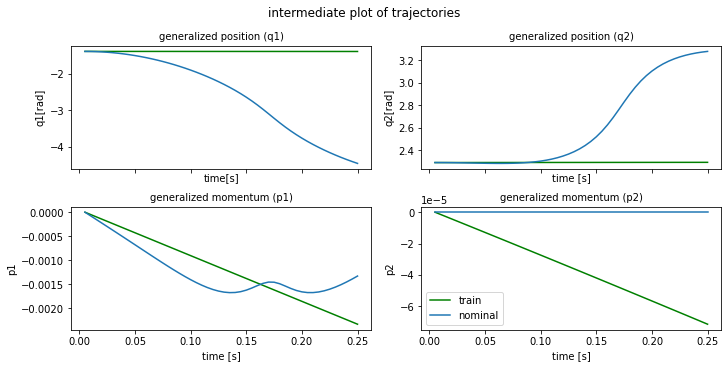

plot time : 1.2450177669525146
epoch  140 | train time 2.07 | train loss 5.043524e-01 | test loss 5.422314e-01 | test time 0.20  
epoch  141 | train time 0.78 | train loss 5.043152e-01 
epoch  142 | train time 0.80 | train loss 5.042778e-01 
epoch  143 | train time 0.82 | train loss 5.042414e-01 
epoch  144 | train time 0.78 | train loss 5.042060e-01 
epoch  145 | train time 0.80 | train loss 5.041711e-01 
epoch  146 | train time 0.92 | train loss 5.041363e-01 
epoch  147 | train time 0.79 | train loss 5.041015e-01 
epoch  148 | train time 0.80 | train loss 5.040674e-01 
epoch  149 | train time 0.79 | train loss 5.040332e-01 


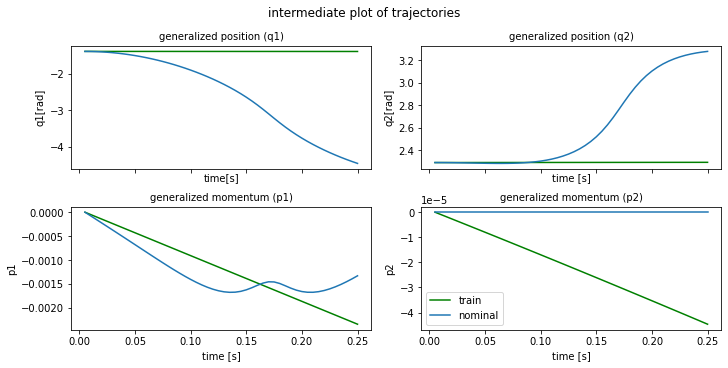

plot time : 1.2865862846374512
epoch  150 | train time 2.08 | train loss 5.040001e-01 | test loss 5.421839e-01 | test time 0.22  
epoch  151 | train time 0.86 | train loss 5.039669e-01 
epoch  152 | train time 0.83 | train loss 5.039349e-01 
epoch  153 | train time 0.78 | train loss 5.039026e-01 
epoch  154 | train time 0.78 | train loss 5.038710e-01 
epoch  155 | train time 0.79 | train loss 5.038397e-01 
epoch  156 | train time 0.79 | train loss 5.038084e-01 
epoch  157 | train time 0.78 | train loss 5.037776e-01 
epoch  158 | train time 0.79 | train loss 5.037470e-01 
epoch  159 | train time 0.89 | train loss 5.037172e-01 


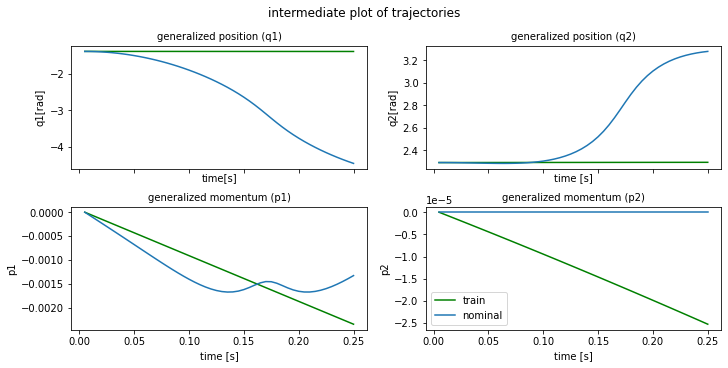

plot time : 1.201164960861206
epoch  160 | train time 2.09 | train loss 5.036869e-01 | test loss 5.421973e-01 | test time 0.21  
epoch  161 | train time 0.83 | train loss 5.036581e-01 
epoch  162 | train time 0.80 | train loss 5.036282e-01 
epoch  163 | train time 0.78 | train loss 5.035995e-01 
epoch  164 | train time 0.79 | train loss 5.035708e-01 
epoch  165 | train time 0.79 | train loss 5.035424e-01 
epoch  166 | train time 0.81 | train loss 5.035136e-01 
epoch  167 | train time 0.90 | train loss 5.034861e-01 
epoch  168 | train time 0.77 | train loss 5.034580e-01 
epoch  169 | train time 0.88 | train loss 5.034307e-01 


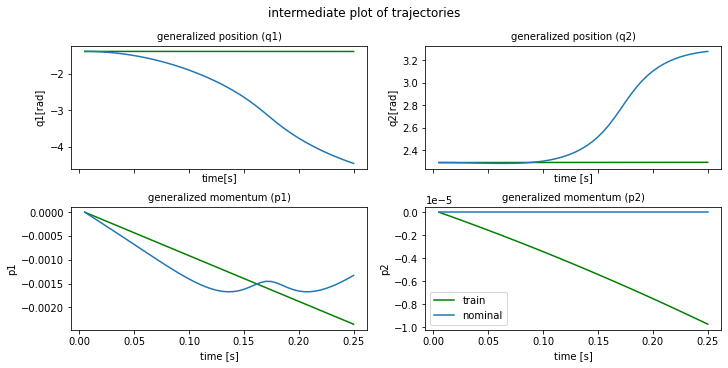

plot time : 1.2048914432525635
epoch  170 | train time 2.01 | train loss 5.034032e-01 | test loss 5.421871e-01 | test time 0.21  
epoch  171 | train time 0.78 | train loss 5.033759e-01 
epoch  172 | train time 0.81 | train loss 5.033485e-01 
epoch  173 | train time 0.79 | train loss 5.033216e-01 
epoch  174 | train time 0.79 | train loss 5.032948e-01 
epoch  175 | train time 0.91 | train loss 5.032688e-01 
epoch  176 | train time 0.83 | train loss 5.032422e-01 
epoch  177 | train time 0.91 | train loss 5.032162e-01 
epoch  178 | train time 0.89 | train loss 5.031899e-01 
epoch  179 | train time 0.82 | train loss 5.031644e-01 


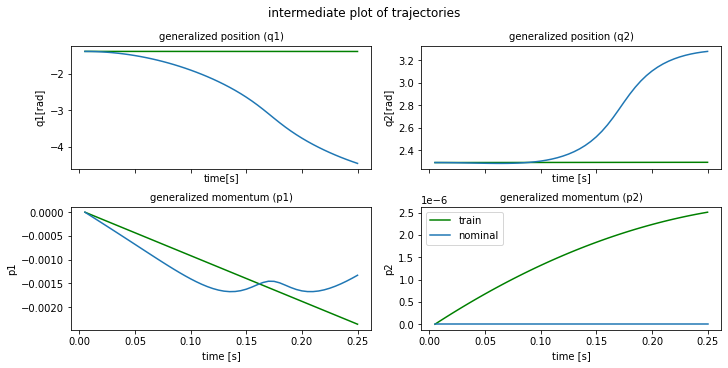

plot time : 1.290358066558838
epoch  180 | train time 2.19 | train loss 5.031380e-01 | test loss 5.421701e-01 | test time 0.26  
epoch  181 | train time 0.78 | train loss 5.031124e-01 
epoch  182 | train time 0.78 | train loss 5.030866e-01 
epoch  183 | train time 0.81 | train loss 5.030614e-01 
epoch  184 | train time 0.89 | train loss 5.030358e-01 
epoch  185 | train time 0.79 | train loss 5.030107e-01 
epoch  186 | train time 0.90 | train loss 5.029854e-01 
epoch  187 | train time 0.80 | train loss 5.029603e-01 
epoch  188 | train time 0.82 | train loss 5.029355e-01 
epoch  189 | train time 0.93 | train loss 5.029104e-01 


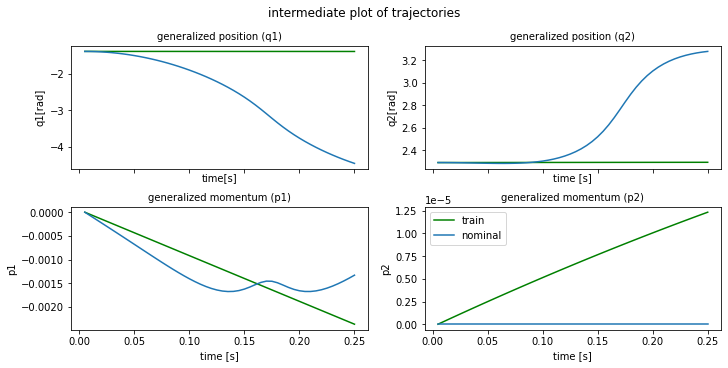

plot time : 1.2033138275146484
epoch  190 | train time 2.21 | train loss 5.028858e-01 | test loss 5.421178e-01 | test time 0.28  
epoch  191 | train time 0.78 | train loss 5.028612e-01 
epoch  192 | train time 0.77 | train loss 5.028366e-01 
epoch  193 | train time 0.77 | train loss 5.028121e-01 
epoch  194 | train time 0.87 | train loss 5.027874e-01 
epoch  195 | train time 0.88 | train loss 5.027628e-01 
epoch  196 | train time 0.79 | train loss 5.027384e-01 
epoch  197 | train time 0.79 | train loss 5.027145e-01 
epoch  198 | train time 0.78 | train loss 5.026899e-01 
epoch  199 | train time 0.88 | train loss 5.026663e-01 
horizon length : 100
min max values updated


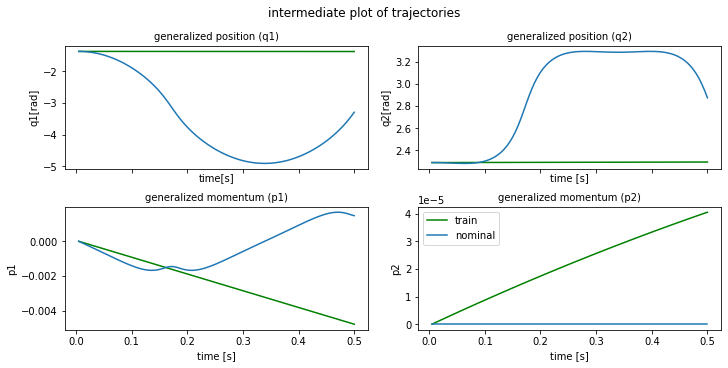

plot time : 1.1813952922821045
min max values updated
epoch  200 | train time 2.92 | train loss 1.634701e+00 | test loss 1.375201e+00 | test time 0.41  
epoch  201 | train time 1.57 | train loss 1.247058e+00 
epoch  202 | train time 1.54 | train loss 1.308913e+00 
epoch  203 | train time 1.55 | train loss 1.252663e+00 
epoch  204 | train time 1.54 | train loss 1.106907e+00 
epoch  205 | train time 1.74 | train loss 1.200139e+00 
epoch  206 | train time 1.71 | train loss 1.226613e+00 
epoch  207 | train time 1.65 | train loss 1.118271e+00 
epoch  208 | train time 1.64 | train loss 1.096593e+00 
epoch  209 | train time 1.68 | train loss 1.151230e+00 


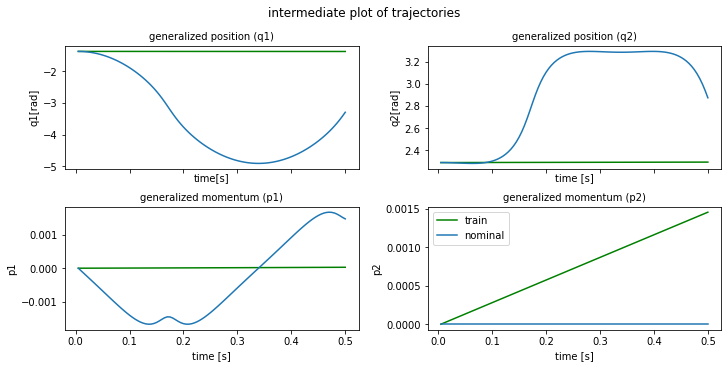

plot time : 1.228316307067871
epoch  210 | train time 2.88 | train loss 1.160852e+00 | test loss 1.072560e+00 | test time 0.43  
epoch  211 | train time 1.55 | train loss 1.113691e+00 
epoch  212 | train time 1.69 | train loss 1.074450e+00 
epoch  213 | train time 1.59 | train loss 1.072482e+00 
epoch  214 | train time 1.57 | train loss 1.084386e+00 
epoch  215 | train time 1.62 | train loss 1.084108e+00 
epoch  216 | train time 1.55 | train loss 1.074798e+00 
epoch  217 | train time 1.55 | train loss 1.072584e+00 
epoch  218 | train time 1.58 | train loss 1.079870e+00 
epoch  219 | train time 1.64 | train loss 1.084637e+00 


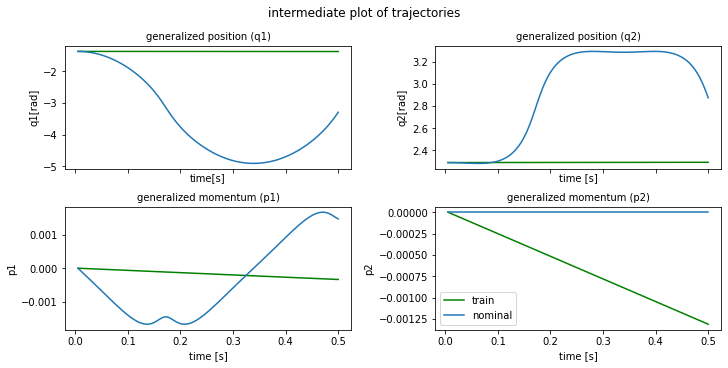

plot time : 1.1516778469085693
epoch  220 | train time 2.83 | train loss 1.078039e+00 | test loss 1.090449e+00 | test time 0.40  
epoch  221 | train time 1.58 | train loss 1.064018e+00 
epoch  222 | train time 1.58 | train loss 1.052687e+00 
epoch  223 | train time 1.74 | train loss 1.049839e+00 
epoch  224 | train time 1.67 | train loss 1.053728e+00 
epoch  225 | train time 1.75 | train loss 1.058733e+00 
epoch  226 | train time 1.66 | train loss 1.060457e+00 
epoch  227 | train time 1.57 | train loss 1.058253e+00 
epoch  228 | train time 1.60 | train loss 1.054377e+00 
epoch  229 | train time 1.71 | train loss 1.051437e+00 


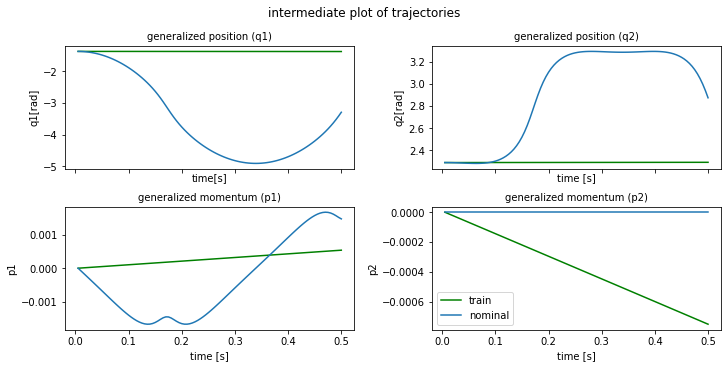

plot time : 1.1782724857330322
epoch  230 | train time 2.92 | train loss 1.050415e+00 | test loss 1.064742e+00 | test time 0.41  
epoch  231 | train time 1.55 | train loss 1.050453e+00 
epoch  232 | train time 1.57 | train loss 1.050078e+00 
epoch  233 | train time 1.68 | train loss 1.048608e+00 
epoch  234 | train time 1.63 | train loss 1.046605e+00 
epoch  235 | train time 1.60 | train loss 1.045189e+00 
epoch  236 | train time 1.56 | train loss 1.044977e+00 
epoch  237 | train time 1.68 | train loss 1.045600e+00 
epoch  238 | train time 1.54 | train loss 1.046119e+00 
epoch  239 | train time 1.68 | train loss 1.045864e+00 


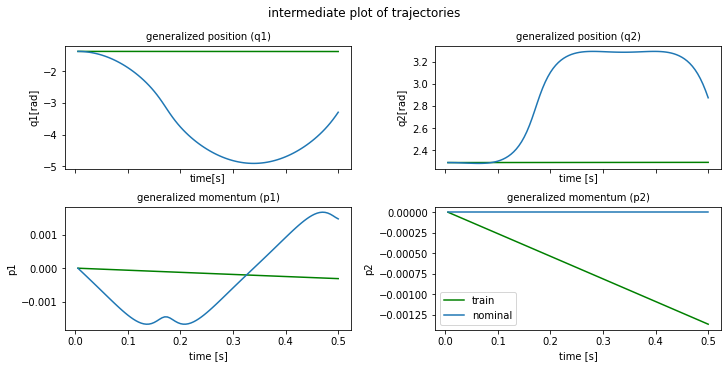

plot time : 1.165574312210083
epoch  240 | train time 2.92 | train loss 1.044923e+00 | test loss 1.069418e+00 | test time 0.55  
epoch  241 | train time 1.67 | train loss 1.043956e+00 
epoch  242 | train time 1.55 | train loss 1.043578e+00 
epoch  243 | train time 1.55 | train loss 1.043891e+00 
epoch  244 | train time 1.75 | train loss 1.044472e+00 
epoch  245 | train time 1.63 | train loss 1.044754e+00 
epoch  246 | train time 1.66 | train loss 1.044451e+00 
epoch  247 | train time 1.57 | train loss 1.043716e+00 
epoch  248 | train time 1.54 | train loss 1.042973e+00 
epoch  249 | train time 1.81 | train loss 1.042588e+00 


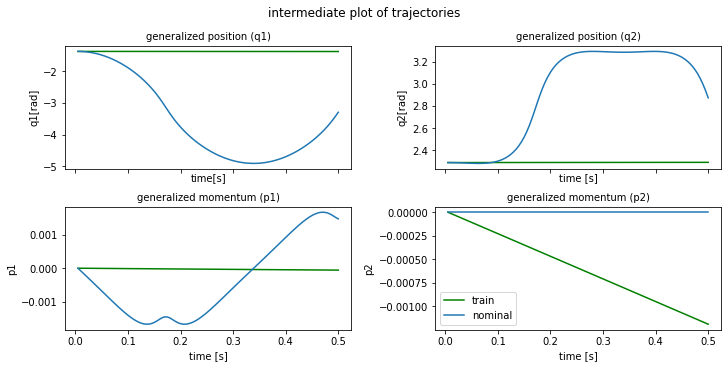

plot time : 1.1625385284423828
epoch  250 | train time 2.75 | train loss 1.042624e+00 | test loss 1.066523e+00 | test time 0.44  
epoch  251 | train time 1.69 | train loss 1.042874e+00 
epoch  252 | train time 1.60 | train loss 1.043048e+00 
epoch  253 | train time 1.56 | train loss 1.042995e+00 
epoch  254 | train time 1.62 | train loss 1.042768e+00 
epoch  255 | train time 1.68 | train loss 1.042518e+00 
epoch  256 | train time 1.54 | train loss 1.042360e+00 
epoch  257 | train time 1.67 | train loss 1.042284e+00 
epoch  258 | train time 1.59 | train loss 1.042210e+00 
epoch  259 | train time 2.37 | train loss 1.042078e+00 


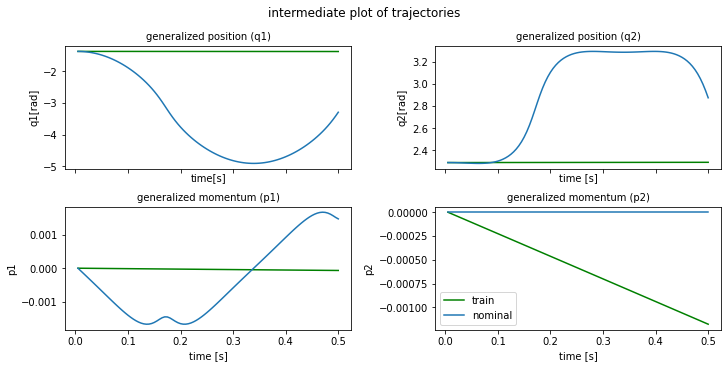

plot time : 1.2362034320831299
epoch  260 | train time 3.20 | train loss 1.041907e+00 | test loss 1.066816e+00 | test time 0.40  
epoch  261 | train time 1.56 | train loss 1.041763e+00 
epoch  262 | train time 1.75 | train loss 1.041700e+00 
epoch  263 | train time 1.60 | train loss 1.041708e+00 
epoch  264 | train time 1.73 | train loss 1.041719e+00 
epoch  265 | train time 1.58 | train loss 1.041670e+00 
epoch  266 | train time 1.58 | train loss 1.041546e+00 
epoch  267 | train time 1.59 | train loss 1.041384e+00 
epoch  268 | train time 1.56 | train loss 1.041246e+00 
epoch  269 | train time 1.57 | train loss 1.041167e+00 


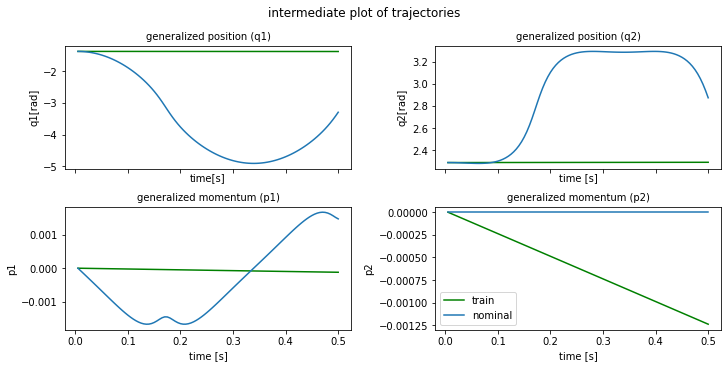

plot time : 1.2036545276641846
epoch  270 | train time 2.85 | train loss 1.041134e+00 | test loss 1.065721e+00 | test time 0.42  
epoch  271 | train time 1.68 | train loss 1.041107e+00 
epoch  272 | train time 1.57 | train loss 1.041049e+00 
epoch  273 | train time 1.56 | train loss 1.040961e+00 
epoch  274 | train time 1.63 | train loss 1.040863e+00 
epoch  275 | train time 1.80 | train loss 1.040783e+00 
epoch  276 | train time 1.63 | train loss 1.040727e+00 
epoch  277 | train time 1.73 | train loss 1.040685e+00 
epoch  278 | train time 1.70 | train loss 1.040637e+00 
epoch  279 | train time 1.57 | train loss 1.040574e+00 


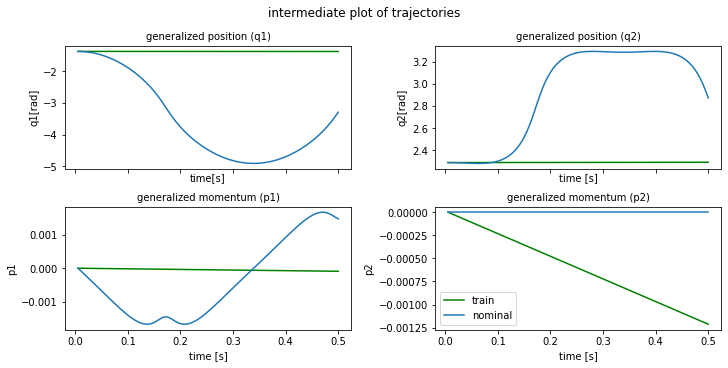

plot time : 1.23555588722229
epoch  280 | train time 2.90 | train loss 1.040500e+00 | test loss 1.062779e+00 | test time 0.40  
epoch  281 | train time 1.53 | train loss 1.040427e+00 
epoch  282 | train time 1.57 | train loss 1.040363e+00 
epoch  283 | train time 1.54 | train loss 1.040305e+00 
epoch  284 | train time 1.63 | train loss 1.040246e+00 
epoch  285 | train time 1.53 | train loss 1.040179e+00 
epoch  286 | train time 1.69 | train loss 1.040112e+00 
epoch  287 | train time 1.76 | train loss 1.040046e+00 
epoch  288 | train time 1.80 | train loss 1.039989e+00 
epoch  289 | train time 1.69 | train loss 1.039933e+00 


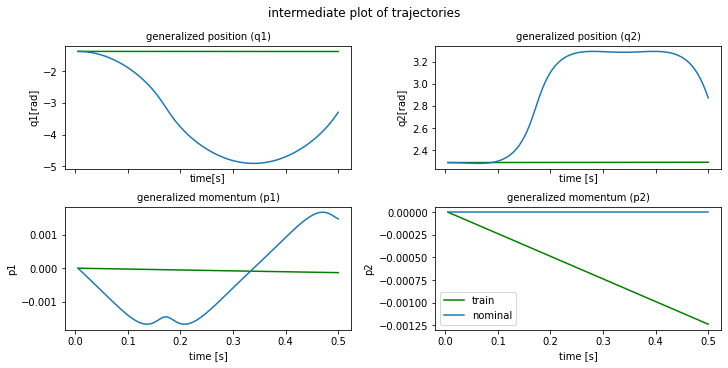

plot time : 1.2040190696716309
epoch  290 | train time 2.90 | train loss 1.039877e+00 | test loss 1.062473e+00 | test time 0.40  
epoch  291 | train time 1.57 | train loss 1.039813e+00 
epoch  292 | train time 1.54 | train loss 1.039745e+00 
epoch  293 | train time 1.56 | train loss 1.039677e+00 
epoch  294 | train time 1.90 | train loss 1.039613e+00 
epoch  295 | train time 1.59 | train loss 1.039556e+00 
epoch  296 | train time 1.61 | train loss 1.039499e+00 
epoch  297 | train time 1.53 | train loss 1.039440e+00 
epoch  298 | train time 1.63 | train loss 1.039377e+00 
epoch  299 | train time 1.66 | train loss 1.039314e+00 
horizon length : 150
min max values updated


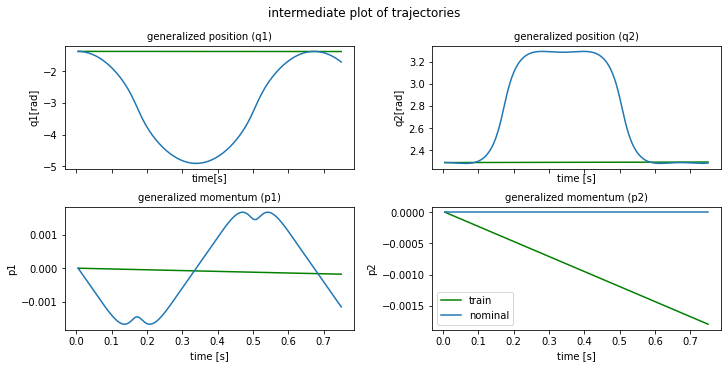

plot time : 1.2143054008483887
min max values updated
epoch  300 | train time 3.66 | train loss 9.120780e-01 | test loss 9.188411e-01 | test time 0.62  
epoch  301 | train time 2.38 | train loss 9.063864e-01 
epoch  302 | train time 2.31 | train loss 8.976141e-01 
epoch  303 | train time 2.43 | train loss 8.882980e-01 
epoch  304 | train time 2.57 | train loss 8.799064e-01 
epoch  305 | train time 2.56 | train loss 8.731233e-01 
epoch  306 | train time 2.32 | train loss 8.680494e-01 
epoch  307 | train time 2.45 | train loss 8.641326e-01 
epoch  308 | train time 2.53 | train loss 8.605515e-01 
epoch  309 | train time 2.43 | train loss 8.569566e-01 


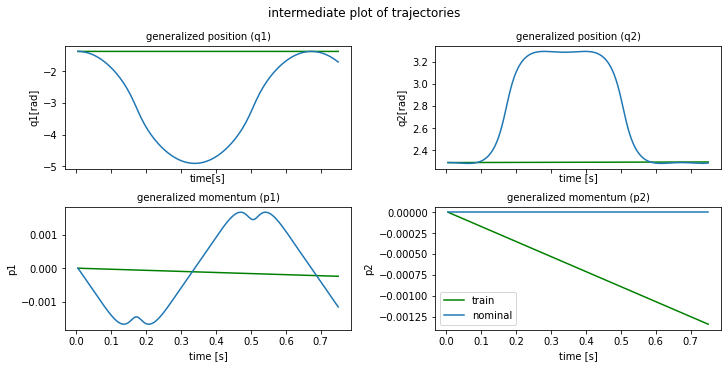

plot time : 1.199387788772583
epoch  310 | train time 3.62 | train loss 8.536065e-01 | test loss 8.531258e-01 | test time 0.60  
epoch  311 | train time 2.37 | train loss 8.508198e-01 
epoch  312 | train time 2.41 | train loss 8.486726e-01 
epoch  313 | train time 2.32 | train loss 8.471916e-01 
epoch  314 | train time 2.62 | train loss 8.463712e-01 
epoch  315 | train time 2.45 | train loss 8.459256e-01 
epoch  316 | train time 2.56 | train loss 8.454360e-01 
epoch  317 | train time 2.34 | train loss 8.447537e-01 
epoch  318 | train time 2.36 | train loss 8.439803e-01 
epoch  319 | train time 2.37 | train loss 8.432004e-01 


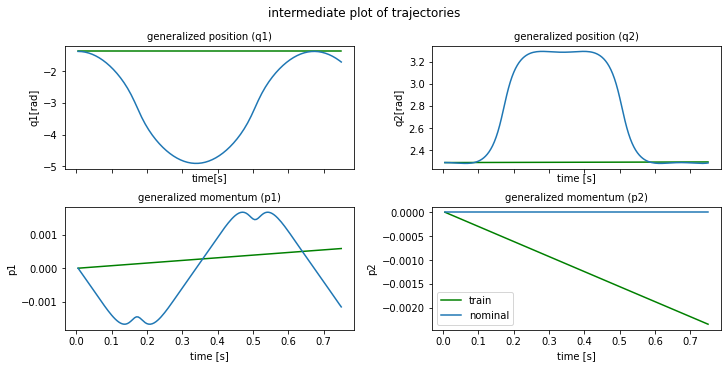

plot time : 1.2036921977996826
epoch  320 | train time 3.59 | train loss 8.425012e-01 | test loss 8.529695e-01 | test time 0.62  
epoch  321 | train time 2.55 | train loss 8.420588e-01 
epoch  322 | train time 2.36 | train loss 8.419712e-01 
epoch  323 | train time 2.55 | train loss 8.421461e-01 
epoch  324 | train time 2.40 | train loss 8.424214e-01 
epoch  325 | train time 2.36 | train loss 8.426858e-01 
epoch  326 | train time 2.33 | train loss 8.428379e-01 
epoch  327 | train time 2.36 | train loss 8.427820e-01 
epoch  328 | train time 2.46 | train loss 8.425047e-01 
epoch  329 | train time 2.33 | train loss 8.420869e-01 


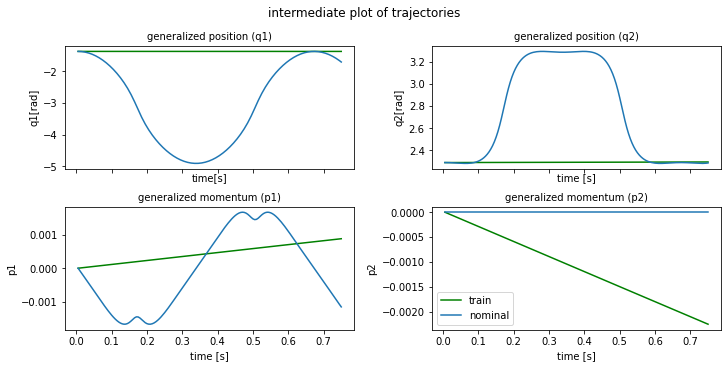

plot time : 1.1879487037658691
epoch  330 | train time 3.57 | train loss 8.416103e-01 | test loss 8.491848e-01 | test time 0.66  
epoch  331 | train time 2.36 | train loss 8.411251e-01 
epoch  332 | train time 2.36 | train loss 8.406779e-01 
epoch  333 | train time 2.57 | train loss 8.403071e-01 
epoch  334 | train time 2.54 | train loss 8.400045e-01 
epoch  335 | train time 2.35 | train loss 8.397375e-01 
epoch  336 | train time 2.32 | train loss 8.394903e-01 
epoch  337 | train time 2.34 | train loss 8.392674e-01 
epoch  338 | train time 2.42 | train loss 8.390699e-01 
epoch  339 | train time 2.52 | train loss 8.388960e-01 


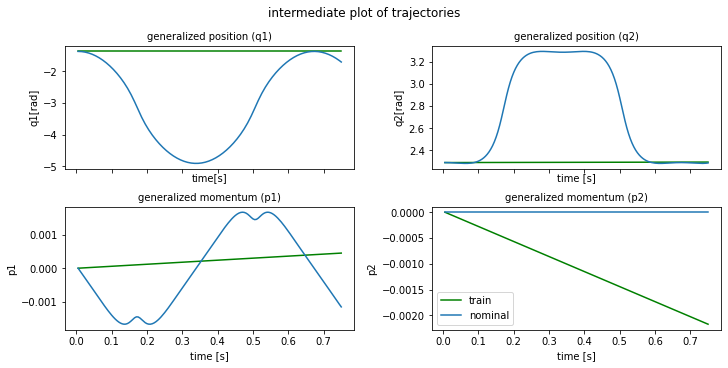

plot time : 1.2915828227996826
epoch  340 | train time 3.81 | train loss 8.387542e-01 | test loss 8.450649e-01 | test time 0.97  
epoch  341 | train time 2.33 | train loss 8.386521e-01 
epoch  342 | train time 3.14 | train loss 8.385779e-01 
epoch  343 | train time 2.64 | train loss 8.385134e-01 
epoch  344 | train time 2.33 | train loss 8.384485e-01 
epoch  345 | train time 2.31 | train loss 8.383771e-01 
epoch  346 | train time 2.57 | train loss 8.382937e-01 
epoch  347 | train time 2.40 | train loss 8.381974e-01 


KeyboardInterrupt: ignored

In [78]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [ ]:
if collect_grads:
    plot_grads(stats)

In [ ]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [ ]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [ ]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

In [ ]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

In [ ]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

In [ ]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + "nopred.png",
        w_rescale=w_rescale,
    )

##### 30k parameters - w horizon - std rescaling (and loss) no clipping


In [63]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800  # length of a trajectory
num_trajectories = 125  # number of trajectories in total
proportion = 0.8  # train test proportion
batch_size = 100  # batch size used by dataloader
w_rescale = [1, 1000, 1, 10000]  # [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False  # shuffle sample in the batches between epochs
# 'hamiltonian' or 'newtonian', newtonian if you want [q1,q1_dot,q2,q2_dot]
coord_type = "hamiltonian"
min_max_rescale = False  # rescale the training trajectories
# which dimensions to rescale if using min_max_rescale, so that nothing is divided by zero
rescale_dims = [1, 1, 1, 0]

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = True
grad_clip = False  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)  # total number of training epochs

cpu


In [64]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [65]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=90, nb_hidden_layers=4, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 33303
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p33k_Ts0.005_nodissip_rescaledloss_
horizon_list and switch_steps have the same size


horizon length : 50
min max values updated


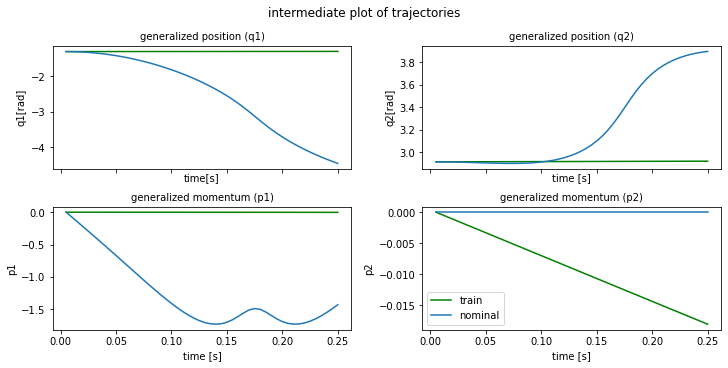

plot time : 1.187248706817627
min max values updated
epoch    0 | train time 2.02 | train loss 1.000316e+00 | test loss 9.867424e-01 | test time 0.20  
epoch    1 | train time 0.76 | train loss 9.900981e-01 
epoch    2 | train time 0.77 | train loss 9.796321e-01 
epoch    3 | train time 0.77 | train loss 9.653174e-01 
epoch    4 | train time 0.77 | train loss 9.449398e-01 
epoch    5 | train time 0.85 | train loss 9.169448e-01 
epoch    6 | train time 0.77 | train loss 8.804151e-01 
epoch    7 | train time 0.84 | train loss 8.351712e-01 
epoch    8 | train time 0.85 | train loss 7.813307e-01 
epoch    9 | train time 0.77 | train loss 7.192522e-01 


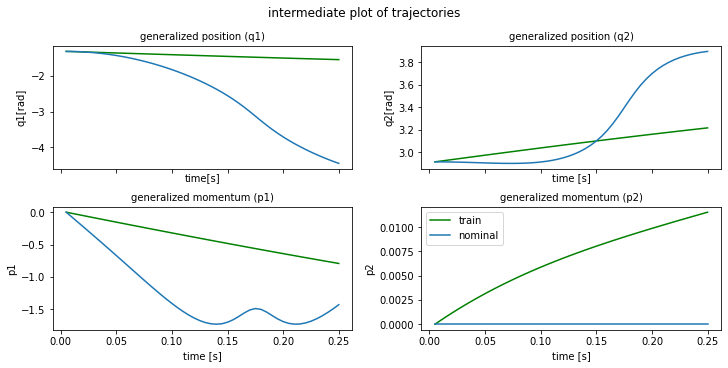

plot time : 1.1663224697113037
epoch   10 | train time 1.96 | train loss 6.508125e-01 | test loss 6.002992e-01 | test time 0.21  
epoch   11 | train time 0.78 | train loss 5.801208e-01 
epoch   12 | train time 0.77 | train loss 5.125967e-01 
epoch   13 | train time 0.77 | train loss 4.533556e-01 
epoch   14 | train time 0.78 | train loss 4.059539e-01 
epoch   15 | train time 0.78 | train loss 3.713540e-01 
epoch   16 | train time 0.78 | train loss 3.467763e-01 
epoch   17 | train time 0.79 | train loss 3.252403e-01 
epoch   18 | train time 0.78 | train loss 3.008292e-01 
epoch   19 | train time 0.78 | train loss 2.746392e-01 


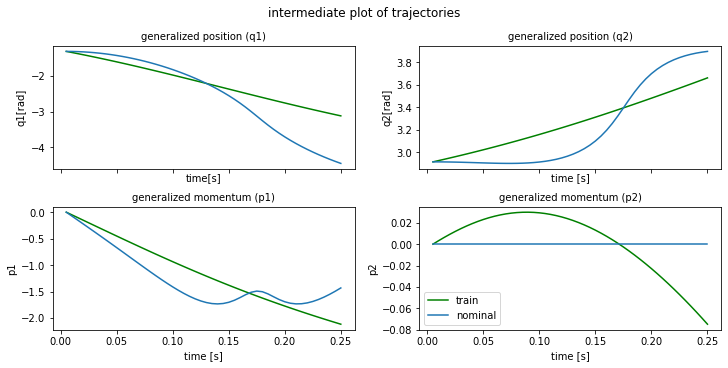

plot time : 1.234450340270996
epoch   20 | train time 2.05 | train loss 2.528495e-01 | test loss 3.164818e-01 | test time 0.20  
epoch   21 | train time 0.78 | train loss 2.334604e-01 
epoch   22 | train time 0.80 | train loss 2.103028e-01 
epoch   23 | train time 0.91 | train loss 1.873935e-01 
epoch   24 | train time 0.79 | train loss 1.657936e-01 
epoch   25 | train time 0.86 | train loss 1.439415e-01 
epoch   26 | train time 0.82 | train loss 1.294347e-01 
epoch   27 | train time 0.79 | train loss 1.211011e-01 
epoch   28 | train time 0.78 | train loss 1.122484e-01 
epoch   29 | train time 0.78 | train loss 1.050132e-01 


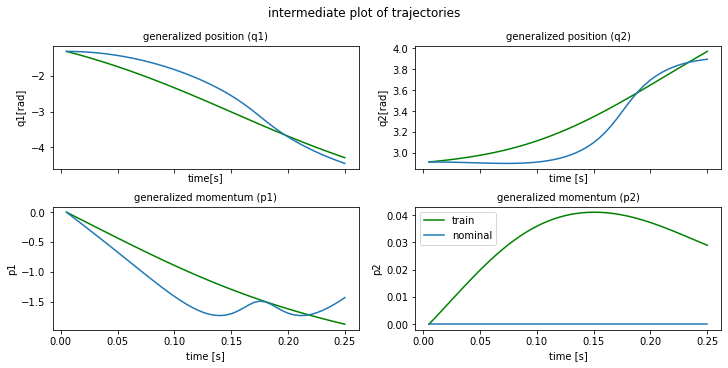

plot time : 1.1794333457946777
epoch   30 | train time 2.07 | train loss 9.652518e-02 | test loss 9.283765e-02 | test time 0.23  
epoch   31 | train time 0.92 | train loss 9.124350e-02 
epoch   32 | train time 0.78 | train loss 8.761394e-02 
epoch   33 | train time 0.82 | train loss 8.457381e-02 
epoch   34 | train time 0.78 | train loss 8.351652e-02 
epoch   35 | train time 0.79 | train loss 7.993313e-02 
epoch   36 | train time 0.78 | train loss 7.671595e-02 
epoch   37 | train time 0.79 | train loss 7.393998e-02 
epoch   38 | train time 0.78 | train loss 7.105678e-02 
epoch   39 | train time 0.89 | train loss 6.806540e-02 


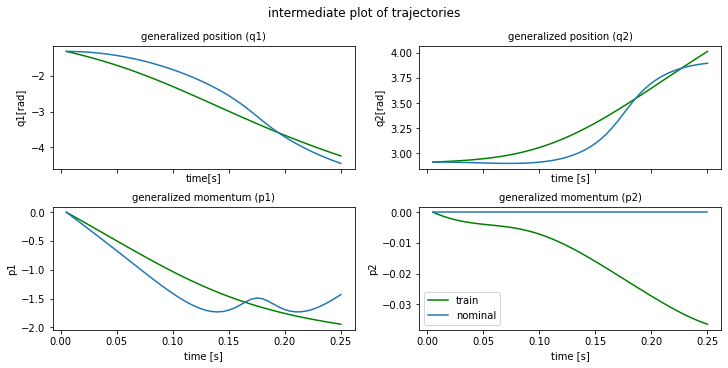

plot time : 1.153214693069458
epoch   40 | train time 2.02 | train loss 6.411105e-02 | test loss 6.099640e-02 | test time 0.21  
epoch   41 | train time 0.78 | train loss 5.902865e-02 
epoch   42 | train time 0.77 | train loss 5.559463e-02 
epoch   43 | train time 0.81 | train loss 5.259303e-02 
epoch   44 | train time 0.79 | train loss 4.998704e-02 
epoch   45 | train time 0.92 | train loss 4.679521e-02 
epoch   46 | train time 0.83 | train loss 4.374824e-02 
epoch   47 | train time 0.79 | train loss 4.155079e-02 
epoch   48 | train time 0.82 | train loss 3.906687e-02 
epoch   49 | train time 0.78 | train loss 3.579322e-02 


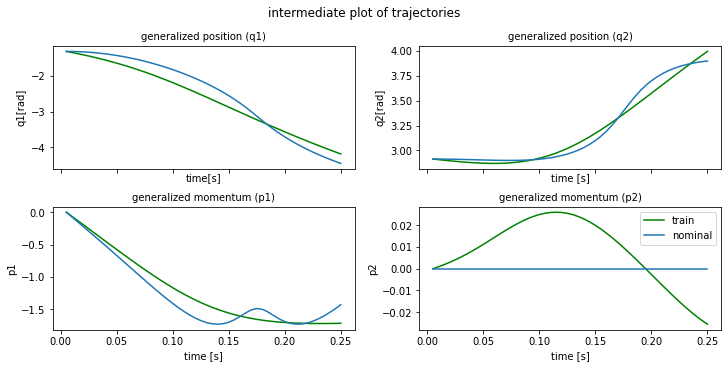

plot time : 1.2134394645690918
epoch   50 | train time 2.02 | train loss 3.288719e-02 | test loss 3.542282e-02 | test time 0.21  
epoch   51 | train time 0.78 | train loss 3.071409e-02 
epoch   52 | train time 0.91 | train loss 2.906711e-02 
epoch   53 | train time 0.91 | train loss 2.728220e-02 
epoch   54 | train time 0.81 | train loss 2.600388e-02 
epoch   55 | train time 0.79 | train loss 2.704668e-02 
epoch   56 | train time 0.77 | train loss 3.379844e-02 
epoch   57 | train time 0.78 | train loss 2.786395e-02 
epoch   58 | train time 0.93 | train loss 2.113843e-02 
epoch   59 | train time 0.80 | train loss 2.393124e-02 


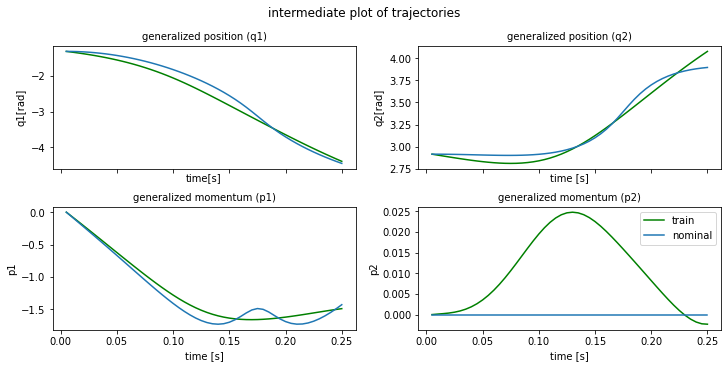

plot time : 1.1648259162902832
epoch   60 | train time 2.03 | train loss 1.933919e-02 | test loss 2.556052e-02 | test time 0.22  
epoch   61 | train time 0.88 | train loss 2.024665e-02 
epoch   62 | train time 0.77 | train loss 2.014942e-02 
epoch   63 | train time 0.80 | train loss 1.596344e-02 
epoch   64 | train time 0.80 | train loss 1.935508e-02 
epoch   65 | train time 0.78 | train loss 1.579470e-02 
epoch   66 | train time 0.92 | train loss 1.649145e-02 
epoch   67 | train time 0.79 | train loss 1.494797e-02 
epoch   68 | train time 0.79 | train loss 1.516767e-02 
epoch   69 | train time 0.90 | train loss 1.413291e-02 


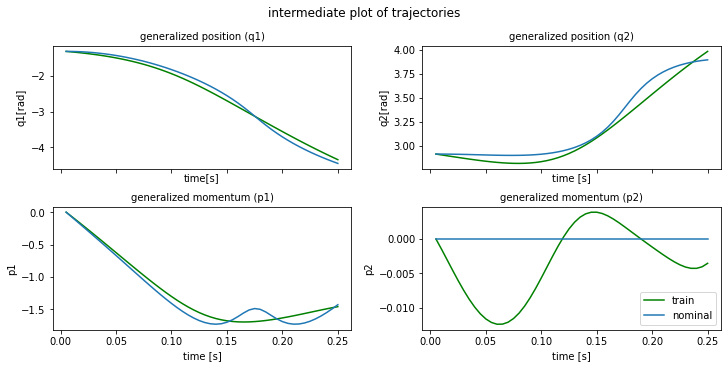

plot time : 1.1479060649871826
epoch   70 | train time 2.00 | train loss 1.346700e-02 | test loss 1.752558e-02 | test time 0.28  
epoch   71 | train time 0.85 | train loss 1.407243e-02 
epoch   72 | train time 0.79 | train loss 1.192285e-02 
epoch   73 | train time 0.77 | train loss 1.320192e-02 
epoch   74 | train time 0.78 | train loss 1.128987e-02 
epoch   75 | train time 0.78 | train loss 1.186952e-02 
epoch   76 | train time 0.78 | train loss 1.119190e-02 
epoch   77 | train time 0.81 | train loss 1.057268e-02 
epoch   78 | train time 0.91 | train loss 1.099216e-02 
epoch   79 | train time 0.79 | train loss 9.872358e-03 


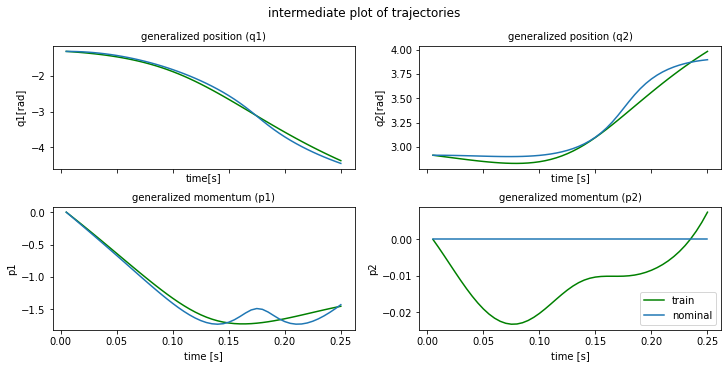

plot time : 1.2249727249145508
epoch   80 | train time 2.03 | train loss 1.017064e-02 | test loss 1.271672e-02 | test time 0.21  
epoch   81 | train time 0.78 | train loss 9.786898e-03 
epoch   82 | train time 0.78 | train loss 9.185735e-03 
epoch   83 | train time 0.84 | train loss 9.516590e-03 
epoch   84 | train time 0.95 | train loss 8.973382e-03 
epoch   85 | train time 0.88 | train loss 8.653055e-03 
epoch   86 | train time 0.78 | train loss 8.918134e-03 
epoch   87 | train time 0.96 | train loss 8.445812e-03 
epoch   88 | train time 0.91 | train loss 8.048494e-03 
epoch   89 | train time 0.81 | train loss 8.269482e-03 


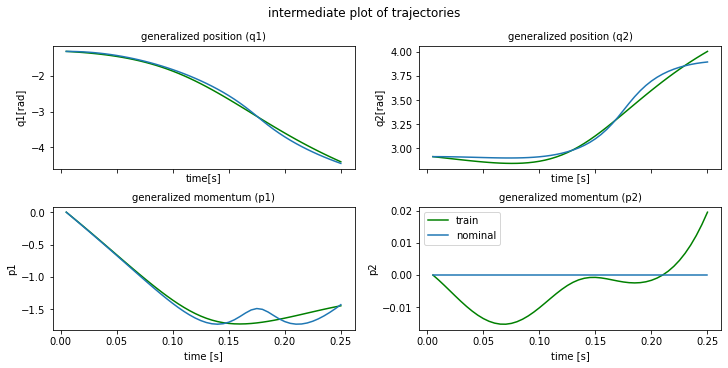

plot time : 1.2024333477020264
epoch   90 | train time 2.06 | train loss 8.068679e-03 | test loss 9.854341e-03 | test time 0.24  
epoch   91 | train time 0.91 | train loss 7.576533e-03 
epoch   92 | train time 0.78 | train loss 7.572884e-03 
epoch   93 | train time 0.78 | train loss 7.655428e-03 
epoch   94 | train time 0.80 | train loss 7.368893e-03 
epoch   95 | train time 0.83 | train loss 7.064168e-03 
epoch   96 | train time 0.89 | train loss 7.021096e-03 
epoch   97 | train time 0.95 | train loss 7.015724e-03 
epoch   98 | train time 0.93 | train loss 6.866455e-03 
epoch   99 | train time 0.87 | train loss 6.655659e-03 


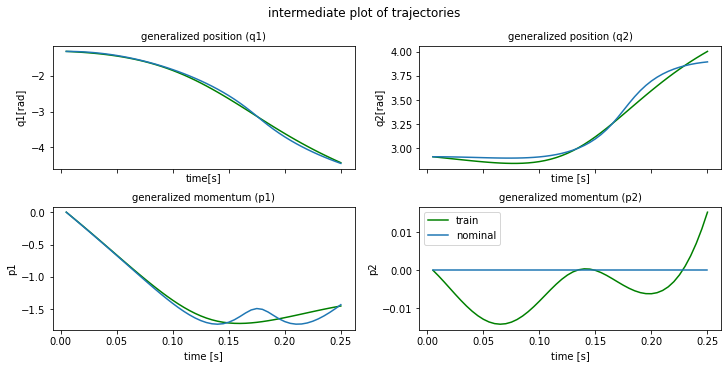

plot time : 1.1492595672607422
epoch  100 | train time 1.95 | train loss 6.470565e-03 | test loss 8.343562e-03 | test time 0.20  
epoch  101 | train time 0.78 | train loss 6.412273e-03 
epoch  102 | train time 0.76 | train loss 6.432163e-03 
epoch  103 | train time 0.88 | train loss 6.363915e-03 
epoch  104 | train time 0.86 | train loss 6.202745e-03 
epoch  105 | train time 0.78 | train loss 6.031074e-03 
epoch  106 | train time 0.78 | train loss 5.904144e-03 
epoch  107 | train time 0.79 | train loss 5.791629e-03 
epoch  108 | train time 0.78 | train loss 5.688460e-03 
epoch  109 | train time 0.82 | train loss 5.619176e-03 


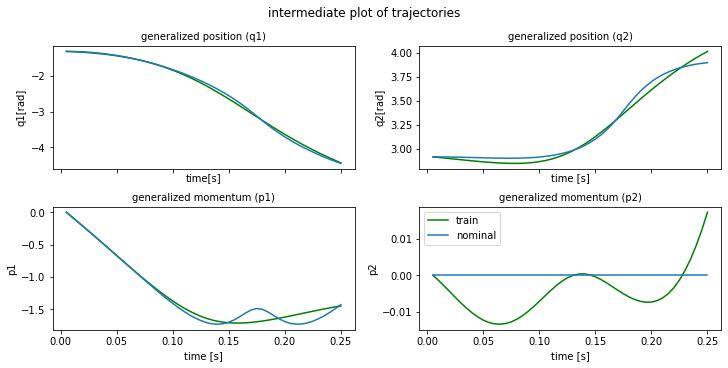

plot time : 1.2740623950958252
epoch  110 | train time 2.09 | train loss 5.594872e-03 | test loss 7.147565e-03 | test time 0.21  
epoch  111 | train time 0.80 | train loss 5.632437e-03 
epoch  112 | train time 0.79 | train loss 5.817703e-03 
epoch  113 | train time 0.78 | train loss 6.504995e-03 
epoch  114 | train time 0.90 | train loss 8.090371e-03 
epoch  115 | train time 0.79 | train loss 1.135877e-02 
epoch  116 | train time 0.80 | train loss 9.865314e-03 
epoch  117 | train time 0.81 | train loss 6.334552e-03 
epoch  118 | train time 0.80 | train loss 5.804946e-03 
epoch  119 | train time 0.93 | train loss 7.858657e-03 


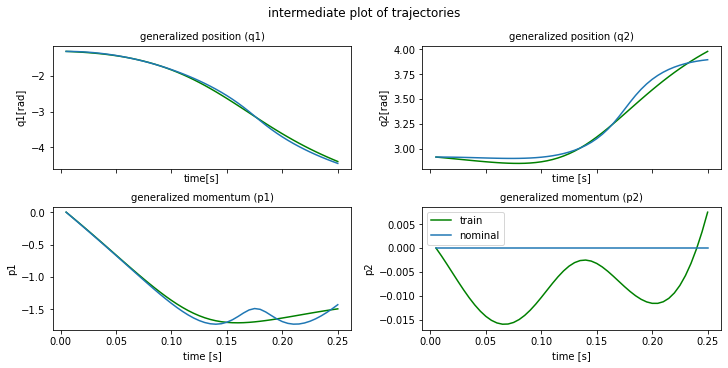

plot time : 1.199514627456665
epoch  120 | train time 2.06 | train loss 6.669066e-03 | test loss 7.069092e-03 | test time 0.27  
epoch  121 | train time 0.91 | train loss 5.722697e-03 
epoch  122 | train time 0.77 | train loss 7.223625e-03 
epoch  123 | train time 0.81 | train loss 5.730733e-03 
epoch  124 | train time 0.81 | train loss 5.797927e-03 
epoch  125 | train time 0.84 | train loss 6.680631e-03 
epoch  126 | train time 0.89 | train loss 5.000622e-03 
epoch  127 | train time 0.78 | train loss 5.567658e-03 
epoch  128 | train time 0.79 | train loss 5.843259e-03 
epoch  129 | train time 0.85 | train loss 4.853481e-03 


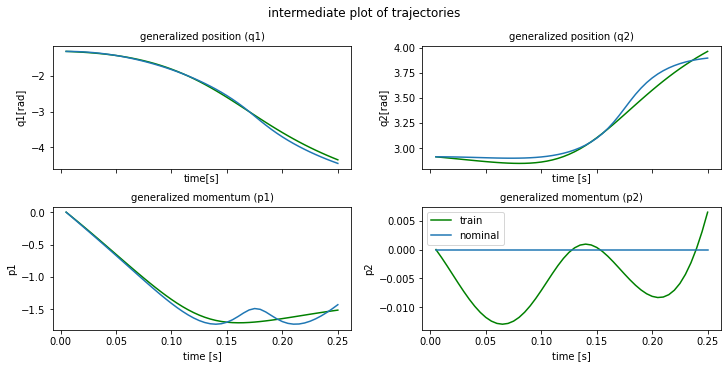

plot time : 1.2366185188293457
epoch  130 | train time 2.05 | train loss 5.330885e-03 | test loss 5.821560e-03 | test time 0.21  
epoch  131 | train time 0.79 | train loss 5.118765e-03 
epoch  132 | train time 0.79 | train loss 4.532924e-03 
epoch  133 | train time 0.78 | train loss 5.039408e-03 
epoch  134 | train time 0.78 | train loss 4.927855e-03 
epoch  135 | train time 0.80 | train loss 4.387748e-03 
epoch  136 | train time 0.79 | train loss 4.414433e-03 
epoch  137 | train time 0.78 | train loss 4.699984e-03 
epoch  138 | train time 0.77 | train loss 4.474762e-03 
epoch  139 | train time 0.78 | train loss 4.224303e-03 


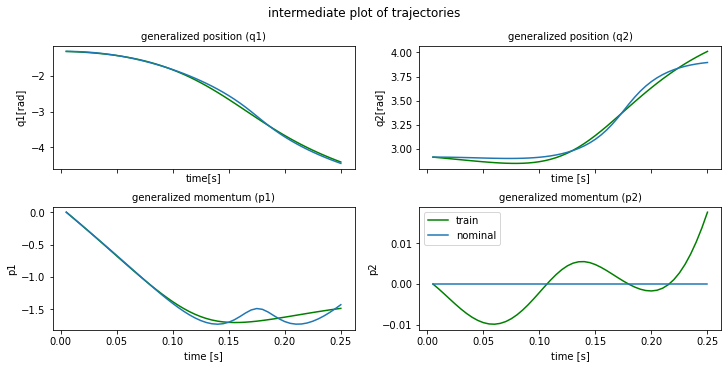

plot time : 1.2766075134277344
epoch  140 | train time 2.09 | train loss 4.405930e-03 | test loss 5.724450e-03 | test time 0.26  
epoch  141 | train time 0.81 | train loss 4.605533e-03 
epoch  142 | train time 0.81 | train loss 4.473513e-03 
epoch  143 | train time 0.91 | train loss 4.273578e-03 
epoch  144 | train time 0.79 | train loss 4.338378e-03 
epoch  145 | train time 0.78 | train loss 4.536662e-03 
epoch  146 | train time 0.79 | train loss 4.624567e-03 
epoch  147 | train time 0.79 | train loss 4.504371e-03 
epoch  148 | train time 0.92 | train loss 4.472592e-03 
epoch  149 | train time 0.81 | train loss 4.511213e-03 


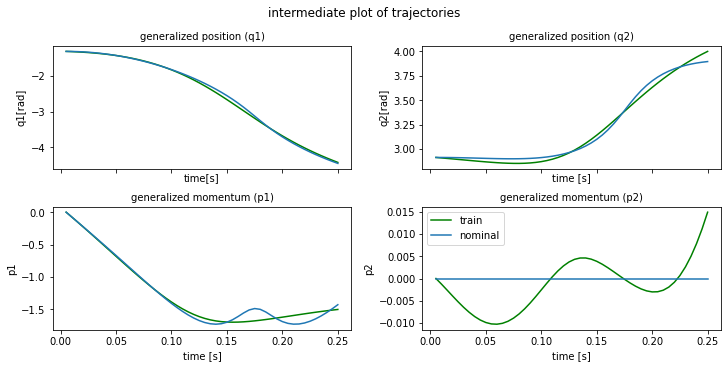

plot time : 1.1673836708068848
epoch  150 | train time 1.98 | train loss 4.443367e-03 | test loss 5.330977e-03 | test time 0.22  
epoch  151 | train time 0.91 | train loss 4.106639e-03 
epoch  152 | train time 0.79 | train loss 3.825342e-03 
epoch  153 | train time 0.78 | train loss 3.778959e-03 
epoch  154 | train time 0.80 | train loss 3.867606e-03 
epoch  155 | train time 0.79 | train loss 3.915149e-03 
epoch  156 | train time 0.92 | train loss 3.909828e-03 
epoch  157 | train time 0.94 | train loss 3.945069e-03 
epoch  158 | train time 0.81 | train loss 3.980136e-03 
epoch  159 | train time 0.86 | train loss 3.974812e-03 


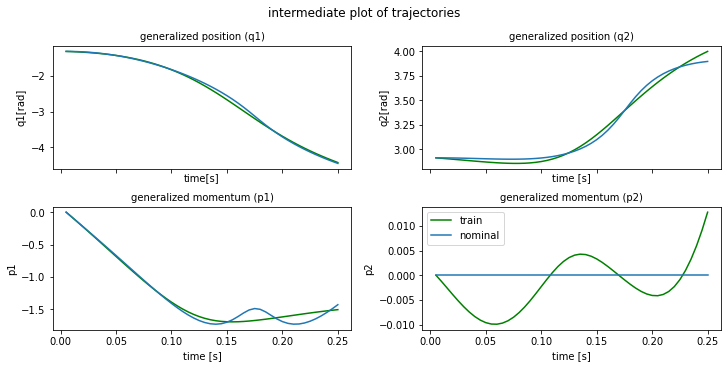

plot time : 1.1609249114990234
epoch  160 | train time 1.97 | train loss 3.852040e-03 | test loss 4.365259e-03 | test time 0.21  
epoch  161 | train time 0.79 | train loss 3.709174e-03 
epoch  162 | train time 0.80 | train loss 3.612164e-03 
epoch  163 | train time 0.80 | train loss 3.577328e-03 
epoch  164 | train time 0.78 | train loss 3.568335e-03 
epoch  165 | train time 0.78 | train loss 3.551727e-03 
epoch  166 | train time 0.79 | train loss 3.516404e-03 
epoch  167 | train time 0.78 | train loss 3.472901e-03 
epoch  168 | train time 0.80 | train loss 3.438353e-03 
epoch  169 | train time 0.78 | train loss 3.419771e-03 


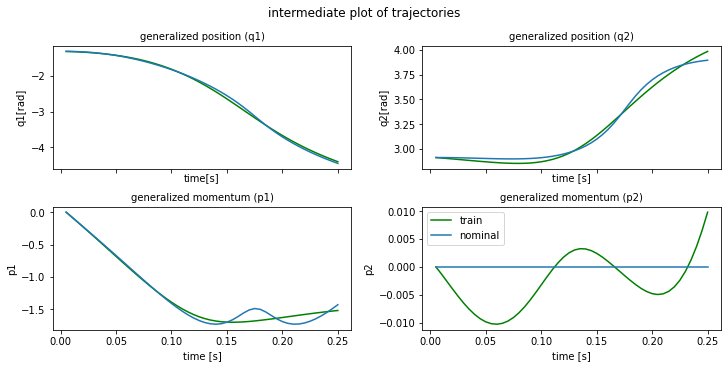

plot time : 1.3161301612854004
epoch  170 | train time 2.25 | train loss 3.430394e-03 | test loss 4.428911e-03 | test time 0.22  
epoch  171 | train time 0.82 | train loss 3.489746e-03 
epoch  172 | train time 0.77 | train loss 3.655988e-03 
epoch  173 | train time 0.78 | train loss 4.066831e-03 
epoch  174 | train time 0.81 | train loss 4.985412e-03 
epoch  175 | train time 0.78 | train loss 6.604658e-03 
epoch  176 | train time 0.78 | train loss 7.917328e-03 
epoch  177 | train time 0.92 | train loss 6.821217e-03 
epoch  178 | train time 0.79 | train loss 5.144493e-03 
epoch  179 | train time 0.78 | train loss 5.420504e-03 


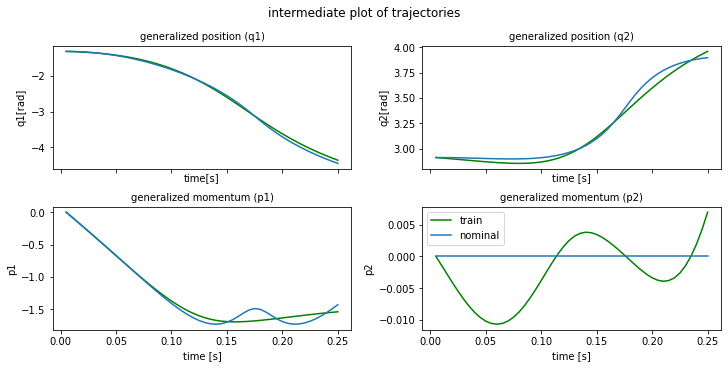

plot time : 1.226940631866455
epoch  180 | train time 2.04 | train loss 5.511519e-03 | test loss 4.571800e-03 | test time 0.21  
epoch  181 | train time 0.86 | train loss 3.881649e-03 
epoch  182 | train time 0.82 | train loss 4.301055e-03 
epoch  183 | train time 0.78 | train loss 5.282932e-03 
epoch  184 | train time 0.80 | train loss 3.874842e-03 
epoch  185 | train time 0.78 | train loss 3.736638e-03 
epoch  186 | train time 0.79 | train loss 4.701473e-03 
epoch  187 | train time 0.79 | train loss 3.883495e-03 
epoch  188 | train time 0.80 | train loss 3.620121e-03 
epoch  189 | train time 0.97 | train loss 4.153206e-03 


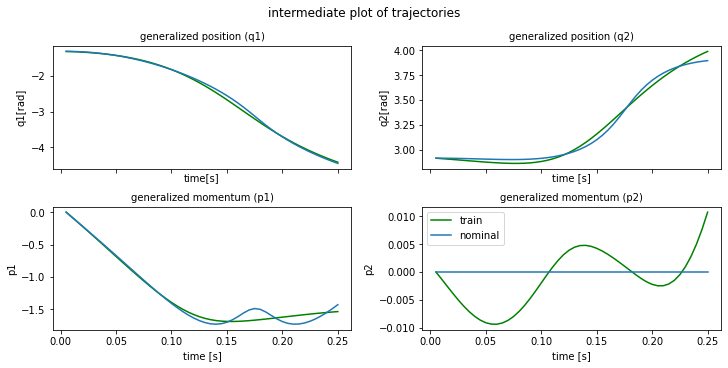

plot time : 1.1462090015411377
epoch  190 | train time 1.96 | train loss 3.621839e-03 | test loss 4.182371e-03 | test time 0.21  
epoch  191 | train time 0.80 | train loss 3.668941e-03 
epoch  192 | train time 0.81 | train loss 3.823498e-03 
epoch  193 | train time 0.83 | train loss 3.294021e-03 
epoch  194 | train time 0.86 | train loss 3.504301e-03 
epoch  195 | train time 0.81 | train loss 3.732133e-03 
epoch  196 | train time 0.78 | train loss 3.238362e-03 
epoch  197 | train time 0.79 | train loss 3.227304e-03 
epoch  198 | train time 0.92 | train loss 3.403211e-03 
epoch  199 | train time 0.92 | train loss 3.250134e-03 
horizon length : 100
min max values updated


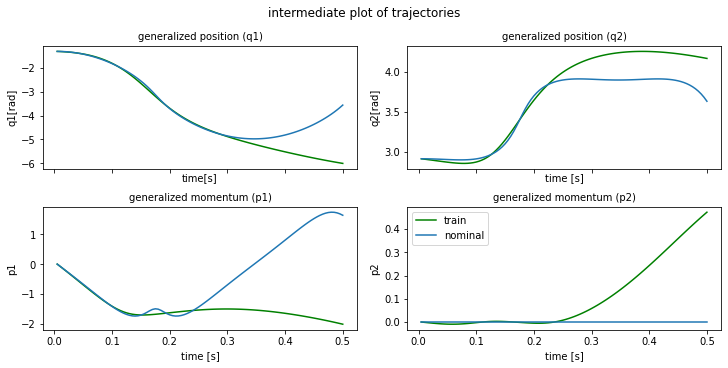

plot time : 1.283931016921997
min max values updated
epoch  200 | train time 2.89 | train loss 5.375845e-01 | test loss 2.678525e-01 | test time 0.45  
epoch  201 | train time 1.84 | train loss 2.779139e-01 
epoch  202 | train time 1.67 | train loss 2.118667e-01 
epoch  203 | train time 1.67 | train loss 1.456858e-01 
epoch  204 | train time 1.66 | train loss 1.383789e-01 
epoch  205 | train time 1.68 | train loss 1.590239e-01 
epoch  206 | train time 1.55 | train loss 1.027519e-01 
epoch  207 | train time 1.57 | train loss 8.901976e-02 
epoch  208 | train time 1.61 | train loss 1.081338e-01 
epoch  209 | train time 1.72 | train loss 1.017324e-01 


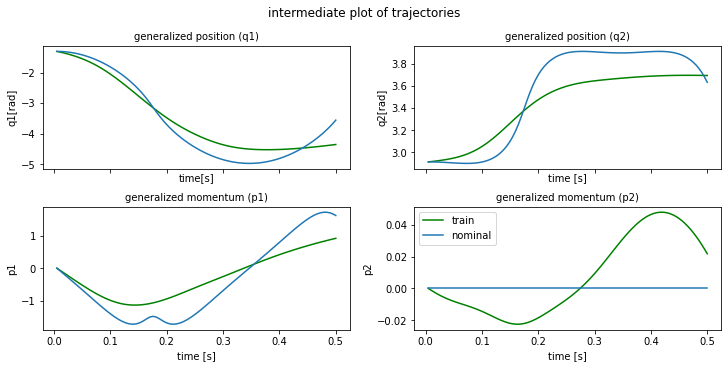

plot time : 1.1485779285430908
epoch  210 | train time 2.89 | train loss 7.474416e-02 | test loss 7.816922e-02 | test time 0.41  
epoch  211 | train time 1.56 | train loss 6.602025e-02 
epoch  212 | train time 1.68 | train loss 7.173419e-02 
epoch  213 | train time 1.61 | train loss 6.635299e-02 
epoch  214 | train time 1.73 | train loss 5.785865e-02 
epoch  215 | train time 1.56 | train loss 4.677696e-02 
epoch  216 | train time 1.54 | train loss 4.779465e-02 
epoch  217 | train time 1.55 | train loss 4.207087e-02 
epoch  218 | train time 1.68 | train loss 3.590559e-02 
epoch  219 | train time 1.60 | train loss 3.587639e-02 


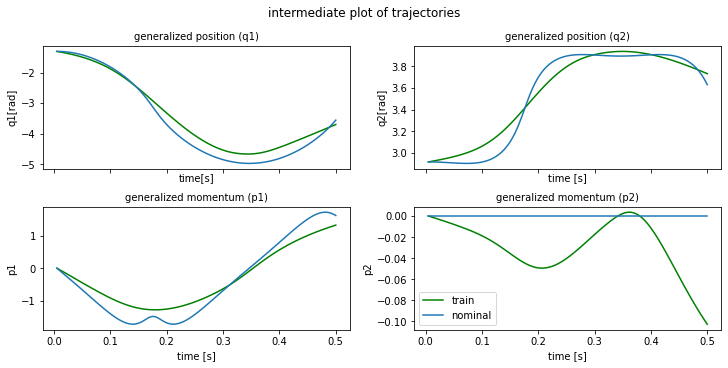

plot time : 1.1650843620300293
epoch  220 | train time 3.03 | train loss 3.391153e-02 | test loss 4.252058e-02 | test time 0.80  
epoch  221 | train time 2.25 | train loss 3.076865e-02 
epoch  222 | train time 1.80 | train loss 2.551585e-02 
epoch  223 | train time 1.54 | train loss 2.502213e-02 
epoch  224 | train time 1.72 | train loss 2.710298e-02 
epoch  225 | train time 1.54 | train loss 2.296958e-02 
epoch  226 | train time 1.70 | train loss 2.071706e-02 
epoch  227 | train time 1.75 | train loss 1.973270e-02 
epoch  228 | train time 1.55 | train loss 1.834979e-02 
epoch  229 | train time 1.56 | train loss 1.844823e-02 


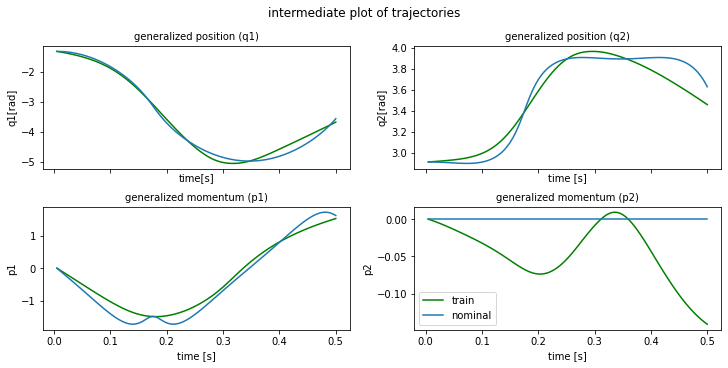

plot time : 1.246324062347412
epoch  230 | train time 2.94 | train loss 1.706889e-02 | test loss 2.538049e-02 | test time 0.54  
epoch  231 | train time 1.71 | train loss 1.765108e-02 
epoch  232 | train time 1.54 | train loss 1.674963e-02 
epoch  233 | train time 1.55 | train loss 1.455058e-02 
epoch  234 | train time 1.64 | train loss 1.488019e-02 
epoch  235 | train time 1.55 | train loss 1.428074e-02 
epoch  236 | train time 1.58 | train loss 1.421775e-02 
epoch  237 | train time 1.65 | train loss 1.280521e-02 
epoch  238 | train time 1.61 | train loss 1.208070e-02 
epoch  239 | train time 1.66 | train loss 1.217428e-02 


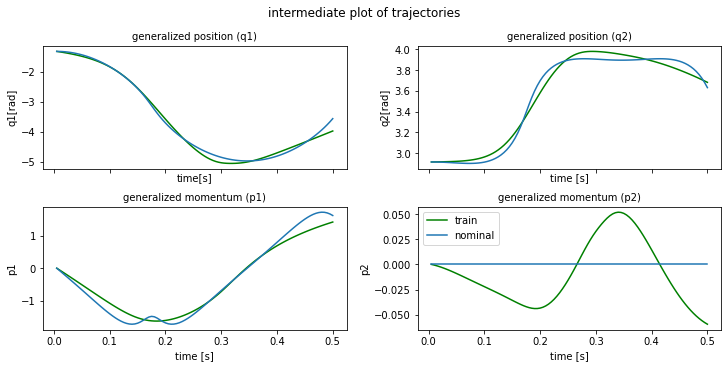

plot time : 1.1912124156951904
epoch  240 | train time 2.88 | train loss 1.123543e-02 | test loss 1.580095e-02 | test time 0.41  
epoch  241 | train time 1.75 | train loss 1.096465e-02 
epoch  242 | train time 1.62 | train loss 1.056907e-02 
epoch  243 | train time 1.55 | train loss 1.012510e-02 
epoch  244 | train time 1.63 | train loss 9.456349e-03 
epoch  245 | train time 1.54 | train loss 9.226604e-03 
epoch  246 | train time 1.53 | train loss 9.332280e-03 
epoch  247 | train time 1.58 | train loss 8.646498e-03 
epoch  248 | train time 1.56 | train loss 8.419301e-03 
epoch  249 | train time 1.55 | train loss 8.243545e-03 


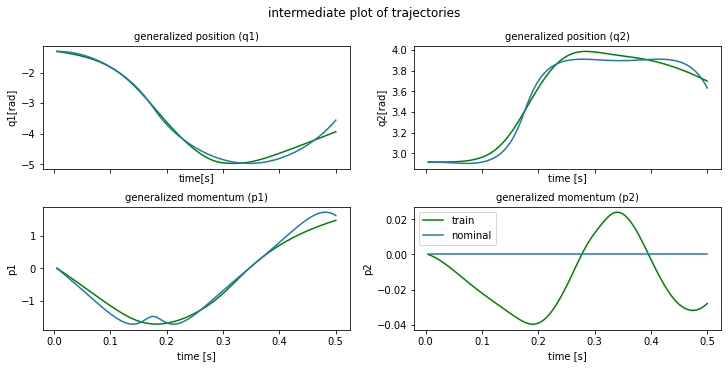

plot time : 1.1597700119018555
epoch  250 | train time 2.73 | train loss 8.072480e-03 | test loss 1.196869e-02 | test time 0.41  
epoch  251 | train time 1.65 | train loss 7.746101e-03 
epoch  252 | train time 1.57 | train loss 7.637872e-03 
epoch  253 | train time 1.56 | train loss 7.451676e-03 
epoch  254 | train time 1.62 | train loss 7.050048e-03 
epoch  255 | train time 1.56 | train loss 7.022898e-03 
epoch  256 | train time 1.55 | train loss 6.964162e-03 
epoch  257 | train time 1.55 | train loss 6.748708e-03 
epoch  258 | train time 1.80 | train loss 6.574544e-03 
epoch  259 | train time 1.59 | train loss 6.448542e-03 


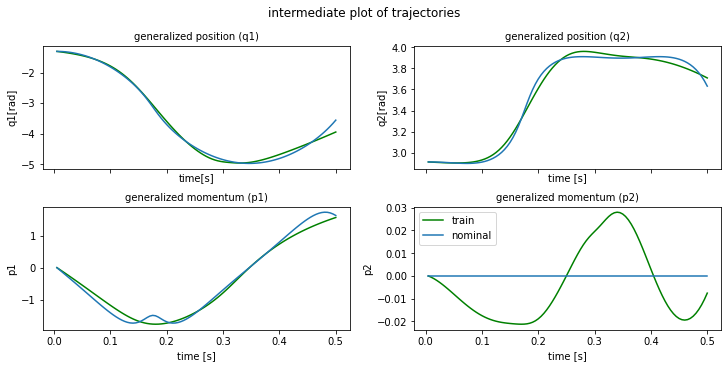

plot time : 1.2093565464019775
epoch  260 | train time 2.86 | train loss 6.304022e-03 | test loss 9.489119e-03 | test time 0.55  
epoch  261 | train time 1.80 | train loss 6.122351e-03 
epoch  262 | train time 1.72 | train loss 6.078544e-03 
epoch  263 | train time 1.53 | train loss 5.864468e-03 
epoch  264 | train time 1.63 | train loss 5.759083e-03 
epoch  265 | train time 1.72 | train loss 5.669724e-03 
epoch  266 | train time 1.64 | train loss 5.599471e-03 
epoch  267 | train time 1.59 | train loss 5.438549e-03 
epoch  268 | train time 1.54 | train loss 5.373029e-03 
epoch  269 | train time 1.66 | train loss 5.264367e-03 


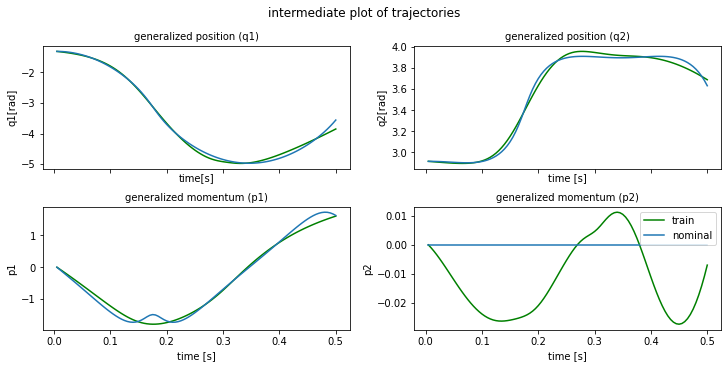

plot time : 1.157778263092041
epoch  270 | train time 2.74 | train loss 5.180808e-03 | test loss 8.254148e-03 | test time 0.41  
epoch  271 | train time 1.56 | train loss 5.106848e-03 
epoch  272 | train time 1.55 | train loss 5.025415e-03 
epoch  273 | train time 1.69 | train loss 4.935288e-03 
epoch  274 | train time 1.63 | train loss 4.868896e-03 
epoch  275 | train time 1.54 | train loss 4.807202e-03 
epoch  276 | train time 1.68 | train loss 4.721006e-03 
epoch  277 | train time 1.72 | train loss 4.661731e-03 
epoch  278 | train time 1.55 | train loss 4.593153e-03 
epoch  279 | train time 1.78 | train loss 4.538267e-03 


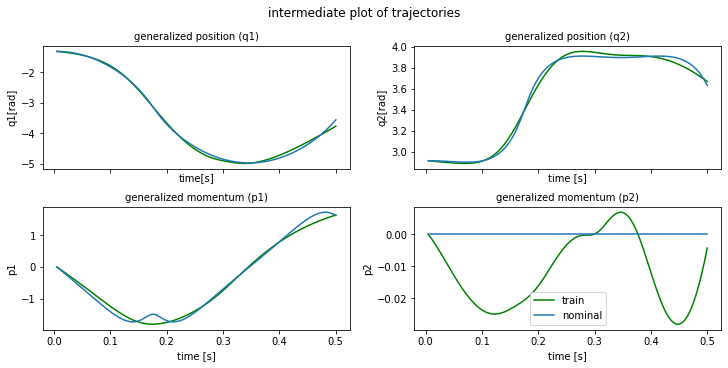

plot time : 1.182662010192871
epoch  280 | train time 2.85 | train loss 4.479903e-03 | test loss 7.483448e-03 | test time 0.39  
epoch  281 | train time 1.67 | train loss 4.430029e-03 
epoch  282 | train time 1.74 | train loss 4.363456e-03 
epoch  283 | train time 1.55 | train loss 4.321846e-03 
epoch  284 | train time 1.71 | train loss 4.271367e-03 
epoch  285 | train time 1.58 | train loss 4.225553e-03 
epoch  286 | train time 1.58 | train loss 4.175437e-03 
epoch  287 | train time 1.58 | train loss 4.137686e-03 
epoch  288 | train time 1.55 | train loss 4.091958e-03 
epoch  289 | train time 1.56 | train loss 4.056589e-03 


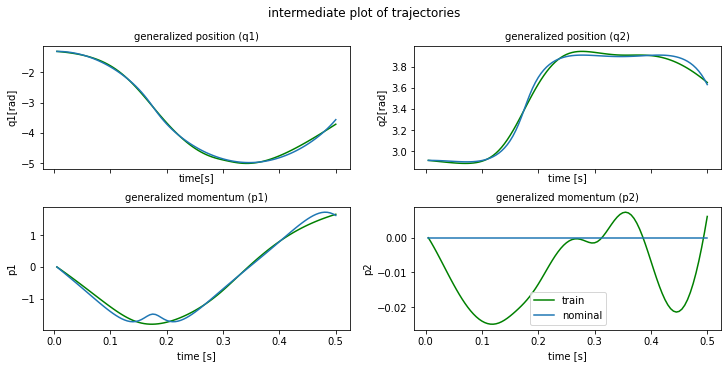

plot time : 1.1966981887817383
epoch  290 | train time 2.90 | train loss 4.015043e-03 | test loss 6.698086e-03 | test time 0.41  
epoch  291 | train time 1.54 | train loss 3.975709e-03 
epoch  292 | train time 1.54 | train loss 3.939978e-03 
epoch  293 | train time 1.80 | train loss 3.906943e-03 
epoch  294 | train time 1.74 | train loss 3.868952e-03 
epoch  295 | train time 1.67 | train loss 3.837899e-03 
epoch  296 | train time 1.54 | train loss 3.805754e-03 
epoch  297 | train time 1.56 | train loss 3.774932e-03 
epoch  298 | train time 1.68 | train loss 3.744617e-03 
epoch  299 | train time 1.63 | train loss 3.715289e-03 
horizon length : 150
min max values updated


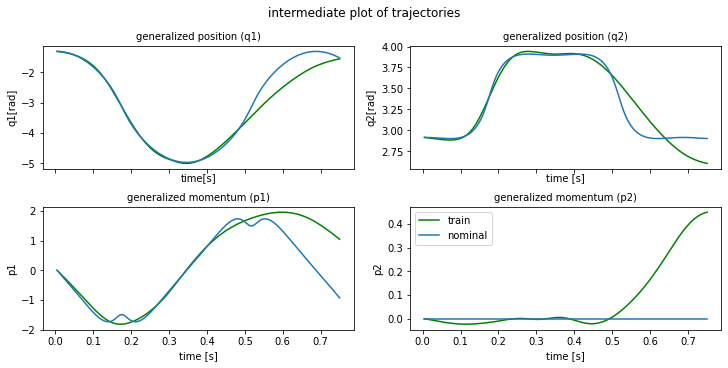

plot time : 1.2149326801300049
min max values updated
epoch  300 | train time 3.62 | train loss 1.228214e-01 | test loss 1.296471e-01 | test time 0.78  
epoch  301 | train time 2.68 | train loss 1.205707e-01 
epoch  302 | train time 2.55 | train loss 1.595438e-01 
epoch  303 | train time 2.38 | train loss 4.041999e-01 
epoch  304 | train time 2.42 | train loss 1.608278e-01 
epoch  305 | train time 2.32 | train loss 2.480984e-01 
epoch  306 | train time 2.44 | train loss 8.967514e-02 
epoch  307 | train time 2.46 | train loss 1.656450e-01 
epoch  308 | train time 2.57 | train loss 1.299670e-01 
epoch  309 | train time 2.51 | train loss 1.044870e-01 


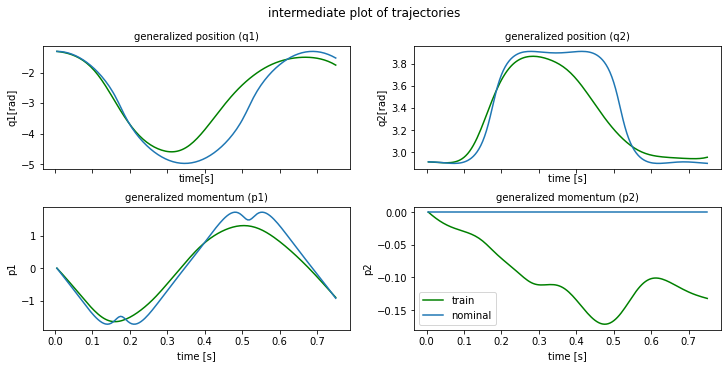

plot time : 1.2460284233093262
epoch  310 | train time 3.65 | train loss 1.110050e-01 | test loss 1.151682e-01 | test time 0.65  
epoch  311 | train time 2.36 | train loss 1.045027e-01 
epoch  312 | train time 2.60 | train loss 8.439443e-02 
epoch  313 | train time 2.46 | train loss 9.819663e-02 
epoch  314 | train time 2.49 | train loss 8.032385e-02 
epoch  315 | train time 2.39 | train loss 5.876035e-02 
epoch  316 | train time 2.35 | train loss 6.498048e-02 
epoch  317 | train time 2.35 | train loss 6.477492e-02 
epoch  318 | train time 3.46 | train loss 5.895977e-02 
epoch  319 | train time 2.37 | train loss 5.619495e-02 


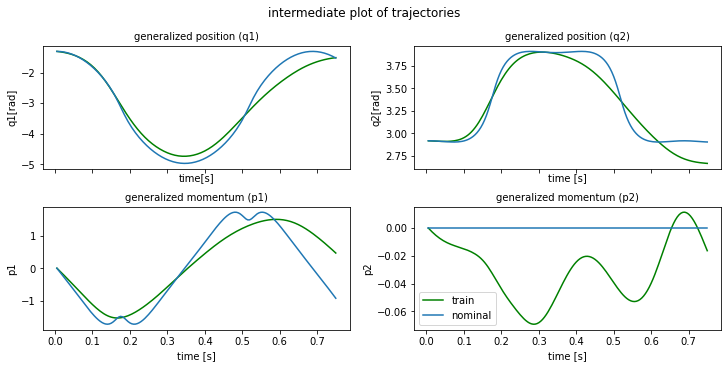

plot time : 1.188375473022461
epoch  320 | train time 3.65 | train loss 5.102454e-02 | test loss 5.226237e-02 | test time 0.60  
epoch  321 | train time 2.39 | train loss 4.096669e-02 
epoch  322 | train time 2.64 | train loss 3.905457e-02 
epoch  323 | train time 2.32 | train loss 4.328466e-02 
epoch  324 | train time 2.34 | train loss 3.841953e-02 
epoch  325 | train time 2.52 | train loss 3.158109e-02 
epoch  326 | train time 2.39 | train loss 3.414894e-02 
epoch  327 | train time 2.55 | train loss 3.322778e-02 
epoch  328 | train time 2.44 | train loss 3.168697e-02 
epoch  329 | train time 2.30 | train loss 2.727786e-02 


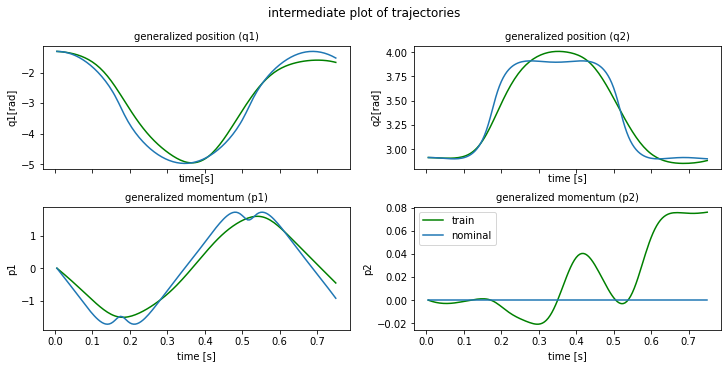

plot time : 1.2567918300628662
epoch  330 | train time 3.79 | train loss 2.440395e-02 | test loss 4.091366e-02 | test time 0.61  
epoch  331 | train time 2.37 | train loss 2.730308e-02 
epoch  332 | train time 2.31 | train loss 2.523015e-02 
epoch  333 | train time 2.44 | train loss 2.222859e-02 
epoch  334 | train time 2.34 | train loss 2.204566e-02 
epoch  335 | train time 2.34 | train loss 2.082984e-02 
epoch  336 | train time 2.51 | train loss 1.955835e-02 
epoch  337 | train time 2.34 | train loss 1.822758e-02 
epoch  338 | train time 2.33 | train loss 1.669193e-02 
epoch  339 | train time 2.32 | train loss 1.716745e-02 


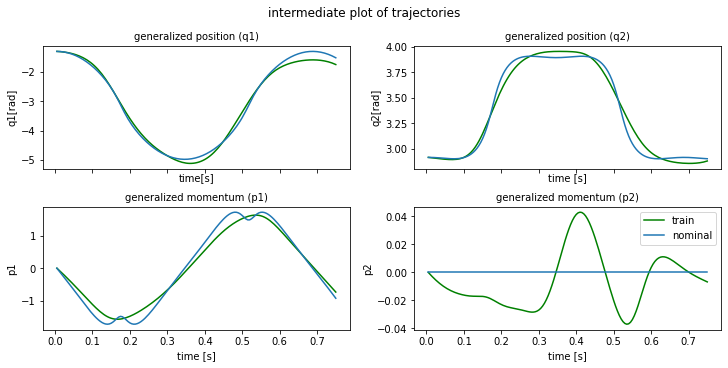

plot time : 1.255105972290039
epoch  340 | train time 3.75 | train loss 1.597244e-02 | test loss 2.070625e-02 | test time 0.75  
epoch  341 | train time 2.36 | train loss 1.520440e-02 
epoch  342 | train time 2.50 | train loss 1.562133e-02 
epoch  343 | train time 2.32 | train loss 1.473415e-02 
epoch  344 | train time 2.31 | train loss 1.402711e-02 
epoch  345 | train time 2.45 | train loss 1.311061e-02 
epoch  346 | train time 2.38 | train loss 1.314054e-02 
epoch  347 | train time 2.32 | train loss 1.309175e-02 
epoch  348 | train time 2.35 | train loss 1.217315e-02 
epoch  349 | train time 2.43 | train loss 1.196094e-02 


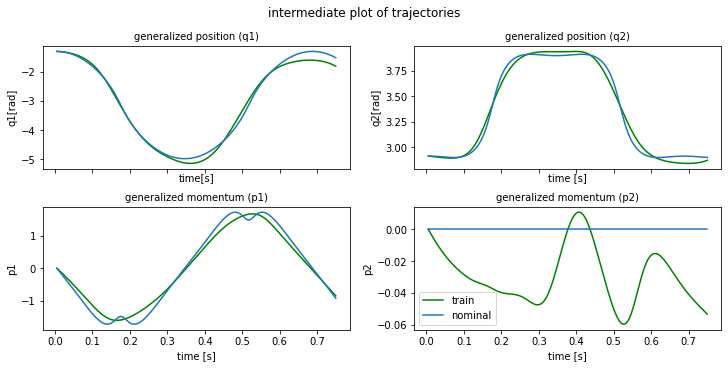

plot time : 1.171889066696167
epoch  350 | train time 3.73 | train loss 1.142466e-02 | test loss 1.777673e-02 | test time 0.67  
epoch  351 | train time 2.55 | train loss 1.106903e-02 
epoch  352 | train time 2.49 | train loss 1.092644e-02 
epoch  353 | train time 2.55 | train loss 1.048910e-02 
epoch  354 | train time 2.29 | train loss 1.045525e-02 
epoch  355 | train time 2.58 | train loss 1.003543e-02 
epoch  356 | train time 2.37 | train loss 9.926012e-03 
epoch  357 | train time 2.33 | train loss 9.645287e-03 
epoch  358 | train time 2.45 | train loss 9.208564e-03 
epoch  359 | train time 2.54 | train loss 9.187830e-03 


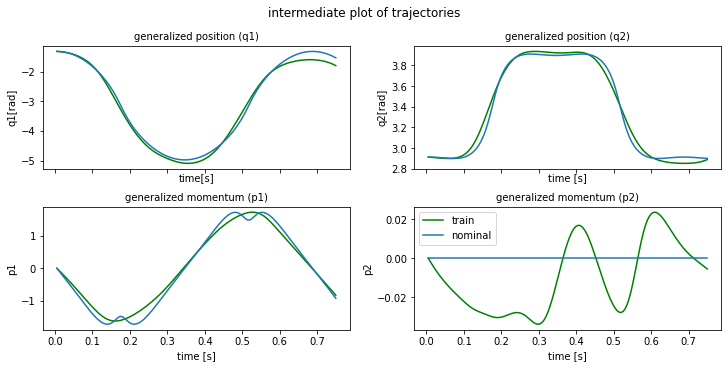

plot time : 1.1902756690979004
epoch  360 | train time 3.67 | train loss 8.978635e-03 | test loss 1.420889e-02 | test time 0.78  
epoch  361 | train time 2.57 | train loss 8.697531e-03 
epoch  362 | train time 2.50 | train loss 8.553779e-03 
epoch  363 | train time 2.48 | train loss 8.379384e-03 
epoch  364 | train time 2.34 | train loss 8.182220e-03 
epoch  365 | train time 2.52 | train loss 7.967148e-03 
epoch  366 | train time 2.47 | train loss 7.833106e-03 
epoch  367 | train time 2.35 | train loss 7.713402e-03 
epoch  368 | train time 2.33 | train loss 7.485257e-03 
epoch  369 | train time 2.32 | train loss 7.421337e-03 


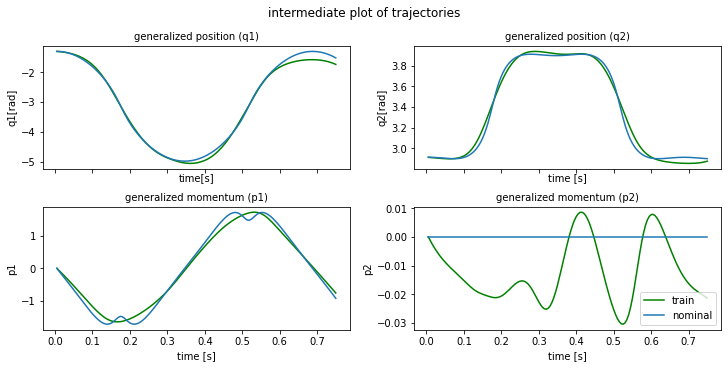

plot time : 1.2757229804992676
epoch  370 | train time 3.64 | train loss 7.292763e-03 | test loss 1.229871e-02 | test time 0.64  
epoch  371 | train time 2.51 | train loss 7.145240e-03 
epoch  372 | train time 2.33 | train loss 7.041778e-03 
epoch  373 | train time 2.54 | train loss 6.960579e-03 
epoch  374 | train time 2.39 | train loss 6.896873e-03 
epoch  375 | train time 2.55 | train loss 6.847508e-03 
epoch  376 | train time 2.56 | train loss 6.862683e-03 
epoch  377 | train time 2.55 | train loss 7.081372e-03 
epoch  378 | train time 2.47 | train loss 7.792629e-03 
epoch  379 | train time 2.38 | train loss 9.819393e-03 


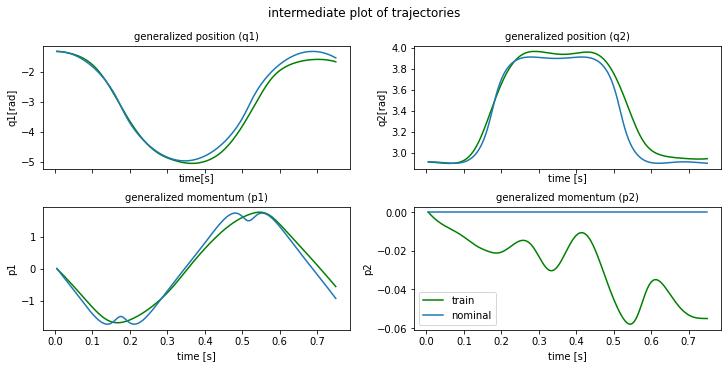

plot time : 1.2656466960906982
epoch  380 | train time 3.69 | train loss 1.433984e-02 | test loss 2.435742e-02 | test time 0.79  
epoch  381 | train time 2.62 | train loss 2.220879e-02 
epoch  382 | train time 2.31 | train loss 2.501090e-02 
epoch  383 | train time 2.39 | train loss 1.468218e-02 
epoch  384 | train time 2.68 | train loss 6.773531e-03 
epoch  385 | train time 2.45 | train loss 1.150641e-02 
epoch  386 | train time 2.45 | train loss 1.416190e-02 
epoch  387 | train time 2.35 | train loss 8.239538e-03 
epoch  388 | train time 2.35 | train loss 7.767697e-03 
epoch  389 | train time 3.43 | train loss 1.185532e-02 


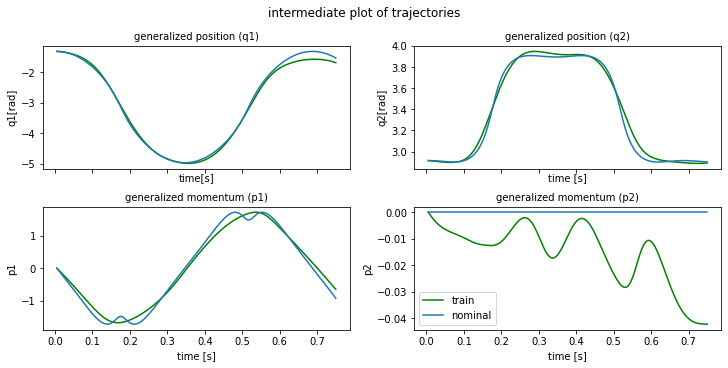

plot time : 1.218919277191162
epoch  390 | train time 3.93 | train loss 9.061278e-03 | test loss 9.817051e-03 | test time 0.80  
epoch  391 | train time 2.50 | train loss 6.505664e-03 
epoch  392 | train time 2.32 | train loss 1.027373e-02 
epoch  393 | train time 2.34 | train loss 8.453785e-03 
epoch  394 | train time 2.32 | train loss 6.150131e-03 
epoch  395 | train time 2.66 | train loss 9.529005e-03 
epoch  396 | train time 2.35 | train loss 7.227657e-03 
epoch  397 | train time 2.32 | train loss 6.342404e-03 
epoch  398 | train time 2.33 | train loss 8.462397e-03 
epoch  399 | train time 2.31 | train loss 6.283040e-03 
horizon length : 200
min max values updated


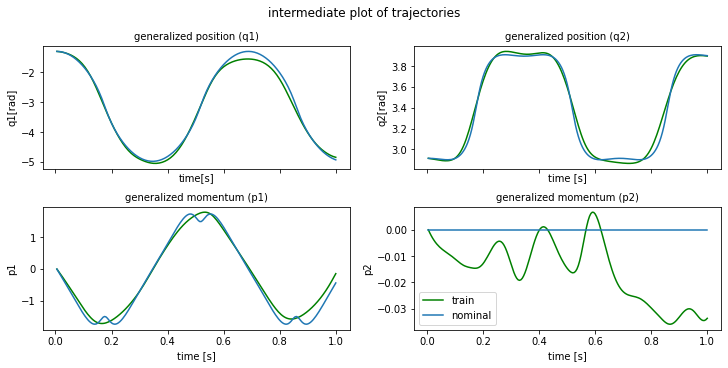

plot time : 1.1864452362060547
min max values updated
epoch  400 | train time 4.42 | train loss 1.624000e-02 | test loss 2.550692e-02 | test time 0.82  
epoch  401 | train time 3.17 | train loss 1.980823e-02 
epoch  402 | train time 3.12 | train loss 2.772783e-02 
epoch  403 | train time 3.24 | train loss 3.868737e-02 
epoch  404 | train time 3.37 | train loss 5.086641e-02 
epoch  405 | train time 3.19 | train loss 4.767150e-02 
epoch  406 | train time 3.21 | train loss 1.943745e-02 
epoch  407 | train time 3.37 | train loss 1.609736e-02 
epoch  408 | train time 3.28 | train loss 3.321254e-02 
epoch  409 | train time 3.25 | train loss 2.269767e-02 


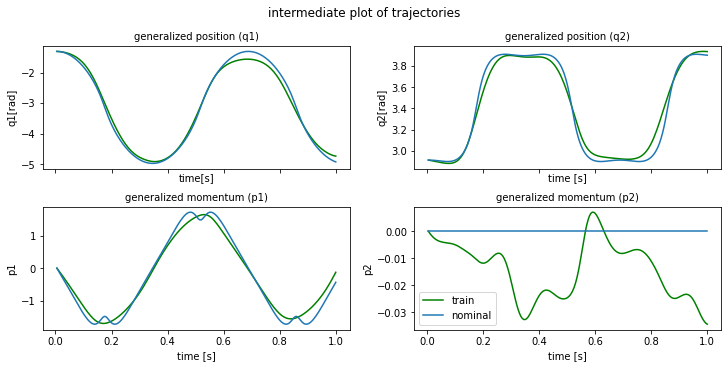

plot time : 1.2833867073059082
epoch  410 | train time 4.43 | train loss 1.360515e-02 | test loss 2.805483e-02 | test time 0.80  
epoch  411 | train time 3.08 | train loss 2.201920e-02 
epoch  412 | train time 3.11 | train loss 1.781644e-02 
epoch  413 | train time 3.09 | train loss 1.554982e-02 
epoch  414 | train time 3.20 | train loss 1.585140e-02 
epoch  415 | train time 3.45 | train loss 1.367492e-02 
epoch  416 | train time 3.23 | train loss 1.512306e-02 
epoch  417 | train time 3.21 | train loss 1.249625e-02 
epoch  418 | train time 3.70 | train loss 1.145727e-02 
epoch  419 | train time 5.23 | train loss 1.411140e-02 


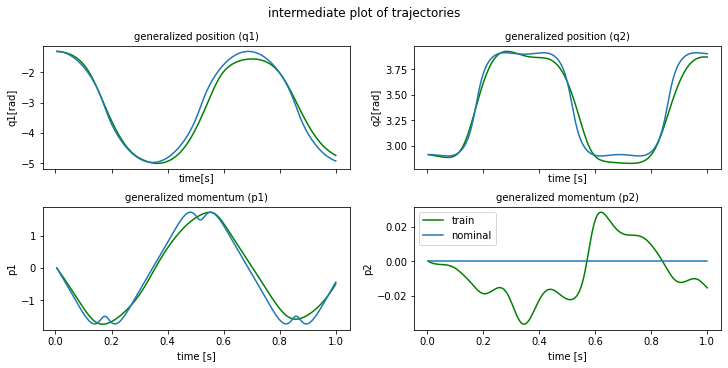

plot time : 1.9244880676269531
epoch  420 | train time 6.94 | train loss 1.065962e-02 | test loss 1.531614e-02 | test time 0.80  
epoch  421 | train time 3.12 | train loss 1.021042e-02 
epoch  422 | train time 3.23 | train loss 1.205359e-02 
epoch  423 | train time 3.40 | train loss 1.010527e-02 
epoch  424 | train time 3.12 | train loss 8.625291e-03 
epoch  425 | train time 3.22 | train loss 1.098472e-02 
epoch  426 | train time 3.34 | train loss 9.138292e-03 
epoch  427 | train time 3.13 | train loss 8.225582e-03 
epoch  428 | train time 3.12 | train loss 9.769166e-03 
epoch  429 | train time 3.24 | train loss 8.589919e-03 


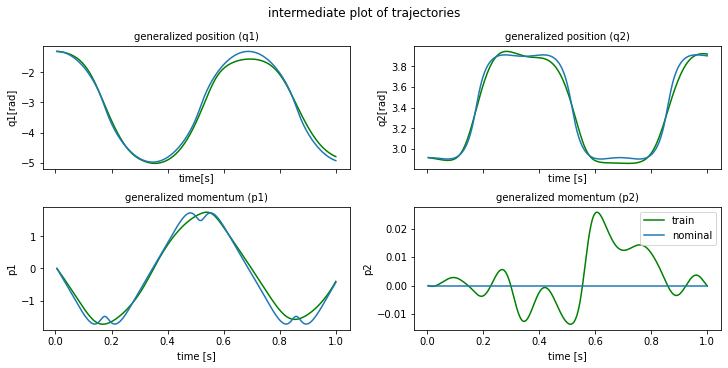

plot time : 1.210402488708496
epoch  430 | train time 4.65 | train loss 7.962781e-03 | test loss 1.365274e-02 | test time 1.04  
epoch  431 | train time 3.23 | train loss 8.781623e-03 
epoch  432 | train time 3.31 | train loss 8.209724e-03 
epoch  433 | train time 3.16 | train loss 7.502681e-03 
epoch  434 | train time 3.19 | train loss 8.186155e-03 
epoch  435 | train time 3.28 | train loss 7.566562e-03 
epoch  436 | train time 3.27 | train loss 7.376899e-03 
epoch  437 | train time 3.23 | train loss 7.659775e-03 
epoch  438 | train time 3.29 | train loss 7.216976e-03 
epoch  439 | train time 3.17 | train loss 6.974076e-03 


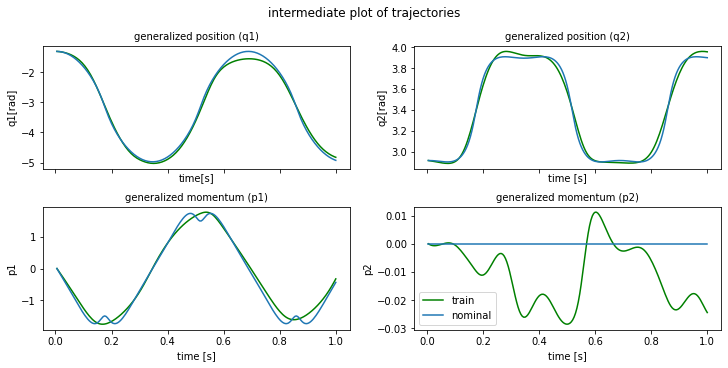

plot time : 1.2683181762695312
epoch  440 | train time 4.88 | train loss 7.169985e-03 | test loss 1.128773e-02 | test time 1.29  
epoch  441 | train time 3.65 | train loss 7.096528e-03 
epoch  442 | train time 3.13 | train loss 6.636961e-03 
epoch  443 | train time 3.29 | train loss 6.818813e-03 
epoch  444 | train time 3.53 | train loss 6.831788e-03 
epoch  445 | train time 4.08 | train loss 6.440599e-03 
epoch  446 | train time 4.85 | train loss 6.409434e-03 
epoch  447 | train time 4.12 | train loss 6.545254e-03 
epoch  448 | train time 5.40 | train loss 6.424651e-03 
epoch  449 | train time 4.97 | train loss 6.155707e-03 


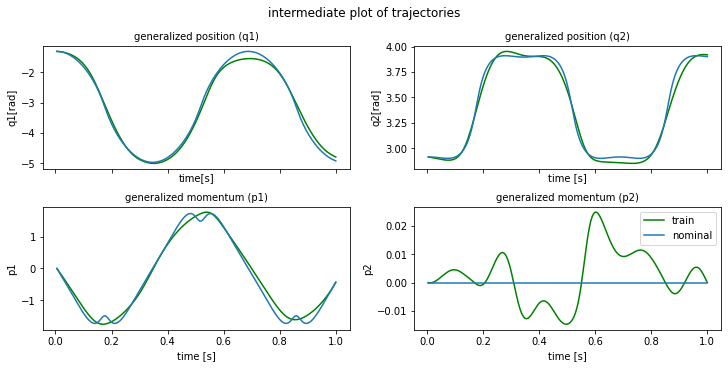

plot time : 1.2057619094848633
epoch  450 | train time 5.42 | train loss 6.218392e-03 | test loss 9.954616e-03 | test time 1.03  
epoch  451 | train time 4.55 | train loss 6.268159e-03 
epoch  452 | train time 4.92 | train loss 6.066532e-03 
epoch  453 | train time 3.40 | train loss 5.969519e-03 
epoch  454 | train time 3.29 | train loss 5.970161e-03 
epoch  455 | train time 3.28 | train loss 5.966895e-03 
epoch  456 | train time 3.40 | train loss 5.868397e-03 
epoch  457 | train time 3.51 | train loss 5.791883e-03 
epoch  458 | train time 3.11 | train loss 5.786790e-03 
epoch  459 | train time 3.38 | train loss 5.734120e-03 


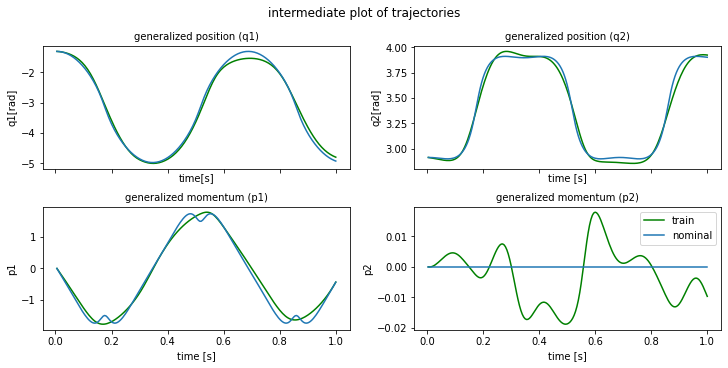

plot time : 1.18916654586792
epoch  460 | train time 4.29 | train loss 5.684127e-03 | test loss 9.408510e-03 | test time 0.83  
epoch  461 | train time 3.29 | train loss 5.658923e-03 
epoch  462 | train time 3.33 | train loss 5.645723e-03 
epoch  463 | train time 3.17 | train loss 5.617449e-03 
epoch  464 | train time 3.07 | train loss 5.574188e-03 
epoch  465 | train time 3.13 | train loss 5.615149e-03 
epoch  466 | train time 3.30 | train loss 5.745405e-03 
epoch  467 | train time 3.23 | train loss 5.983113e-03 
epoch  468 | train time 3.55 | train loss 6.435021e-03 
epoch  469 | train time 3.41 | train loss 7.427381e-03 


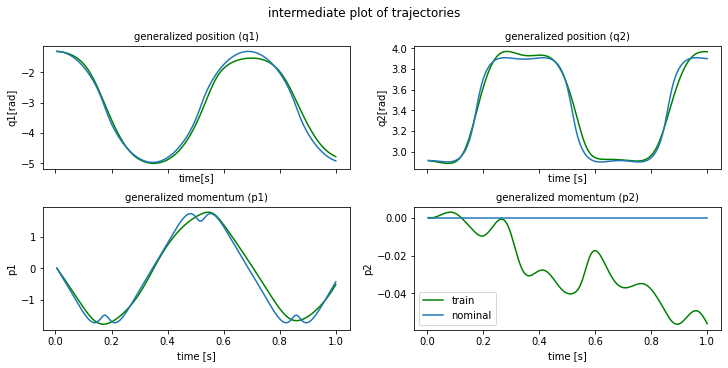

plot time : 1.2339105606079102
epoch  470 | train time 4.52 | train loss 9.127453e-03 | test loss 1.520972e-02 | test time 0.81  
epoch  471 | train time 3.09 | train loss 1.238674e-02 
epoch  472 | train time 3.16 | train loss 1.526999e-02 
epoch  473 | train time 3.15 | train loss 1.761604e-02 
epoch  474 | train time 3.15 | train loss 1.417648e-02 
epoch  475 | train time 3.14 | train loss 8.385194e-03 
epoch  476 | train time 3.67 | train loss 5.812038e-03 
epoch  477 | train time 3.14 | train loss 8.248653e-03 
epoch  478 | train time 3.46 | train loss 1.091820e-02 
epoch  479 | train time 3.10 | train loss 8.980067e-03 


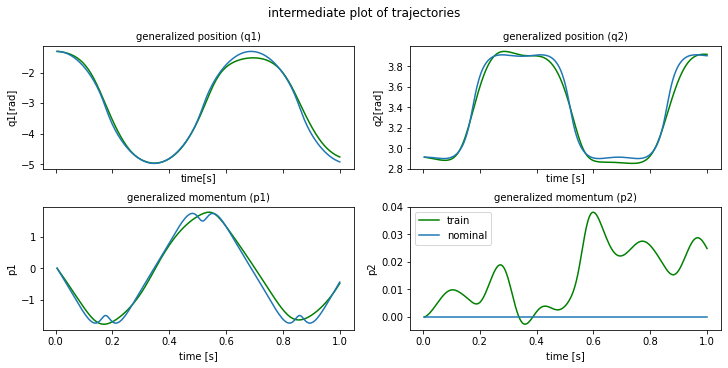

plot time : 1.1829524040222168
epoch  480 | train time 4.50 | train loss 5.875660e-03 | test loss 9.731157e-03 | test time 0.81  
epoch  481 | train time 3.13 | train loss 6.283712e-03 
epoch  482 | train time 3.17 | train loss 8.125375e-03 
epoch  483 | train time 3.09 | train loss 7.375068e-03 
epoch  484 | train time 3.15 | train loss 5.455092e-03 
epoch  485 | train time 3.27 | train loss 5.924108e-03 
epoch  486 | train time 3.27 | train loss 7.237426e-03 
epoch  487 | train time 3.31 | train loss 6.342954e-03 
epoch  488 | train time 3.28 | train loss 5.051845e-03 
epoch  489 | train time 3.33 | train loss 5.535643e-03 


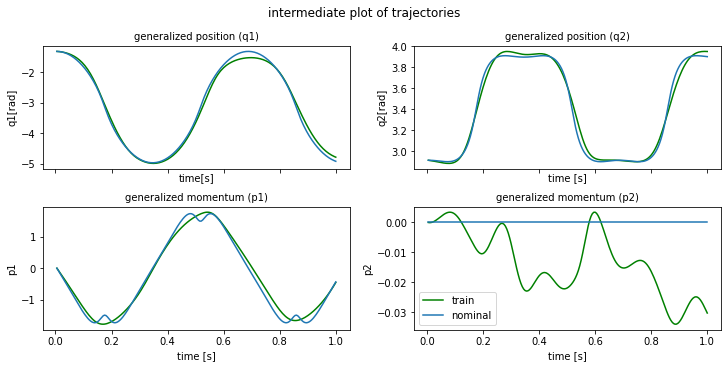

plot time : 1.2526185512542725
epoch  490 | train time 4.52 | train loss 6.309383e-03 | test loss 9.682653e-03 | test time 0.82  
epoch  491 | train time 3.07 | train loss 5.710220e-03 
epoch  492 | train time 3.13 | train loss 4.915306e-03 
epoch  493 | train time 3.23 | train loss 5.274947e-03 
epoch  494 | train time 3.35 | train loss 5.690074e-03 
epoch  495 | train time 3.34 | train loss 5.217276e-03 
epoch  496 | train time 3.46 | train loss 4.796926e-03 
epoch  497 | train time 3.21 | train loss 5.052511e-03 
epoch  498 | train time 3.53 | train loss 5.264072e-03 
epoch  499 | train time 3.34 | train loss 4.922248e-03 
horizon length : 250
min max values updated


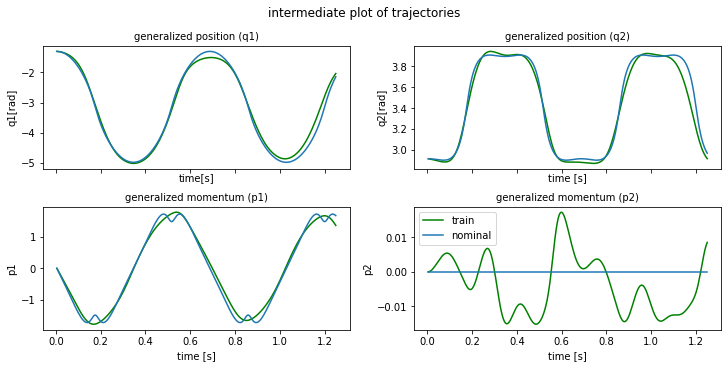

plot time : 1.1747536659240723
min max values updated
epoch  500 | train time 5.34 | train loss 8.315342e-03 | test loss 3.323032e-02 | test time 1.06  
epoch  501 | train time 4.27 | train loss 2.637902e-02 
epoch  502 | train time 3.94 | train loss 1.801571e-01 
epoch  503 | train time 3.85 | train loss 3.511513e-01 
epoch  504 | train time 4.02 | train loss 2.467092e-01 
epoch  505 | train time 4.39 | train loss 3.889189e-01 
epoch  506 | train time 4.10 | train loss 2.291633e-01 
epoch  507 | train time 3.91 | train loss 3.519105e-01 
epoch  508 | train time 4.55 | train loss 1.930507e-01 
epoch  509 | train time 4.18 | train loss 1.643031e-01 


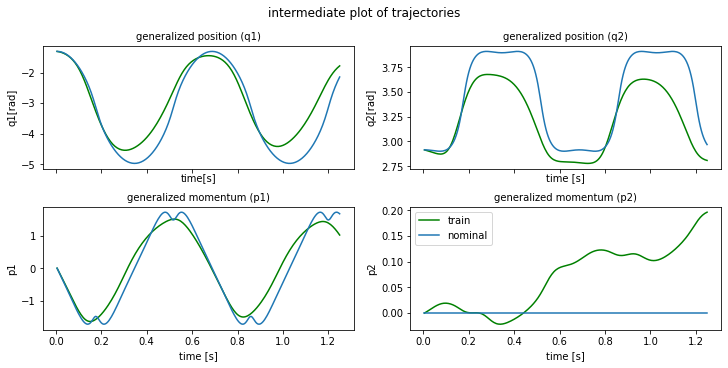

plot time : 1.1840336322784424
epoch  510 | train time 5.17 | train loss 1.428177e-01 | test loss 2.660848e-01 | test time 1.02  
epoch  511 | train time 3.88 | train loss 1.960146e-01 
epoch  512 | train time 3.90 | train loss 1.076739e-01 
epoch  513 | train time 4.02 | train loss 1.381808e-01 
epoch  514 | train time 3.86 | train loss 1.370896e-01 
epoch  515 | train time 4.17 | train loss 8.647113e-02 
epoch  516 | train time 3.92 | train loss 1.004695e-01 
epoch  517 | train time 3.85 | train loss 1.042544e-01 
epoch  518 | train time 4.17 | train loss 7.072484e-02 
epoch  519 | train time 3.98 | train loss 8.162256e-02 


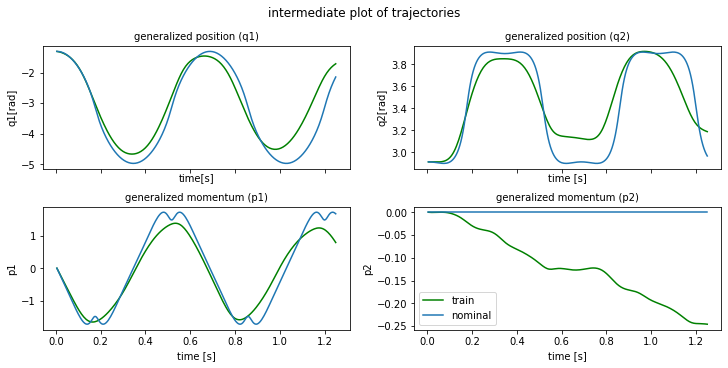

plot time : 1.2456440925598145
epoch  520 | train time 5.53 | train loss 8.106399e-02 | test loss 7.236823e-02 | test time 0.99  
epoch  521 | train time 3.97 | train loss 5.138126e-02 
epoch  522 | train time 3.86 | train loss 6.436713e-02 
epoch  523 | train time 4.05 | train loss 4.928573e-02 
epoch  524 | train time 4.14 | train loss 5.936152e-02 
epoch  525 | train time 4.10 | train loss 3.596530e-02 
epoch  526 | train time 4.15 | train loss 3.794285e-02 
epoch  527 | train time 4.13 | train loss 4.652952e-02 
epoch  528 | train time 4.04 | train loss 3.574690e-02 
epoch  529 | train time 4.12 | train loss 2.671547e-02 


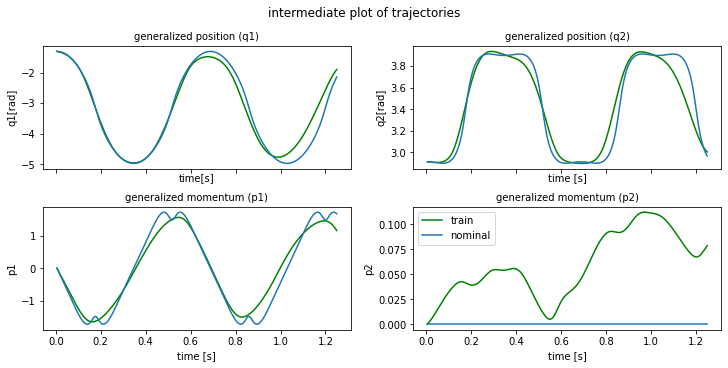

plot time : 1.2615728378295898
epoch  530 | train time 5.32 | train loss 3.991974e-02 | test loss 4.094079e-02 | test time 1.01  
epoch  531 | train time 4.03 | train loss 2.720905e-02 
epoch  532 | train time 3.85 | train loss 2.562185e-02 
epoch  533 | train time 3.86 | train loss 2.974658e-02 
epoch  534 | train time 4.17 | train loss 2.607805e-02 
epoch  535 | train time 3.97 | train loss 1.950550e-02 
epoch  536 | train time 4.01 | train loss 2.474517e-02 
epoch  537 | train time 4.05 | train loss 2.201235e-02 
epoch  538 | train time 3.84 | train loss 1.962256e-02 
epoch  539 | train time 4.16 | train loss 1.906941e-02 


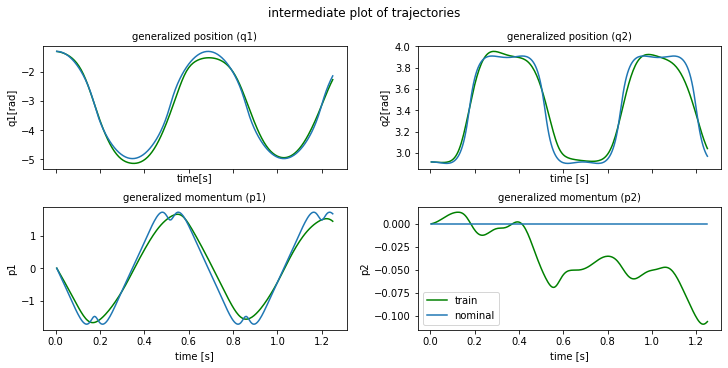

plot time : 1.2571299076080322
epoch  540 | train time 5.31 | train loss 1.959543e-02 | test loss 2.565172e-02 | test time 0.99  
epoch  541 | train time 3.82 | train loss 1.700814e-02 
epoch  542 | train time 4.18 | train loss 1.631638e-02 
epoch  543 | train time 4.02 | train loss 1.704662e-02 
epoch  544 | train time 3.96 | train loss 1.590049e-02 
epoch  545 | train time 4.63 | train loss 1.405318e-02 
epoch  546 | train time 4.52 | train loss 1.584914e-02 
epoch  547 | train time 3.98 | train loss 1.460279e-02 
epoch  548 | train time 4.22 | train loss 1.296397e-02 
epoch  549 | train time 4.03 | train loss 1.397134e-02 


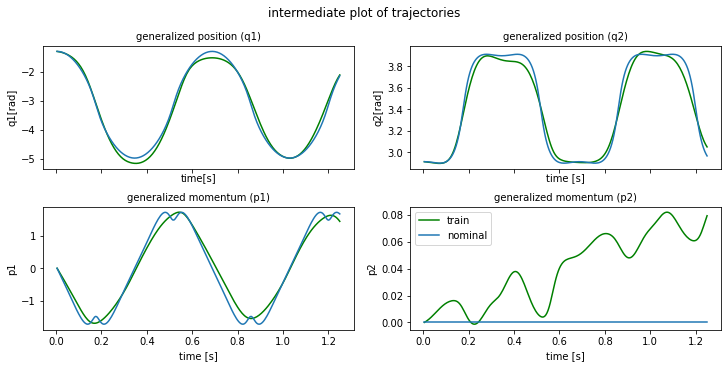

plot time : 1.2913627624511719
epoch  550 | train time 5.35 | train loss 1.313759e-02 | test loss 2.124795e-02 | test time 1.09  
epoch  551 | train time 4.28 | train loss 1.243456e-02 
epoch  552 | train time 3.86 | train loss 1.281372e-02 
epoch  553 | train time 4.06 | train loss 1.255597e-02 
epoch  554 | train time 4.20 | train loss 1.115770e-02 
epoch  555 | train time 4.30 | train loss 1.182266e-02 
epoch  556 | train time 4.02 | train loss 1.145144e-02 
epoch  557 | train time 4.22 | train loss 1.056855e-02 
epoch  558 | train time 4.02 | train loss 1.068921e-02 
epoch  559 | train time 4.11 | train loss 1.076187e-02 


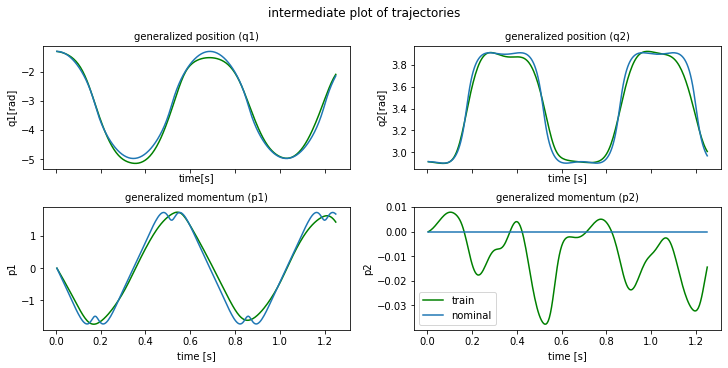

plot time : 1.211181640625
epoch  560 | train time 5.18 | train loss 1.006312e-02 | test loss 1.701190e-02 | test time 1.08  
epoch  561 | train time 3.98 | train loss 1.009185e-02 
epoch  562 | train time 4.15 | train loss 1.006426e-02 
epoch  563 | train time 4.11 | train loss 9.374440e-03 
epoch  564 | train time 3.84 | train loss 9.641256e-03 
epoch  565 | train time 4.14 | train loss 9.364739e-03 
epoch  566 | train time 3.92 | train loss 9.162587e-03 
epoch  567 | train time 3.92 | train loss 9.076869e-03 
epoch  568 | train time 4.04 | train loss 8.954722e-03 
epoch  569 | train time 4.33 | train loss 8.820323e-03 


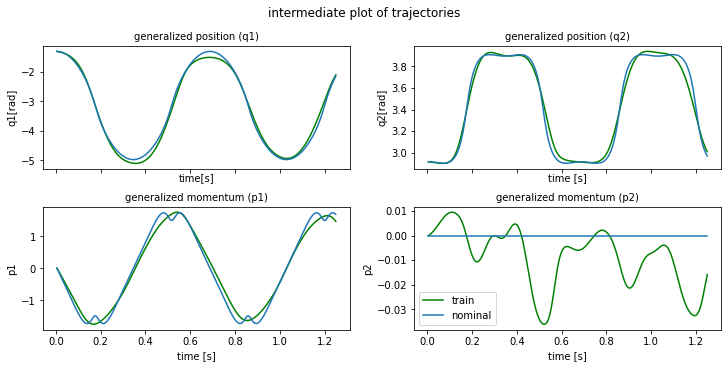

plot time : 1.1721701622009277
epoch  570 | train time 5.36 | train loss 8.642679e-03 | test loss 1.326897e-02 | test time 1.24  
epoch  571 | train time 3.89 | train loss 8.617658e-03 
epoch  572 | train time 3.92 | train loss 8.403192e-03 
epoch  573 | train time 4.08 | train loss 8.346728e-03 
epoch  574 | train time 3.84 | train loss 8.292930e-03 
epoch  575 | train time 4.14 | train loss 8.090075e-03 
epoch  576 | train time 3.85 | train loss 8.018583e-03 
epoch  577 | train time 4.09 | train loss 7.978067e-03 
epoch  578 | train time 3.87 | train loss 7.822929e-03 
epoch  579 | train time 4.08 | train loss 7.749452e-03 


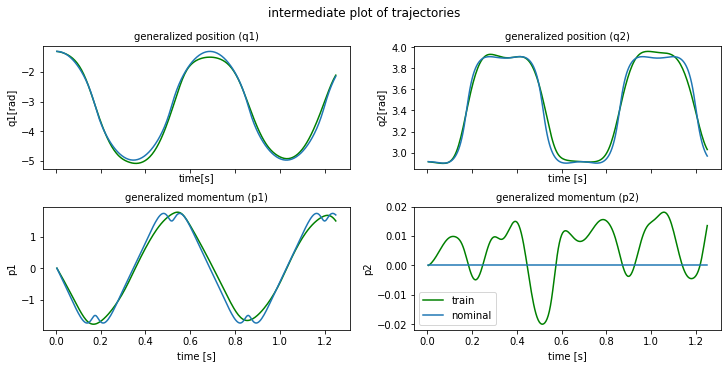

plot time : 1.2657651901245117
epoch  580 | train time 5.27 | train loss 7.714096e-03 | test loss 1.299151e-02 | test time 1.00  
epoch  581 | train time 4.27 | train loss 7.571609e-03 
epoch  582 | train time 3.93 | train loss 7.529589e-03 
epoch  583 | train time 3.83 | train loss 7.471734e-03 
epoch  584 | train time 4.09 | train loss 7.349303e-03 
epoch  585 | train time 3.98 | train loss 7.318362e-03 
epoch  586 | train time 3.96 | train loss 7.260354e-03 
epoch  587 | train time 3.96 | train loss 7.170750e-03 
epoch  588 | train time 4.13 | train loss 7.134417e-03 
epoch  589 | train time 4.56 | train loss 7.066079e-03 


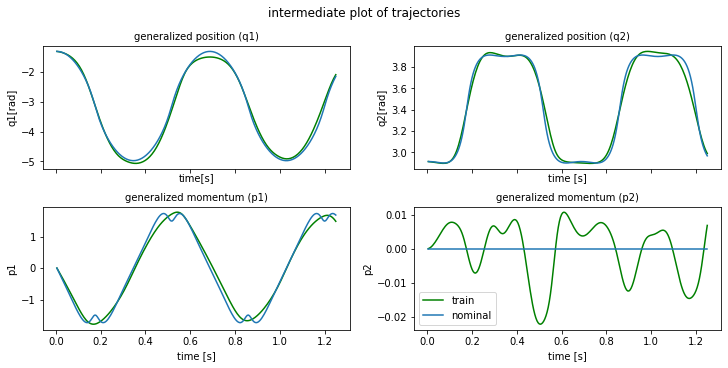

plot time : 1.2140893936157227
epoch  590 | train time 5.89 | train loss 7.001818e-03 | test loss 1.232782e-02 | test time 1.27  
epoch  591 | train time 4.28 | train loss 6.961091e-03 
epoch  592 | train time 4.09 | train loss 6.896049e-03 
epoch  593 | train time 4.00 | train loss 6.843448e-03 
epoch  594 | train time 4.01 | train loss 6.803683e-03 
epoch  595 | train time 3.99 | train loss 6.745703e-03 
epoch  596 | train time 4.23 | train loss 6.694119e-03 
epoch  597 | train time 4.04 | train loss 6.653805e-03 
epoch  598 | train time 4.29 | train loss 6.602488e-03 
epoch  599 | train time 3.88 | train loss 6.557737e-03 
horizon length : 300
min max values updated


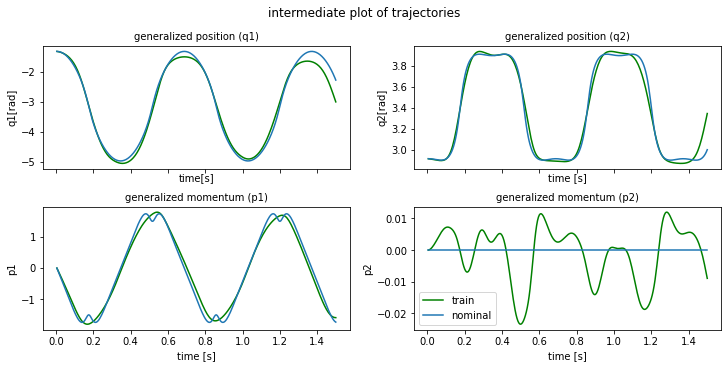

plot time : 1.258927345275879
min max values updated
epoch  600 | train time 6.11 | train loss 1.245463e-02 | test loss 3.137478e-02 | test time 1.26  
epoch  601 | train time 4.64 | train loss 3.325561e-02 
epoch  602 | train time 4.75 | train loss 1.074914e-01 
epoch  603 | train time 4.72 | train loss 4.491639e-02 
epoch  604 | train time 5.03 | train loss 3.622548e-02 
epoch  605 | train time 4.79 | train loss 7.773073e-02 
epoch  606 | train time 4.96 | train loss 1.306453e-01 
epoch  607 | train time 4.87 | train loss 7.092331e-02 
epoch  608 | train time 4.66 | train loss 1.682014e-02 
epoch  609 | train time 4.70 | train loss 6.262017e-02 


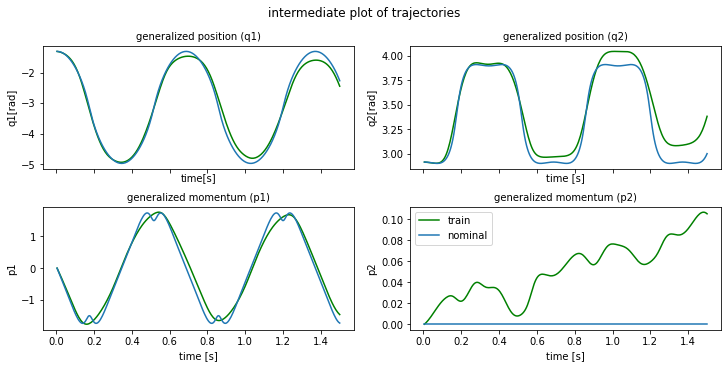

plot time : 1.197974681854248
epoch  610 | train time 6.07 | train loss 3.755657e-02 | test loss 4.338854e-02 | test time 1.21  
epoch  611 | train time 4.91 | train loss 2.745523e-02 
epoch  612 | train time 4.78 | train loss 4.516983e-02 
epoch  613 | train time 4.70 | train loss 1.793813e-02 
epoch  614 | train time 4.78 | train loss 3.576007e-02 
epoch  615 | train time 4.92 | train loss 2.286528e-02 
epoch  616 | train time 4.76 | train loss 2.392378e-02 
epoch  617 | train time 4.63 | train loss 2.400051e-02 
epoch  618 | train time 4.68 | train loss 2.120925e-02 
epoch  619 | train time 4.65 | train loss 1.985860e-02 


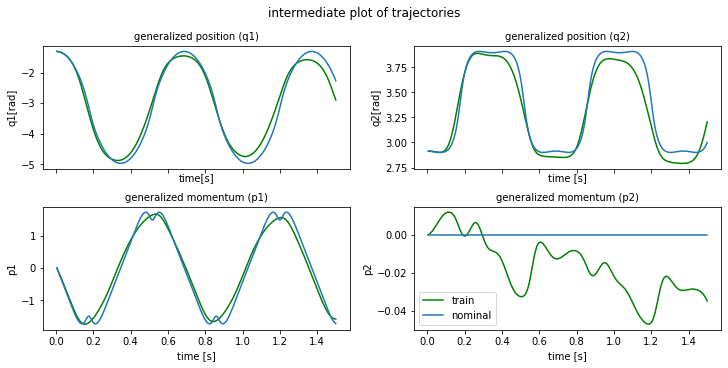

plot time : 1.2220180034637451
epoch  620 | train time 6.11 | train loss 1.763151e-02 | test loss 3.950967e-02 | test time 1.18  
epoch  621 | train time 4.96 | train loss 2.065189e-02 
epoch  622 | train time 4.87 | train loss 1.439314e-02 
epoch  623 | train time 4.64 | train loss 1.932712e-02 
epoch  624 | train time 5.20 | train loss 1.256171e-02 
epoch  625 | train time 4.73 | train loss 1.771641e-02 
epoch  626 | train time 4.92 | train loss 1.253042e-02 
epoch  627 | train time 6.38 | train loss 1.479306e-02 
epoch  628 | train time 5.05 | train loss 1.121612e-02 
epoch  629 | train time 4.85 | train loss 1.426772e-02 


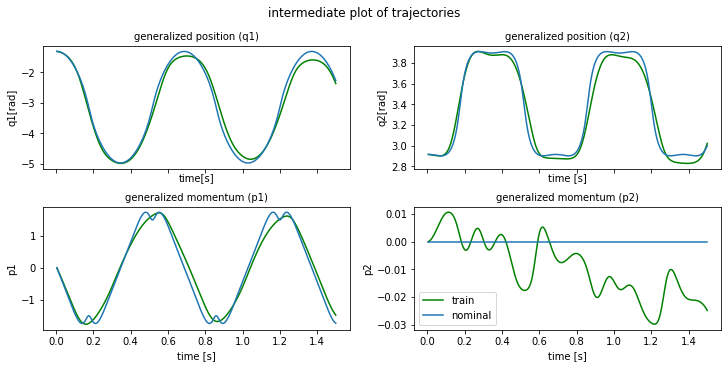

plot time : 1.238471508026123
epoch  630 | train time 6.21 | train loss 1.176612e-02 | test loss 2.208795e-02 | test time 1.36  
epoch  631 | train time 4.69 | train loss 1.191991e-02 
epoch  632 | train time 4.85 | train loss 1.081297e-02 
epoch  633 | train time 4.61 | train loss 1.186492e-02 
epoch  634 | train time 4.68 | train loss 1.038439e-02 
epoch  635 | train time 4.94 | train loss 1.103214e-02 
epoch  636 | train time 4.66 | train loss 9.805790e-03 
epoch  637 | train time 4.76 | train loss 9.574169e-03 
epoch  638 | train time 4.62 | train loss 1.006922e-02 
epoch  639 | train time 4.72 | train loss 9.369004e-03 


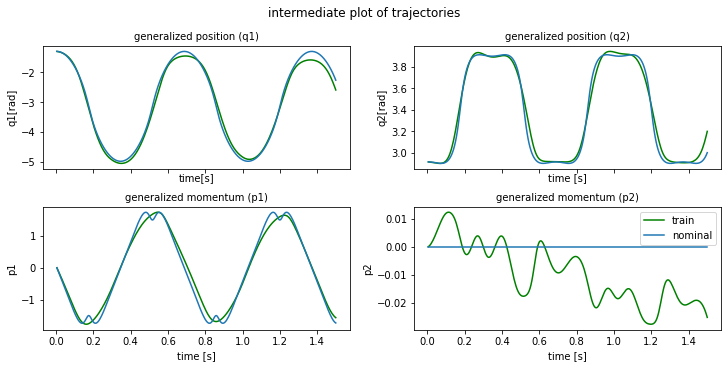

plot time : 1.201004981994629
epoch  640 | train time 5.83 | train loss 9.700987e-03 | test loss 1.542586e-02 | test time 1.38  
epoch  641 | train time 5.20 | train loss 8.352173e-03 
epoch  642 | train time 5.13 | train loss 9.236727e-03 
epoch  643 | train time 4.91 | train loss 8.449515e-03 
epoch  644 | train time 4.79 | train loss 8.874135e-03 
epoch  645 | train time 4.83 | train loss 8.136955e-03 
epoch  646 | train time 5.02 | train loss 8.420929e-03 
epoch  647 | train time 4.64 | train loss 7.921157e-03 
epoch  648 | train time 4.65 | train loss 7.936688e-03 
epoch  649 | train time 4.82 | train loss 8.019117e-03 


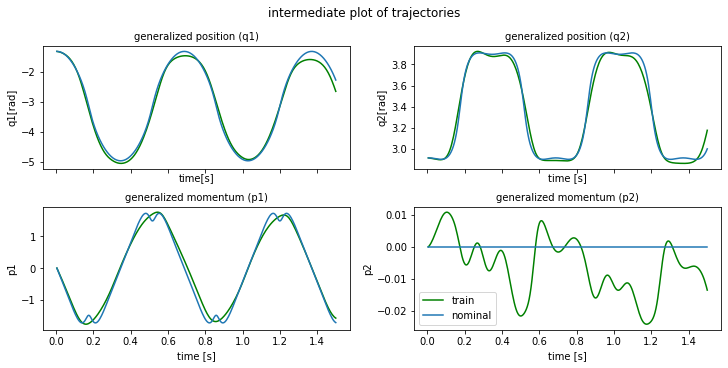

plot time : 1.2097692489624023
epoch  650 | train time 6.16 | train loss 7.708045e-03 | test loss 1.471684e-02 | test time 1.20  
epoch  651 | train time 4.70 | train loss 7.877045e-03 
epoch  652 | train time 4.64 | train loss 7.233934e-03 
epoch  653 | train time 4.85 | train loss 7.632715e-03 
epoch  654 | train time 4.80 | train loss 7.274881e-03 
epoch  655 | train time 4.67 | train loss 7.373814e-03 
epoch  656 | train time 4.77 | train loss 7.259377e-03 
epoch  657 | train time 4.76 | train loss 7.130555e-03 
epoch  658 | train time 5.09 | train loss 7.186306e-03 
epoch  659 | train time 4.61 | train loss 6.898505e-03 


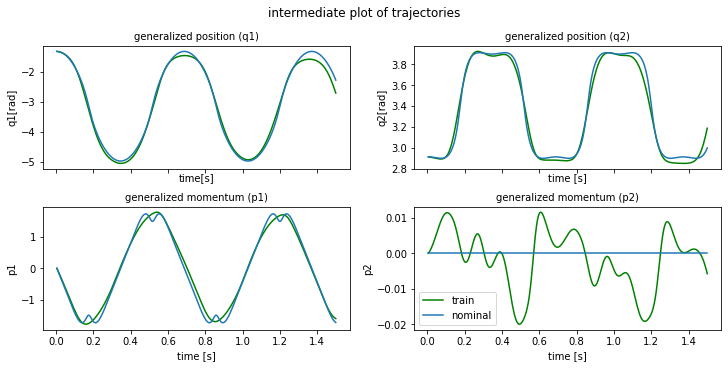

plot time : 1.197683334350586
epoch  660 | train time 6.16 | train loss 7.004076e-03 | test loss 1.426194e-02 | test time 1.18  
epoch  661 | train time 4.71 | train loss 6.827952e-03 
epoch  662 | train time 4.77 | train loss 6.913630e-03 
epoch  663 | train time 5.14 | train loss 6.782335e-03 
epoch  664 | train time 5.53 | train loss 6.717939e-03 
epoch  665 | train time 4.73 | train loss 6.724811e-03 
epoch  666 | train time 4.75 | train loss 6.583067e-03 
epoch  667 | train time 4.80 | train loss 6.625433e-03 
epoch  668 | train time 4.85 | train loss 6.473337e-03 
epoch  669 | train time 4.79 | train loss 6.479653e-03 


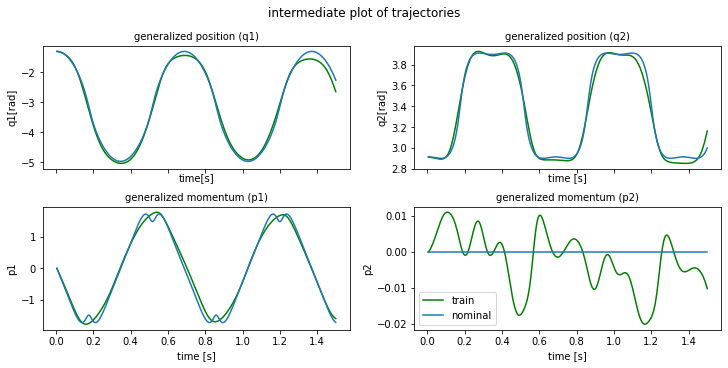

plot time : 1.279567003250122
epoch  670 | train time 6.41 | train loss 6.443769e-03 | test loss 1.379160e-02 | test time 1.38  
epoch  671 | train time 4.72 | train loss 6.376705e-03 
epoch  672 | train time 4.70 | train loss 6.377032e-03 
epoch  673 | train time 5.06 | train loss 6.290809e-03 
epoch  674 | train time 4.72 | train loss 6.297264e-03 
epoch  675 | train time 5.28 | train loss 6.242618e-03 
epoch  676 | train time 4.77 | train loss 6.213358e-03 
epoch  677 | train time 4.96 | train loss 6.179065e-03 
epoch  678 | train time 5.00 | train loss 6.119323e-03 
epoch  679 | train time 4.91 | train loss 6.116034e-03 


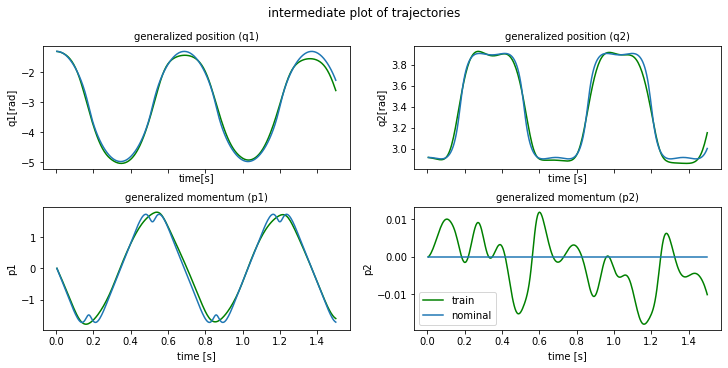

plot time : 1.2620799541473389
epoch  680 | train time 6.22 | train loss 6.059722e-03 | test loss 1.326819e-02 | test time 1.36  
epoch  681 | train time 4.73 | train loss 6.039011e-03 
epoch  682 | train time 4.73 | train loss 6.005840e-03 
epoch  683 | train time 4.65 | train loss 5.961802e-03 
epoch  684 | train time 5.04 | train loss 5.952470e-03 
epoch  685 | train time 4.70 | train loss 5.917541e-03 
epoch  686 | train time 4.84 | train loss 5.904788e-03 
epoch  687 | train time 4.67 | train loss 5.891254e-03 
epoch  688 | train time 4.79 | train loss 5.884017e-03 
epoch  689 | train time 5.01 | train loss 5.911745e-03 


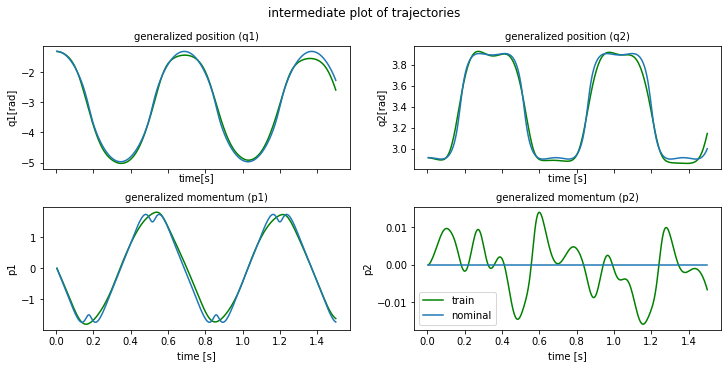

plot time : 1.2592525482177734
epoch  690 | train time 5.99 | train loss 5.955039e-03 | test loss 1.333970e-02 | test time 1.45  
epoch  691 | train time 4.81 | train loss 6.073140e-03 
epoch  692 | train time 4.92 | train loss 6.257093e-03 
epoch  693 | train time 5.01 | train loss 6.618201e-03 
epoch  694 | train time 4.66 | train loss 7.156976e-03 
epoch  695 | train time 5.02 | train loss 8.115403e-03 
epoch  696 | train time 4.78 | train loss 9.134293e-03 
epoch  697 | train time 5.07 | train loss 1.062727e-02 
epoch  698 | train time 4.69 | train loss 1.092871e-02 
epoch  699 | train time 4.73 | train loss 1.074980e-02 


In [66]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [67]:
if collect_grads:
    plot_grads(stats)

In [68]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [69]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [70]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

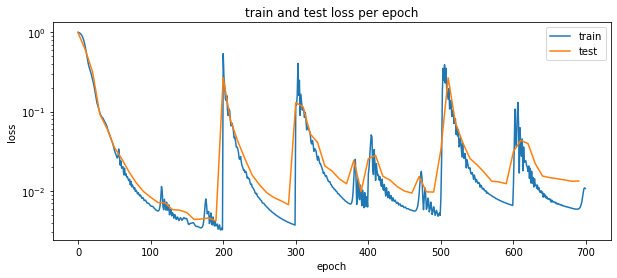

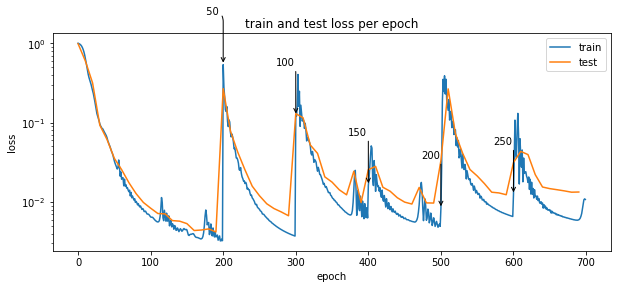

In [71]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

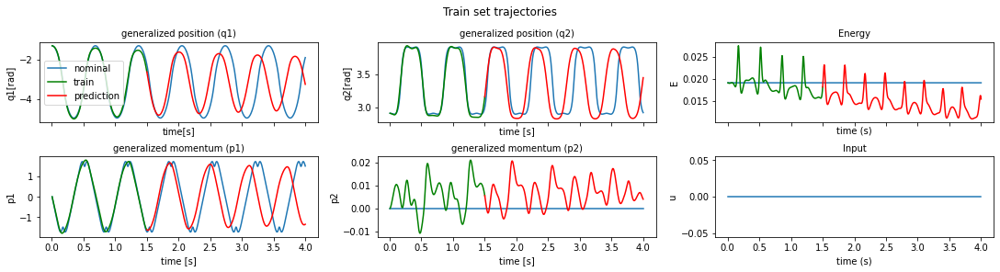

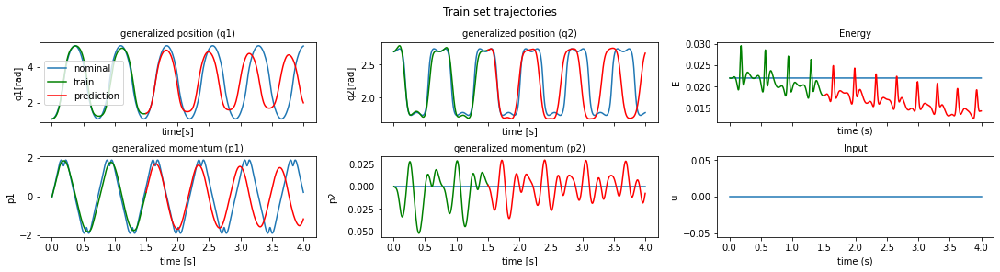

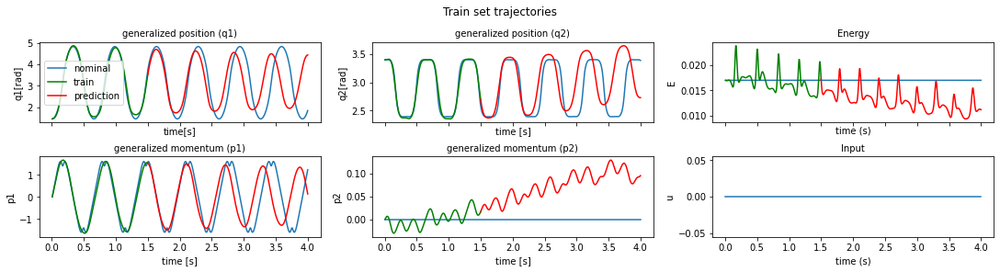

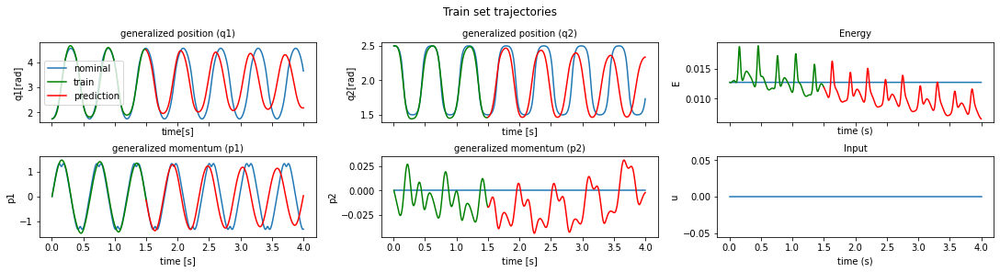

In [72]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

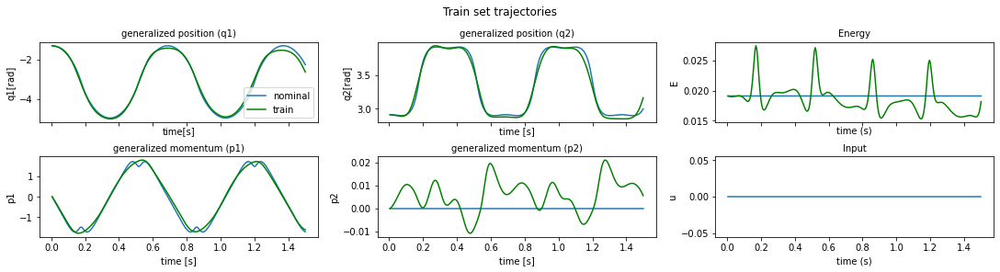

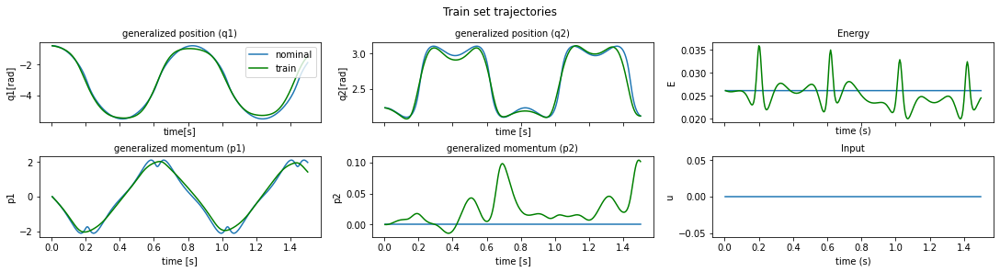

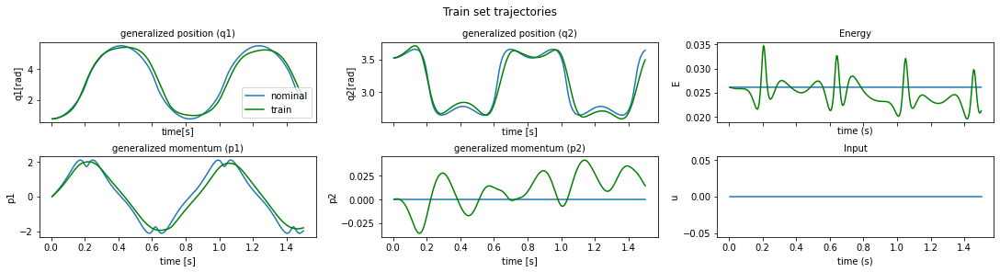

In [73]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + "nopred.png",
        w_rescale=w_rescale,
    )

##### 30k parameters - w horizon - with all rescaling no clipping

In [41]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800  # length of a trajectory
num_trajectories = 125  # number of trajectories in total
proportion = 0.8  # train test proportion
batch_size = 100  # batch size used by dataloader
w_rescale = [1, 1, 1, 1]  # [1, 1000, 1, 10000]  # [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False  # shuffle sample in the batches between epochs
# 'hamiltonian' or 'newtonian', newtonian if you want [q1,q1_dot,q2,q2_dot]
coord_type = "hamiltonian"
min_max_rescale = True  # rescale the training trajectories
# which dimensions to rescale if using min_max_rescale, so that nothing is divided by zero
rescale_dims = [1, 1, 1, 0]

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = True
grad_clip = False  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)  # total number of training epochs

cpu


In [42]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [43]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=90, nb_hidden_layers=4, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 33303
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p33k_Ts0.005_nodissip_rescaledloss_trajminmaxrescale_
horizon_list and switch_steps have the same size


horizon length : 50
min max values updated


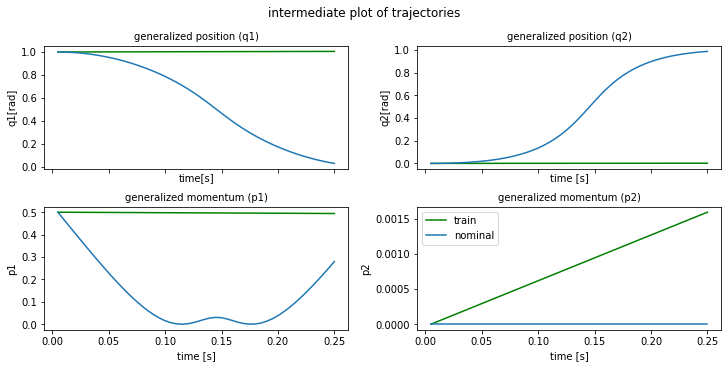

plot time : 1.3459656238555908
min max values updated
epoch    0 | train time 2.25 | train loss 1.030578e+00 | test loss 8.721144e-01 | test time 0.26  
epoch    1 | train time 0.88 | train loss 1.010432e+00 
epoch    2 | train time 0.90 | train loss 9.877248e-01 
epoch    3 | train time 0.80 | train loss 9.584141e-01 
epoch    4 | train time 0.80 | train loss 9.194156e-01 
epoch    5 | train time 0.78 | train loss 8.680007e-01 
epoch    6 | train time 0.78 | train loss 8.020587e-01 
epoch    7 | train time 0.81 | train loss 7.210794e-01 
epoch    8 | train time 0.77 | train loss 6.278917e-01 
epoch    9 | train time 0.76 | train loss 5.312307e-01 


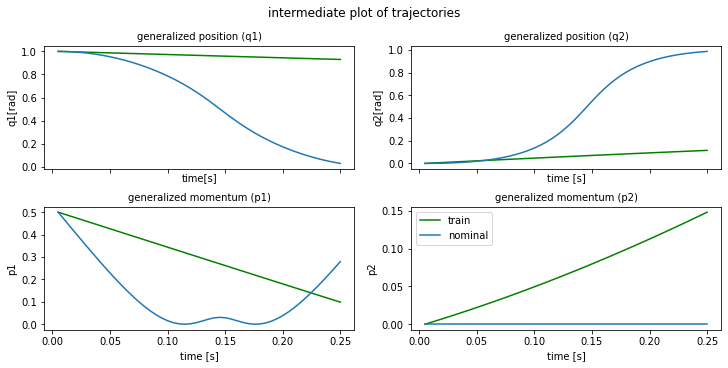

plot time : 1.189769983291626
epoch   10 | train time 1.98 | train loss 4.480197e-01 | test loss 3.226849e-01 | test time 0.22  
epoch   11 | train time 0.78 | train loss 4.001802e-01 
epoch   12 | train time 0.81 | train loss 3.946871e-01 
epoch   13 | train time 0.80 | train loss 4.013238e-01 
epoch   14 | train time 0.89 | train loss 3.842844e-01 
epoch   15 | train time 0.89 | train loss 3.489638e-01 
epoch   16 | train time 0.80 | train loss 3.116427e-01 
epoch   17 | train time 0.77 | train loss 2.798803e-01 
epoch   18 | train time 0.78 | train loss 2.600268e-01 
epoch   19 | train time 0.86 | train loss 2.563824e-01 


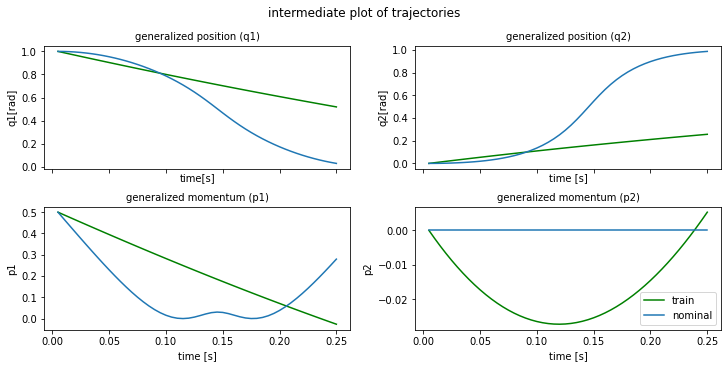

plot time : 1.2541089057922363
epoch   20 | train time 2.14 | train loss 2.577873e-01 | test loss 1.965186e-01 | test time 0.27  
epoch   21 | train time 0.86 | train loss 2.536962e-01 
epoch   22 | train time 0.81 | train loss 2.503929e-01 
epoch   23 | train time 0.77 | train loss 2.467808e-01 
epoch   24 | train time 0.77 | train loss 2.382928e-01 
epoch   25 | train time 0.77 | train loss 2.330114e-01 
epoch   26 | train time 0.77 | train loss 2.292095e-01 
epoch   27 | train time 0.76 | train loss 2.283940e-01 
epoch   28 | train time 0.78 | train loss 2.293866e-01 
epoch   29 | train time 0.78 | train loss 2.244124e-01 


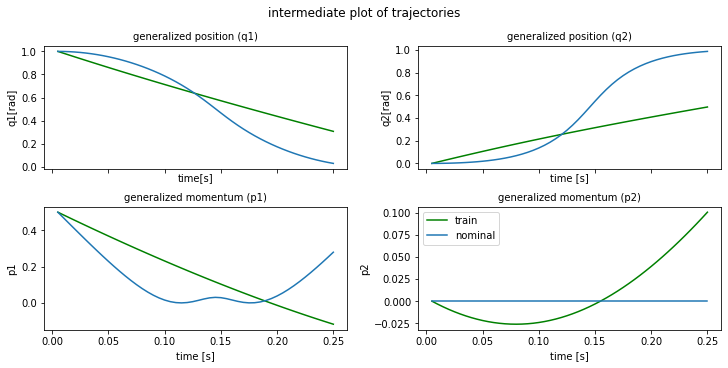

plot time : 1.2939720153808594
epoch   30 | train time 2.08 | train loss 2.181366e-01 | test loss 2.077747e-01 | test time 0.21  
epoch   31 | train time 0.77 | train loss 2.123612e-01 
epoch   32 | train time 0.78 | train loss 2.115642e-01 
epoch   33 | train time 0.76 | train loss 2.112576e-01 
epoch   34 | train time 0.77 | train loss 2.089321e-01 
epoch   35 | train time 0.77 | train loss 2.069686e-01 
epoch   36 | train time 0.81 | train loss 2.037635e-01 
epoch   37 | train time 0.86 | train loss 2.006083e-01 
epoch   38 | train time 0.85 | train loss 1.987790e-01 
epoch   39 | train time 0.77 | train loss 1.954459e-01 


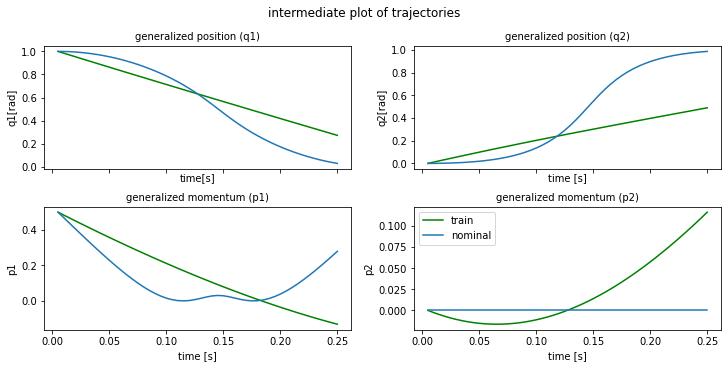

plot time : 1.205955982208252
epoch   40 | train time 2.07 | train loss 1.914469e-01 | test loss 2.004718e-01 | test time 0.22  
epoch   41 | train time 0.82 | train loss 1.884484e-01 
epoch   42 | train time 0.91 | train loss 1.862255e-01 
epoch   43 | train time 0.78 | train loss 1.840952e-01 
epoch   44 | train time 0.88 | train loss 1.812373e-01 
epoch   45 | train time 0.84 | train loss 1.769710e-01 
epoch   46 | train time 0.78 | train loss 1.738022e-01 
epoch   47 | train time 0.78 | train loss 1.715675e-01 
epoch   48 | train time 0.78 | train loss 1.700917e-01 
epoch   49 | train time 0.90 | train loss 1.676152e-01 


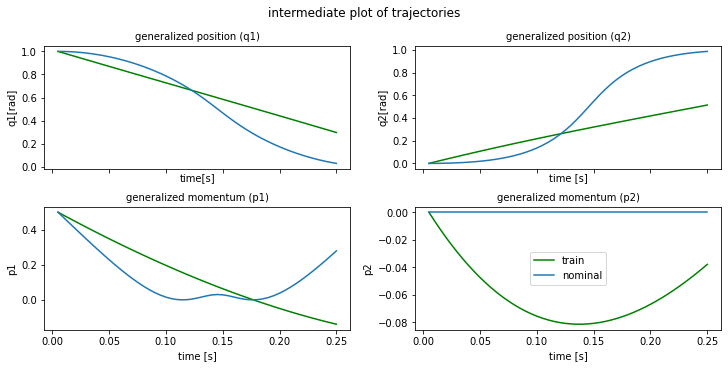

plot time : 1.2153942584991455
epoch   50 | train time 2.09 | train loss 1.638224e-01 | test loss 1.635482e-01 | test time 0.22  
epoch   51 | train time 0.78 | train loss 1.611001e-01 
epoch   52 | train time 0.88 | train loss 1.601565e-01 
epoch   53 | train time 0.91 | train loss 1.601923e-01 
epoch   54 | train time 0.85 | train loss 1.604350e-01 
epoch   55 | train time 0.78 | train loss 1.618662e-01 
epoch   56 | train time 0.78 | train loss 1.524629e-01 
epoch   57 | train time 0.78 | train loss 1.499626e-01 
epoch   58 | train time 0.78 | train loss 1.531293e-01 
epoch   59 | train time 0.81 | train loss 1.469219e-01 


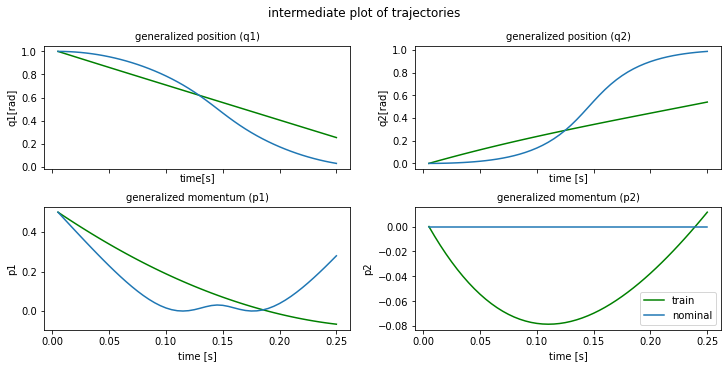

plot time : 1.724458932876587
epoch   60 | train time 2.73 | train loss 1.425728e-01 | test loss 1.493081e-01 | test time 0.29  
epoch   61 | train time 1.12 | train loss 1.449024e-01 
epoch   62 | train time 0.78 | train loss 1.412954e-01 
epoch   63 | train time 0.78 | train loss 1.368598e-01 
epoch   64 | train time 0.78 | train loss 1.373674e-01 
epoch   65 | train time 0.79 | train loss 1.354090e-01 
epoch   66 | train time 0.77 | train loss 1.322622e-01 
epoch   67 | train time 0.78 | train loss 1.313061e-01 
epoch   68 | train time 0.78 | train loss 1.307243e-01 
epoch   69 | train time 0.76 | train loss 1.285882e-01 


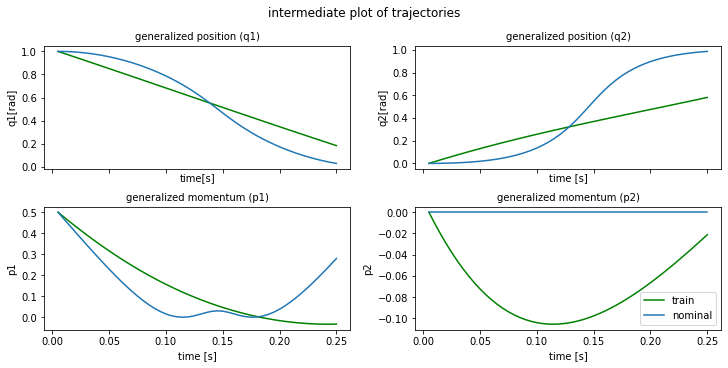

plot time : 1.2189197540283203
epoch   70 | train time 2.07 | train loss 1.254839e-01 | test loss 1.299311e-01 | test time 0.22  
epoch   71 | train time 0.77 | train loss 1.235669e-01 
epoch   72 | train time 0.79 | train loss 1.232924e-01 
epoch   73 | train time 0.80 | train loss 1.236269e-01 
epoch   74 | train time 1.04 | train loss 1.252180e-01 
epoch   75 | train time 0.95 | train loss 1.272661e-01 
epoch   76 | train time 0.85 | train loss 1.292745e-01 
epoch   77 | train time 0.88 | train loss 1.187106e-01 
epoch   78 | train time 0.89 | train loss 1.126597e-01 
epoch   79 | train time 0.86 | train loss 1.162296e-01 


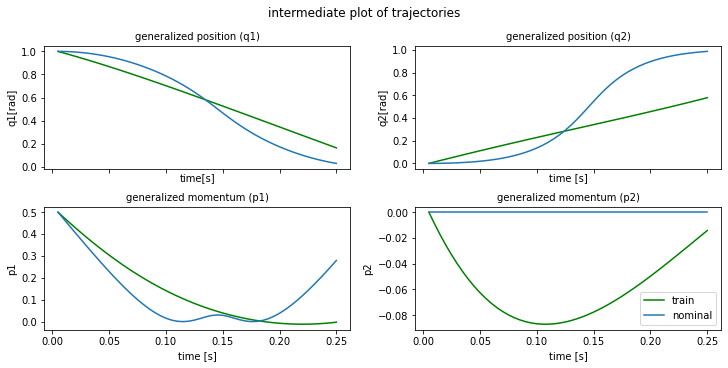

plot time : 1.187427043914795
epoch   80 | train time 2.06 | train loss 1.152005e-01 | test loss 1.122672e-01 | test time 0.25  
epoch   81 | train time 0.77 | train loss 1.085267e-01 
epoch   82 | train time 0.79 | train loss 1.077676e-01 
epoch   83 | train time 0.79 | train loss 1.094600e-01 
epoch   84 | train time 0.78 | train loss 1.055824e-01 
epoch   85 | train time 0.80 | train loss 1.017886e-01 
epoch   86 | train time 0.90 | train loss 1.030462e-01 
epoch   87 | train time 0.78 | train loss 1.016249e-01 
epoch   88 | train time 0.78 | train loss 9.665368e-02 
epoch   89 | train time 0.84 | train loss 9.612542e-02 


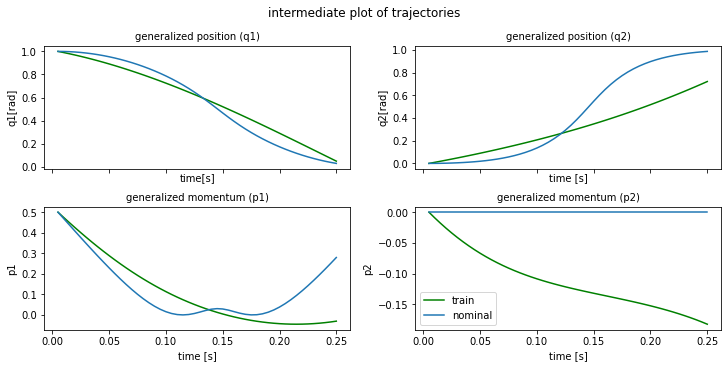

plot time : 1.309600591659546
epoch   90 | train time 2.28 | train loss 9.699683e-02 | test loss 9.675968e-02 | test time 0.23  
epoch   91 | train time 0.78 | train loss 9.334458e-02 
epoch   92 | train time 0.79 | train loss 8.933407e-02 
epoch   93 | train time 0.77 | train loss 8.808523e-02 
epoch   94 | train time 0.77 | train loss 8.823186e-02 
epoch   95 | train time 0.78 | train loss 8.779281e-02 
epoch   96 | train time 0.77 | train loss 8.551283e-02 
epoch   97 | train time 0.80 | train loss 8.418109e-02 
epoch   98 | train time 0.82 | train loss 8.482269e-02 
epoch   99 | train time 0.90 | train loss 8.643506e-02 


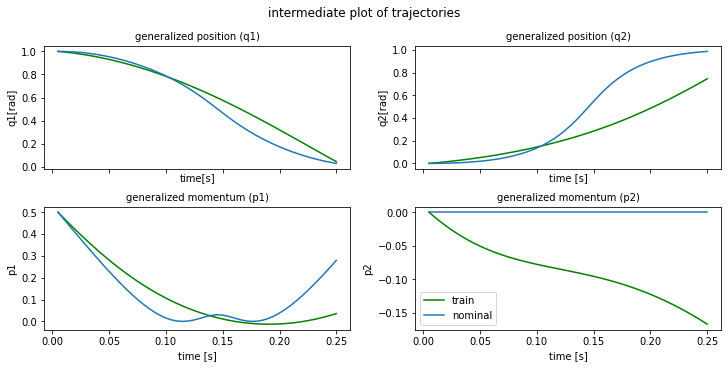

plot time : 1.1820549964904785
epoch  100 | train time 1.98 | train loss 7.691320e-02 | test loss 7.242145e-02 | test time 0.21  
epoch  101 | train time 0.79 | train loss 7.466253e-02 
epoch  102 | train time 0.79 | train loss 7.734364e-02 
epoch  103 | train time 0.78 | train loss 7.110891e-02 
epoch  104 | train time 0.77 | train loss 7.294302e-02 
epoch  105 | train time 0.82 | train loss 7.106313e-02 
epoch  106 | train time 0.82 | train loss 6.787951e-02 
epoch  107 | train time 0.78 | train loss 7.034004e-02 
epoch  108 | train time 0.94 | train loss 6.728067e-02 
epoch  109 | train time 0.86 | train loss 7.278582e-02 


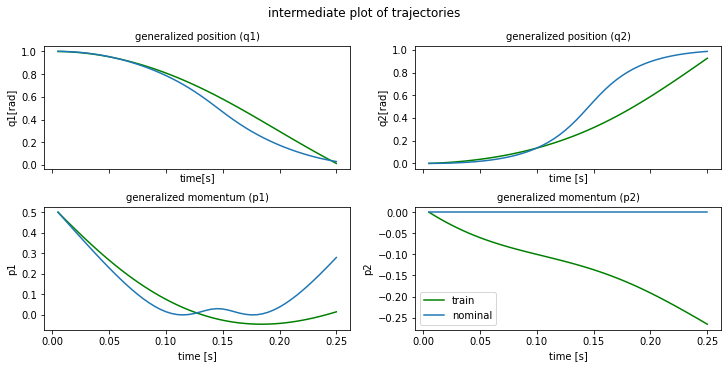

plot time : 1.1777403354644775
epoch  110 | train time 1.98 | train loss 7.981315e-02 | test loss 8.334218e-02 | test time 0.22  
epoch  111 | train time 0.77 | train loss 8.418866e-02 
epoch  112 | train time 0.79 | train loss 6.899627e-02 
epoch  113 | train time 0.79 | train loss 5.892224e-02 
epoch  114 | train time 0.91 | train loss 6.748440e-02 
epoch  115 | train time 0.81 | train loss 6.252660e-02 
epoch  116 | train time 0.78 | train loss 5.570716e-02 
epoch  117 | train time 0.78 | train loss 6.199807e-02 
epoch  118 | train time 0.79 | train loss 5.304222e-02 
epoch  119 | train time 0.86 | train loss 5.524397e-02 


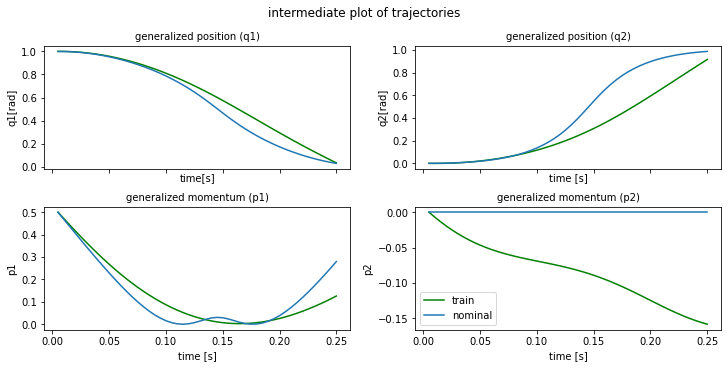

plot time : 1.2361083030700684
epoch  120 | train time 2.03 | train loss 5.338983e-02 | test loss 5.376072e-02 | test time 0.21  
epoch  121 | train time 0.84 | train loss 5.056319e-02 
epoch  122 | train time 0.78 | train loss 5.037029e-02 
epoch  123 | train time 0.77 | train loss 4.937553e-02 
epoch  124 | train time 0.78 | train loss 4.678164e-02 
epoch  125 | train time 0.78 | train loss 4.699383e-02 
epoch  126 | train time 0.78 | train loss 4.432045e-02 
epoch  127 | train time 0.76 | train loss 4.389333e-02 
epoch  128 | train time 0.78 | train loss 4.326787e-02 
epoch  129 | train time 0.81 | train loss 4.125711e-02 


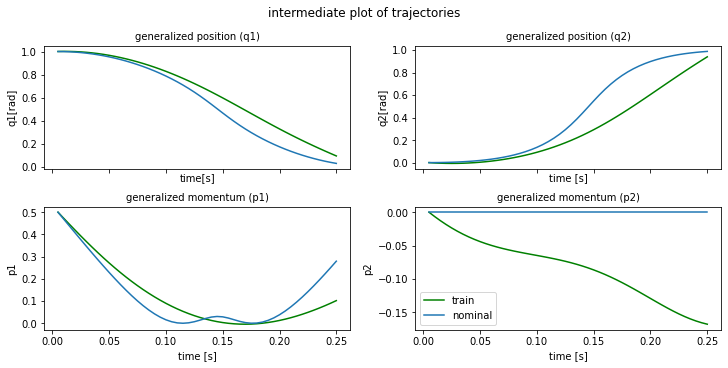

plot time : 1.2290925979614258
epoch  130 | train time 2.03 | train loss 4.147900e-02 | test loss 4.048375e-02 | test time 0.21  
epoch  131 | train time 0.88 | train loss 3.874969e-02 
epoch  132 | train time 0.94 | train loss 3.864726e-02 
epoch  133 | train time 0.85 | train loss 3.766903e-02 
epoch  134 | train time 0.85 | train loss 3.622717e-02 
epoch  135 | train time 0.86 | train loss 3.599333e-02 
epoch  136 | train time 0.78 | train loss 3.491970e-02 
epoch  137 | train time 0.94 | train loss 3.362341e-02 
epoch  138 | train time 0.82 | train loss 3.382799e-02 
epoch  139 | train time 0.87 | train loss 3.204292e-02 


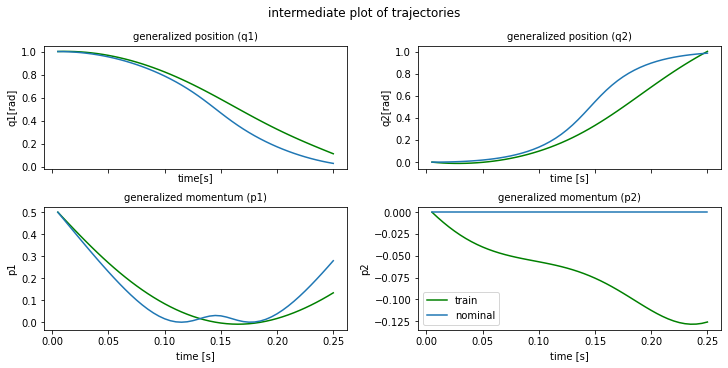

plot time : 1.1748077869415283
epoch  140 | train time 1.99 | train loss 3.186746e-02 | test loss 3.372832e-02 | test time 0.21  
epoch  141 | train time 0.80 | train loss 3.115486e-02 
epoch  142 | train time 0.79 | train loss 3.005820e-02 
epoch  143 | train time 0.79 | train loss 2.985650e-02 
epoch  144 | train time 0.78 | train loss 2.899453e-02 
epoch  145 | train time 0.80 | train loss 2.867361e-02 
epoch  146 | train time 0.78 | train loss 2.804952e-02 
epoch  147 | train time 0.80 | train loss 2.725939e-02 
epoch  148 | train time 0.78 | train loss 2.709639e-02 
epoch  149 | train time 0.78 | train loss 2.653279e-02 


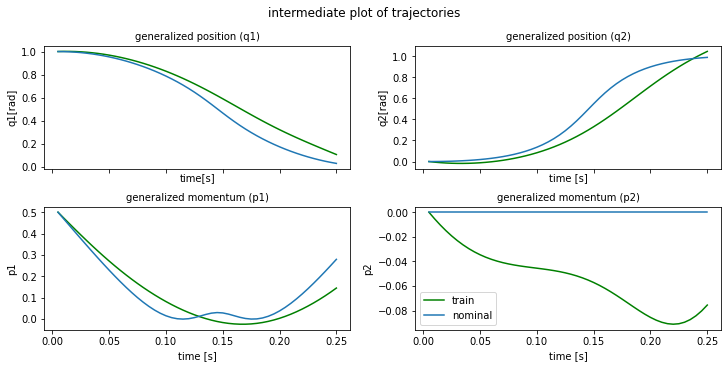

plot time : 1.231572151184082
epoch  150 | train time 2.04 | train loss 2.633705e-02 | test loss 2.897594e-02 | test time 0.21  
epoch  151 | train time 0.77 | train loss 2.652837e-02 
epoch  152 | train time 0.78 | train loss 2.695484e-02 
epoch  153 | train time 0.80 | train loss 3.101649e-02 
epoch  154 | train time 0.78 | train loss 3.483715e-02 
epoch  155 | train time 0.79 | train loss 4.621790e-02 
epoch  156 | train time 0.94 | train loss 2.595874e-02 
epoch  157 | train time 0.78 | train loss 4.811726e-02 
epoch  158 | train time 0.77 | train loss 4.251819e-02 
epoch  159 | train time 0.81 | train loss 4.819709e-02 


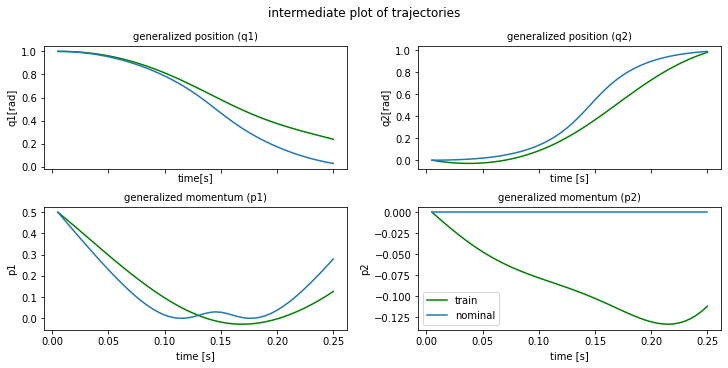

plot time : 1.183783769607544
epoch  160 | train time 2.05 | train loss 2.983938e-02 | test loss 4.935121e-02 | test time 0.21  
epoch  161 | train time 0.78 | train loss 4.380413e-02 
epoch  162 | train time 0.79 | train loss 3.082658e-02 
epoch  163 | train time 0.81 | train loss 3.338574e-02 
epoch  164 | train time 0.77 | train loss 3.651609e-02 
epoch  165 | train time 0.78 | train loss 2.882463e-02 
epoch  166 | train time 0.78 | train loss 3.209525e-02 
epoch  167 | train time 0.79 | train loss 3.366832e-02 
epoch  168 | train time 0.77 | train loss 2.748446e-02 
epoch  169 | train time 0.88 | train loss 3.031640e-02 


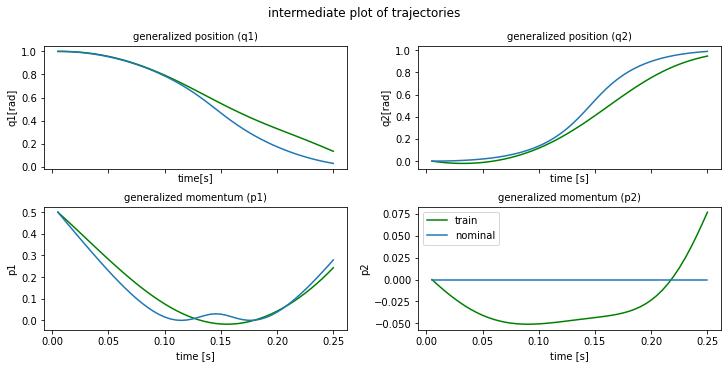

plot time : 1.1860089302062988
epoch  170 | train time 1.99 | train loss 3.037241e-02 | test loss 2.969185e-02 | test time 0.21  
epoch  171 | train time 0.78 | train loss 2.586340e-02 
epoch  172 | train time 0.79 | train loss 2.908991e-02 
epoch  173 | train time 0.82 | train loss 2.775297e-02 
epoch  174 | train time 0.80 | train loss 2.544834e-02 
epoch  175 | train time 0.79 | train loss 2.766647e-02 
epoch  176 | train time 0.78 | train loss 2.618824e-02 
epoch  177 | train time 0.85 | train loss 2.425544e-02 
epoch  178 | train time 0.93 | train loss 2.623536e-02 
epoch  179 | train time 0.86 | train loss 2.436350e-02 


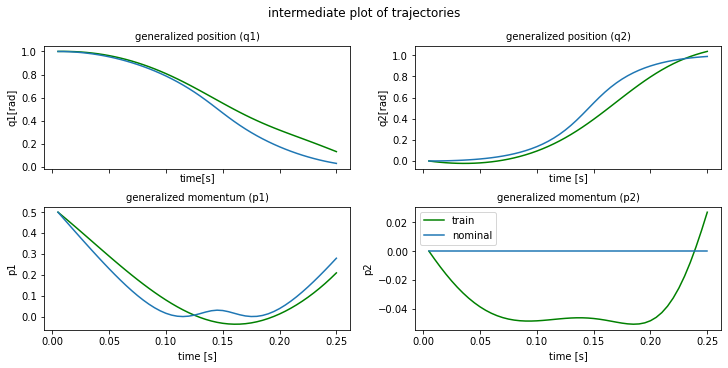

plot time : 1.3115005493164062
epoch  180 | train time 2.12 | train loss 2.379147e-02 | test loss 2.732756e-02 | test time 0.21  
epoch  181 | train time 0.81 | train loss 2.509757e-02 
epoch  182 | train time 0.80 | train loss 2.324454e-02 
epoch  183 | train time 0.78 | train loss 2.377795e-02 
epoch  184 | train time 0.81 | train loss 2.365832e-02 
epoch  185 | train time 0.98 | train loss 2.274323e-02 
epoch  186 | train time 0.94 | train loss 2.339617e-02 
epoch  187 | train time 0.79 | train loss 2.261431e-02 
epoch  188 | train time 0.78 | train loss 2.274088e-02 
epoch  189 | train time 0.79 | train loss 2.269651e-02 


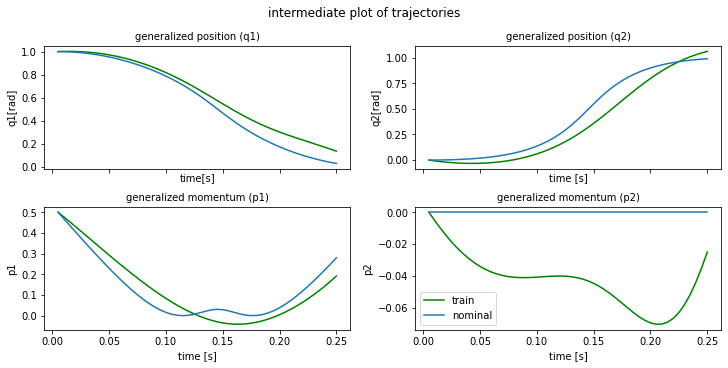

plot time : 1.1667859554290771
epoch  190 | train time 1.96 | train loss 2.216516e-02 | test loss 2.437697e-02 | test time 0.20  
epoch  191 | train time 0.78 | train loss 2.256725e-02 
epoch  192 | train time 0.78 | train loss 2.191999e-02 
epoch  193 | train time 0.79 | train loss 2.211425e-02 
epoch  194 | train time 0.78 | train loss 2.203443e-02 
epoch  195 | train time 0.83 | train loss 2.164110e-02 
epoch  196 | train time 0.95 | train loss 2.194079e-02 
epoch  197 | train time 0.90 | train loss 2.142309e-02 
epoch  198 | train time 0.78 | train loss 2.155525e-02 
epoch  199 | train time 0.86 | train loss 2.129275e-02 
horizon length : 100
min max values updated


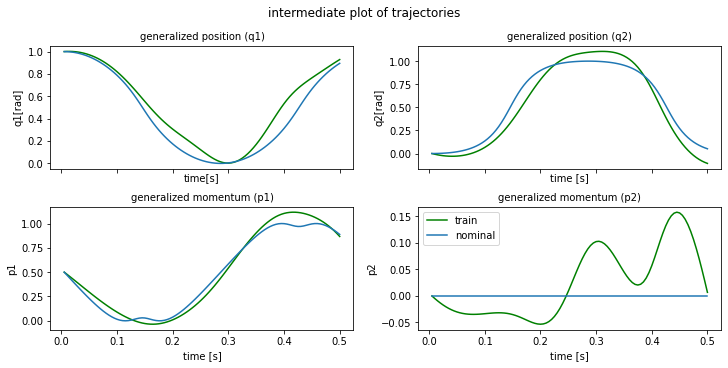

plot time : 1.3091232776641846
min max values updated
epoch  200 | train time 2.91 | train loss 2.306348e-01 | test loss 3.003397e-01 | test time 0.46  
epoch  201 | train time 1.56 | train loss 3.159028e-01 
epoch  202 | train time 1.73 | train loss 2.589334e-01 
epoch  203 | train time 1.66 | train loss 3.248877e-01 
epoch  204 | train time 1.69 | train loss 3.252487e-01 
epoch  205 | train time 1.58 | train loss 2.281435e-01 
epoch  206 | train time 1.69 | train loss 2.501653e-01 
epoch  207 | train time 1.74 | train loss 1.880777e-01 
epoch  208 | train time 1.69 | train loss 1.398737e-01 
epoch  209 | train time 1.56 | train loss 1.399401e-01 


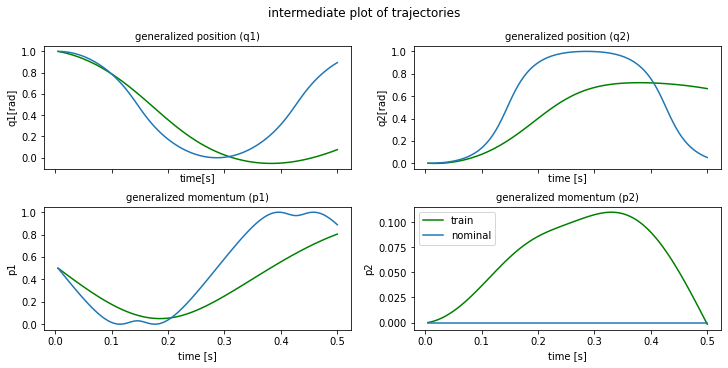

plot time : 1.173391580581665
epoch  210 | train time 2.89 | train loss 1.299838e-01 | test loss 1.341195e-01 | test time 0.44  
epoch  211 | train time 1.67 | train loss 1.376537e-01 
epoch  212 | train time 1.61 | train loss 1.178378e-01 
epoch  213 | train time 1.57 | train loss 1.206133e-01 
epoch  214 | train time 1.57 | train loss 1.042303e-01 
epoch  215 | train time 1.68 | train loss 1.161959e-01 
epoch  216 | train time 1.63 | train loss 1.173175e-01 
epoch  217 | train time 1.56 | train loss 1.124096e-01 
epoch  218 | train time 1.61 | train loss 1.059165e-01 
epoch  219 | train time 1.59 | train loss 1.023695e-01 


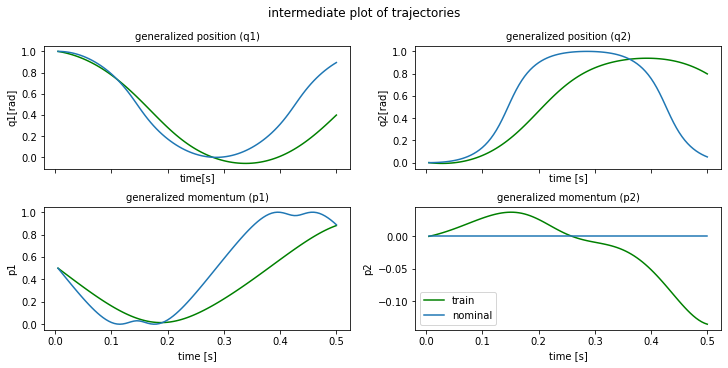

plot time : 1.207956314086914
epoch  220 | train time 2.79 | train loss 9.234601e-02 | test loss 8.385442e-02 | test time 0.40  
epoch  221 | train time 1.68 | train loss 9.350131e-02 
epoch  222 | train time 1.56 | train loss 9.605832e-02 
epoch  223 | train time 1.60 | train loss 8.846841e-02 
epoch  224 | train time 1.60 | train loss 8.656038e-02 
epoch  225 | train time 1.59 | train loss 8.267200e-02 
epoch  226 | train time 1.81 | train loss 7.748166e-02 
epoch  227 | train time 1.77 | train loss 7.362396e-02 
epoch  228 | train time 1.74 | train loss 7.629408e-02 
epoch  229 | train time 1.55 | train loss 7.157034e-02 


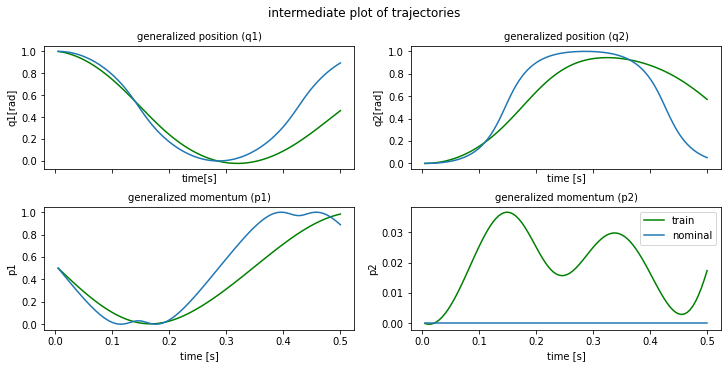

plot time : 1.2356791496276855
epoch  230 | train time 2.95 | train loss 6.673329e-02 | test loss 9.033523e-02 | test time 0.40  
epoch  231 | train time 1.74 | train loss 6.856947e-02 
epoch  232 | train time 1.75 | train loss 6.443641e-02 
epoch  233 | train time 1.62 | train loss 6.093829e-02 
epoch  234 | train time 1.65 | train loss 6.213206e-02 
epoch  235 | train time 1.57 | train loss 6.009207e-02 
epoch  236 | train time 1.71 | train loss 5.987216e-02 
epoch  237 | train time 1.56 | train loss 5.797892e-02 
epoch  238 | train time 1.65 | train loss 5.658425e-02 
epoch  239 | train time 1.72 | train loss 5.783307e-02 


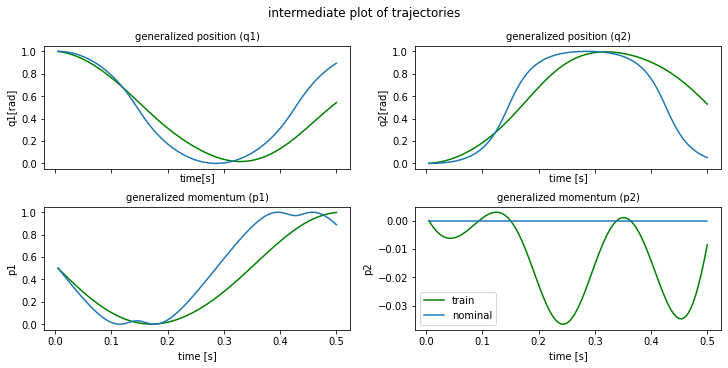

plot time : 1.1875991821289062
epoch  240 | train time 2.75 | train loss 5.600144e-02 | test loss 7.028794e-02 | test time 0.41  
epoch  241 | train time 2.02 | train loss 5.463724e-02 
epoch  242 | train time 2.12 | train loss 5.399396e-02 
epoch  243 | train time 1.56 | train loss 5.271753e-02 
epoch  244 | train time 1.66 | train loss 5.245914e-02 
epoch  245 | train time 1.60 | train loss 5.104641e-02 
epoch  246 | train time 1.58 | train loss 5.132658e-02 
epoch  247 | train time 1.59 | train loss 5.089118e-02 
epoch  248 | train time 1.60 | train loss 5.024908e-02 
epoch  249 | train time 1.67 | train loss 4.984165e-02 


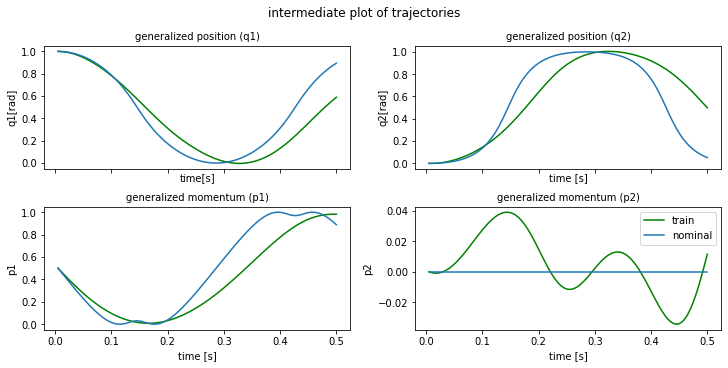

plot time : 1.1490440368652344
epoch  250 | train time 2.73 | train loss 5.010226e-02 | test loss 6.278028e-02 | test time 0.41  
epoch  251 | train time 1.69 | train loss 4.939753e-02 
epoch  252 | train time 1.59 | train loss 4.889388e-02 
epoch  253 | train time 1.87 | train loss 4.863281e-02 
epoch  254 | train time 1.62 | train loss 4.861879e-02 
epoch  255 | train time 1.58 | train loss 4.824723e-02 
epoch  256 | train time 1.56 | train loss 4.789845e-02 
epoch  257 | train time 1.54 | train loss 4.769715e-02 
epoch  258 | train time 1.55 | train loss 4.742782e-02 
epoch  259 | train time 1.55 | train loss 4.734580e-02 


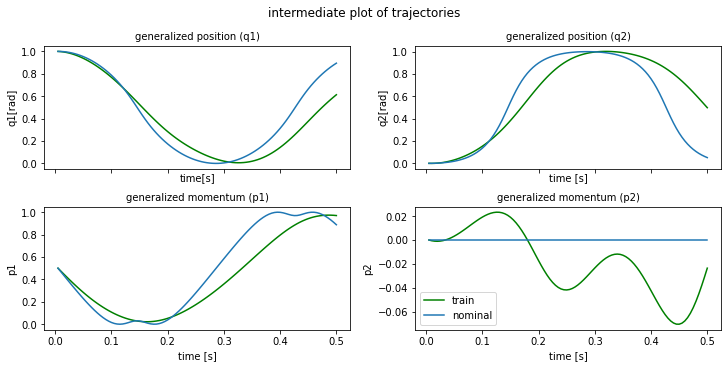

plot time : 1.1830105781555176
epoch  260 | train time 2.80 | train loss 4.732707e-02 | test loss 6.057961e-02 | test time 0.40  
epoch  261 | train time 1.56 | train loss 4.698690e-02 
epoch  262 | train time 1.54 | train loss 4.672546e-02 
epoch  263 | train time 1.56 | train loss 4.665136e-02 
epoch  264 | train time 1.71 | train loss 4.657155e-02 
epoch  265 | train time 1.66 | train loss 4.622357e-02 
epoch  266 | train time 1.68 | train loss 4.608689e-02 
epoch  267 | train time 1.55 | train loss 4.585716e-02 
epoch  268 | train time 1.65 | train loss 4.569330e-02 
epoch  269 | train time 1.58 | train loss 4.543374e-02 


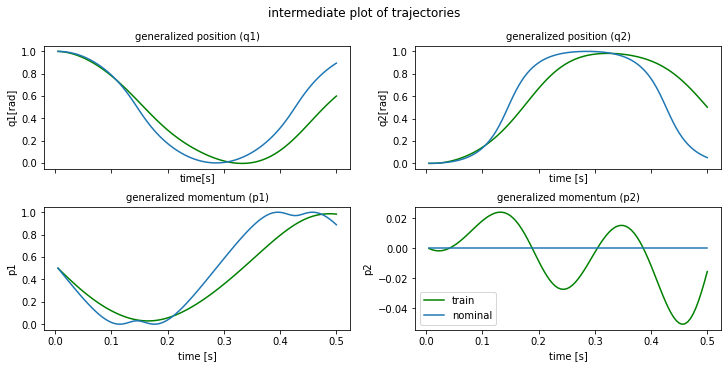

plot time : 1.2344238758087158
epoch  270 | train time 2.84 | train loss 4.531152e-02 | test loss 5.763273e-02 | test time 0.53  
epoch  271 | train time 1.70 | train loss 4.507538e-02 
epoch  272 | train time 1.57 | train loss 4.494362e-02 
epoch  273 | train time 1.67 | train loss 4.481855e-02 
epoch  274 | train time 1.73 | train loss 4.466256e-02 
epoch  275 | train time 1.65 | train loss 4.466465e-02 
epoch  276 | train time 1.80 | train loss 4.498453e-02 
epoch  277 | train time 1.59 | train loss 4.617705e-02 
epoch  278 | train time 1.60 | train loss 5.073820e-02 
epoch  279 | train time 1.56 | train loss 6.010695e-02 


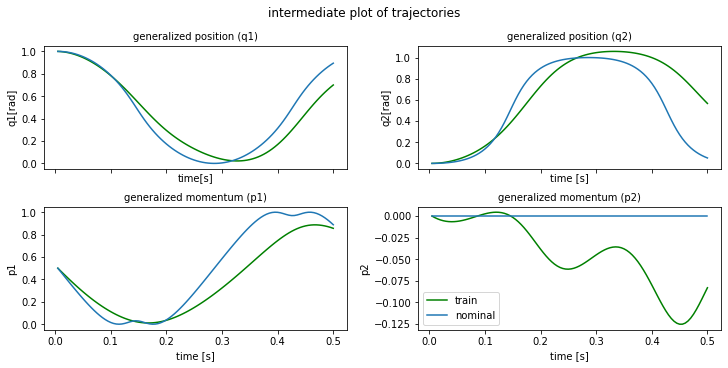

plot time : 1.1884045600891113
epoch  280 | train time 2.76 | train loss 8.431957e-02 | test loss 6.840071e-02 | test time 0.40  
epoch  281 | train time 1.59 | train loss 5.776615e-02 
epoch  282 | train time 1.65 | train loss 5.740348e-02 
epoch  283 | train time 1.59 | train loss 7.119308e-02 
epoch  284 | train time 1.63 | train loss 5.666363e-02 
epoch  285 | train time 1.56 | train loss 6.308214e-02 
epoch  286 | train time 1.56 | train loss 5.174772e-02 
epoch  287 | train time 1.66 | train loss 5.344378e-02 
epoch  288 | train time 1.55 | train loss 5.633084e-02 
epoch  289 | train time 1.57 | train loss 4.809697e-02 


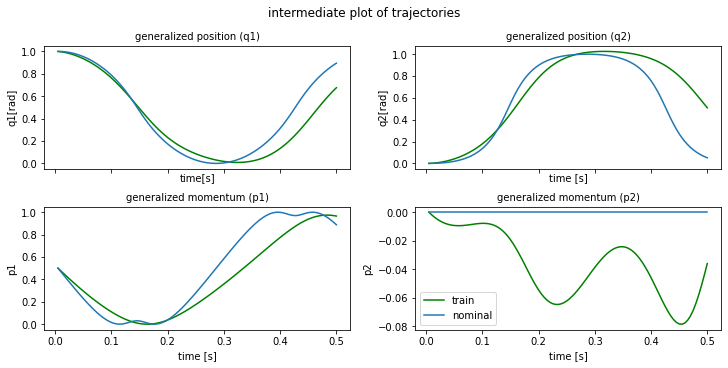

plot time : 1.187575101852417
epoch  290 | train time 2.78 | train loss 5.296211e-02 | test loss 6.770921e-02 | test time 0.42  
epoch  291 | train time 1.55 | train loss 5.121092e-02 
epoch  292 | train time 1.56 | train loss 4.749756e-02 
epoch  293 | train time 1.56 | train loss 4.903239e-02 
epoch  294 | train time 1.64 | train loss 5.015698e-02 
epoch  295 | train time 1.61 | train loss 4.510077e-02 
epoch  296 | train time 1.68 | train loss 4.892414e-02 
epoch  297 | train time 1.75 | train loss 4.594751e-02 
epoch  298 | train time 1.60 | train loss 4.539225e-02 
epoch  299 | train time 1.56 | train loss 4.710663e-02 
horizon length : 150
min max values updated


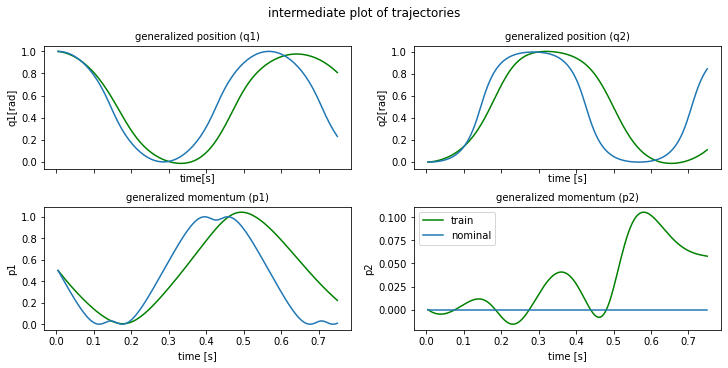

plot time : 1.2738938331604004
min max values updated
epoch  300 | train time 3.67 | train loss 1.069582e-01 | test loss 1.286058e-01 | test time 0.63  
epoch  301 | train time 2.37 | train loss 1.044251e-01 
epoch  302 | train time 2.66 | train loss 1.098454e-01 
epoch  303 | train time 2.65 | train loss 1.920338e-01 
epoch  304 | train time 2.33 | train loss 5.295281e-01 
epoch  305 | train time 2.46 | train loss 1.620431e-01 
epoch  306 | train time 2.64 | train loss 4.440998e-01 
epoch  307 | train time 2.42 | train loss 2.791637e-01 
epoch  308 | train time 2.39 | train loss 2.885859e-01 
epoch  309 | train time 2.37 | train loss 1.926007e-01 


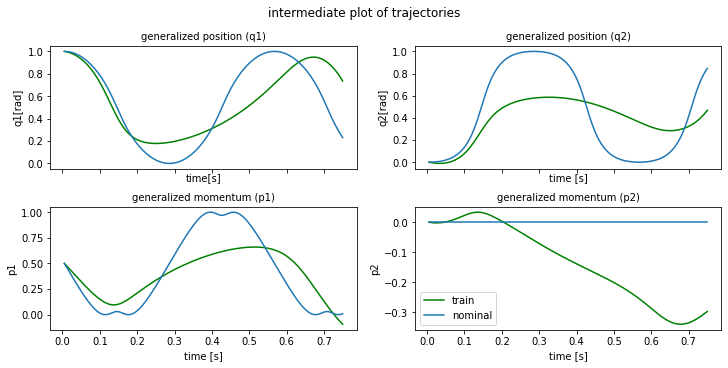

plot time : 1.3152830600738525
epoch  310 | train time 3.78 | train loss 1.984878e-01 | test loss 2.188444e-01 | test time 0.78  
epoch  311 | train time 2.42 | train loss 2.095387e-01 
epoch  312 | train time 2.38 | train loss 2.196242e-01 
epoch  313 | train time 2.45 | train loss 2.172818e-01 
epoch  314 | train time 2.33 | train loss 1.889737e-01 
epoch  315 | train time 2.41 | train loss 1.738401e-01 
epoch  316 | train time 2.35 | train loss 1.744477e-01 
epoch  317 | train time 2.41 | train loss 1.789655e-01 
epoch  318 | train time 2.40 | train loss 1.776898e-01 
epoch  319 | train time 2.34 | train loss 1.599624e-01 


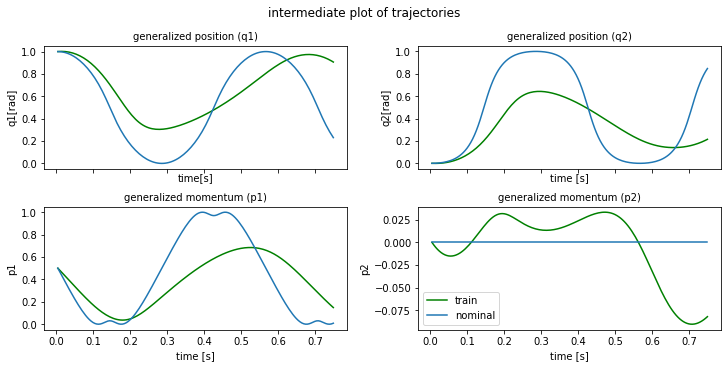

plot time : 1.2265582084655762
epoch  320 | train time 3.58 | train loss 1.547310e-01 | test loss 2.014002e-01 | test time 0.60  
epoch  321 | train time 2.39 | train loss 1.593365e-01 
epoch  322 | train time 2.32 | train loss 1.548682e-01 
epoch  323 | train time 2.32 | train loss 1.422782e-01 
epoch  324 | train time 2.52 | train loss 1.325551e-01 
epoch  325 | train time 2.33 | train loss 1.315603e-01 
epoch  326 | train time 2.30 | train loss 1.312303e-01 
epoch  327 | train time 2.31 | train loss 1.213665e-01 
epoch  328 | train time 2.37 | train loss 1.120675e-01 
epoch  329 | train time 2.47 | train loss 1.134321e-01 


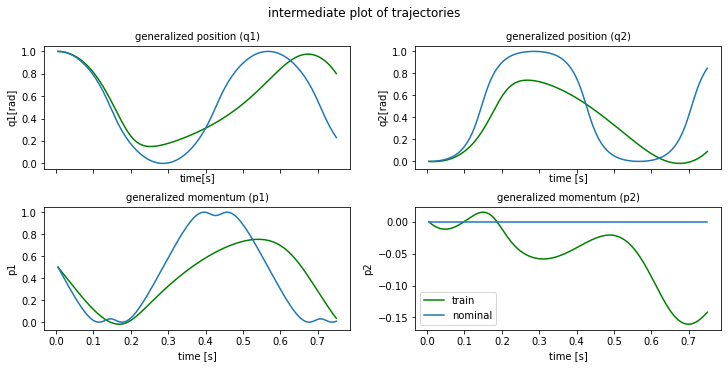

plot time : 1.1927335262298584
epoch  330 | train time 3.62 | train loss 1.167044e-01 | test loss 1.487410e-01 | test time 0.68  
epoch  331 | train time 2.32 | train loss 1.169347e-01 
epoch  332 | train time 2.32 | train loss 1.130875e-01 
epoch  333 | train time 2.65 | train loss 1.083056e-01 
epoch  334 | train time 2.33 | train loss 1.083200e-01 
epoch  335 | train time 2.54 | train loss 1.061971e-01 
epoch  336 | train time 2.53 | train loss 1.005714e-01 
epoch  337 | train time 2.32 | train loss 9.814793e-02 
epoch  338 | train time 2.46 | train loss 9.839800e-02 
epoch  339 | train time 2.48 | train loss 9.905732e-02 


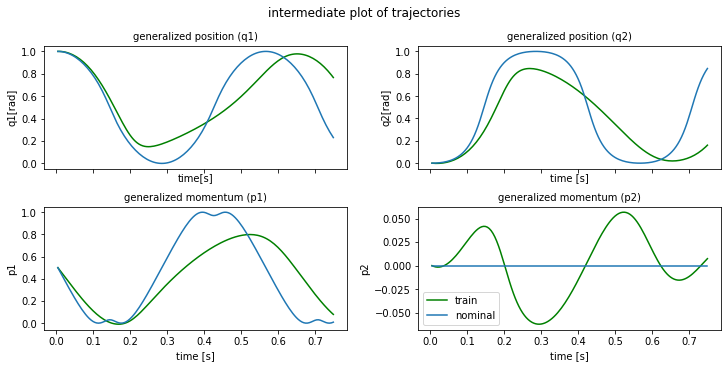

plot time : 1.7799341678619385
epoch  340 | train time 4.87 | train loss 9.572285e-02 | test loss 1.173348e-01 | test time 0.63  
epoch  341 | train time 2.43 | train loss 9.387846e-02 
epoch  342 | train time 2.53 | train loss 9.371077e-02 
epoch  343 | train time 2.38 | train loss 9.350531e-02 
epoch  344 | train time 2.37 | train loss 9.015627e-02 
epoch  345 | train time 2.47 | train loss 8.850111e-02 
epoch  346 | train time 2.44 | train loss 8.794209e-02 
epoch  347 | train time 2.33 | train loss 8.668725e-02 
epoch  348 | train time 2.32 | train loss 8.413805e-02 
epoch  349 | train time 2.44 | train loss 8.327377e-02 


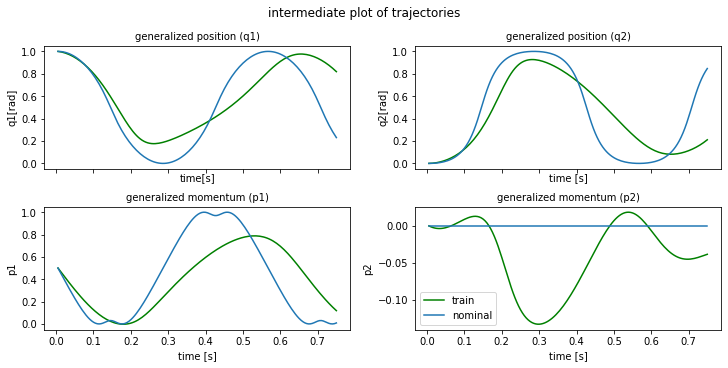

plot time : 1.1845202445983887
epoch  350 | train time 3.51 | train loss 8.308801e-02 | test loss 9.703014e-02 | test time 0.60  
epoch  351 | train time 2.40 | train loss 8.226618e-02 
epoch  352 | train time 2.59 | train loss 8.126663e-02 
epoch  353 | train time 2.49 | train loss 8.096570e-02 
epoch  354 | train time 2.39 | train loss 7.989590e-02 
epoch  355 | train time 2.46 | train loss 7.870518e-02 
epoch  356 | train time 2.29 | train loss 7.829948e-02 
epoch  357 | train time 2.40 | train loss 7.746015e-02 
epoch  358 | train time 2.29 | train loss 7.614315e-02 
epoch  359 | train time 2.48 | train loss 7.521553e-02 


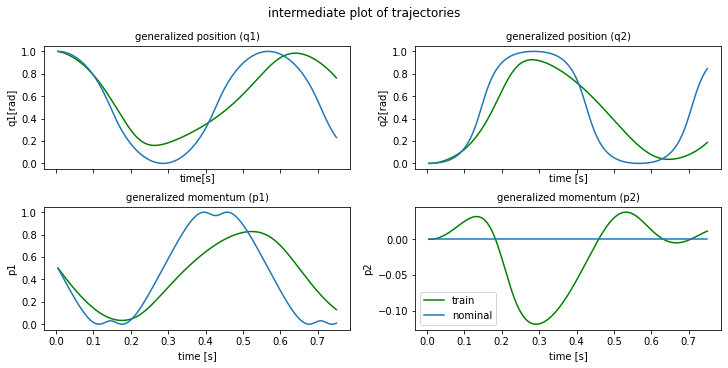

plot time : 1.193260908126831
epoch  360 | train time 3.64 | train loss 7.486513e-02 | test loss 8.589067e-02 | test time 0.68  
epoch  361 | train time 2.32 | train loss 7.422361e-02 
epoch  362 | train time 2.74 | train loss 7.352635e-02 
epoch  363 | train time 2.41 | train loss 7.284644e-02 
epoch  364 | train time 2.73 | train loss 7.205194e-02 
epoch  365 | train time 2.38 | train loss 7.152126e-02 
epoch  366 | train time 2.31 | train loss 7.088303e-02 
epoch  367 | train time 2.58 | train loss 7.007101e-02 
epoch  368 | train time 2.35 | train loss 6.953792e-02 
epoch  369 | train time 2.37 | train loss 6.898723e-02 


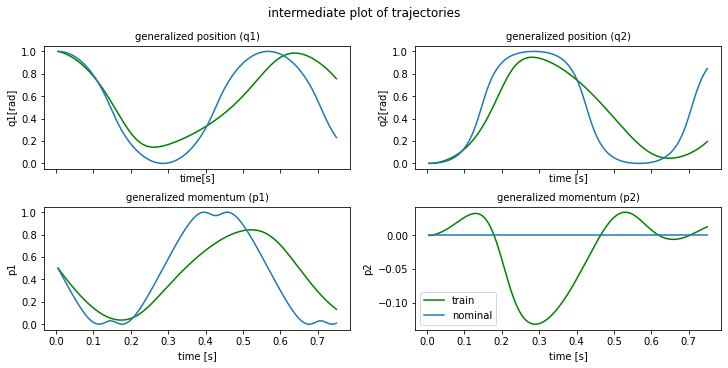

plot time : 1.2604038715362549
epoch  370 | train time 3.64 | train loss 6.840163e-02 | test loss 7.850735e-02 | test time 0.59  
epoch  371 | train time 2.37 | train loss 6.788932e-02 
epoch  372 | train time 2.39 | train loss 6.729405e-02 
epoch  373 | train time 2.44 | train loss 6.697858e-02 
epoch  374 | train time 2.43 | train loss 6.655955e-02 
epoch  375 | train time 2.32 | train loss 6.607629e-02 
epoch  376 | train time 2.33 | train loss 6.581393e-02 
epoch  377 | train time 2.54 | train loss 6.569615e-02 
epoch  378 | train time 2.40 | train loss 6.638465e-02 
epoch  379 | train time 2.43 | train loss 6.836594e-02 


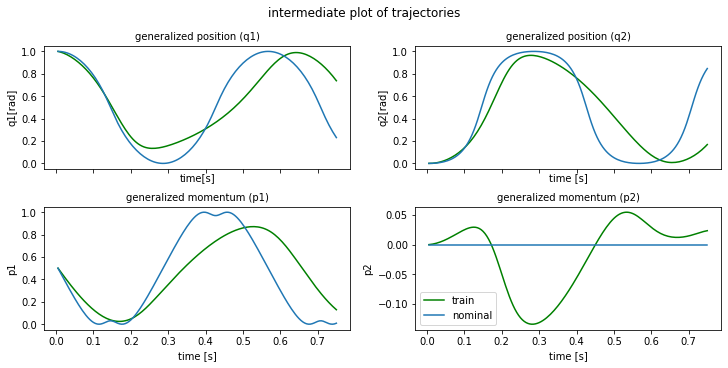

plot time : 1.2083587646484375
epoch  380 | train time 3.74 | train loss 7.709900e-02 | test loss 8.887308e-02 | test time 0.60  
epoch  381 | train time 2.47 | train loss 8.517647e-02 
epoch  382 | train time 2.31 | train loss 9.637484e-02 
epoch  383 | train time 2.42 | train loss 6.642535e-02 
epoch  384 | train time 2.61 | train loss 9.214773e-02 
epoch  385 | train time 2.35 | train loss 1.049274e-01 
epoch  386 | train time 2.34 | train loss 8.538598e-02 
epoch  387 | train time 2.48 | train loss 9.629241e-02 
epoch  388 | train time 2.37 | train loss 6.743524e-02 
epoch  389 | train time 2.42 | train loss 8.898773e-02 


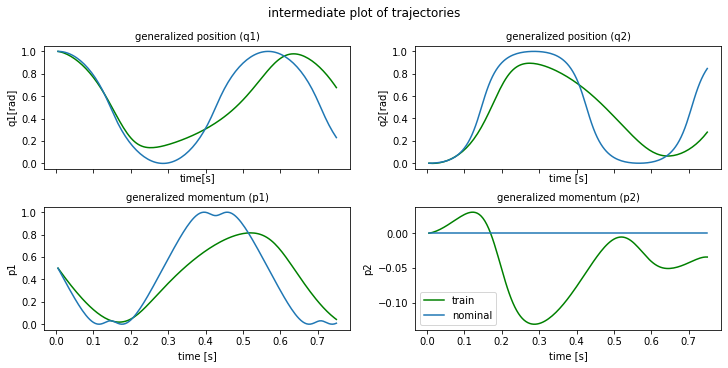

plot time : 1.1961538791656494
epoch  390 | train time 3.61 | train loss 6.735856e-02 | test loss 9.511101e-02 | test time 0.76  
epoch  391 | train time 2.58 | train loss 8.566128e-02 
epoch  392 | train time 2.35 | train loss 6.973197e-02 
epoch  393 | train time 2.43 | train loss 7.829825e-02 
epoch  394 | train time 2.50 | train loss 6.759378e-02 
epoch  395 | train time 2.48 | train loss 7.692136e-02 
epoch  396 | train time 2.35 | train loss 6.598224e-02 
epoch  397 | train time 2.35 | train loss 7.346842e-02 
epoch  398 | train time 2.33 | train loss 6.324352e-02 
epoch  399 | train time 2.35 | train loss 7.145375e-02 
horizon length : 200
min max values updated


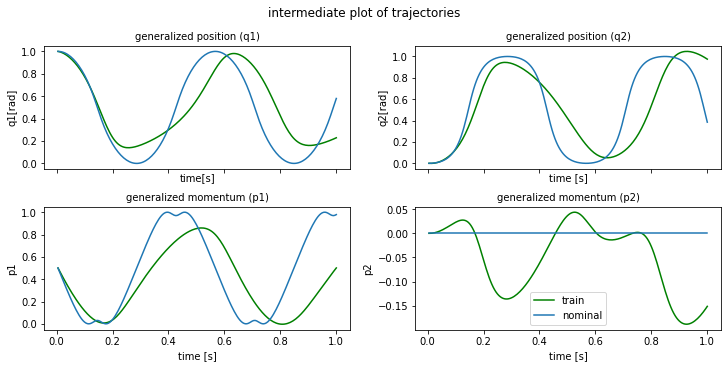

plot time : 1.253023386001587
min max values updated
epoch  400 | train time 4.42 | train loss 9.096482e-02 | test loss 9.956786e-02 | test time 0.87  
epoch  401 | train time 3.18 | train loss 1.019416e-01 
epoch  402 | train time 3.08 | train loss 1.659223e-01 
epoch  403 | train time 3.13 | train loss 1.506970e-01 
epoch  404 | train time 3.20 | train loss 1.671850e-01 
epoch  405 | train time 3.14 | train loss 1.497450e-01 
epoch  406 | train time 3.58 | train loss 1.184357e-01 
epoch  407 | train time 3.21 | train loss 1.388766e-01 
epoch  408 | train time 3.10 | train loss 1.164836e-01 
epoch  409 | train time 3.26 | train loss 1.225626e-01 


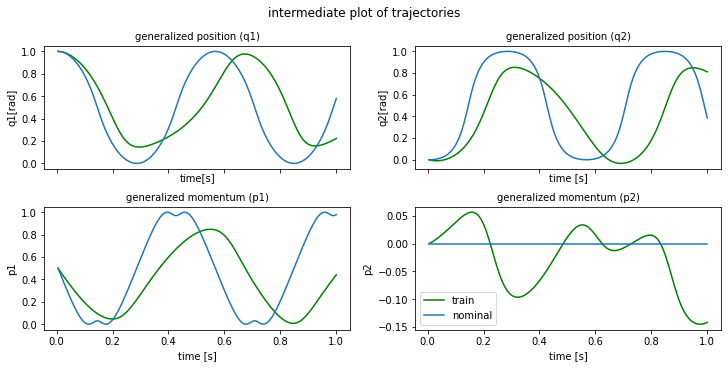

plot time : 1.246262550354004
epoch  410 | train time 4.50 | train loss 1.437865e-01 | test loss 9.760944e-02 | test time 0.81  
epoch  411 | train time 3.14 | train loss 9.395938e-02 
epoch  412 | train time 3.08 | train loss 1.324012e-01 
epoch  413 | train time 3.18 | train loss 1.269808e-01 
epoch  414 | train time 4.31 | train loss 1.203528e-01 
epoch  415 | train time 3.42 | train loss 1.363714e-01 
epoch  416 | train time 3.21 | train loss 1.202405e-01 
epoch  417 | train time 3.10 | train loss 1.229244e-01 
epoch  418 | train time 3.21 | train loss 1.111109e-01 
epoch  419 | train time 3.28 | train loss 1.193005e-01 


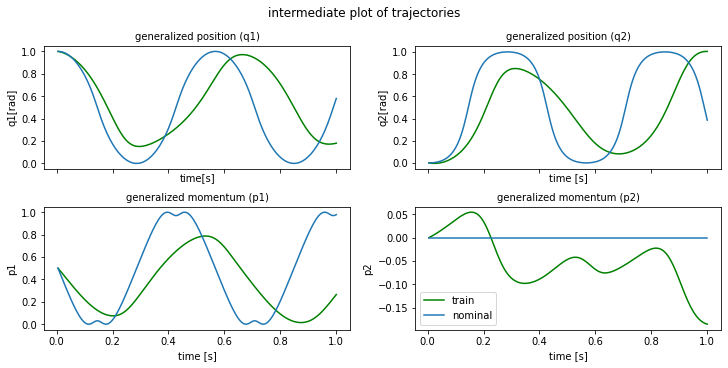

plot time : 1.2357652187347412
epoch  420 | train time 4.52 | train loss 1.105749e-01 | test loss 1.123752e-01 | test time 1.01  
epoch  421 | train time 3.38 | train loss 1.031693e-01 
epoch  422 | train time 3.34 | train loss 1.117710e-01 
epoch  423 | train time 3.32 | train loss 8.838641e-02 
epoch  424 | train time 3.07 | train loss 1.209900e-01 
epoch  425 | train time 3.28 | train loss 1.088399e-01 
epoch  426 | train time 3.23 | train loss 9.072389e-02 
epoch  427 | train time 3.34 | train loss 1.161417e-01 
epoch  428 | train time 3.38 | train loss 9.677456e-02 
epoch  429 | train time 3.27 | train loss 9.564512e-02 


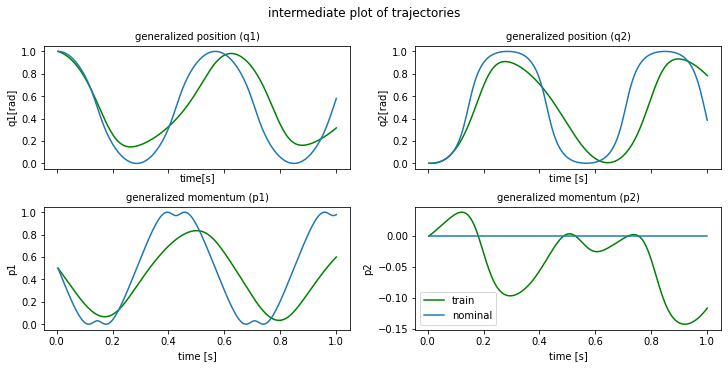

plot time : 1.1787919998168945
epoch  430 | train time 4.51 | train loss 9.023281e-02 | test loss 1.127615e-01 | test time 0.86  
epoch  431 | train time 3.25 | train loss 1.099780e-01 
epoch  432 | train time 3.30 | train loss 9.119166e-02 
epoch  433 | train time 3.16 | train loss 9.641599e-02 
epoch  434 | train time 3.30 | train loss 1.161919e-01 
epoch  435 | train time 3.16 | train loss 8.392147e-02 
epoch  436 | train time 3.34 | train loss 9.027643e-02 
epoch  437 | train time 3.12 | train loss 9.759751e-02 
epoch  438 | train time 3.25 | train loss 8.392135e-02 
epoch  439 | train time 3.19 | train loss 9.192572e-02 


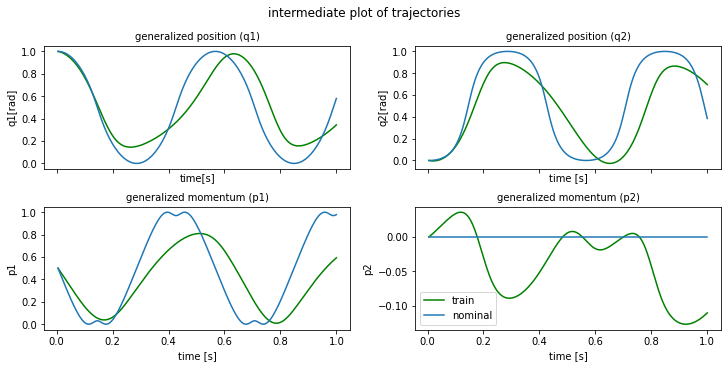

plot time : 1.2239792346954346
epoch  440 | train time 4.46 | train loss 9.935652e-02 | test loss 8.508448e-02 | test time 0.81  
epoch  441 | train time 3.15 | train loss 8.279828e-02 
epoch  442 | train time 3.31 | train loss 1.043467e-01 
epoch  443 | train time 3.23 | train loss 9.780432e-02 
epoch  444 | train time 3.34 | train loss 8.252478e-02 
epoch  445 | train time 3.09 | train loss 1.116118e-01 
epoch  446 | train time 3.26 | train loss 8.625664e-02 
epoch  447 | train time 3.25 | train loss 9.175704e-02 
epoch  448 | train time 3.11 | train loss 9.323229e-02 
epoch  449 | train time 3.57 | train loss 7.882582e-02 


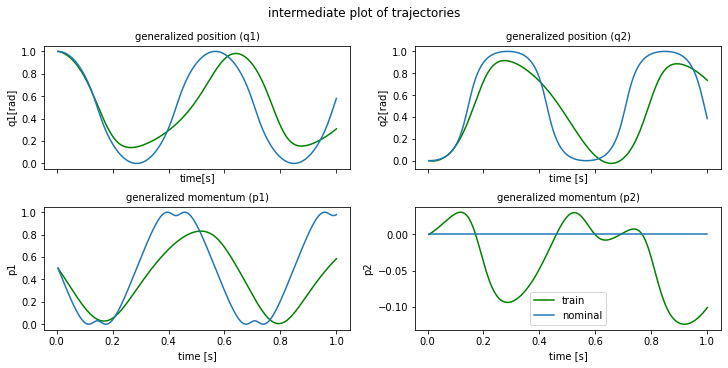

plot time : 1.2349605560302734
epoch  450 | train time 4.43 | train loss 8.962682e-02 | test loss 8.066008e-02 | test time 0.80  
epoch  451 | train time 3.12 | train loss 7.886694e-02 
epoch  452 | train time 3.13 | train loss 8.378669e-02 
epoch  453 | train time 3.14 | train loss 8.825735e-02 
epoch  454 | train time 3.22 | train loss 7.693970e-02 
epoch  455 | train time 3.25 | train loss 8.878010e-02 
epoch  456 | train time 3.07 | train loss 8.666275e-02 
epoch  457 | train time 3.57 | train loss 7.926749e-02 
epoch  458 | train time 3.16 | train loss 8.698268e-02 
epoch  459 | train time 3.40 | train loss 8.305747e-02 


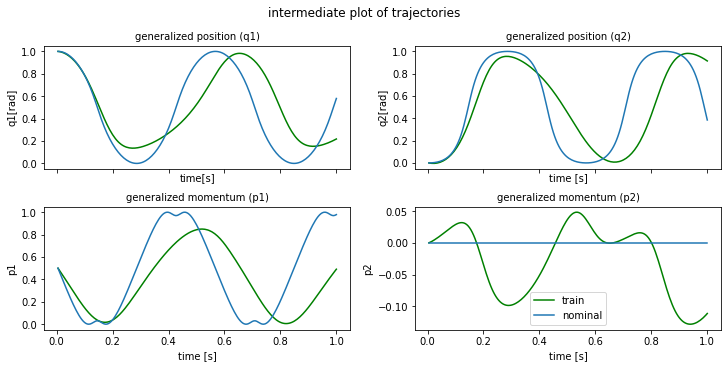

plot time : 1.2009022235870361
epoch  460 | train time 4.40 | train loss 7.815615e-02 | test loss 8.017700e-02 | test time 0.81  
epoch  461 | train time 3.37 | train loss 7.943718e-02 
epoch  462 | train time 3.32 | train loss 8.132741e-02 
epoch  463 | train time 3.21 | train loss 8.078337e-02 
epoch  464 | train time 3.12 | train loss 8.015891e-02 
epoch  465 | train time 3.16 | train loss 7.313877e-02 
epoch  466 | train time 3.13 | train loss 8.280825e-02 
epoch  467 | train time 3.07 | train loss 9.028646e-02 
epoch  468 | train time 3.31 | train loss 8.264799e-02 
epoch  469 | train time 3.24 | train loss 9.748128e-02 


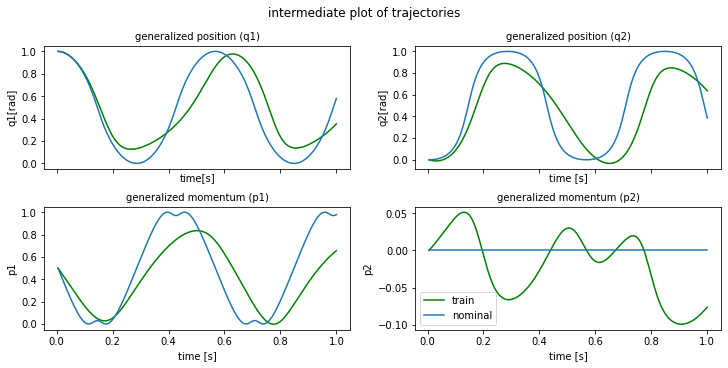

plot time : 1.1765570640563965
epoch  470 | train time 4.48 | train loss 7.956409e-02 | test loss 9.581040e-02 | test time 0.80  
epoch  471 | train time 3.25 | train loss 9.813152e-02 
epoch  472 | train time 3.40 | train loss 9.172603e-02 
epoch  473 | train time 3.15 | train loss 8.065068e-02 
epoch  474 | train time 4.20 | train loss 1.047866e-01 
epoch  475 | train time 3.13 | train loss 8.891664e-02 
epoch  476 | train time 3.09 | train loss 1.040090e-01 
epoch  477 | train time 3.24 | train loss 8.660255e-02 
epoch  478 | train time 3.24 | train loss 9.260936e-02 
epoch  479 | train time 3.17 | train loss 7.899091e-02 


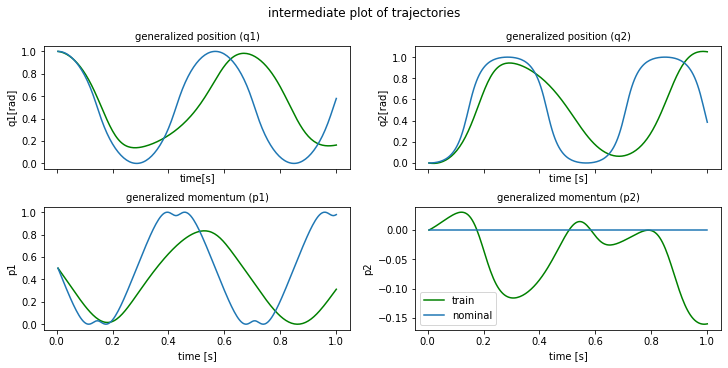

plot time : 1.1592016220092773
epoch  480 | train time 4.31 | train loss 9.552029e-02 | test loss 7.536602e-02 | test time 0.86  
epoch  481 | train time 3.07 | train loss 7.840721e-02 
epoch  482 | train time 3.27 | train loss 8.336398e-02 
epoch  483 | train time 3.26 | train loss 8.419040e-02 
epoch  484 | train time 3.24 | train loss 7.747719e-02 
epoch  485 | train time 3.37 | train loss 8.238631e-02 
epoch  486 | train time 3.14 | train loss 7.924984e-02 
epoch  487 | train time 3.56 | train loss 7.379996e-02 
epoch  488 | train time 3.23 | train loss 7.595655e-02 
epoch  489 | train time 3.18 | train loss 7.346042e-02 


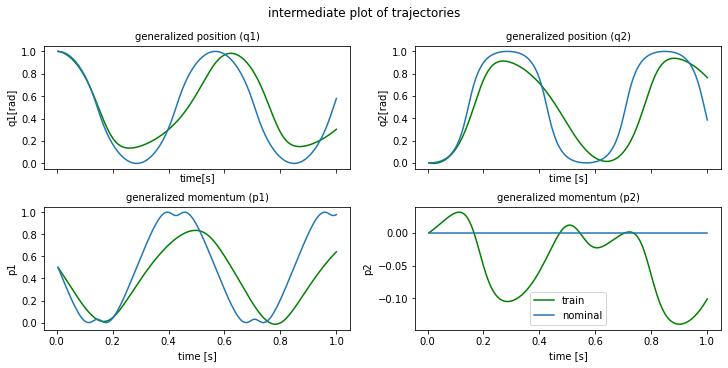

plot time : 1.2181735038757324
epoch  490 | train time 4.59 | train loss 7.405721e-02 | test loss 7.470176e-02 | test time 0.81  
epoch  491 | train time 3.36 | train loss 7.122923e-02 
epoch  492 | train time 3.40 | train loss 7.371283e-02 
epoch  493 | train time 3.27 | train loss 7.195354e-02 
epoch  494 | train time 3.37 | train loss 7.510591e-02 
epoch  495 | train time 3.10 | train loss 7.866932e-02 
epoch  496 | train time 3.25 | train loss 7.778335e-02 
epoch  497 | train time 3.43 | train loss 8.140630e-02 
epoch  498 | train time 3.21 | train loss 7.474147e-02 
epoch  499 | train time 3.10 | train loss 8.874582e-02 
horizon length : 250
min max values updated


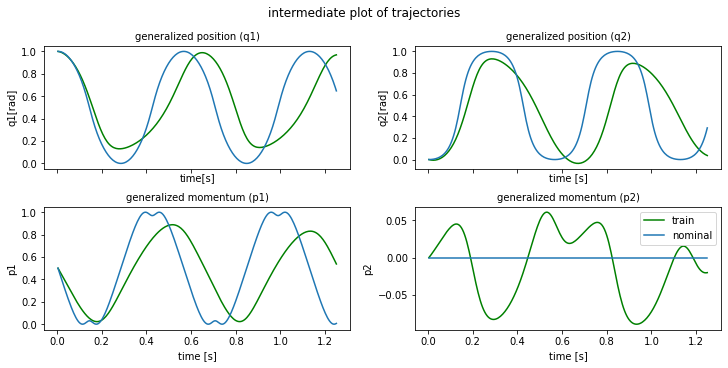

plot time : 1.2837443351745605
min max values updated
epoch  500 | train time 5.29 | train loss 1.104841e-01 | test loss 1.468001e-01 | test time 1.07  
epoch  501 | train time 4.19 | train loss 2.422133e-01 
epoch  502 | train time 4.14 | train loss 2.942454e-01 
epoch  503 | train time 4.19 | train loss 2.997618e-01 
epoch  504 | train time 4.37 | train loss 5.166990e-01 
epoch  505 | train time 4.04 | train loss 4.745750e-01 
epoch  506 | train time 3.93 | train loss 7.958711e-01 
epoch  507 | train time 3.91 | train loss 6.479098e-01 
epoch  508 | train time 3.92 | train loss 5.051489e-01 
epoch  509 | train time 4.07 | train loss 5.145234e-01 


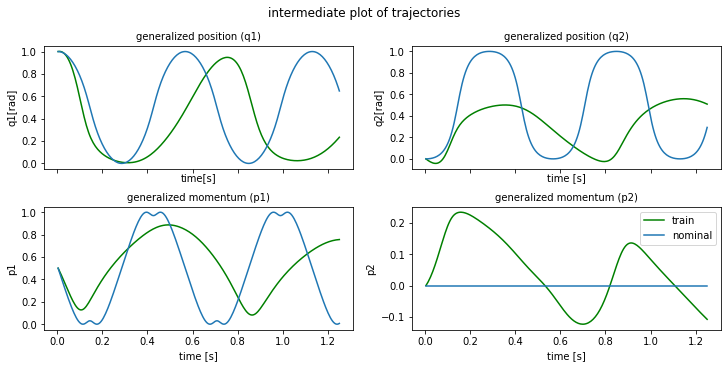

plot time : 1.1932055950164795
epoch  510 | train time 5.10 | train loss 4.986910e-01 | test loss 5.618129e-01 | test time 0.99  
epoch  511 | train time 3.86 | train loss 4.311988e-01 
epoch  512 | train time 4.15 | train loss 4.106918e-01 
epoch  513 | train time 3.98 | train loss 4.673897e-01 
epoch  514 | train time 4.10 | train loss 4.923885e-01 
epoch  515 | train time 4.01 | train loss 4.216950e-01 
epoch  516 | train time 4.09 | train loss 3.574917e-01 
epoch  517 | train time 3.86 | train loss 3.516521e-01 
epoch  518 | train time 3.97 | train loss 3.633345e-01 
epoch  519 | train time 4.13 | train loss 3.536808e-01 


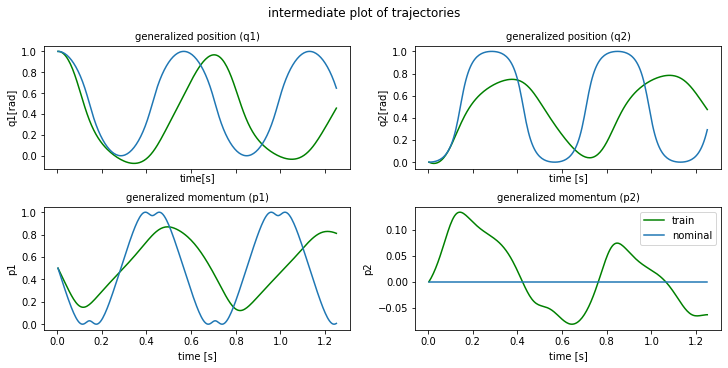

plot time : 1.1904754638671875
epoch  520 | train time 5.36 | train loss 3.224288e-01 | test loss 3.832789e-01 | test time 1.04  
epoch  521 | train time 3.91 | train loss 2.890272e-01 
epoch  522 | train time 3.98 | train loss 2.768424e-01 
epoch  523 | train time 4.14 | train loss 2.818450e-01 
epoch  524 | train time 4.03 | train loss 2.868883e-01 
epoch  525 | train time 4.09 | train loss 2.791440e-01 
epoch  526 | train time 4.24 | train loss 2.562946e-01 
epoch  527 | train time 4.97 | train loss 2.354694e-01 
epoch  528 | train time 3.92 | train loss 2.271076e-01 
epoch  529 | train time 3.96 | train loss 2.238561e-01 


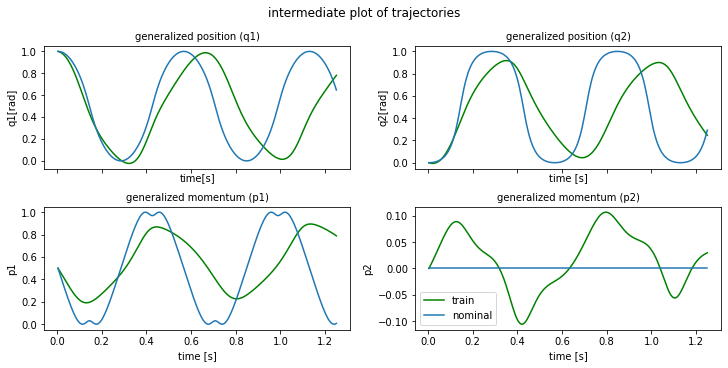

plot time : 1.2596192359924316
epoch  530 | train time 5.23 | train loss 2.202786e-01 | test loss 2.975833e-01 | test time 1.00  
epoch  531 | train time 4.04 | train loss 2.132551e-01 
epoch  532 | train time 3.89 | train loss 1.997518e-01 
epoch  533 | train time 3.85 | train loss 1.897102e-01 
epoch  534 | train time 3.87 | train loss 1.810522e-01 
epoch  535 | train time 4.09 | train loss 1.755967e-01 
epoch  536 | train time 3.88 | train loss 1.694280e-01 
epoch  537 | train time 4.10 | train loss 1.785047e-01 
epoch  538 | train time 3.91 | train loss 2.762323e-01 
epoch  539 | train time 4.02 | train loss 4.719018e-01 


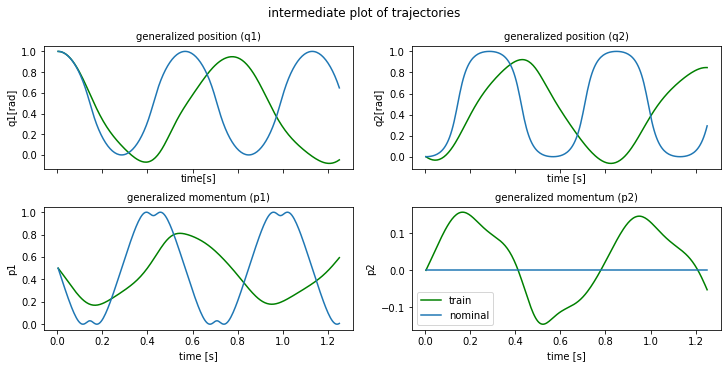

plot time : 1.1808559894561768
epoch  540 | train time 5.15 | train loss 4.302412e-01 | test loss 3.033724e-01 | test time 1.09  
epoch  541 | train time 4.46 | train loss 2.258273e-01 
epoch  542 | train time 4.10 | train loss 3.388816e-01 
epoch  543 | train time 4.17 | train loss 2.526367e-01 
epoch  544 | train time 4.26 | train loss 3.301103e-01 
epoch  545 | train time 3.83 | train loss 2.573231e-01 
epoch  546 | train time 4.29 | train loss 2.530466e-01 
epoch  547 | train time 4.05 | train loss 1.873462e-01 
epoch  548 | train time 4.00 | train loss 2.782353e-01 
epoch  549 | train time 4.16 | train loss 2.375975e-01 


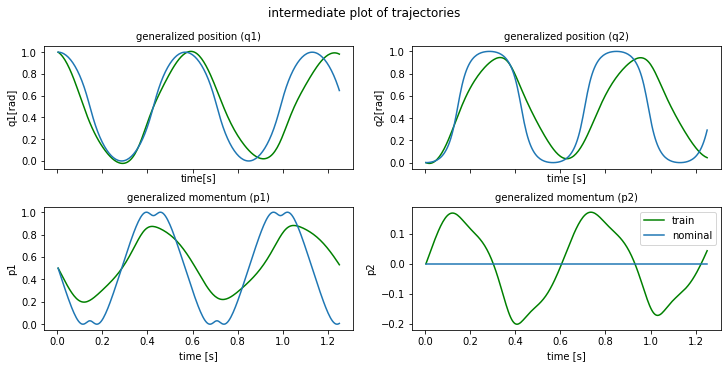

plot time : 1.2571706771850586
epoch  550 | train time 5.27 | train loss 2.269690e-01 | test loss 2.181721e-01 | test time 1.09  
epoch  551 | train time 3.93 | train loss 2.090071e-01 
epoch  552 | train time 3.97 | train loss 2.206625e-01 
epoch  553 | train time 3.91 | train loss 1.662149e-01 
epoch  554 | train time 4.12 | train loss 2.273272e-01 
epoch  555 | train time 4.04 | train loss 1.769508e-01 
epoch  556 | train time 3.98 | train loss 1.956674e-01 
epoch  557 | train time 4.20 | train loss 1.772654e-01 
epoch  558 | train time 3.95 | train loss 1.958552e-01 
epoch  559 | train time 4.03 | train loss 1.482728e-01 


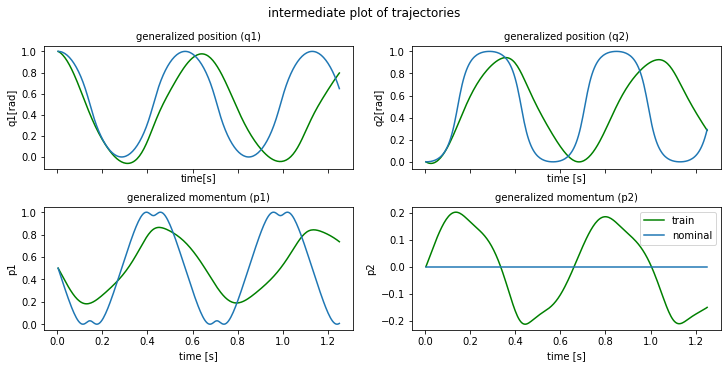

plot time : 1.2264323234558105
epoch  560 | train time 5.17 | train loss 1.908377e-01 | test loss 1.581963e-01 | test time 1.00  
epoch  561 | train time 4.06 | train loss 1.464562e-01 
epoch  562 | train time 4.19 | train loss 1.596717e-01 
epoch  563 | train time 3.88 | train loss 1.674436e-01 
epoch  564 | train time 4.12 | train loss 1.357777e-01 
epoch  565 | train time 3.92 | train loss 1.654121e-01 
epoch  566 | train time 3.97 | train loss 1.457835e-01 
epoch  567 | train time 3.99 | train loss 1.416395e-01 
epoch  568 | train time 4.08 | train loss 1.419413e-01 
epoch  569 | train time 4.31 | train loss 1.568261e-01 


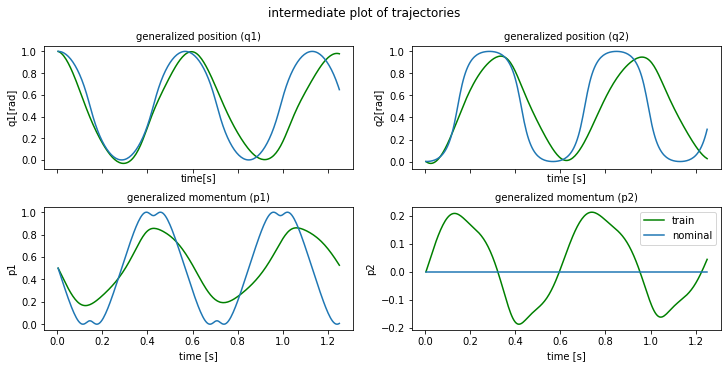

plot time : 1.2107536792755127
epoch  570 | train time 5.37 | train loss 1.355431e-01 | test loss 1.393730e-01 | test time 1.01  
epoch  571 | train time 4.15 | train loss 1.343546e-01 
epoch  572 | train time 4.04 | train loss 1.400002e-01 
epoch  573 | train time 3.94 | train loss 1.376312e-01 
epoch  574 | train time 3.92 | train loss 1.290181e-01 
epoch  575 | train time 5.07 | train loss 1.326362e-01 
epoch  576 | train time 4.22 | train loss 1.356502e-01 
epoch  577 | train time 4.22 | train loss 1.249932e-01 
epoch  578 | train time 4.20 | train loss 1.275760e-01 
epoch  579 | train time 4.11 | train loss 1.289274e-01 


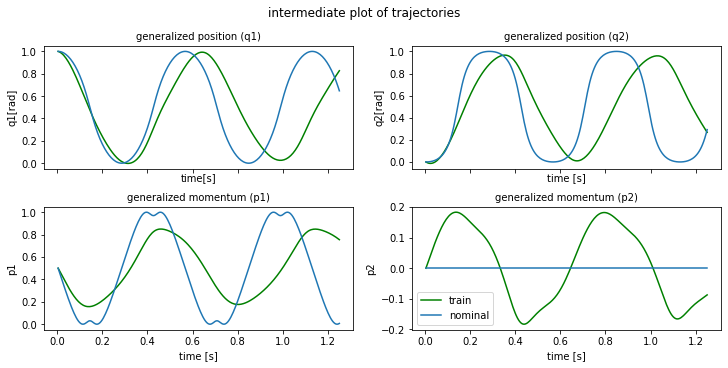

plot time : 1.2769603729248047
epoch  580 | train time 5.20 | train loss 1.285038e-01 | test loss 1.214271e-01 | test time 1.01  
epoch  581 | train time 3.95 | train loss 1.204886e-01 
epoch  582 | train time 3.90 | train loss 1.213476e-01 
epoch  583 | train time 3.99 | train loss 1.233115e-01 
epoch  584 | train time 3.97 | train loss 1.267770e-01 
epoch  585 | train time 4.13 | train loss 1.288384e-01 
epoch  586 | train time 4.28 | train loss 1.285060e-01 
epoch  587 | train time 4.21 | train loss 1.296268e-01 
epoch  588 | train time 4.31 | train loss 1.266519e-01 
epoch  589 | train time 4.08 | train loss 1.258494e-01 


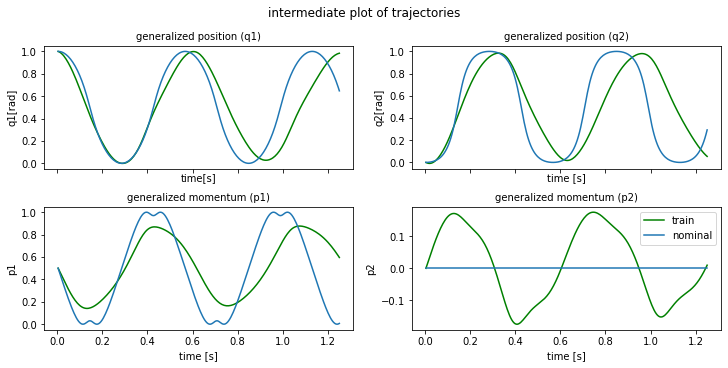

plot time : 1.1692707538604736
epoch  590 | train time 5.35 | train loss 1.222717e-01 | test loss 1.190981e-01 | test time 1.04  
epoch  591 | train time 4.17 | train loss 1.193364e-01 
epoch  592 | train time 4.12 | train loss 1.163015e-01 
epoch  593 | train time 3.85 | train loss 1.127174e-01 
epoch  594 | train time 3.99 | train loss 1.118619e-01 
epoch  595 | train time 3.99 | train loss 1.097409e-01 
epoch  596 | train time 3.92 | train loss 1.092774e-01 
epoch  597 | train time 3.90 | train loss 1.095767e-01 
epoch  598 | train time 4.16 | train loss 1.107488e-01 
epoch  599 | train time 3.97 | train loss 1.236894e-01 
horizon length : 300
min max values updated


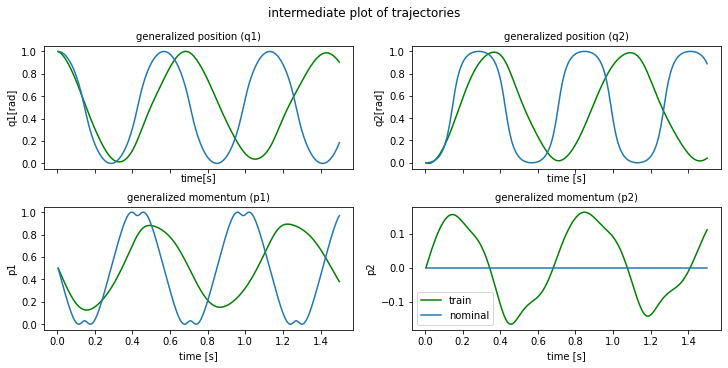

plot time : 1.1910276412963867
min max values updated
epoch  600 | train time 5.92 | train loss 2.412651e-01 | test loss 5.998630e-01 | test time 1.22  
epoch  601 | train time 4.87 | train loss 6.170005e-01 
epoch  602 | train time 4.94 | train loss 1.823397e-01 
epoch  603 | train time 4.72 | train loss 2.104909e-01 
epoch  604 | train time 4.59 | train loss 2.793652e-01 
epoch  605 | train time 4.97 | train loss 1.868663e-01 
epoch  606 | train time 4.98 | train loss 2.406223e-01 
epoch  607 | train time 4.73 | train loss 1.761212e-01 
epoch  608 | train time 4.66 | train loss 2.437048e-01 
epoch  609 | train time 4.77 | train loss 1.849440e-01 


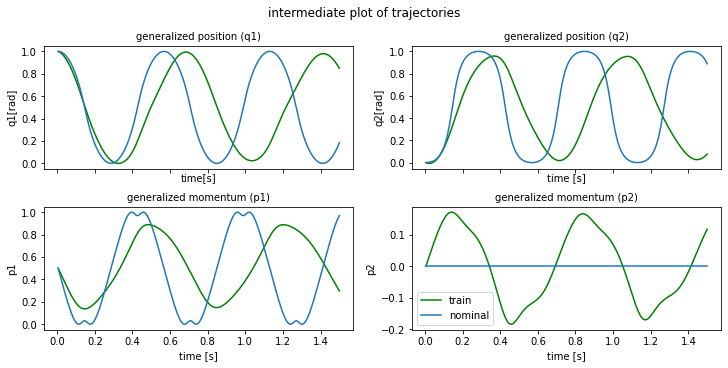

plot time : 1.2768700122833252
epoch  610 | train time 6.18 | train loss 2.057450e-01 | test loss 2.043760e-01 | test time 1.31  
epoch  611 | train time 4.94 | train loss 1.683189e-01 
epoch  612 | train time 4.67 | train loss 1.691714e-01 
epoch  613 | train time 4.60 | train loss 1.935350e-01 
epoch  614 | train time 4.91 | train loss 1.413613e-01 
epoch  615 | train time 4.82 | train loss 2.092928e-01 
epoch  616 | train time 4.89 | train loss 2.113907e-01 
epoch  617 | train time 4.78 | train loss 1.383566e-01 
epoch  618 | train time 4.70 | train loss 2.271904e-01 
epoch  619 | train time 5.78 | train loss 2.534820e-01 


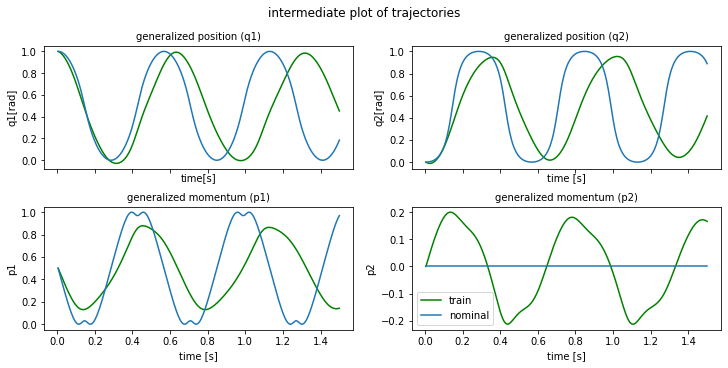

plot time : 1.2129724025726318
epoch  620 | train time 6.14 | train loss 1.508554e-01 | test loss 3.200753e-01 | test time 1.21  
epoch  621 | train time 4.84 | train loss 3.339315e-01 
epoch  622 | train time 4.85 | train loss 1.530584e-01 
epoch  623 | train time 4.78 | train loss 2.289162e-01 
epoch  624 | train time 5.06 | train loss 1.544180e-01 
epoch  625 | train time 5.19 | train loss 1.946985e-01 
epoch  626 | train time 4.98 | train loss 1.887121e-01 
epoch  627 | train time 4.64 | train loss 1.818821e-01 
epoch  628 | train time 4.69 | train loss 1.839558e-01 
epoch  629 | train time 4.99 | train loss 1.541244e-01 


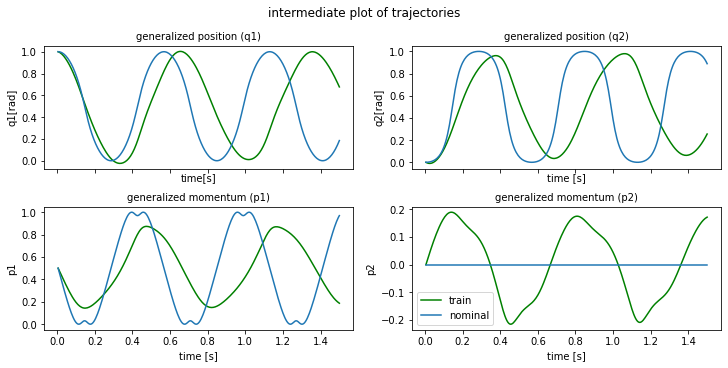

plot time : 1.2444868087768555
epoch  630 | train time 6.19 | train loss 1.830653e-01 | test loss 1.349173e-01 | test time 1.34  
epoch  631 | train time 4.77 | train loss 1.512073e-01 
epoch  632 | train time 5.06 | train loss 1.870104e-01 
epoch  633 | train time 4.74 | train loss 1.394468e-01 
epoch  634 | train time 5.22 | train loss 1.680366e-01 
epoch  635 | train time 4.82 | train loss 1.362628e-01 
epoch  636 | train time 4.81 | train loss 1.551570e-01 
epoch  637 | train time 4.66 | train loss 1.512189e-01 
epoch  638 | train time 4.80 | train loss 1.372445e-01 
epoch  639 | train time 4.71 | train loss 1.616311e-01 


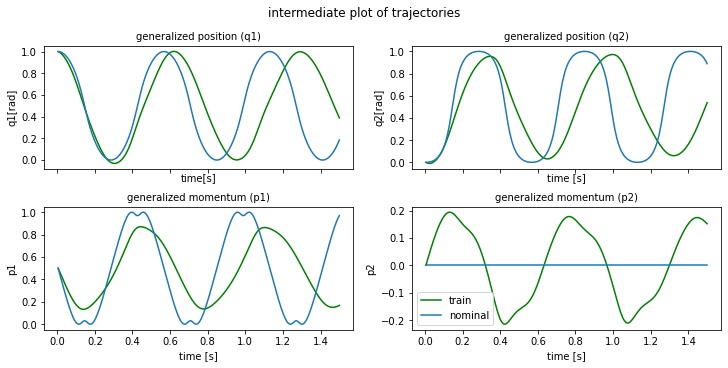

plot time : 1.2835009098052979
epoch  640 | train time 6.42 | train loss 1.391467e-01 | test loss 1.266587e-01 | test time 1.21  
epoch  641 | train time 4.74 | train loss 1.379291e-01 
epoch  642 | train time 4.73 | train loss 1.530350e-01 
epoch  643 | train time 5.09 | train loss 1.339450e-01 
epoch  644 | train time 5.02 | train loss 1.321121e-01 
epoch  645 | train time 5.02 | train loss 1.449576e-01 
epoch  646 | train time 4.91 | train loss 1.316679e-01 
epoch  647 | train time 4.92 | train loss 1.273387e-01 
epoch  648 | train time 5.14 | train loss 1.376686e-01 
epoch  649 | train time 4.68 | train loss 1.324332e-01 


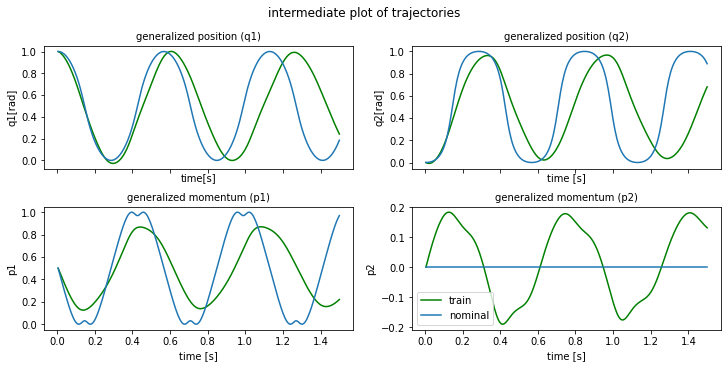

plot time : 1.2525012493133545
epoch  650 | train time 6.38 | train loss 1.246990e-01 | test loss 1.246060e-01 | test time 1.20  
epoch  651 | train time 4.99 | train loss 1.324449e-01 
epoch  652 | train time 4.74 | train loss 1.341315e-01 
epoch  653 | train time 4.62 | train loss 1.222413e-01 
epoch  654 | train time 4.82 | train loss 1.287732e-01 
epoch  655 | train time 4.83 | train loss 1.348864e-01 
epoch  656 | train time 5.08 | train loss 1.198691e-01 
epoch  657 | train time 4.75 | train loss 1.252219e-01 
epoch  658 | train time 5.14 | train loss 1.353324e-01 
epoch  659 | train time 5.45 | train loss 1.197718e-01 


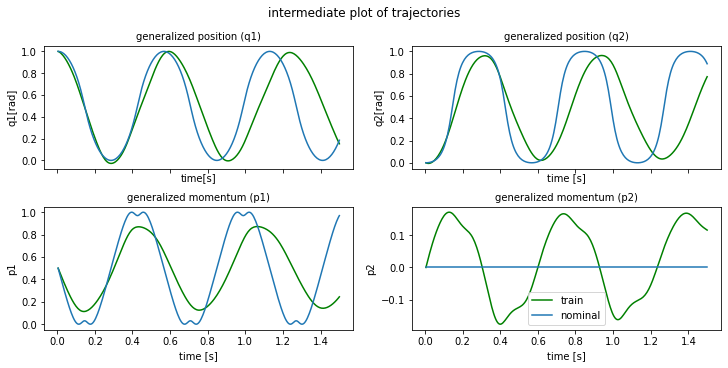

plot time : 1.2276358604431152
epoch  660 | train time 6.04 | train loss 1.205786e-01 | test loss 1.239931e-01 | test time 1.40  
epoch  661 | train time 5.01 | train loss 1.310473e-01 
epoch  662 | train time 4.77 | train loss 1.214385e-01 
epoch  663 | train time 5.18 | train loss 1.171516e-01 
epoch  664 | train time 4.79 | train loss 1.220900e-01 
epoch  665 | train time 4.67 | train loss 1.268003e-01 
epoch  666 | train time 4.69 | train loss 1.281663e-01 
epoch  667 | train time 4.75 | train loss 1.213494e-01 
epoch  668 | train time 4.77 | train loss 1.165887e-01 
epoch  669 | train time 4.99 | train loss 1.148572e-01 


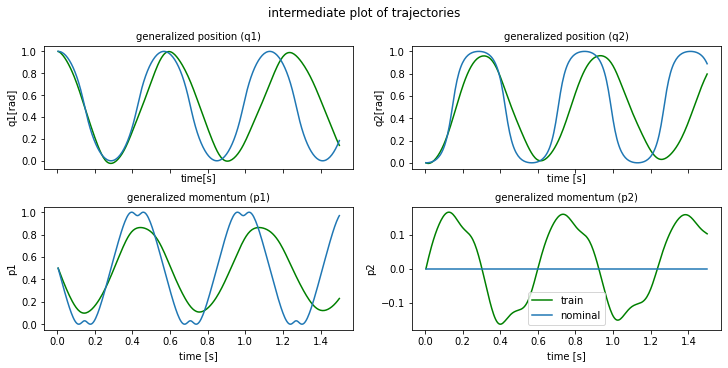

plot time : 1.2933709621429443
epoch  670 | train time 6.37 | train loss 1.164286e-01 | test loss 1.173692e-01 | test time 1.29  
epoch  671 | train time 4.76 | train loss 1.242068e-01 
epoch  672 | train time 4.96 | train loss 1.362874e-01 
epoch  673 | train time 4.79 | train loss 1.703118e-01 
epoch  674 | train time 5.05 | train loss 1.520016e-01 
epoch  675 | train time 4.78 | train loss 1.569357e-01 
epoch  676 | train time 5.00 | train loss 1.407030e-01 
epoch  677 | train time 4.70 | train loss 1.338197e-01 
epoch  678 | train time 5.11 | train loss 1.299494e-01 
epoch  679 | train time 4.69 | train loss 1.217481e-01 


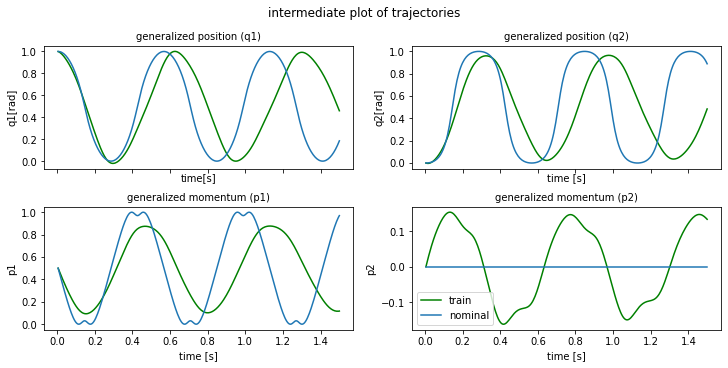

plot time : 1.2629733085632324
epoch  680 | train time 6.11 | train loss 1.204815e-01 | test loss 1.120640e-01 | test time 1.21  
epoch  681 | train time 5.00 | train loss 1.197664e-01 
epoch  682 | train time 4.75 | train loss 1.222662e-01 
epoch  683 | train time 4.90 | train loss 1.255632e-01 
epoch  684 | train time 4.61 | train loss 1.279739e-01 
epoch  685 | train time 5.16 | train loss 1.412634e-01 
epoch  686 | train time 4.70 | train loss 1.266532e-01 
epoch  687 | train time 5.00 | train loss 1.227876e-01 
epoch  688 | train time 4.87 | train loss 1.149547e-01 
epoch  689 | train time 4.60 | train loss 1.117730e-01 


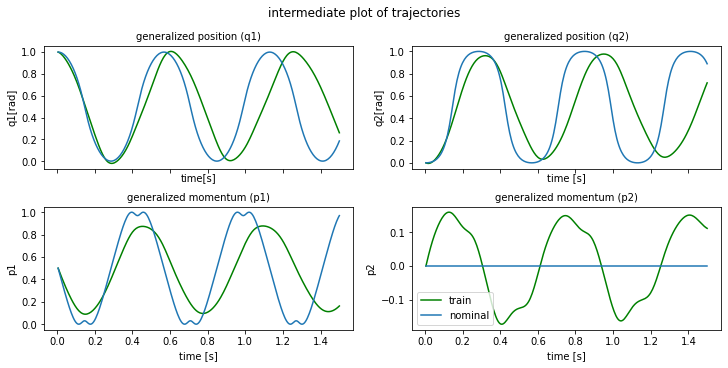

plot time : 1.36533784866333
epoch  690 | train time 6.40 | train loss 1.100043e-01 | test loss 9.892184e-02 | test time 1.24  
epoch  691 | train time 4.72 | train loss 1.101093e-01 
epoch  692 | train time 4.62 | train loss 1.124017e-01 
epoch  693 | train time 5.07 | train loss 1.159974e-01 
epoch  694 | train time 4.87 | train loss 1.256129e-01 
epoch  695 | train time 4.81 | train loss 1.245582e-01 
epoch  696 | train time 4.83 | train loss 1.288166e-01 
epoch  697 | train time 4.78 | train loss 1.152746e-01 
epoch  698 | train time 4.93 | train loss 1.087271e-01 
epoch  699 | train time 4.74 | train loss 1.058595e-01 


In [44]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [45]:
if collect_grads:
    plot_grads(stats)

In [46]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [47]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [48]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

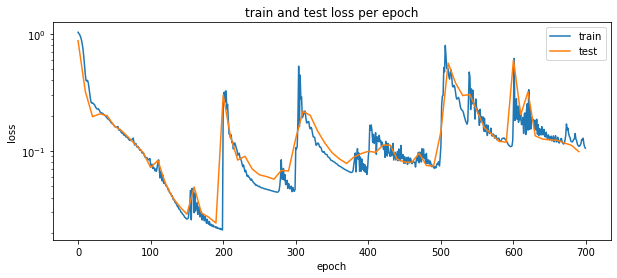

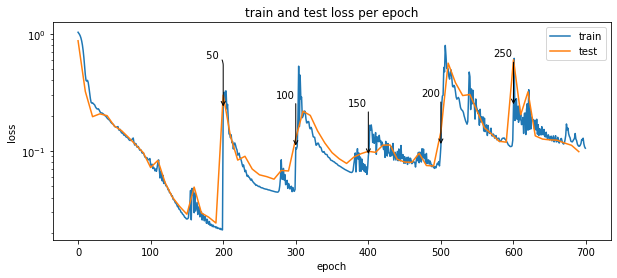

In [49]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

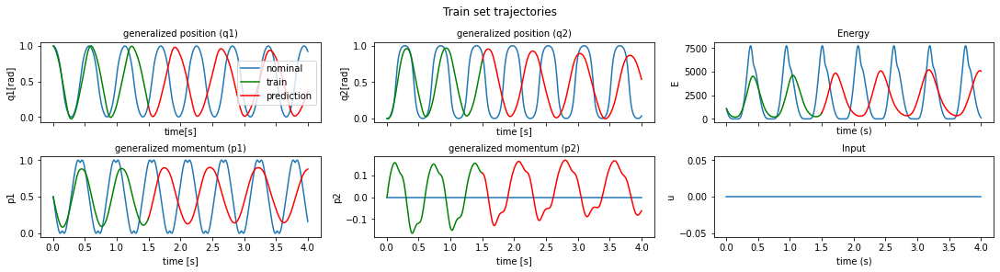

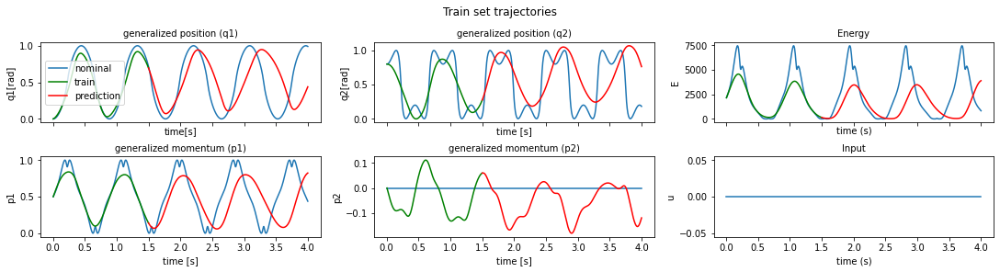

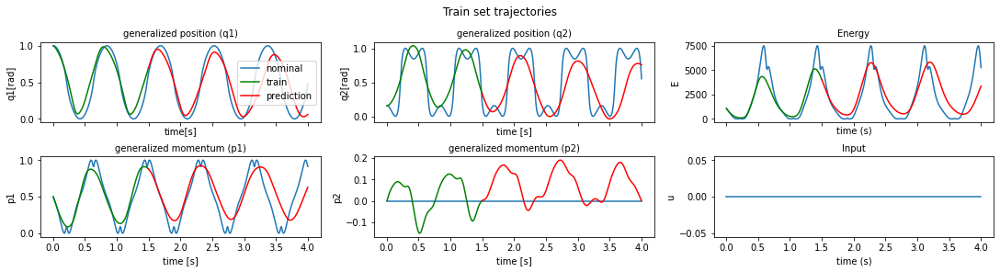

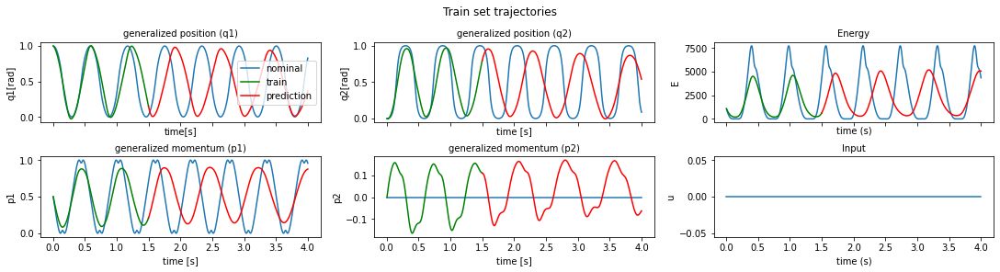

In [50]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

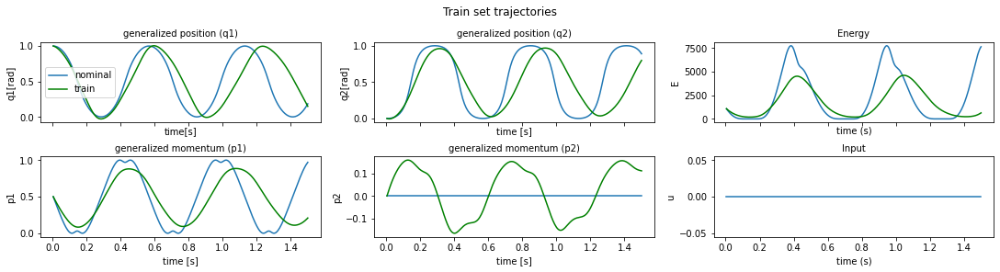

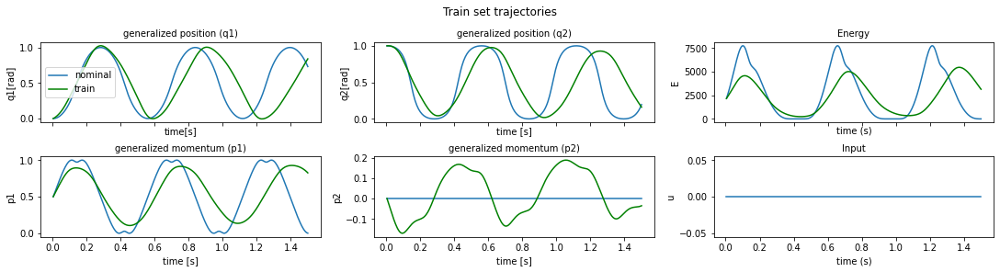

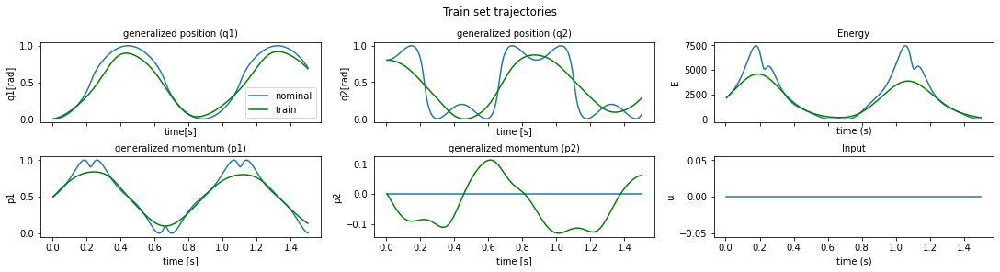

In [51]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + "nopred.png",
        w_rescale=w_rescale,
    )

##### 30k parameters - w horizon - with rescaling - with grad clipping

In [52]:
device = set_device()  # set it to gpu if it is available

# Parameters to generate the dataset
furuta_type = "real"  # 'real' or 'fake'
Ts, noise_std, C_q1, C_q2, g, Jr, Lr, Mp, Lp = set_furuta_params(which=furuta_type)
utype = None  # 'chirp' or 'sine' or 'tanh' or 'multisine' or 'step' or None
u_func = U_FUNC(utype=utype)  # instantiate the input function u(t)
gtype = None  # 'simple' or None
# instantiate the input function G(q,p) (here it is constant)
g_func = G_FUNC(gtype=gtype)
init_method = "random_nozero"  # 'random_nozero' # 'random_closetopi'
time_steps = 800  # length of a trajectory
num_trajectories = 125  # number of trajectories in total
proportion = 0.8  # train test proportion
batch_size = 100  # batch size used by dataloader
w_rescale = [1, 1, 1, 1]  # [1, 1000, 1, 10000]  # [1, 1000, 1, 10000]  # [1, 9000, 1, 10000]
shuffle = False  # shuffle sample in the batches between epochs
# 'hamiltonian' or 'newtonian', newtonian if you want [q1,q1_dot,q2,q2_dot]
coord_type = "hamiltonian"
min_max_rescale = True  # rescale the training trajectories
# which dimensions to rescale if using min_max_rescale, so that nothing is divided by zero
rescale_dims = [1, 1, 1, 0]

# Parameters for the training procedure
resnet_config = None
alternating = False  # for Input_HNN, if G is a neural network, train
horizon_type = "auto"  # 'auto' or 'constant'
horizon = False  # if horizon_type == 'constant', use this horizon
loss_type = "L2"  # 'L2' or 'L2weighted'
collect_grads = False  # collect gradients in all layers at every epoch
# rescale the difference between nominal and train by the min max of train trajectory in loss function
rescale_loss = True
grad_clip = True  # activate gradient clipping
lr_schedule = False  # activate lr schedule
begin_decay = 600  # epoch at which lr starts decaying
weights = [1.0, 1.0, 1.0, 1.0]  # weights for the loss functions

horizon_list = [50, 100, 150, 200, 250, 300]
switch_steps = [200, 100, 100, 100, 100, 100]
epoch_number = sum(switch_steps)  # total number of training epochs

cpu


In [53]:
# generate train and test dataloader objects containing the trajectories
train_loader, test_loader = load_data_device(
    device,
    init_method,
    w_rescale,
    u_func,
    g_func,
    time_steps,
    shuffle=shuffle,
    num_trajectories=num_trajectories,
    coord_type=coord_type,
    proportion=proportion,
    batch_size=batch_size,
    Ts=Ts,
    noise_std=noise_std,
    C_q1=C_q1,
    C_q2=C_q2,
    g=g,
    Jr=Jr,
    Lr=Lr,
    Mp=Mp,
    Lp=Lp,
    min_max_rescale=min_max_rescale,
    rescale_dims=rescale_dims,
)

In [54]:
# initialise the model that will be trianed
model_name = "simple_HNN"
H_net = MLP(input_dim=4, hidden_dim=90, nb_hidden_layers=4, output_dim=1, activation="x+sin(x)^2")  # load H model
model = simple_HNN(input_dim=4, H_net=H_net, device=device)  # load neural ODE model
model.to(device)  # send model to devie ( cpu or gpu )

# create file name from parameters
num_params = count_parameters(model)

save_prefix = name_from_params(
    Ts,
    rescale_loss,
    weights,
    epoch_number,
    num_params,
    utype,
    model_name,
    num_trajectories,
    furuta_type,
    noise_std,
    grad_clip,
    lr_schedule,
    C_q1,
    C_q2,
    horizon,
    min_max_rescale,
)

# print some information on the training and file name
print("Total number of epochs:", epoch_number)
print("H_net number of parameters :", num_params)
print("Save file prefix : ", save_prefix)

# Sanity check
is_same_size(horizon_list, switch_steps)

Total number of epochs: 700
H_net number of parameters : 33303
Save file prefix :  simple_HNN_noinput_125traj_real_noise0.0_700e_p33k_Ts0.005_gradcl_nodissip_rescaledloss_trajminmaxrescale_
horizon_list and switch_steps have the same size


horizon length : 50
min max values updated


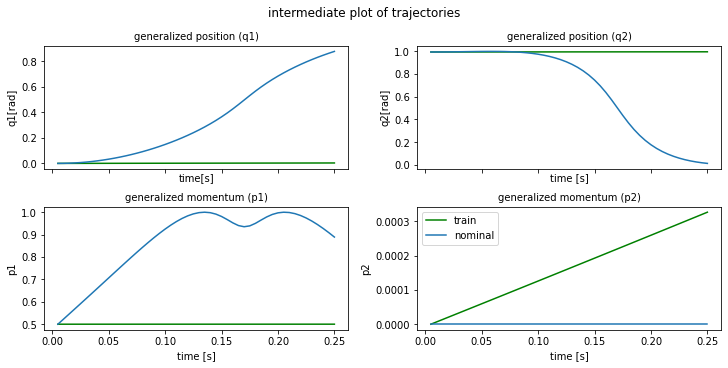

plot time : 1.218993902206421
min max values updated
epoch    0 | train time 2.05 | train loss 9.975017e-01 | test loss 1.002834e+00 | test time 0.21  
epoch    1 | train time 0.77 | train loss 9.694410e-01 
epoch    2 | train time 0.86 | train loss 9.367872e-01 
epoch    3 | train time 0.82 | train loss 8.958805e-01 
epoch    4 | train time 0.81 | train loss 8.465319e-01 
epoch    5 | train time 0.84 | train loss 7.919195e-01 
epoch    6 | train time 0.79 | train loss 7.364323e-01 
epoch    7 | train time 0.92 | train loss 6.785451e-01 
epoch    8 | train time 1.79 | train loss 6.094924e-01 
epoch    9 | train time 1.42 | train loss 5.263070e-01 


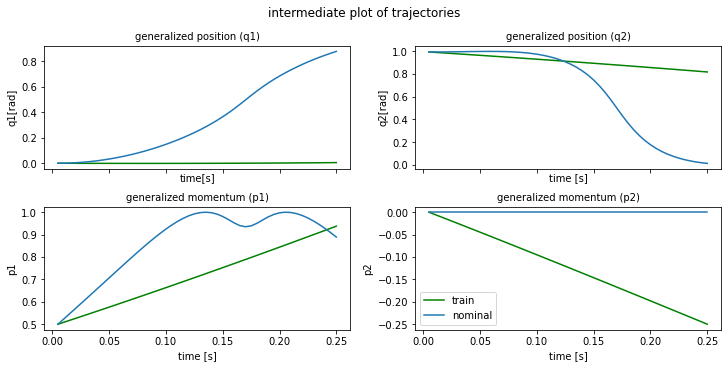

plot time : 1.7922966480255127
epoch   10 | train time 2.96 | train loss 4.469892e-01 | test loss 4.481299e-01 | test time 0.24  
epoch   11 | train time 0.92 | train loss 4.147578e-01 
epoch   12 | train time 0.78 | train loss 4.253686e-01 
epoch   13 | train time 0.78 | train loss 4.364055e-01 
epoch   14 | train time 0.80 | train loss 4.292423e-01 
epoch   15 | train time 0.78 | train loss 4.205785e-01 
epoch   16 | train time 0.79 | train loss 3.996995e-01 
epoch   17 | train time 1.00 | train loss 3.558527e-01 
epoch   18 | train time 1.24 | train loss 3.132598e-01 
epoch   19 | train time 1.31 | train loss 3.125444e-01 


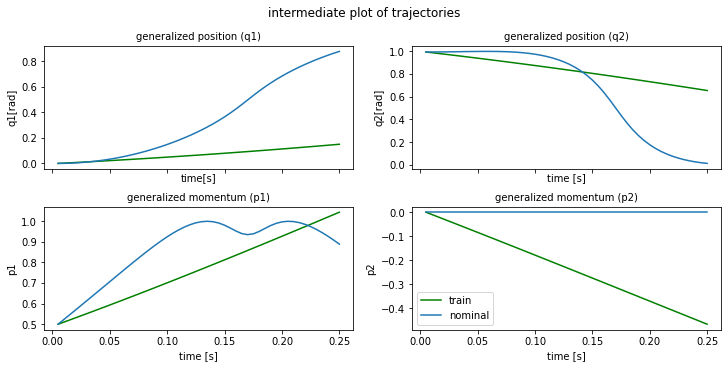

plot time : 1.5349299907684326
epoch   20 | train time 2.53 | train loss 3.217218e-01 | test loss 3.441688e-01 | test time 0.23  
epoch   21 | train time 0.97 | train loss 3.096668e-01 
epoch   22 | train time 0.76 | train loss 2.935241e-01 
epoch   23 | train time 0.79 | train loss 2.892273e-01 
epoch   24 | train time 0.78 | train loss 2.770437e-01 
epoch   25 | train time 0.84 | train loss 2.536834e-01 
epoch   26 | train time 1.43 | train loss 2.436205e-01 
epoch   27 | train time 1.35 | train loss 2.428532e-01 
epoch   28 | train time 1.32 | train loss 2.358408e-01 
epoch   29 | train time 1.10 | train loss 2.380019e-01 


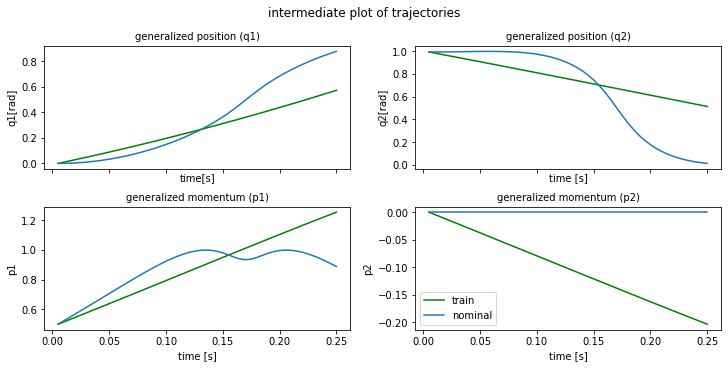

plot time : 1.1588923931121826
epoch   30 | train time 1.98 | train loss 2.374174e-01 | test loss 2.555184e-01 | test time 0.21  
epoch   31 | train time 0.94 | train loss 2.234562e-01 
epoch   32 | train time 0.82 | train loss 2.166858e-01 
epoch   33 | train time 0.84 | train loss 2.120795e-01 
epoch   34 | train time 1.42 | train loss 2.045334e-01 
epoch   35 | train time 1.23 | train loss 2.087996e-01 
epoch   36 | train time 1.23 | train loss 2.065850e-01 
epoch   37 | train time 1.20 | train loss 2.041237e-01 
epoch   38 | train time 0.78 | train loss 2.032566e-01 
epoch   39 | train time 0.93 | train loss 1.964891e-01 


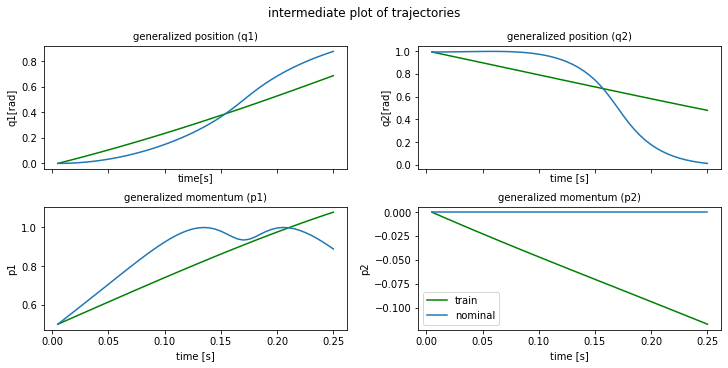

plot time : 1.1762135028839111
epoch   40 | train time 1.98 | train loss 1.973536e-01 | test loss 2.353240e-01 | test time 0.20  
epoch   41 | train time 0.82 | train loss 1.941450e-01 
epoch   42 | train time 0.80 | train loss 1.951829e-01 
epoch   43 | train time 0.79 | train loss 1.926690e-01 
epoch   44 | train time 0.78 | train loss 1.902620e-01 
epoch   45 | train time 0.78 | train loss 1.880769e-01 
epoch   46 | train time 0.86 | train loss 1.854251e-01 
epoch   47 | train time 0.87 | train loss 1.852036e-01 
epoch   48 | train time 0.80 | train loss 1.821194e-01 
epoch   49 | train time 0.79 | train loss 1.808583e-01 


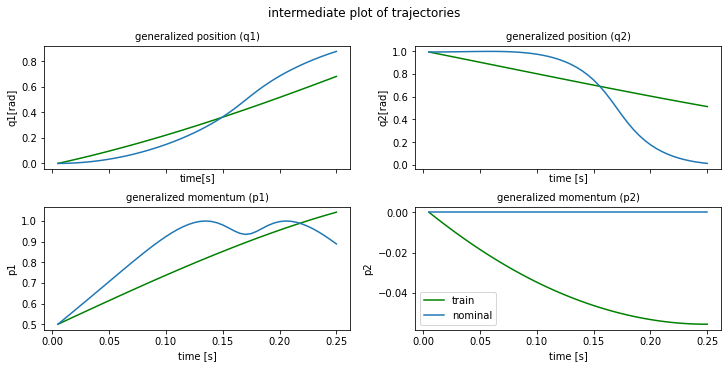

plot time : 1.2345120906829834
epoch   50 | train time 2.13 | train loss 1.766008e-01 | test loss 2.130819e-01 | test time 0.24  
epoch   51 | train time 0.95 | train loss 1.743412e-01 
epoch   52 | train time 0.91 | train loss 1.711746e-01 
epoch   53 | train time 0.80 | train loss 1.693874e-01 
epoch   54 | train time 0.78 | train loss 1.671083e-01 
epoch   55 | train time 0.81 | train loss 1.641499e-01 
epoch   56 | train time 0.83 | train loss 1.611646e-01 
epoch   57 | train time 0.93 | train loss 1.577149e-01 
epoch   58 | train time 0.78 | train loss 1.552525e-01 
epoch   59 | train time 0.78 | train loss 1.521100e-01 


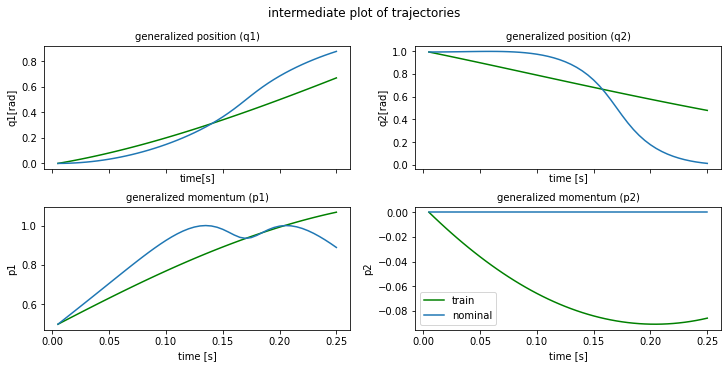

plot time : 1.1760659217834473
epoch   60 | train time 1.96 | train loss 1.495619e-01 | test loss 1.832447e-01 | test time 0.21  
epoch   61 | train time 0.78 | train loss 1.460486e-01 
epoch   62 | train time 0.78 | train loss 1.433608e-01 
epoch   63 | train time 0.77 | train loss 1.402633e-01 
epoch   64 | train time 0.80 | train loss 1.379639e-01 
epoch   65 | train time 0.94 | train loss 1.352555e-01 
epoch   66 | train time 0.93 | train loss 1.331883e-01 
epoch   67 | train time 0.89 | train loss 1.308200e-01 
epoch   68 | train time 0.90 | train loss 1.289365e-01 
epoch   69 | train time 0.99 | train loss 1.262747e-01 


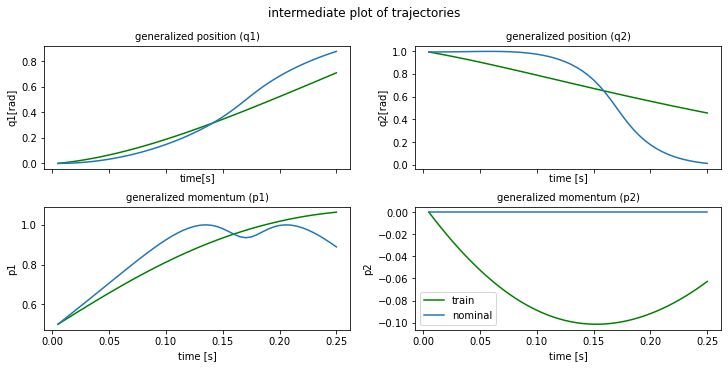

plot time : 1.1957602500915527
epoch   70 | train time 2.02 | train loss 1.232023e-01 | test loss 1.557744e-01 | test time 0.21  
epoch   71 | train time 0.78 | train loss 1.197520e-01 
epoch   72 | train time 0.78 | train loss 1.167195e-01 
epoch   73 | train time 0.78 | train loss 1.134678e-01 
epoch   74 | train time 0.82 | train loss 1.110129e-01 
epoch   75 | train time 0.80 | train loss 1.088635e-01 
epoch   76 | train time 0.82 | train loss 1.061246e-01 
epoch   77 | train time 0.79 | train loss 1.030135e-01 
epoch   78 | train time 0.80 | train loss 9.911286e-02 
epoch   79 | train time 0.79 | train loss 9.529339e-02 


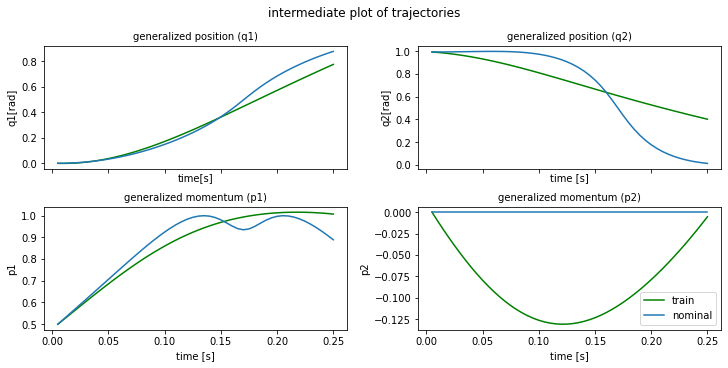

plot time : 1.3388352394104004
epoch   80 | train time 2.23 | train loss 9.212741e-02 | test loss 1.173633e-01 | test time 0.20  
epoch   81 | train time 0.79 | train loss 8.902728e-02 
epoch   82 | train time 0.79 | train loss 8.541854e-02 
epoch   83 | train time 0.92 | train loss 8.132769e-02 
epoch   84 | train time 0.94 | train loss 7.763445e-02 
epoch   85 | train time 0.77 | train loss 7.504928e-02 
epoch   86 | train time 0.78 | train loss 7.349024e-02 
epoch   87 | train time 0.83 | train loss 8.234390e-02 
epoch   88 | train time 0.86 | train loss 6.932297e-02 
epoch   89 | train time 0.80 | train loss 1.073302e-01 


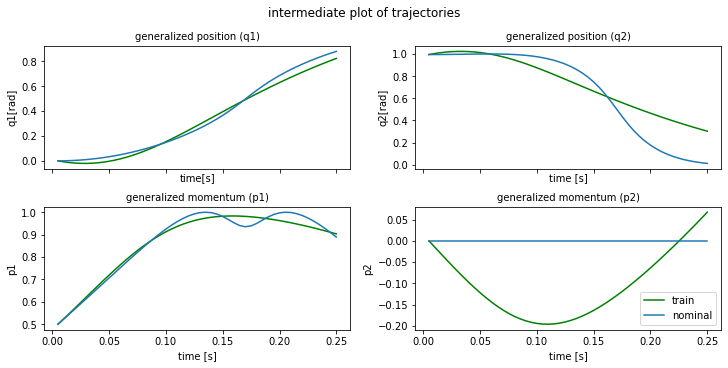

plot time : 1.1765403747558594
epoch   90 | train time 2.01 | train loss 1.190642e-01 | test loss 7.808304e-02 | test time 0.26  
epoch   91 | train time 0.89 | train loss 7.166007e-02 
epoch   92 | train time 0.79 | train loss 1.017203e-01 
epoch   93 | train time 0.78 | train loss 1.252506e-01 
epoch   94 | train time 0.78 | train loss 8.544566e-02 
epoch   95 | train time 0.82 | train loss 7.335903e-02 
epoch   96 | train time 0.79 | train loss 9.309895e-02 
epoch   97 | train time 0.77 | train loss 7.263418e-02 
epoch   98 | train time 0.78 | train loss 6.917294e-02 
epoch   99 | train time 0.86 | train loss 7.060578e-02 


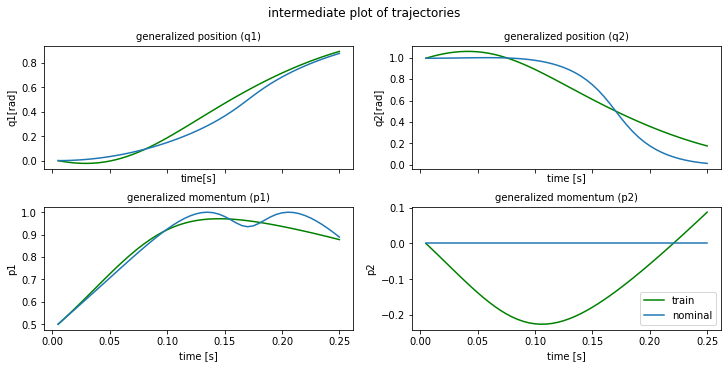

plot time : 1.1667795181274414
epoch  100 | train time 2.02 | train loss 5.571724e-02 | test loss 7.104656e-02 | test time 0.21  
epoch  101 | train time 0.79 | train loss 7.176255e-02 
epoch  102 | train time 0.78 | train loss 6.471341e-02 
epoch  103 | train time 0.79 | train loss 5.806537e-02 
epoch  104 | train time 0.78 | train loss 5.756792e-02 
epoch  105 | train time 0.79 | train loss 5.369449e-02 
epoch  106 | train time 0.87 | train loss 5.638785e-02 
epoch  107 | train time 0.91 | train loss 4.925400e-02 
epoch  108 | train time 0.89 | train loss 5.199589e-02 
epoch  109 | train time 0.79 | train loss 5.586052e-02 


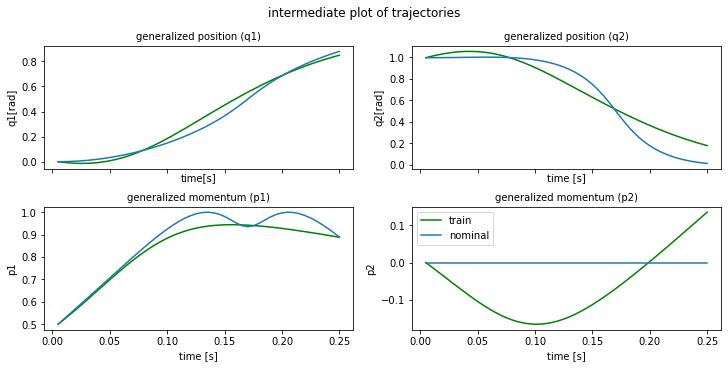

plot time : 1.3175482749938965
epoch  110 | train time 2.26 | train loss 4.846861e-02 | test loss 7.259587e-02 | test time 0.27  
epoch  111 | train time 0.89 | train loss 6.399439e-02 
epoch  112 | train time 0.84 | train loss 5.590933e-02 
epoch  113 | train time 0.86 | train loss 5.916581e-02 
epoch  114 | train time 0.79 | train loss 5.886752e-02 
epoch  115 | train time 0.78 | train loss 5.037203e-02 
epoch  116 | train time 0.80 | train loss 4.908619e-02 
epoch  117 | train time 0.78 | train loss 5.390041e-02 
epoch  118 | train time 0.78 | train loss 4.606666e-02 
epoch  119 | train time 0.79 | train loss 6.081950e-02 


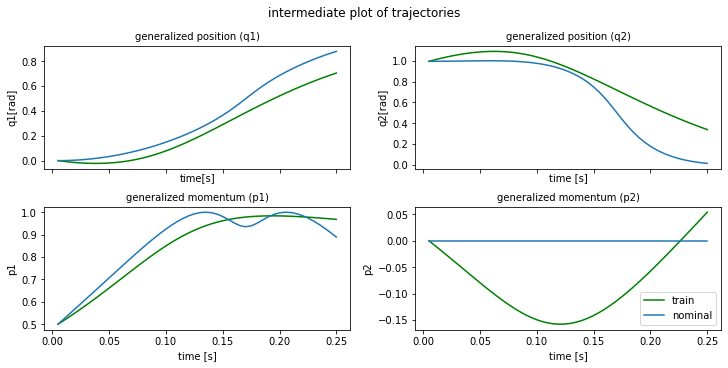

plot time : 1.2444634437561035
epoch  120 | train time 2.11 | train loss 6.013355e-02 | test loss 5.143373e-02 | test time 0.21  
epoch  121 | train time 0.79 | train loss 4.283070e-02 
epoch  122 | train time 0.81 | train loss 4.559008e-02 
epoch  123 | train time 0.80 | train loss 4.458725e-02 
epoch  124 | train time 0.89 | train loss 4.056884e-02 
epoch  125 | train time 0.85 | train loss 4.599742e-02 
epoch  126 | train time 0.79 | train loss 3.991098e-02 
epoch  127 | train time 0.79 | train loss 4.346383e-02 
epoch  128 | train time 0.90 | train loss 4.009604e-02 
epoch  129 | train time 0.86 | train loss 3.776910e-02 


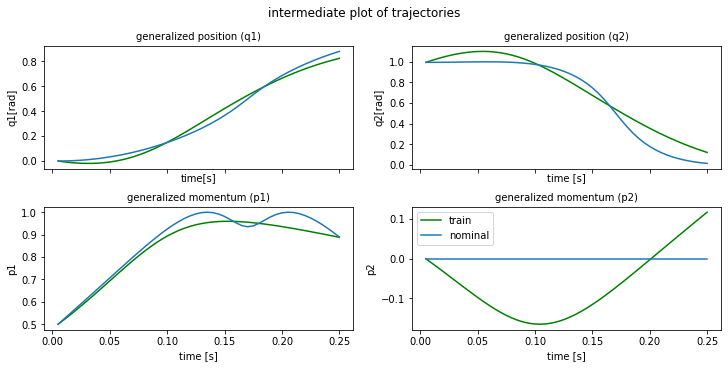

plot time : 1.227581262588501
epoch  130 | train time 2.14 | train loss 3.826774e-02 | test loss 4.702170e-02 | test time 0.21  
epoch  131 | train time 0.79 | train loss 3.815377e-02 
epoch  132 | train time 0.81 | train loss 4.064374e-02 
epoch  133 | train time 0.79 | train loss 3.730847e-02 
epoch  134 | train time 0.80 | train loss 4.111232e-02 
epoch  135 | train time 0.80 | train loss 3.602988e-02 
epoch  136 | train time 0.79 | train loss 3.671243e-02 
epoch  137 | train time 0.77 | train loss 4.035485e-02 
epoch  138 | train time 0.97 | train loss 3.536006e-02 
epoch  139 | train time 0.88 | train loss 5.184786e-02 


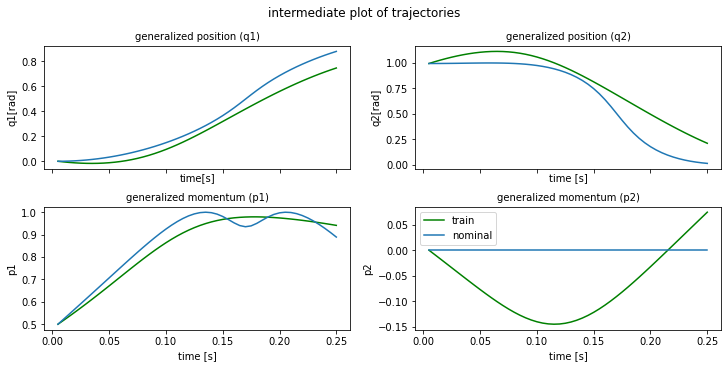

plot time : 1.261709213256836
epoch  140 | train time 2.22 | train loss 4.917372e-02 | test loss 4.918675e-02 | test time 0.24  
epoch  141 | train time 0.77 | train loss 3.983299e-02 
epoch  142 | train time 0.78 | train loss 4.019383e-02 
epoch  143 | train time 0.79 | train loss 3.436133e-02 
epoch  144 | train time 0.78 | train loss 3.676920e-02 
epoch  145 | train time 0.78 | train loss 3.677453e-02 
epoch  146 | train time 0.92 | train loss 3.079892e-02 
epoch  147 | train time 0.95 | train loss 3.645507e-02 
epoch  148 | train time 0.95 | train loss 3.226435e-02 
epoch  149 | train time 0.85 | train loss 3.590115e-02 


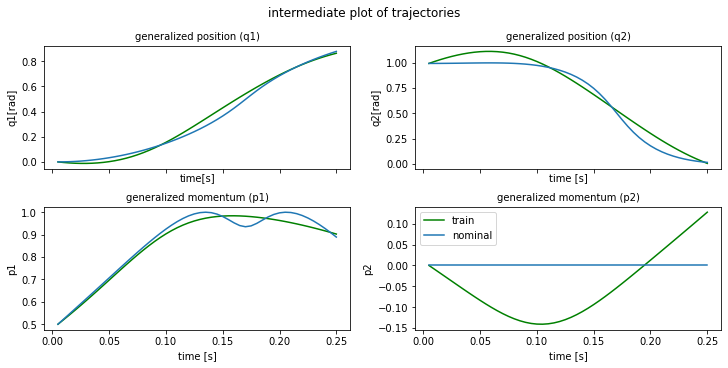

plot time : 1.195051908493042
epoch  150 | train time 1.99 | train loss 3.047629e-02 | test loss 3.651799e-02 | test time 0.21  
epoch  151 | train time 0.82 | train loss 3.128013e-02 
epoch  152 | train time 0.84 | train loss 4.110733e-02 
epoch  153 | train time 0.86 | train loss 3.322417e-02 
epoch  154 | train time 0.78 | train loss 6.291059e-02 
epoch  155 | train time 0.90 | train loss 7.159799e-02 
epoch  156 | train time 0.79 | train loss 3.139136e-02 
epoch  157 | train time 0.88 | train loss 8.375135e-02 
epoch  158 | train time 0.83 | train loss 1.152861e-01 
epoch  159 | train time 0.86 | train loss 7.011712e-02 


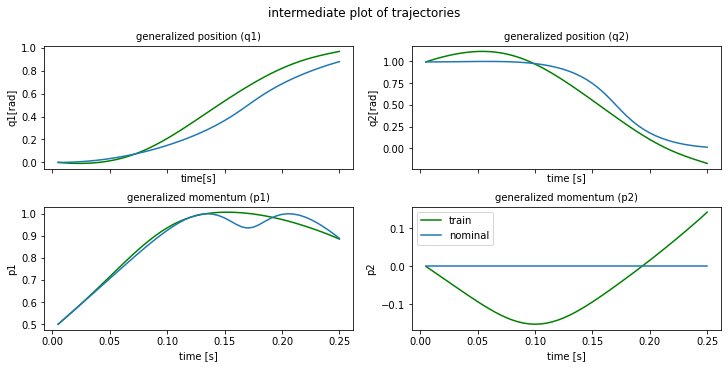

plot time : 1.217862606048584
epoch  160 | train time 2.05 | train loss 4.811775e-02 | test loss 5.932973e-02 | test time 0.21  
epoch  161 | train time 0.87 | train loss 6.409398e-02 
epoch  162 | train time 0.86 | train loss 4.457153e-02 
epoch  163 | train time 0.79 | train loss 3.999620e-02 
epoch  164 | train time 0.80 | train loss 4.705404e-02 
epoch  165 | train time 0.79 | train loss 4.392998e-02 
epoch  166 | train time 0.78 | train loss 4.214240e-02 
epoch  167 | train time 0.77 | train loss 3.752407e-02 
epoch  168 | train time 0.79 | train loss 3.191141e-02 
epoch  169 | train time 0.79 | train loss 4.443691e-02 


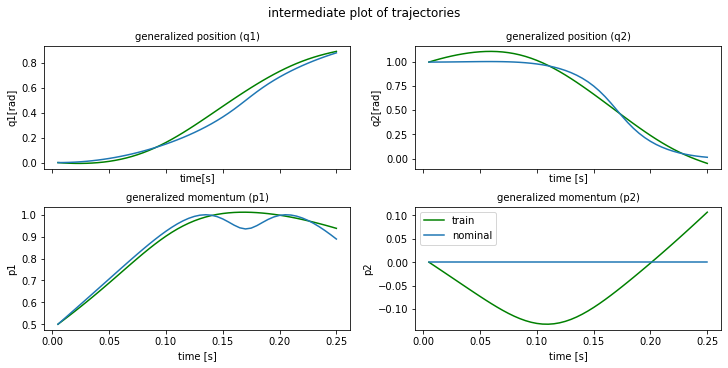

plot time : 1.2383224964141846
epoch  170 | train time 2.08 | train loss 4.039340e-02 | test loss 5.748690e-02 | test time 0.21  
epoch  171 | train time 0.82 | train loss 4.503349e-02 
epoch  172 | train time 0.80 | train loss 4.918247e-02 
epoch  173 | train time 0.79 | train loss 3.261405e-02 
epoch  174 | train time 0.78 | train loss 5.797651e-02 
epoch  175 | train time 0.81 | train loss 7.313026e-02 
epoch  176 | train time 0.81 | train loss 3.599145e-02 
epoch  177 | train time 0.94 | train loss 5.174849e-02 
epoch  178 | train time 0.89 | train loss 6.737720e-02 
epoch  179 | train time 0.80 | train loss 4.152207e-02 


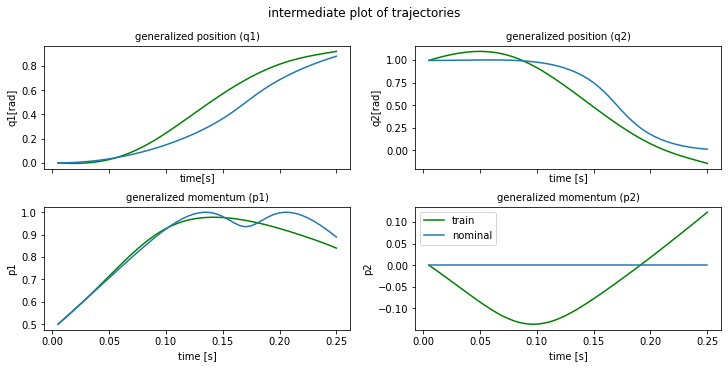

plot time : 1.168353796005249
epoch  180 | train time 2.09 | train loss 5.070313e-02 | test loss 7.044049e-02 | test time 0.27  
epoch  181 | train time 0.79 | train loss 6.887937e-02 
epoch  182 | train time 0.80 | train loss 4.578220e-02 
epoch  183 | train time 0.88 | train loss 3.804974e-02 
epoch  184 | train time 0.92 | train loss 5.038730e-02 
epoch  185 | train time 0.93 | train loss 3.816492e-02 
epoch  186 | train time 0.89 | train loss 4.245712e-02 
epoch  187 | train time 0.82 | train loss 5.302616e-02 
epoch  188 | train time 0.85 | train loss 3.234620e-02 
epoch  189 | train time 0.96 | train loss 5.743358e-02 


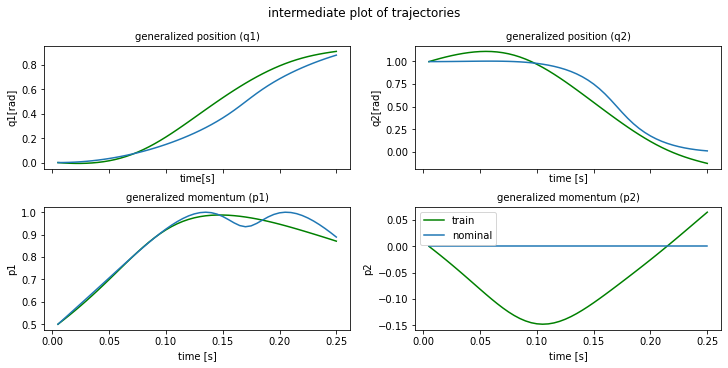

plot time : 1.2009963989257812
epoch  190 | train time 2.13 | train loss 7.314494e-02 | test loss 5.767316e-02 | test time 0.21  
epoch  191 | train time 0.78 | train loss 4.866043e-02 
epoch  192 | train time 0.93 | train loss 4.684350e-02 
epoch  193 | train time 0.80 | train loss 5.596306e-02 
epoch  194 | train time 0.78 | train loss 5.261074e-02 
epoch  195 | train time 0.83 | train loss 3.726760e-02 
epoch  196 | train time 0.91 | train loss 4.496260e-02 
epoch  197 | train time 0.79 | train loss 5.254480e-02 
epoch  198 | train time 0.78 | train loss 3.261660e-02 
epoch  199 | train time 0.91 | train loss 6.541179e-02 
horizon length : 100
min max values updated


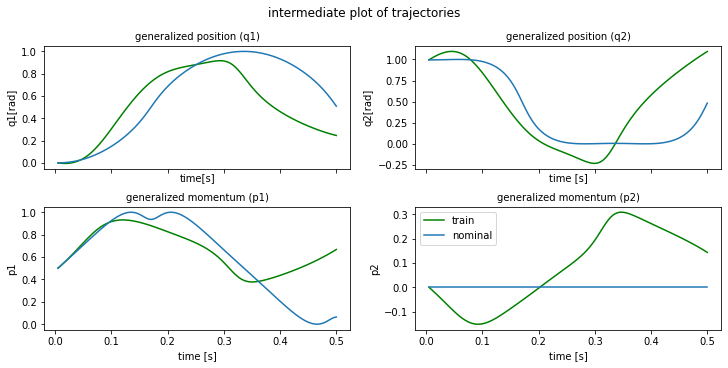

plot time : 1.2748196125030518
min max values updated
epoch  200 | train time 2.95 | train loss 2.054965e-01 | test loss 1.690887e-01 | test time 0.42  
epoch  201 | train time 1.83 | train loss 1.662445e-01 
epoch  202 | train time 1.64 | train loss 1.585032e-01 
epoch  203 | train time 1.62 | train loss 1.682476e-01 
epoch  204 | train time 1.59 | train loss 1.246219e-01 
epoch  205 | train time 1.55 | train loss 1.145526e-01 
epoch  206 | train time 1.70 | train loss 1.293936e-01 
epoch  207 | train time 1.59 | train loss 9.735429e-02 
epoch  208 | train time 1.55 | train loss 9.778918e-02 
epoch  209 | train time 1.60 | train loss 1.065758e-01 


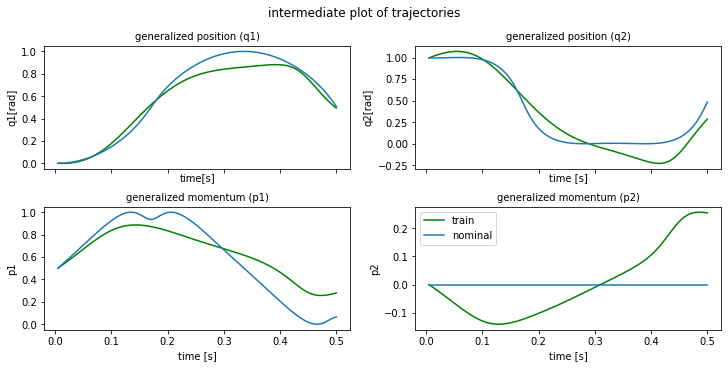

plot time : 1.1913554668426514
epoch  210 | train time 2.83 | train loss 8.671357e-02 | test loss 9.948348e-02 | test time 0.41  
epoch  211 | train time 1.88 | train loss 9.546323e-02 
epoch  212 | train time 1.59 | train loss 1.018506e-01 
epoch  213 | train time 1.57 | train loss 8.172205e-02 
epoch  214 | train time 1.59 | train loss 9.061070e-02 
epoch  215 | train time 1.58 | train loss 9.070954e-02 
epoch  216 | train time 1.57 | train loss 7.985370e-02 
epoch  217 | train time 1.58 | train loss 8.043116e-02 
epoch  218 | train time 1.63 | train loss 7.510798e-02 
epoch  219 | train time 1.62 | train loss 7.886775e-02 


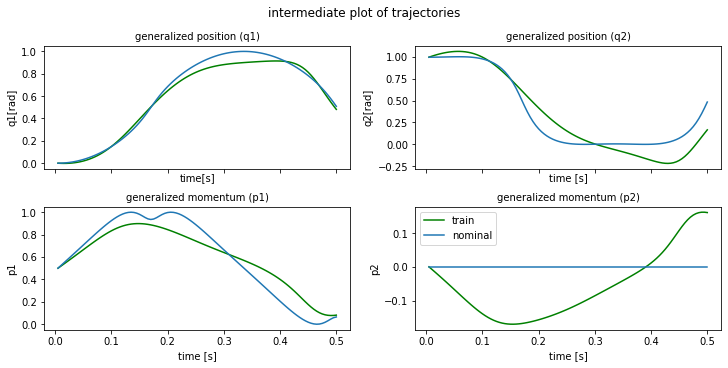

plot time : 1.1422433853149414
epoch  220 | train time 2.80 | train loss 7.102088e-02 | test loss 7.250477e-02 | test time 0.41  
epoch  221 | train time 1.62 | train loss 7.075569e-02 
epoch  222 | train time 1.81 | train loss 7.297994e-02 
epoch  223 | train time 1.82 | train loss 5.705830e-02 
epoch  224 | train time 1.75 | train loss 6.210775e-02 
epoch  225 | train time 1.63 | train loss 5.326840e-02 
epoch  226 | train time 1.81 | train loss 6.561632e-02 
epoch  227 | train time 1.63 | train loss 5.899011e-02 
epoch  228 | train time 1.55 | train loss 5.917867e-02 
epoch  229 | train time 1.55 | train loss 6.079764e-02 


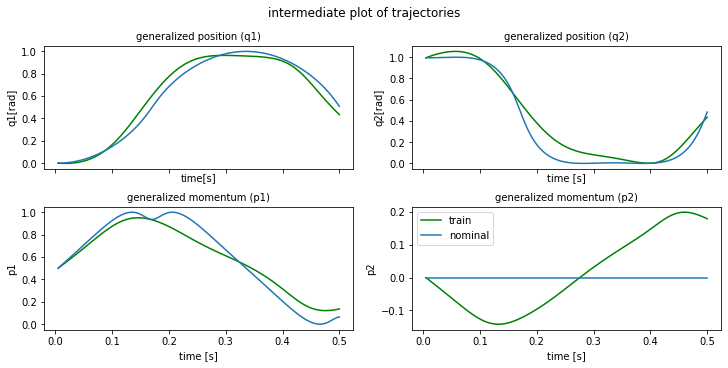

plot time : 1.2123637199401855
epoch  230 | train time 2.93 | train loss 5.606119e-02 | test loss 5.991381e-02 | test time 0.40  
epoch  231 | train time 1.56 | train loss 5.442357e-02 
epoch  232 | train time 1.62 | train loss 5.864168e-02 
epoch  233 | train time 1.62 | train loss 5.514047e-02 
epoch  234 | train time 1.88 | train loss 5.508820e-02 
epoch  235 | train time 1.64 | train loss 5.348337e-02 
epoch  236 | train time 1.70 | train loss 5.251513e-02 
epoch  237 | train time 1.62 | train loss 5.123783e-02 
epoch  238 | train time 1.65 | train loss 5.157311e-02 
epoch  239 | train time 1.69 | train loss 5.003399e-02 


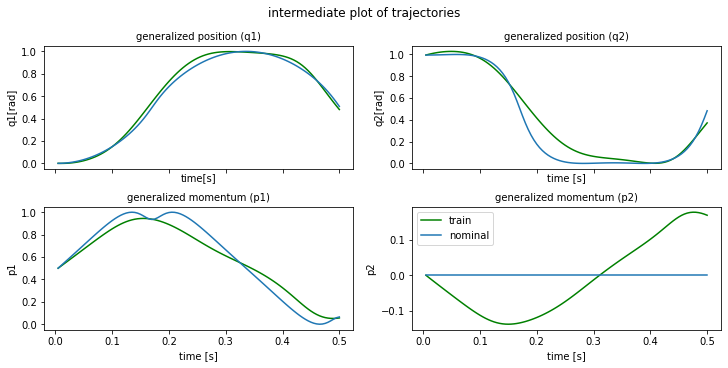

plot time : 1.1531622409820557
epoch  240 | train time 2.85 | train loss 5.084514e-02 | test loss 6.177406e-02 | test time 0.41  
epoch  241 | train time 1.72 | train loss 5.114203e-02 
epoch  242 | train time 1.55 | train loss 4.764928e-02 
epoch  243 | train time 1.57 | train loss 5.097473e-02 
epoch  244 | train time 1.85 | train loss 4.554432e-02 
epoch  245 | train time 1.54 | train loss 6.550380e-02 
epoch  246 | train time 1.55 | train loss 6.753356e-02 
epoch  247 | train time 1.59 | train loss 4.491539e-02 
epoch  248 | train time 1.56 | train loss 6.224789e-02 
epoch  249 | train time 1.55 | train loss 6.571982e-02 


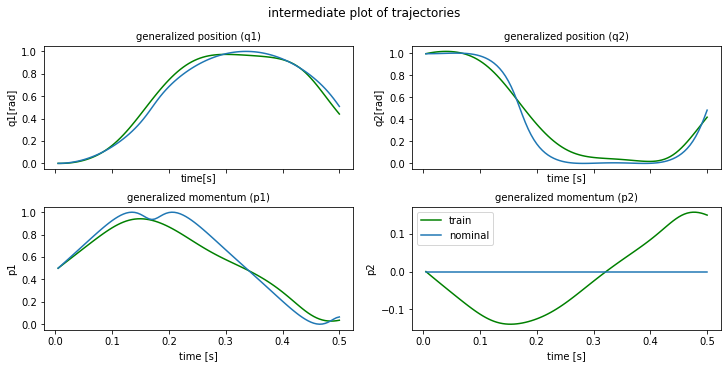

plot time : 1.2347331047058105
epoch  250 | train time 2.83 | train loss 4.334872e-02 | test loss 8.601075e-02 | test time 0.42  
epoch  251 | train time 1.80 | train loss 7.355749e-02 
epoch  252 | train time 1.85 | train loss 9.067272e-02 
epoch  253 | train time 1.64 | train loss 6.299067e-02 
epoch  254 | train time 1.71 | train loss 5.330996e-02 
epoch  255 | train time 1.78 | train loss 7.119925e-02 
epoch  256 | train time 1.65 | train loss 7.536796e-02 
epoch  257 | train time 1.57 | train loss 5.015671e-02 
epoch  258 | train time 1.67 | train loss 5.800704e-02 
epoch  259 | train time 1.59 | train loss 7.105102e-02 


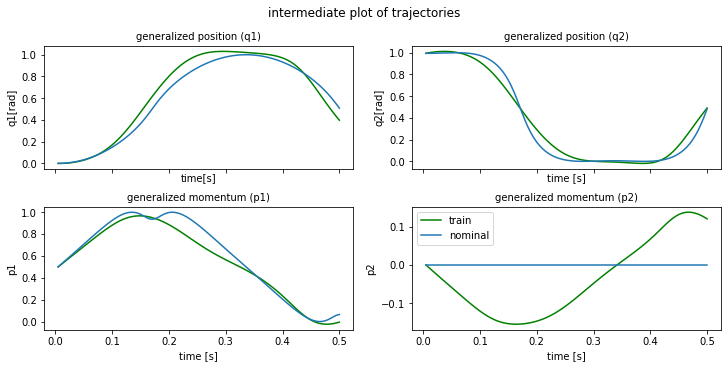

plot time : 1.2198257446289062
epoch  260 | train time 2.88 | train loss 5.751485e-02 | test loss 5.158108e-02 | test time 0.42  
epoch  261 | train time 1.67 | train loss 4.602243e-02 
epoch  262 | train time 1.57 | train loss 6.044227e-02 
epoch  263 | train time 1.66 | train loss 5.830261e-02 
epoch  264 | train time 1.73 | train loss 4.228420e-02 
epoch  265 | train time 1.58 | train loss 5.626819e-02 
epoch  266 | train time 1.53 | train loss 4.864205e-02 
epoch  267 | train time 1.72 | train loss 4.923439e-02 
epoch  268 | train time 1.58 | train loss 5.296786e-02 
epoch  269 | train time 1.55 | train loss 4.223812e-02 


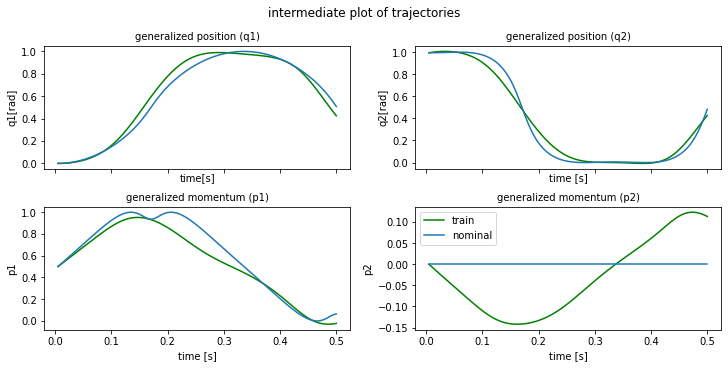

plot time : 1.253258466720581
epoch  270 | train time 2.85 | train loss 5.350102e-02 | test loss 6.256717e-02 | test time 0.40  
epoch  271 | train time 1.66 | train loss 5.083951e-02 
epoch  272 | train time 1.69 | train loss 4.220299e-02 
epoch  273 | train time 1.67 | train loss 4.910823e-02 
epoch  274 | train time 1.87 | train loss 4.150246e-02 
epoch  275 | train time 1.63 | train loss 4.751254e-02 
epoch  276 | train time 1.56 | train loss 4.476628e-02 
epoch  277 | train time 1.57 | train loss 4.748065e-02 
epoch  278 | train time 1.55 | train loss 5.072169e-02 
epoch  279 | train time 1.67 | train loss 4.189906e-02 


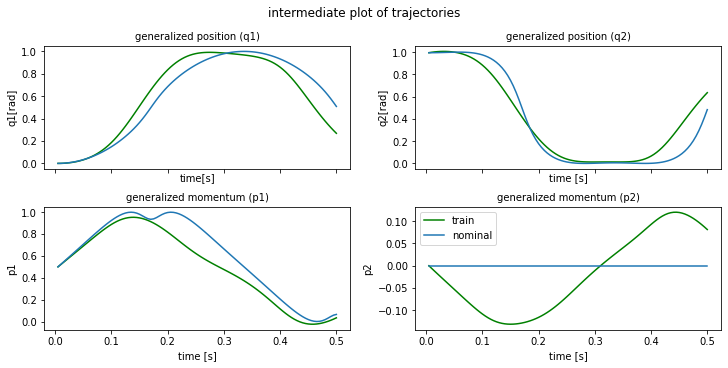

plot time : 1.170384407043457
epoch  280 | train time 2.76 | train loss 4.965614e-02 | test loss 5.214999e-02 | test time 0.40  
epoch  281 | train time 1.56 | train loss 4.460835e-02 
epoch  282 | train time 1.54 | train loss 4.844786e-02 
epoch  283 | train time 1.59 | train loss 5.011372e-02 
epoch  284 | train time 1.63 | train loss 4.155181e-02 
epoch  285 | train time 1.55 | train loss 4.434033e-02 
epoch  286 | train time 1.69 | train loss 4.299103e-02 
epoch  287 | train time 1.57 | train loss 4.170801e-02 
epoch  288 | train time 1.63 | train loss 3.975789e-02 
epoch  289 | train time 1.79 | train loss 4.662389e-02 


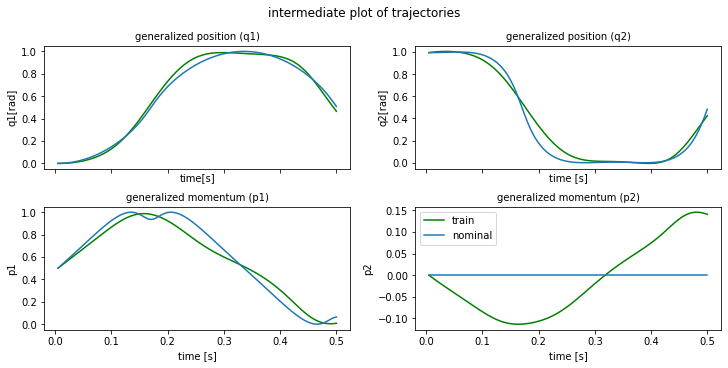

plot time : 1.1725032329559326
epoch  290 | train time 2.77 | train loss 4.389618e-02 | test loss 4.876420e-02 | test time 0.40  
epoch  291 | train time 1.70 | train loss 4.497071e-02 
epoch  292 | train time 1.66 | train loss 4.534596e-02 
epoch  293 | train time 1.58 | train loss 4.481303e-02 
epoch  294 | train time 1.70 | train loss 4.211296e-02 
epoch  295 | train time 1.53 | train loss 4.712338e-02 
epoch  296 | train time 1.67 | train loss 4.130564e-02 
epoch  297 | train time 1.54 | train loss 4.996651e-02 
epoch  298 | train time 1.68 | train loss 4.762917e-02 
epoch  299 | train time 1.68 | train loss 4.159468e-02 
horizon length : 150
min max values updated


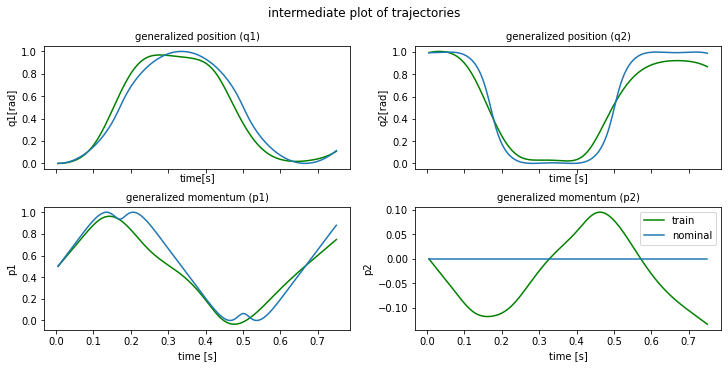

plot time : 1.1925749778747559
min max values updated
epoch  300 | train time 3.58 | train loss 8.371616e-02 | test loss 8.793321e-02 | test time 0.63  
epoch  301 | train time 2.93 | train loss 6.902325e-02 
epoch  302 | train time 2.88 | train loss 6.695629e-02 
epoch  303 | train time 2.39 | train loss 7.797392e-02 
epoch  304 | train time 2.38 | train loss 6.585921e-02 
epoch  305 | train time 2.44 | train loss 1.009283e-01 
epoch  306 | train time 2.32 | train loss 1.152711e-01 
epoch  307 | train time 2.32 | train loss 6.377126e-02 
epoch  308 | train time 2.31 | train loss 1.613432e-01 
epoch  309 | train time 2.48 | train loss 2.722931e-01 


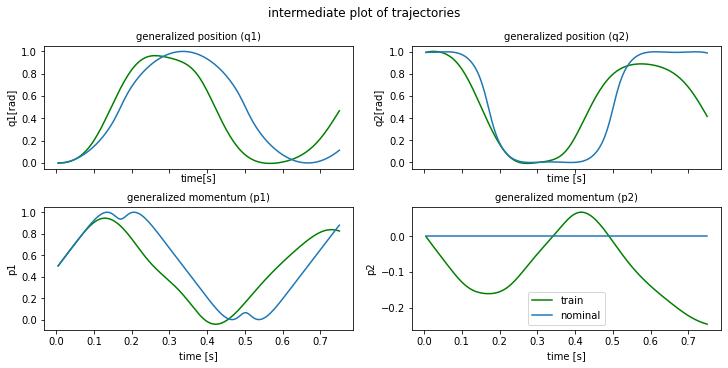

plot time : 1.187575101852417
epoch  310 | train time 3.74 | train loss 1.907926e-01 | test loss 7.703016e-02 | test time 0.75  
epoch  311 | train time 2.47 | train loss 6.519965e-02 
epoch  312 | train time 2.44 | train loss 1.801008e-01 
epoch  313 | train time 2.53 | train loss 2.951215e-01 
epoch  314 | train time 2.65 | train loss 2.477771e-01 
epoch  315 | train time 2.62 | train loss 1.439050e-01 
epoch  316 | train time 2.32 | train loss 1.339809e-01 
epoch  317 | train time 2.38 | train loss 1.764469e-01 
epoch  318 | train time 2.50 | train loss 1.575281e-01 
epoch  319 | train time 2.47 | train loss 1.012549e-01 


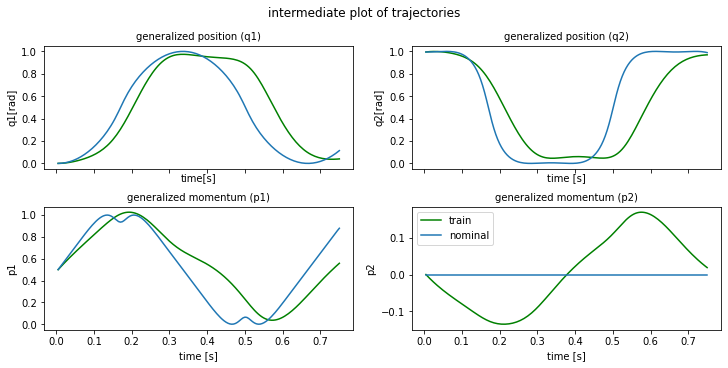

plot time : 1.2107524871826172
epoch  320 | train time 3.71 | train loss 1.188680e-01 | test loss 1.623905e-01 | test time 0.59  
epoch  321 | train time 2.75 | train loss 1.336112e-01 
epoch  322 | train time 2.65 | train loss 9.599163e-02 
epoch  323 | train time 2.43 | train loss 7.957761e-02 
epoch  324 | train time 2.36 | train loss 1.002623e-01 
epoch  325 | train time 2.56 | train loss 9.077262e-02 
epoch  326 | train time 2.32 | train loss 6.951373e-02 
epoch  327 | train time 2.39 | train loss 7.861044e-02 
epoch  328 | train time 2.52 | train loss 7.058918e-02 
epoch  329 | train time 2.32 | train loss 8.467592e-02 


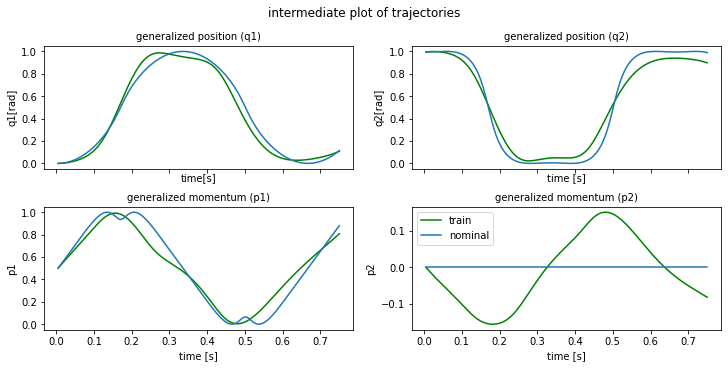

plot time : 1.1924653053283691
epoch  330 | train time 3.53 | train loss 8.466048e-02 | test loss 8.688711e-02 | test time 0.64  
epoch  331 | train time 2.33 | train loss 6.789091e-02 
epoch  332 | train time 2.46 | train loss 7.087698e-02 
epoch  333 | train time 2.40 | train loss 6.663599e-02 
epoch  334 | train time 2.43 | train loss 6.605052e-02 
epoch  335 | train time 2.34 | train loss 6.859212e-02 
epoch  336 | train time 2.54 | train loss 6.061742e-02 
epoch  337 | train time 2.54 | train loss 8.797076e-02 
epoch  338 | train time 2.43 | train loss 9.298319e-02 
epoch  339 | train time 2.32 | train loss 6.013245e-02 


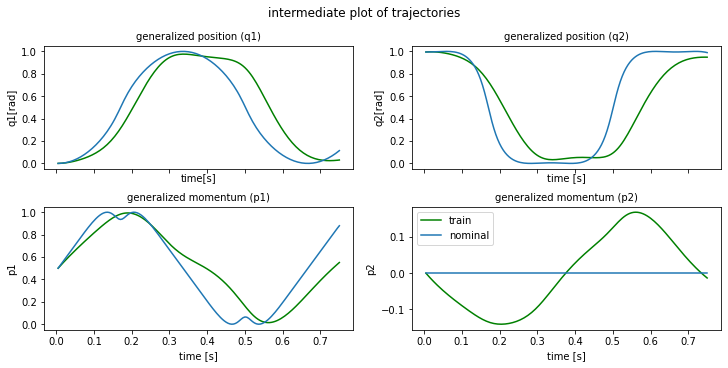

plot time : 1.2539479732513428
epoch  340 | train time 3.77 | train loss 1.153955e-01 | test loss 1.863462e-01 | test time 0.63  
epoch  341 | train time 2.30 | train loss 1.551261e-01 
epoch  342 | train time 2.47 | train loss 1.035459e-01 
epoch  343 | train time 2.38 | train loss 7.455649e-02 
epoch  344 | train time 2.31 | train loss 9.600647e-02 
epoch  345 | train time 2.30 | train loss 8.757602e-02 
epoch  346 | train time 2.39 | train loss 7.998551e-02 
epoch  347 | train time 2.48 | train loss 7.560267e-02 
epoch  348 | train time 2.32 | train loss 7.348657e-02 
epoch  349 | train time 2.33 | train loss 7.632467e-02 


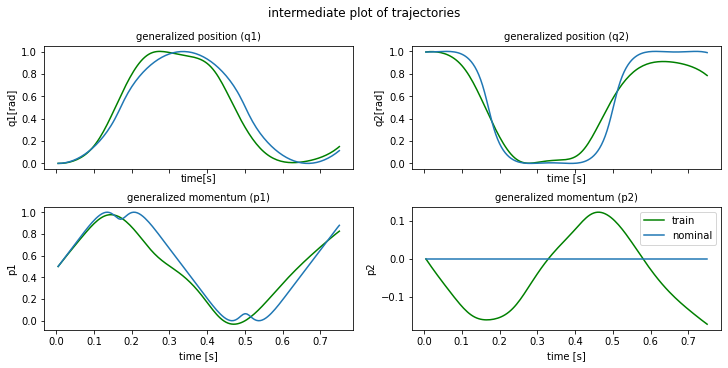

plot time : 1.1872978210449219
epoch  350 | train time 3.54 | train loss 6.055485e-02 | test loss 1.037720e-01 | test time 0.65  
epoch  351 | train time 2.72 | train loss 8.430701e-02 
epoch  352 | train time 2.61 | train loss 9.045566e-02 
epoch  353 | train time 2.30 | train loss 5.900033e-02 
epoch  354 | train time 2.48 | train loss 1.224018e-01 
epoch  355 | train time 2.29 | train loss 1.854732e-01 
epoch  356 | train time 2.32 | train loss 1.347920e-01 
epoch  357 | train time 3.34 | train loss 6.246835e-02 
epoch  358 | train time 3.65 | train loss 1.333826e-01 
epoch  359 | train time 2.46 | train loss 2.025617e-01 


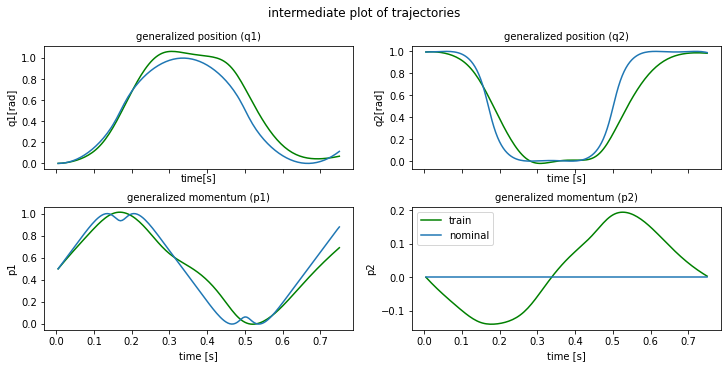

plot time : 1.1976017951965332
epoch  360 | train time 3.73 | train loss 1.794817e-01 | test loss 1.525447e-01 | test time 0.77  
epoch  361 | train time 2.87 | train loss 1.234859e-01 
epoch  362 | train time 3.60 | train loss 1.071793e-01 
epoch  363 | train time 3.84 | train loss 1.196611e-01 
epoch  364 | train time 3.38 | train loss 1.063926e-01 
epoch  365 | train time 2.42 | train loss 1.131257e-01 
epoch  366 | train time 2.42 | train loss 1.106719e-01 
epoch  367 | train time 2.35 | train loss 8.366869e-02 
epoch  368 | train time 3.80 | train loss 9.157356e-02 
epoch  369 | train time 5.38 | train loss 9.053728e-02 


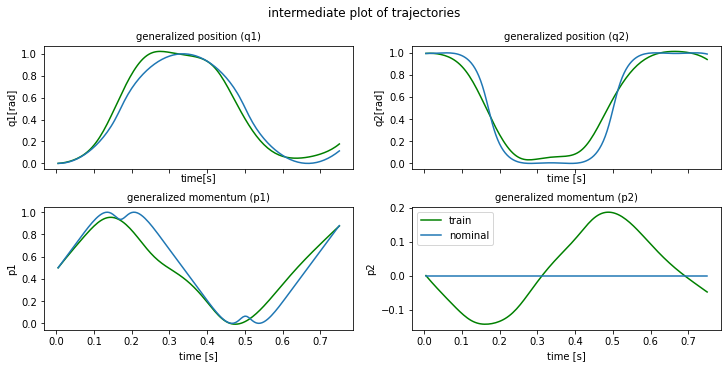

plot time : 2.0410261154174805
epoch  370 | train time 5.59 | train loss 7.531916e-02 | test loss 1.068046e-01 | test time 0.75  
epoch  371 | train time 2.51 | train loss 9.002205e-02 
epoch  372 | train time 2.33 | train loss 9.687803e-02 
epoch  373 | train time 2.31 | train loss 7.583164e-02 
epoch  374 | train time 2.47 | train loss 7.618557e-02 
epoch  375 | train time 2.46 | train loss 8.569108e-02 
epoch  376 | train time 2.52 | train loss 7.710397e-02 
epoch  377 | train time 2.59 | train loss 6.379793e-02 
epoch  378 | train time 2.41 | train loss 8.343083e-02 
epoch  379 | train time 2.50 | train loss 8.704264e-02 


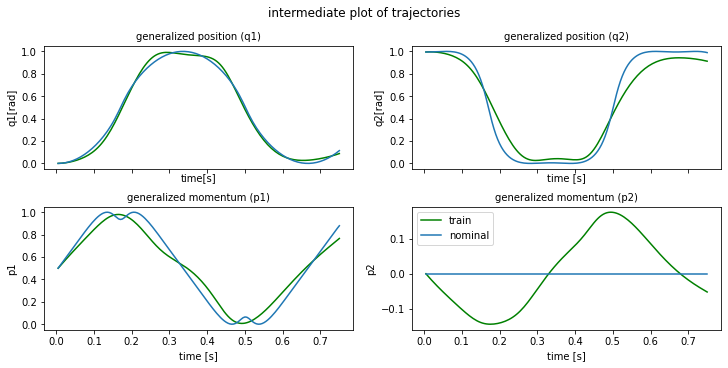

plot time : 1.9830186367034912
epoch  380 | train time 5.11 | train loss 6.324442e-02 | test loss 1.056443e-01 | test time 0.90  
epoch  381 | train time 3.93 | train loss 8.580952e-02 
epoch  382 | train time 3.97 | train loss 1.069490e-01 
epoch  383 | train time 3.97 | train loss 8.553787e-02 
epoch  384 | train time 3.72 | train loss 6.648269e-02 
epoch  385 | train time 3.45 | train loss 7.846687e-02 
epoch  386 | train time 2.58 | train loss 8.406794e-02 
epoch  387 | train time 2.46 | train loss 6.531113e-02 
epoch  388 | train time 2.43 | train loss 8.240534e-02 
epoch  389 | train time 2.58 | train loss 9.813634e-02 


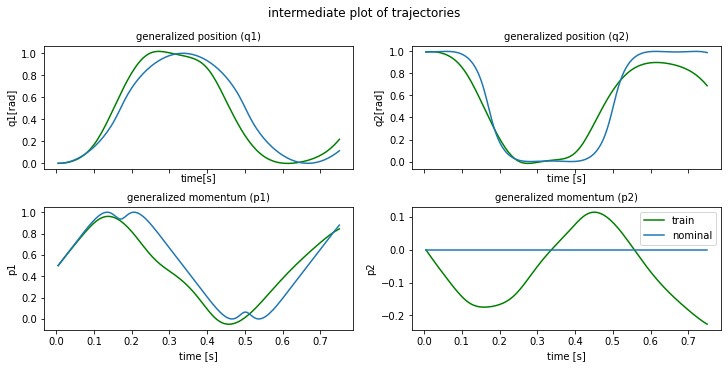

plot time : 1.1872859001159668
epoch  390 | train time 3.83 | train loss 7.209975e-02 | test loss 9.038454e-02 | test time 0.60  
epoch  391 | train time 2.35 | train loss 7.368261e-02 
epoch  392 | train time 3.47 | train loss 8.883922e-02 
epoch  393 | train time 3.55 | train loss 8.157560e-02 
epoch  394 | train time 2.41 | train loss 6.928474e-02 
epoch  395 | train time 2.38 | train loss 6.517661e-02 
epoch  396 | train time 2.31 | train loss 7.221720e-02 
epoch  397 | train time 2.31 | train loss 6.067356e-02 
epoch  398 | train time 2.45 | train loss 8.151515e-02 
epoch  399 | train time 2.36 | train loss 9.495496e-02 
horizon length : 200
min max values updated


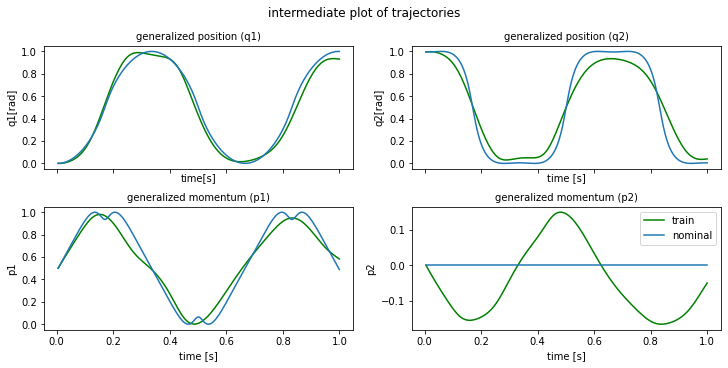

plot time : 1.2316157817840576
min max values updated
epoch  400 | train time 4.39 | train loss 8.569600e-02 | test loss 1.735674e-01 | test time 0.93  
epoch  401 | train time 3.40 | train loss 1.387209e-01 
epoch  402 | train time 3.11 | train loss 1.766382e-01 
epoch  403 | train time 3.15 | train loss 1.322843e-01 
epoch  404 | train time 3.33 | train loss 1.047155e-01 
epoch  405 | train time 3.25 | train loss 1.213225e-01 
epoch  406 | train time 3.30 | train loss 1.107304e-01 
epoch  407 | train time 3.14 | train loss 1.095117e-01 
epoch  408 | train time 3.20 | train loss 9.905487e-02 
epoch  409 | train time 3.24 | train loss 1.024015e-01 


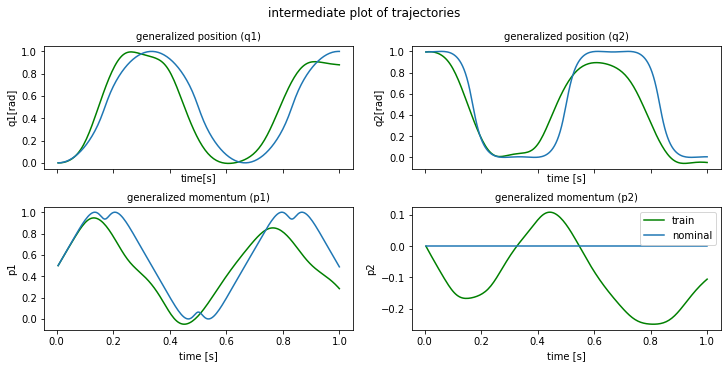

plot time : 1.24599027633667
epoch  410 | train time 4.66 | train loss 1.028326e-01 | test loss 9.168370e-02 | test time 1.02  
epoch  411 | train time 3.28 | train loss 7.657804e-02 
epoch  412 | train time 3.09 | train loss 8.474969e-02 
epoch  413 | train time 3.11 | train loss 7.856431e-02 
epoch  414 | train time 3.28 | train loss 7.624885e-02 
epoch  415 | train time 3.18 | train loss 7.549477e-02 
epoch  416 | train time 3.13 | train loss 7.467995e-02 
epoch  417 | train time 3.10 | train loss 8.206132e-02 
epoch  418 | train time 3.22 | train loss 7.670520e-02 
epoch  419 | train time 3.19 | train loss 7.762180e-02 


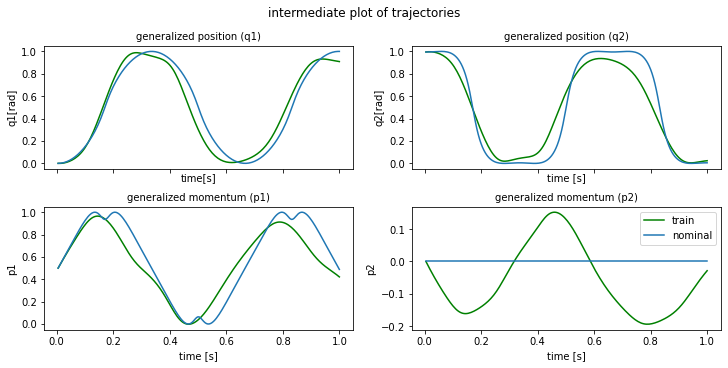

plot time : 1.1743254661560059
epoch  420 | train time 4.46 | train loss 7.734822e-02 | test loss 1.047114e-01 | test time 0.82  
epoch  421 | train time 3.23 | train loss 8.232166e-02 
epoch  422 | train time 3.26 | train loss 7.475023e-02 
epoch  423 | train time 3.16 | train loss 9.957805e-02 
epoch  424 | train time 3.42 | train loss 1.062493e-01 
epoch  425 | train time 3.38 | train loss 8.204303e-02 
epoch  426 | train time 3.27 | train loss 9.622402e-02 
epoch  427 | train time 3.31 | train loss 9.528138e-02 
epoch  428 | train time 3.19 | train loss 7.372663e-02 
epoch  429 | train time 3.38 | train loss 8.852576e-02 


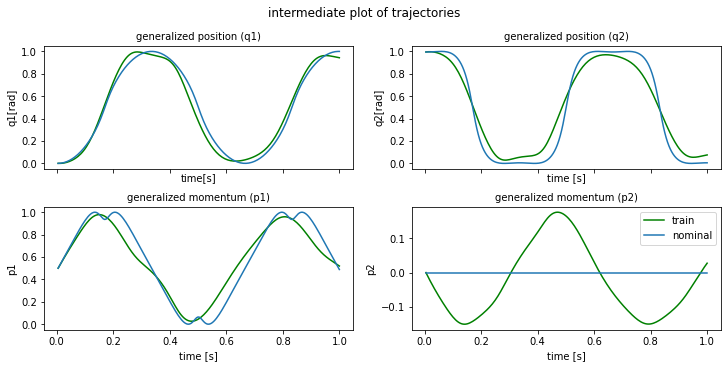

plot time : 1.2216980457305908
epoch  430 | train time 4.47 | train loss 7.423436e-02 | test loss 1.298730e-01 | test time 0.80  
epoch  431 | train time 3.10 | train loss 1.030324e-01 
epoch  432 | train time 3.36 | train loss 1.171501e-01 
epoch  433 | train time 3.29 | train loss 8.551105e-02 
epoch  434 | train time 3.30 | train loss 8.934352e-02 
epoch  435 | train time 3.36 | train loss 1.062114e-01 
epoch  436 | train time 3.33 | train loss 8.029505e-02 
epoch  437 | train time 3.20 | train loss 9.768409e-02 
epoch  438 | train time 3.16 | train loss 1.119065e-01 
epoch  439 | train time 3.55 | train loss 7.753750e-02 


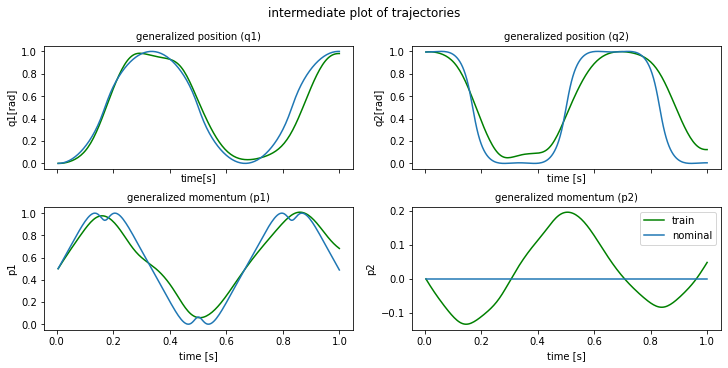

plot time : 1.152862548828125
epoch  440 | train time 4.33 | train loss 9.442843e-02 | test loss 1.112438e-01 | test time 0.81  
epoch  441 | train time 3.21 | train loss 1.102133e-01 
epoch  442 | train time 3.17 | train loss 7.518433e-02 
epoch  443 | train time 3.22 | train loss 1.118611e-01 
epoch  444 | train time 3.22 | train loss 1.466595e-01 
epoch  445 | train time 3.49 | train loss 1.049427e-01 
epoch  446 | train time 3.47 | train loss 7.642093e-02 
epoch  447 | train time 3.10 | train loss 9.600992e-02 
epoch  448 | train time 3.40 | train loss 7.894660e-02 
epoch  449 | train time 3.54 | train loss 9.416571e-02 


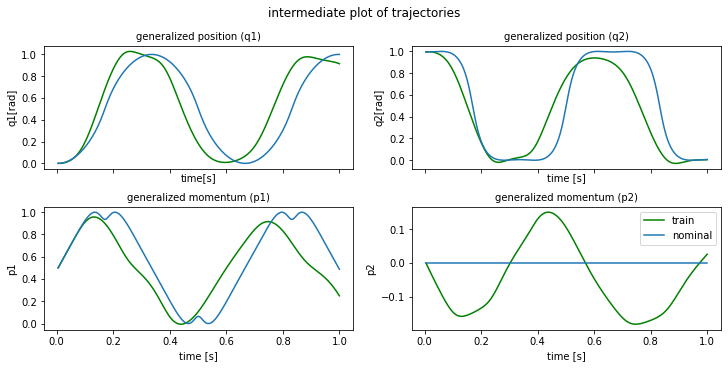

plot time : 1.156205415725708
epoch  450 | train time 4.45 | train loss 1.077780e-01 | test loss 1.058509e-01 | test time 0.80  
epoch  451 | train time 3.17 | train loss 8.124439e-02 
epoch  452 | train time 3.19 | train loss 8.201148e-02 
epoch  453 | train time 3.27 | train loss 9.167641e-02 
epoch  454 | train time 3.06 | train loss 6.962737e-02 
epoch  455 | train time 3.09 | train loss 1.346063e-01 
epoch  456 | train time 3.40 | train loss 1.659723e-01 
epoch  457 | train time 3.64 | train loss 1.274615e-01 
epoch  458 | train time 3.14 | train loss 9.477505e-02 
epoch  459 | train time 3.13 | train loss 1.044361e-01 


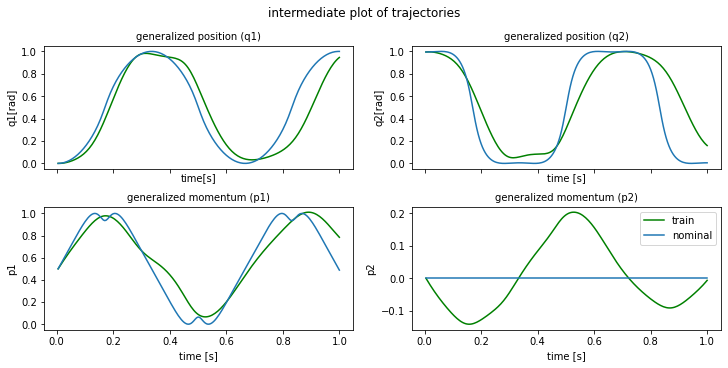

plot time : 1.1625351905822754
epoch  460 | train time 4.48 | train loss 1.220786e-01 | test loss 1.262188e-01 | test time 0.83  
epoch  461 | train time 3.20 | train loss 1.039321e-01 
epoch  462 | train time 3.10 | train loss 7.636109e-02 
epoch  463 | train time 3.29 | train loss 9.221803e-02 
epoch  464 | train time 3.10 | train loss 7.084760e-02 
epoch  465 | train time 3.13 | train loss 1.264720e-01 
epoch  466 | train time 3.37 | train loss 1.473549e-01 
epoch  467 | train time 3.25 | train loss 9.766825e-02 
epoch  468 | train time 3.14 | train loss 1.093636e-01 
epoch  469 | train time 3.30 | train loss 1.341094e-01 


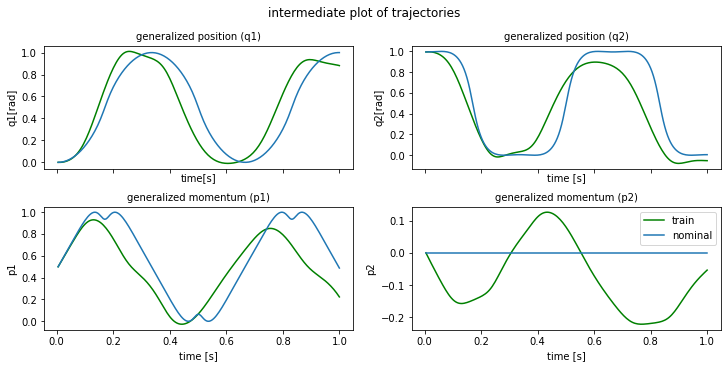

plot time : 1.1547772884368896
epoch  470 | train time 4.28 | train loss 1.102136e-01 | test loss 1.370651e-01 | test time 0.82  
epoch  471 | train time 3.25 | train loss 1.108448e-01 
epoch  472 | train time 3.31 | train loss 9.794864e-02 
epoch  473 | train time 3.34 | train loss 1.043600e-01 
epoch  474 | train time 3.21 | train loss 1.139539e-01 
epoch  475 | train time 3.09 | train loss 7.493134e-02 
epoch  476 | train time 3.28 | train loss 1.362279e-01 
epoch  477 | train time 3.32 | train loss 1.769373e-01 
epoch  478 | train time 3.36 | train loss 1.262963e-01 
epoch  479 | train time 3.29 | train loss 9.871271e-02 


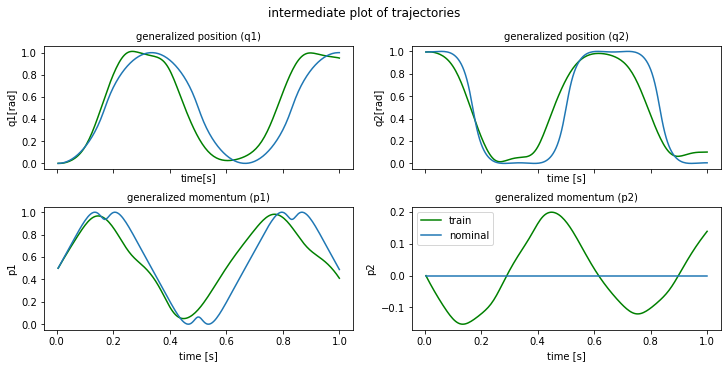

plot time : 1.1688339710235596
epoch  480 | train time 4.60 | train loss 1.165308e-01 | test loss 1.059959e-01 | test time 0.81  
epoch  481 | train time 3.08 | train loss 1.051079e-01 
epoch  482 | train time 3.18 | train loss 1.111523e-01 
epoch  483 | train time 3.18 | train loss 1.012018e-01 
epoch  484 | train time 3.24 | train loss 8.475740e-02 
epoch  485 | train time 3.24 | train loss 8.899108e-02 
epoch  486 | train time 3.09 | train loss 7.018505e-02 
epoch  487 | train time 3.28 | train loss 7.398688e-02 
epoch  488 | train time 3.23 | train loss 7.566242e-02 
epoch  489 | train time 3.24 | train loss 6.810080e-02 


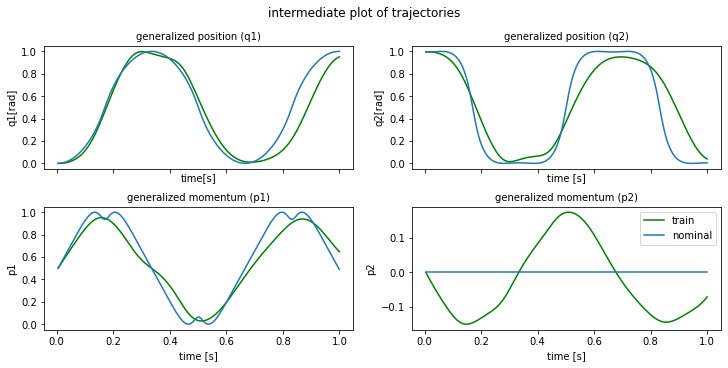

plot time : 1.2395644187927246
epoch  490 | train time 4.45 | train loss 1.063682e-01 | test loss 1.188684e-01 | test time 0.81  
epoch  491 | train time 3.31 | train loss 9.573363e-02 
epoch  492 | train time 3.33 | train loss 7.486237e-02 
epoch  493 | train time 3.33 | train loss 7.677287e-02 
epoch  494 | train time 3.28 | train loss 8.200714e-02 
epoch  495 | train time 3.20 | train loss 7.538640e-02 
epoch  496 | train time 3.27 | train loss 9.602493e-02 
epoch  497 | train time 3.27 | train loss 9.636259e-02 
epoch  498 | train time 3.28 | train loss 6.991785e-02 
epoch  499 | train time 3.27 | train loss 6.725541e-02 
horizon length : 250
min max values updated


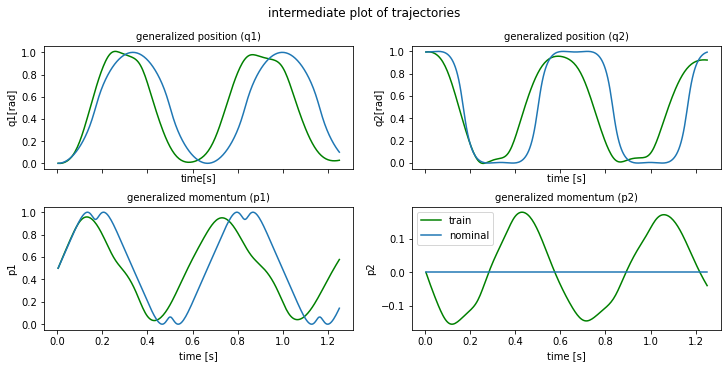

plot time : 1.310178279876709
min max values updated
epoch  500 | train time 5.46 | train loss 1.144058e-01 | test loss 1.235500e-01 | test time 1.23  
epoch  501 | train time 3.99 | train loss 1.073028e-01 
epoch  502 | train time 3.97 | train loss 1.031408e-01 
epoch  503 | train time 3.93 | train loss 9.958004e-02 
epoch  504 | train time 3.96 | train loss 1.139598e-01 
epoch  505 | train time 4.04 | train loss 1.097434e-01 
epoch  506 | train time 3.94 | train loss 1.021183e-01 
epoch  507 | train time 4.02 | train loss 9.794386e-02 
epoch  508 | train time 4.69 | train loss 1.116474e-01 
epoch  509 | train time 6.13 | train loss 1.061366e-01 


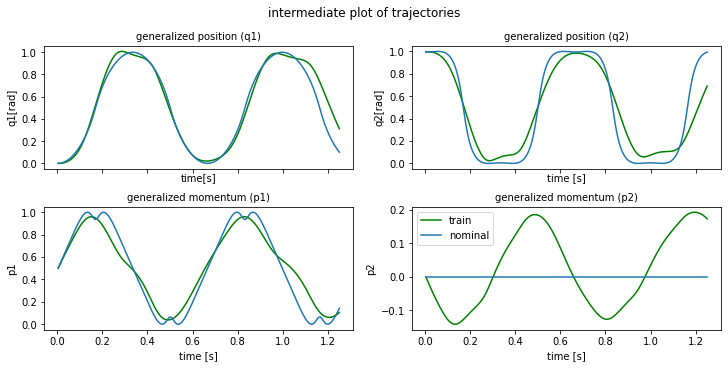

plot time : 1.2532978057861328
epoch  510 | train time 5.66 | train loss 1.022012e-01 | test loss 1.275088e-01 | test time 1.01  
epoch  511 | train time 3.89 | train loss 9.750459e-02 
epoch  512 | train time 4.12 | train loss 1.102018e-01 
epoch  513 | train time 4.08 | train loss 1.042870e-01 
epoch  514 | train time 4.12 | train loss 1.013358e-01 
epoch  515 | train time 4.14 | train loss 9.913260e-02 
epoch  516 | train time 4.20 | train loss 1.019312e-01 
epoch  517 | train time 3.99 | train loss 9.518891e-02 
epoch  518 | train time 3.87 | train loss 1.103724e-01 
epoch  519 | train time 3.95 | train loss 1.074675e-01 


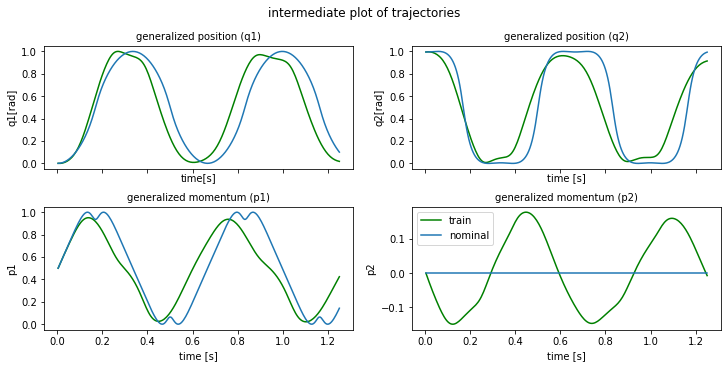

plot time : 1.168785572052002
epoch  520 | train time 5.19 | train loss 9.367110e-02 | test loss 1.012149e-01 | test time 1.01  
epoch  521 | train time 3.98 | train loss 8.882829e-02 
epoch  522 | train time 4.05 | train loss 1.157629e-01 
epoch  523 | train time 4.21 | train loss 1.111222e-01 
epoch  524 | train time 4.10 | train loss 9.078463e-02 
epoch  525 | train time 3.89 | train loss 8.748827e-02 
epoch  526 | train time 3.89 | train loss 1.142725e-01 
epoch  527 | train time 4.15 | train loss 1.081891e-01 
epoch  528 | train time 4.21 | train loss 9.285510e-02 
epoch  529 | train time 4.01 | train loss 8.911275e-02 


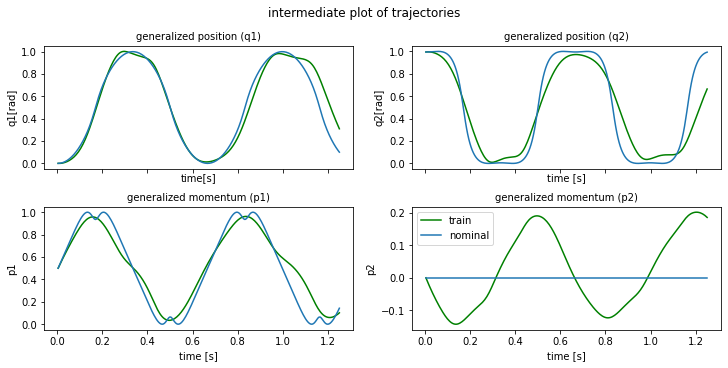

plot time : 1.1634349822998047
epoch  530 | train time 5.32 | train loss 1.115466e-01 | test loss 1.398463e-01 | test time 1.00  
epoch  531 | train time 4.15 | train loss 1.071404e-01 
epoch  532 | train time 4.08 | train loss 9.256777e-02 
epoch  533 | train time 4.22 | train loss 8.815603e-02 
epoch  534 | train time 3.97 | train loss 1.131338e-01 
epoch  535 | train time 3.95 | train loss 1.097071e-01 
epoch  536 | train time 3.91 | train loss 8.933767e-02 
epoch  537 | train time 4.07 | train loss 8.427764e-02 
epoch  538 | train time 3.92 | train loss 1.201429e-01 
epoch  539 | train time 4.14 | train loss 1.171853e-01 


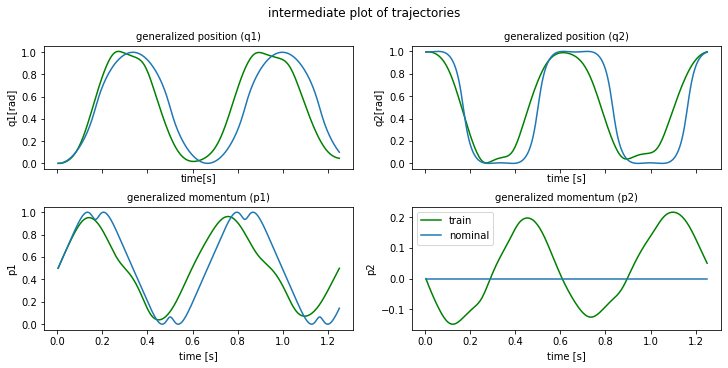

plot time : 1.1843509674072266
epoch  540 | train time 5.35 | train loss 8.567921e-02 | test loss 9.564226e-02 | test time 1.01  
epoch  541 | train time 3.98 | train loss 8.174584e-02 
epoch  542 | train time 4.08 | train loss 1.221201e-01 
epoch  543 | train time 3.87 | train loss 1.176828e-01 
epoch  544 | train time 3.84 | train loss 8.734673e-02 
epoch  545 | train time 3.98 | train loss 8.200741e-02 
epoch  546 | train time 3.93 | train loss 1.205799e-01 
epoch  547 | train time 4.16 | train loss 1.165943e-01 
epoch  548 | train time 3.84 | train loss 9.197386e-02 
epoch  549 | train time 3.91 | train loss 8.572187e-02 


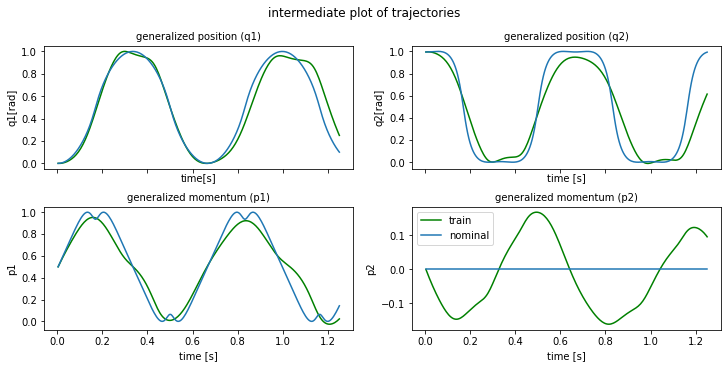

plot time : 1.2223613262176514
epoch  550 | train time 5.17 | train loss 1.100910e-01 | test loss 1.354595e-01 | test time 1.03  
epoch  551 | train time 4.02 | train loss 1.079232e-01 
epoch  552 | train time 3.99 | train loss 9.902234e-02 
epoch  553 | train time 4.86 | train loss 8.911349e-02 
epoch  554 | train time 4.18 | train loss 1.071210e-01 
epoch  555 | train time 3.85 | train loss 1.067957e-01 
epoch  556 | train time 4.28 | train loss 1.008085e-01 
epoch  557 | train time 3.86 | train loss 9.092472e-02 
epoch  558 | train time 4.45 | train loss 1.026366e-01 
epoch  559 | train time 4.01 | train loss 1.024169e-01 


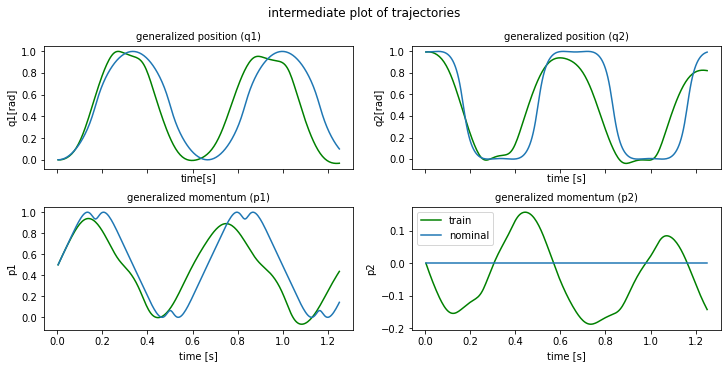

plot time : 1.190420150756836
epoch  560 | train time 5.24 | train loss 1.028573e-01 | test loss 1.013167e-01 | test time 1.26  
epoch  561 | train time 3.92 | train loss 9.183799e-02 
epoch  562 | train time 4.00 | train loss 1.025027e-01 
epoch  563 | train time 3.83 | train loss 1.023408e-01 
epoch  564 | train time 4.10 | train loss 1.021723e-01 
epoch  565 | train time 4.05 | train loss 9.283821e-02 
epoch  566 | train time 4.14 | train loss 9.934535e-02 
epoch  567 | train time 4.11 | train loss 9.828848e-02 
epoch  568 | train time 3.99 | train loss 1.036182e-01 
epoch  569 | train time 3.97 | train loss 9.425156e-02 


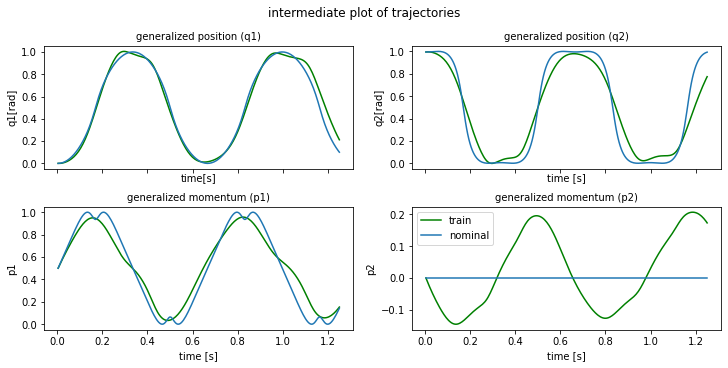

plot time : 1.1805214881896973
epoch  570 | train time 5.22 | train loss 9.828186e-02 | test loss 1.278806e-01 | test time 1.04  
epoch  571 | train time 4.14 | train loss 9.675906e-02 
epoch  572 | train time 4.16 | train loss 1.031441e-01 
epoch  573 | train time 3.83 | train loss 9.558469e-02 
epoch  574 | train time 4.08 | train loss 9.567755e-02 
epoch  575 | train time 4.30 | train loss 9.305253e-02 
epoch  576 | train time 4.01 | train loss 1.042598e-01 
epoch  577 | train time 4.08 | train loss 9.747783e-02 
epoch  578 | train time 4.00 | train loss 9.365749e-02 
epoch  579 | train time 4.42 | train loss 9.052463e-02 


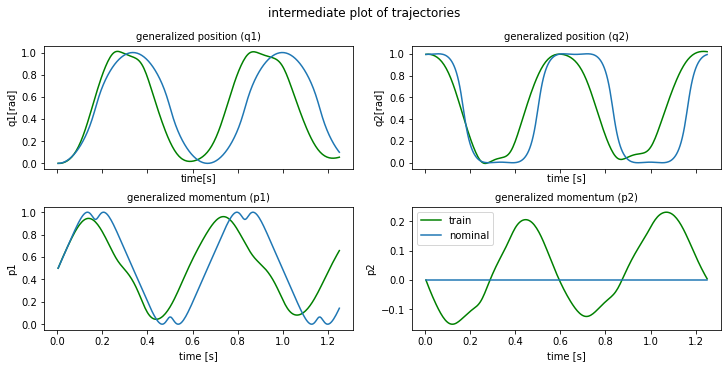

plot time : 1.260549545288086
epoch  580 | train time 5.23 | train loss 1.048404e-01 | test loss 1.099533e-01 | test time 0.99  
epoch  581 | train time 4.03 | train loss 9.925804e-02 
epoch  582 | train time 3.84 | train loss 9.137128e-02 
epoch  583 | train time 3.93 | train loss 8.776786e-02 
epoch  584 | train time 4.20 | train loss 1.058204e-01 
epoch  585 | train time 4.96 | train loss 1.004321e-01 
epoch  586 | train time 3.86 | train loss 9.013307e-02 
epoch  587 | train time 3.84 | train loss 8.657039e-02 
epoch  588 | train time 4.15 | train loss 1.056496e-01 
epoch  589 | train time 4.05 | train loss 1.003864e-01 


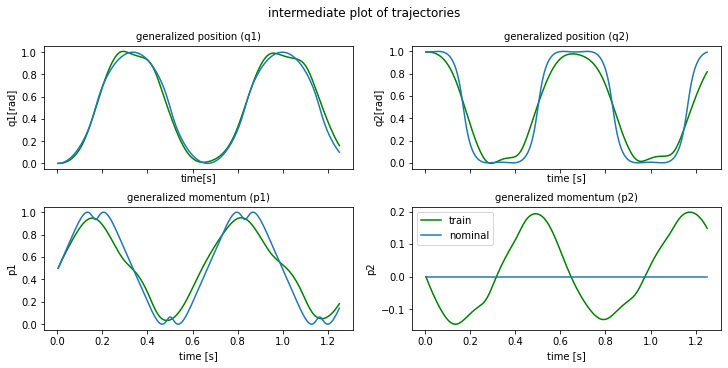

plot time : 1.1653773784637451
epoch  590 | train time 5.18 | train loss 8.973762e-02 | test loss 1.128897e-01 | test time 1.00  
epoch  591 | train time 4.08 | train loss 8.612487e-02 
epoch  592 | train time 3.87 | train loss 1.047569e-01 
epoch  593 | train time 3.86 | train loss 9.947324e-02 
epoch  594 | train time 3.94 | train loss 8.996961e-02 
epoch  595 | train time 3.98 | train loss 8.644428e-02 
epoch  596 | train time 3.91 | train loss 1.031734e-01 
epoch  597 | train time 4.01 | train loss 9.784433e-02 
epoch  598 | train time 3.88 | train loss 9.084698e-02 
epoch  599 | train time 3.85 | train loss 8.734146e-02 
horizon length : 300
min max values updated


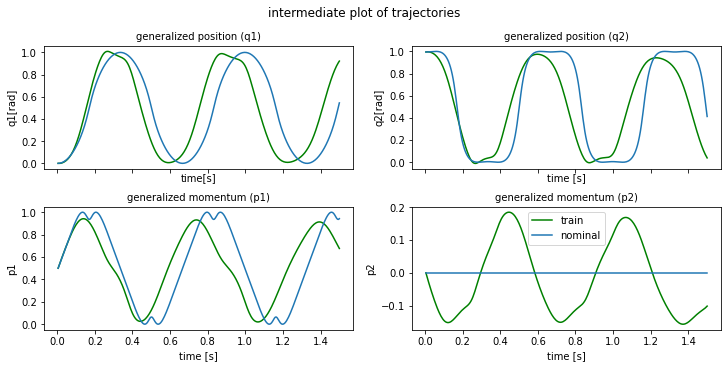

plot time : 1.2100417613983154
min max values updated
epoch  600 | train time 5.93 | train loss 1.183398e-01 | test loss 1.293109e-01 | test time 1.40  
epoch  601 | train time 4.90 | train loss 1.118722e-01 
epoch  602 | train time 5.10 | train loss 1.286912e-01 
epoch  603 | train time 4.98 | train loss 1.250208e-01 
epoch  604 | train time 4.88 | train loss 1.112726e-01 
epoch  605 | train time 4.86 | train loss 1.047913e-01 
epoch  606 | train time 4.69 | train loss 1.349083e-01 
epoch  607 | train time 4.81 | train loss 1.280529e-01 
epoch  608 | train time 4.81 | train loss 1.117333e-01 
epoch  609 | train time 4.86 | train loss 1.082318e-01 


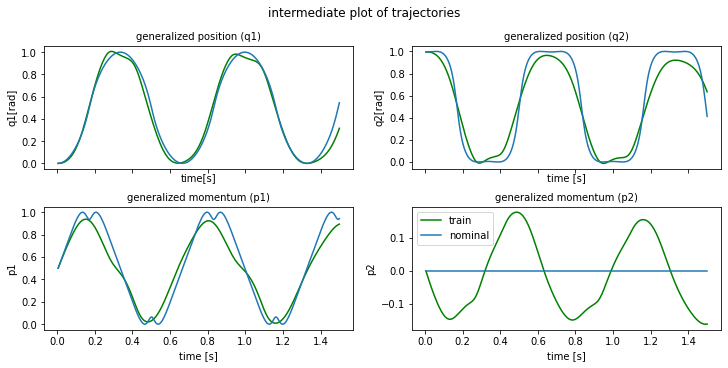

plot time : 1.2107536792755127
epoch  610 | train time 5.97 | train loss 1.248204e-01 | test loss 1.575470e-01 | test time 1.23  
epoch  611 | train time 4.67 | train loss 1.164997e-01 
epoch  612 | train time 4.85 | train loss 1.232293e-01 
epoch  613 | train time 4.95 | train loss 1.190351e-01 
epoch  614 | train time 4.74 | train loss 1.156164e-01 
epoch  615 | train time 4.68 | train loss 1.105004e-01 
epoch  616 | train time 4.86 | train loss 1.281437e-01 
epoch  617 | train time 4.89 | train loss 1.216591e-01 
epoch  618 | train time 4.70 | train loss 1.145825e-01 
epoch  619 | train time 4.93 | train loss 1.107118e-01 


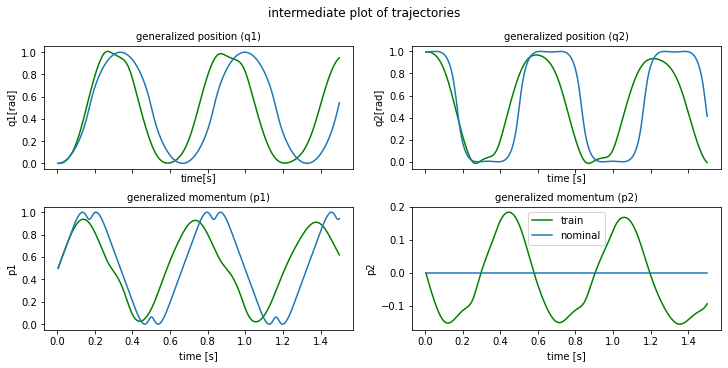

plot time : 1.2405028343200684
epoch  620 | train time 6.43 | train loss 1.227168e-01 | test loss 1.295635e-01 | test time 1.37  
epoch  621 | train time 4.74 | train loss 1.150457e-01 
epoch  622 | train time 5.13 | train loss 1.192710e-01 
epoch  623 | train time 4.77 | train loss 1.150312e-01 
epoch  624 | train time 5.00 | train loss 1.172208e-01 
epoch  625 | train time 4.89 | train loss 1.105775e-01 
epoch  626 | train time 4.75 | train loss 1.227160e-01 
epoch  627 | train time 4.76 | train loss 1.172038e-01 
epoch  628 | train time 4.76 | train loss 1.151460e-01 
epoch  629 | train time 5.14 | train loss 1.094342e-01 


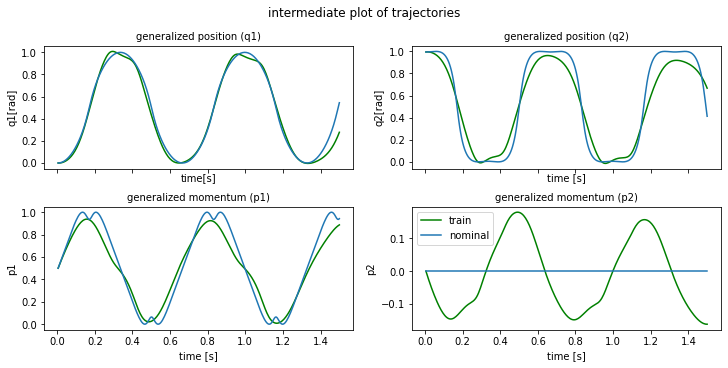

plot time : 1.2142932415008545
epoch  630 | train time 5.94 | train loss 1.230049e-01 | test loss 1.594360e-01 | test time 1.21  
epoch  631 | train time 4.85 | train loss 1.180393e-01 
epoch  632 | train time 4.70 | train loss 1.133066e-01 
epoch  633 | train time 4.91 | train loss 1.074161e-01 
epoch  634 | train time 4.57 | train loss 1.259346e-01 
epoch  635 | train time 4.68 | train loss 1.217520e-01 
epoch  636 | train time 4.76 | train loss 1.084062e-01 
epoch  637 | train time 4.76 | train loss 1.028363e-01 
epoch  638 | train time 4.85 | train loss 1.307736e-01 
epoch  639 | train time 4.99 | train loss 1.258890e-01 


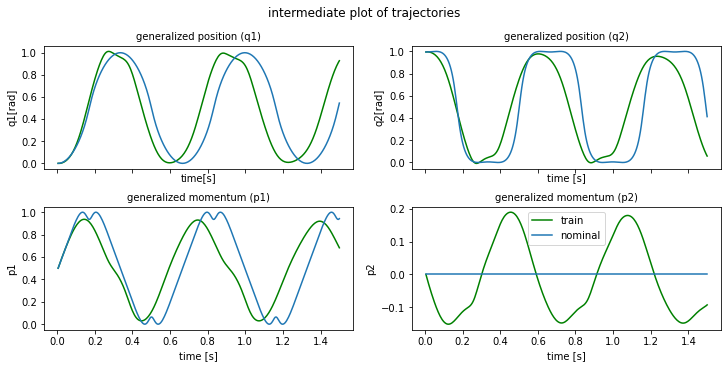

plot time : 1.2117712497711182
epoch  640 | train time 5.99 | train loss 1.044467e-01 | test loss 1.175242e-01 | test time 1.42  
epoch  641 | train time 4.74 | train loss 9.963056e-02 
epoch  642 | train time 4.79 | train loss 1.344446e-01 
epoch  643 | train time 4.84 | train loss 1.289387e-01 
epoch  644 | train time 4.92 | train loss 1.021510e-01 
epoch  645 | train time 4.80 | train loss 9.794103e-02 
epoch  646 | train time 4.63 | train loss 1.362962e-01 
epoch  647 | train time 4.77 | train loss 1.298070e-01 
epoch  648 | train time 4.71 | train loss 1.019112e-01 
epoch  649 | train time 4.64 | train loss 9.811793e-02 


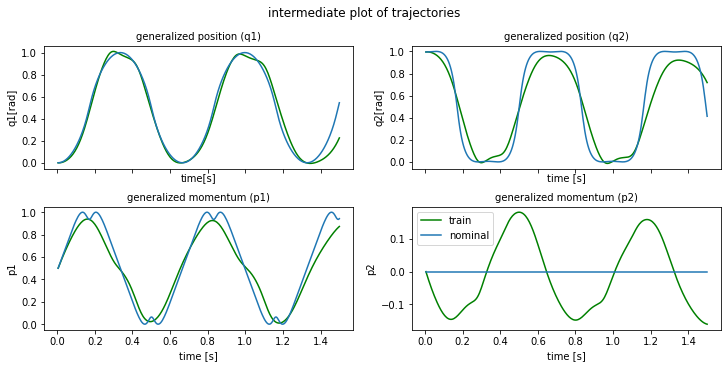

plot time : 1.2197234630584717
epoch  650 | train time 6.09 | train loss 1.346158e-01 | test loss 1.695377e-01 | test time 1.18  
epoch  651 | train time 4.80 | train loss 1.275871e-01 
epoch  652 | train time 4.98 | train loss 1.030611e-01 
epoch  653 | train time 4.98 | train loss 9.918353e-02 
epoch  654 | train time 4.83 | train loss 1.319024e-01 
epoch  655 | train time 4.74 | train loss 1.254039e-01 
epoch  656 | train time 4.75 | train loss 1.039108e-01 
epoch  657 | train time 4.81 | train loss 9.998658e-02 
epoch  658 | train time 5.14 | train loss 1.303236e-01 
epoch  659 | train time 4.78 | train loss 1.242612e-01 


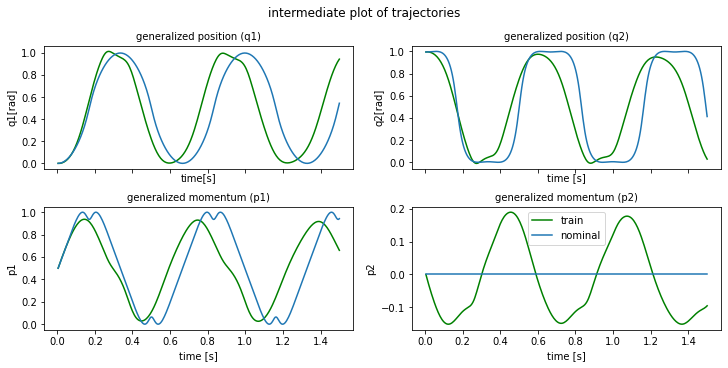

plot time : 1.5267002582550049
epoch  660 | train time 7.51 | train loss 1.043633e-01 | test loss 1.162978e-01 | test time 1.31  
epoch  661 | train time 4.95 | train loss 1.003756e-01 
epoch  662 | train time 4.82 | train loss 1.289434e-01 
epoch  663 | train time 4.78 | train loss 1.228313e-01 
epoch  664 | train time 4.81 | train loss 1.047355e-01 
epoch  665 | train time 4.82 | train loss 1.003309e-01 
epoch  666 | train time 4.78 | train loss 1.285018e-01 
epoch  667 | train time 5.12 | train loss 1.227469e-01 
epoch  668 | train time 4.83 | train loss 1.042410e-01 
epoch  669 | train time 5.04 | train loss 9.975336e-02 


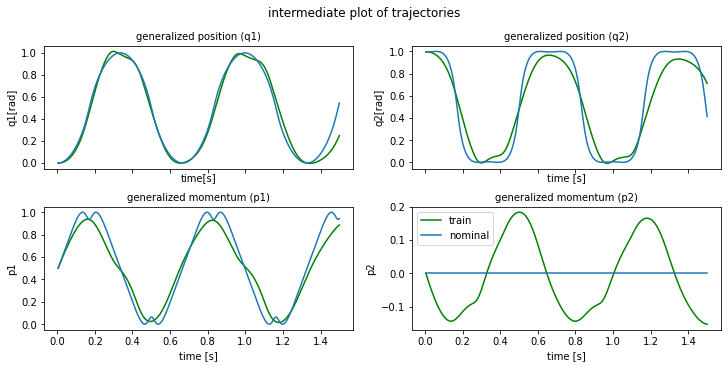

plot time : 1.2530922889709473
epoch  670 | train time 6.08 | train loss 1.289036e-01 | test loss 1.636319e-01 | test time 1.21  
epoch  671 | train time 4.88 | train loss 1.228469e-01 
epoch  672 | train time 4.66 | train loss 1.041002e-01 
epoch  673 | train time 4.89 | train loss 9.967116e-02 
epoch  674 | train time 4.88 | train loss 1.283552e-01 
epoch  675 | train time 4.63 | train loss 1.222252e-01 
epoch  676 | train time 4.89 | train loss 1.040107e-01 
epoch  677 | train time 4.80 | train loss 9.956456e-02 
epoch  678 | train time 5.45 | train loss 1.284158e-01 
epoch  679 | train time 5.25 | train loss 1.229529e-01 


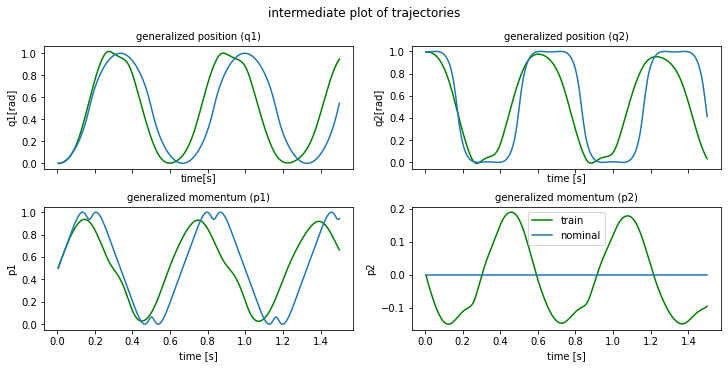

plot time : 1.305020809173584
epoch  680 | train time 6.06 | train loss 1.027481e-01 | test loss 1.146609e-01 | test time 1.43  
epoch  681 | train time 4.75 | train loss 9.853955e-02 
epoch  682 | train time 4.91 | train loss 1.294165e-01 
epoch  683 | train time 4.87 | train loss 1.236604e-01 
epoch  684 | train time 4.73 | train loss 1.020351e-01 
epoch  685 | train time 4.95 | train loss 9.810460e-02 
epoch  686 | train time 4.82 | train loss 1.288914e-01 
epoch  687 | train time 4.92 | train loss 1.227067e-01 
epoch  688 | train time 4.79 | train loss 1.024064e-01 
epoch  689 | train time 4.77 | train loss 9.833615e-02 


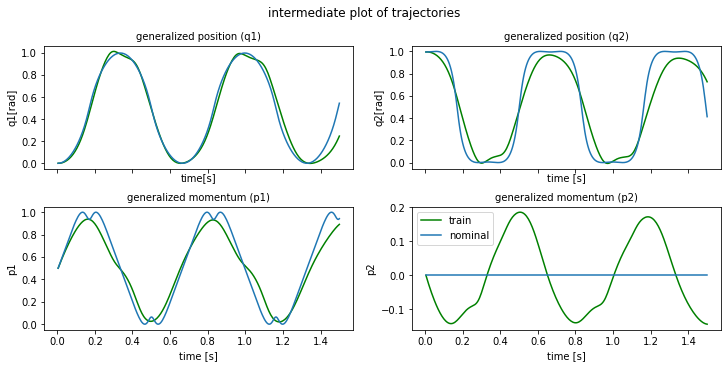

plot time : 1.2563121318817139
epoch  690 | train time 6.19 | train loss 1.280162e-01 | test loss 1.629346e-01 | test time 1.26  
epoch  691 | train time 4.62 | train loss 1.221415e-01 
epoch  692 | train time 4.62 | train loss 1.023345e-01 
epoch  693 | train time 4.85 | train loss 9.802006e-02 
epoch  694 | train time 5.01 | train loss 1.282744e-01 
epoch  695 | train time 4.78 | train loss 1.223588e-01 
epoch  696 | train time 4.64 | train loss 1.019686e-01 
epoch  697 | train time 4.76 | train loss 9.770213e-02 
epoch  698 | train time 4.82 | train loss 1.280745e-01 
epoch  699 | train time 4.77 | train loss 1.219253e-01 


In [55]:
stats = train(
    device=device,
    model=model,
    Ts=Ts,
    train_loader=train_loader,
    test_loader=test_loader,
    w=torch.tensor(weights, device=device),
    grad_clip=grad_clip,
    lr_schedule=lr_schedule,
    begin_decay=begin_decay,
    resnet_config=resnet_config,
    epoch_number=epoch_number,
    alternating=alternating,
    horizon=horizon,
    horizon_type=horizon_type,
    horizon_list=horizon_list,
    switch_steps=switch_steps,
    epochs=epoch_number,
    loss_type=loss_type,
    collect_grads=collect_grads,
    rescale_loss=rescale_loss,
    rescale_dims=rescale_dims,
)

In [56]:
if collect_grads:
    plot_grads(stats)

In [57]:
# set all paths and create folders :
model_path = PATH + "data/" + save_prefix + "/"
stats_path = PATH + "data/" + save_prefix + "/"
plot_path = PATH + "data/" + save_prefix + "/img/"
train_loader_path = PATH + "data/" + save_prefix + "/datasets/"
test_loader_path = PATH + "data/" + save_prefix + "/datasets/"
os.makedirs(model_path, exist_ok=True)
os.makedirs(stats_path, exist_ok=True)
os.makedirs(plot_path, exist_ok=True)
os.makedirs(train_loader_path, exist_ok=True)
os.makedirs(test_loader_path, exist_ok=True)

In [58]:
torch.save(train_loader, train_loader_path + "train_loader.pt")
if test_loader is not None:
    torch.save(test_loader, test_loader_path + "test_loader.pt")

# save model to disk
torch.save(model.state_dict(), model_path + "model")

# save the stats
save_stats(stats, stats_path + "stats.txt")

In [59]:
# train_loader = torch.load(train_loader_path)
# test_loader = torch.load(test_loader_path)
# # loads the stats
# stats = read_dict(PATH, stats_path)
# # load the model from disk
# model.load_state_dict(torch.load(PATH+model_path))
# model.eval()

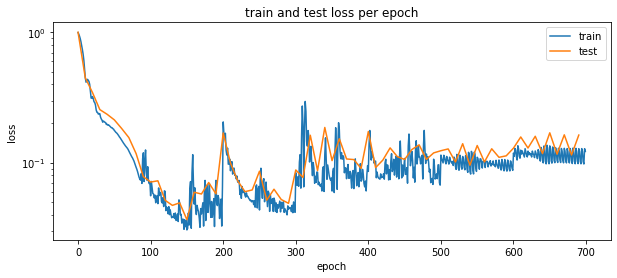

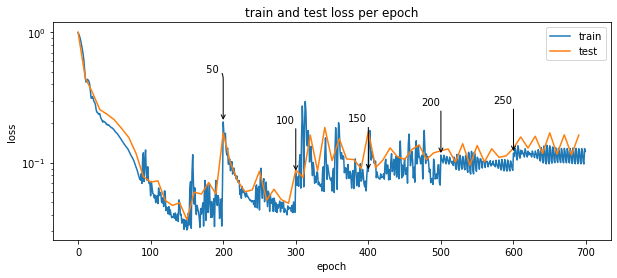

In [60]:
loss_train = stats["train_loss"]
loss_test = stats["test_loss"]
epochs = np.arange(len(loss_train))
train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test.png",
    title="train and test loss per epoch",
    horizons=False,
    switch_steps=switch_steps,
)

train_test_loss_plot(
    loss_train,
    loss_test,
    epochs,
    file_path=plot_path + "/LOSS_train_test_warrows.png",
    title="train and test loss per epoch",
    horizons=horizon_list[:-1],
    switch_steps=switch_steps,
)

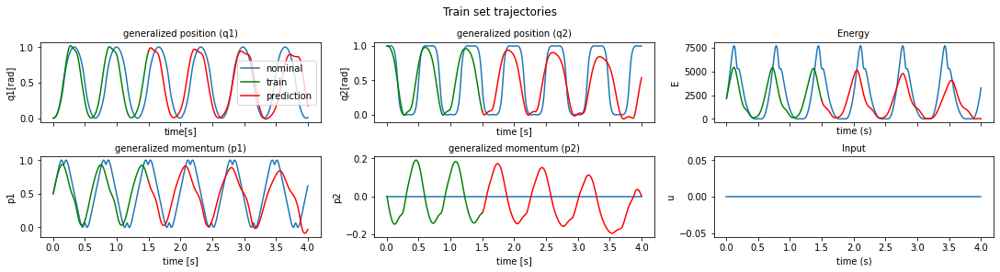

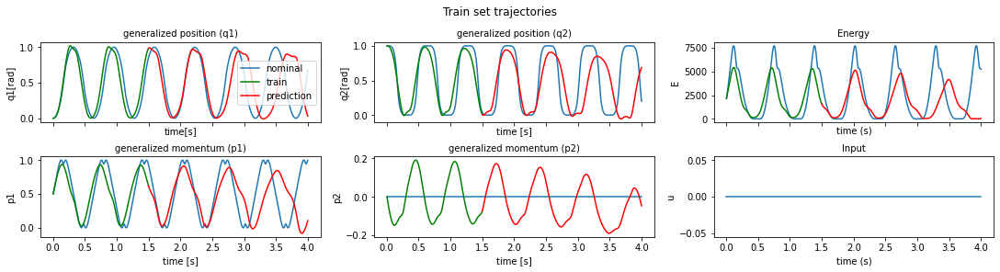

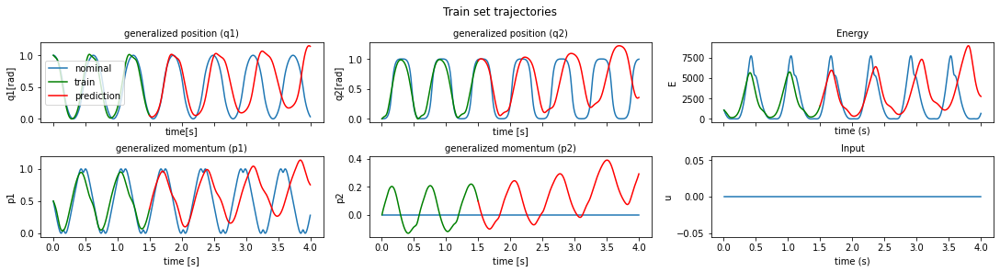

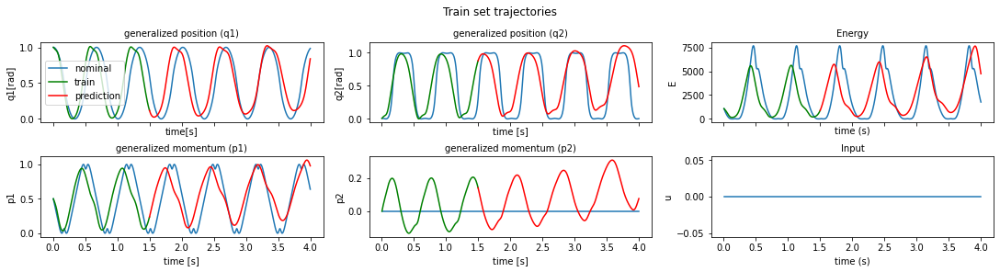

In [61]:
# show train and prediction
for n in [0, 5, 10, 19]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=time_steps,
        show_pred=True,
        H_or_Input="input",
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )

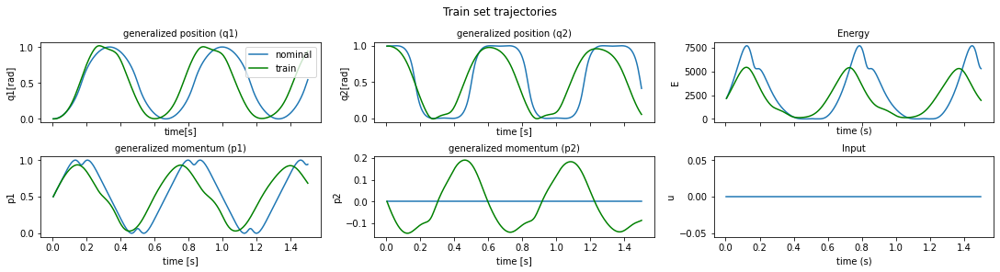

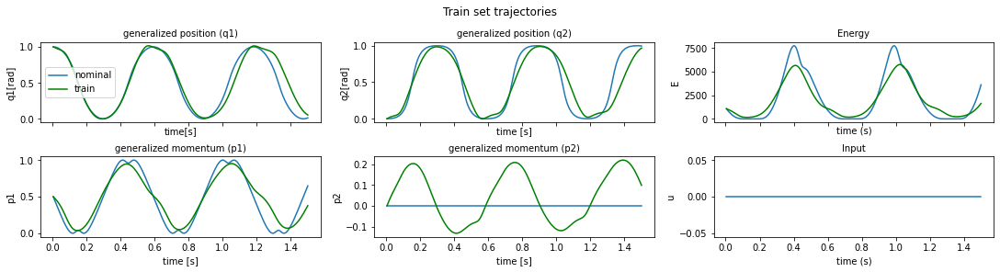

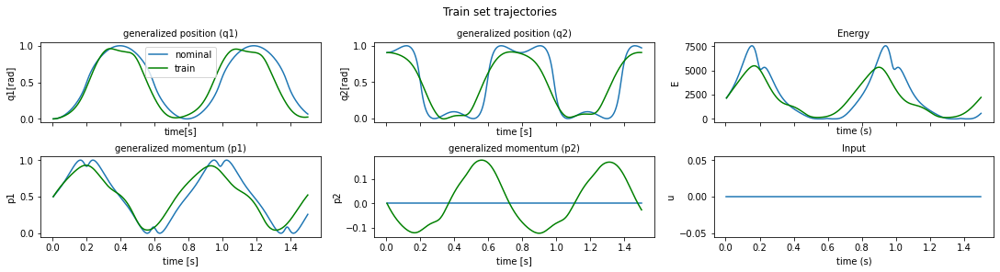

In [62]:
# show only training portion
for n in [0, 50, 70]:
    plot_furuta_hat_nom(
        device,
        model,
        u_func,
        g_func,
        utype,
        gtype,
        data_loader_t=train_loader,
        t_max=horizon_list[-1],
        n=n,
        C_q1=C_q1,
        C_q2=C_q2,
        g=g,
        Jr=Jr,
        Lr=Lr,
        Mp=Mp,
        Lp=Lp,
        t_plot=horizon_list[-1],
        show_pred=False,
        title="Train set trajectories",
        file_path=plot_path + "/TRAJECTORIES_train_set" + str(n) + ".png",
        w_rescale=w_rescale,
    )